In [1]:
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
import os
from scipy.ndimage import binary_dilation
from scipy.ndimage import binary_erosion
from tqdm import tqdm
import pandas as pd
from scipy import ndimage as ndi
from skimage.measure import regionprops

from skimage.segmentation import watershed
from skimage.feature import peak_local_max


In [12]:
def load_data(label_folder, image_folder, n_datapoints):
	''' Loads all of the files into numpy arrays, one for each lesion ID. Makes
	sure correspondence is met between the file names. '''
	
	images = []
	labels = []
	for filename in tqdm(os.listdir(label_folder)[:n_datapoints]):
		if filename != ".DS_Store":
			labels.append(
				np.squeeze(
					nib.load(
						os.path.join(label_folder,filename)).get_fdata().astype(bool)))
			
			images.append(
				np.squeeze(
					nib.load(
						os.path.join(image_folder,filename)).get_fdata().astype(np.int32)))

	return np.array(labels), np.array(images)

labels, images = load_data('lits_labels', 'lits_images', n_datapoints=400)

100%|██████████| 400/400 [01:05<00:00,  6.13it/s]


In [3]:
def separate(old_label, footprint_size=20, size_cutoff=500, circularity_cutoff=0.5):
    def remove_boundary(segmentation_map):
        # Find the edges of each object
        edges = np.zeros_like(segmentation_map)
        for label in np.unique(segmentation_map):
            if label == 0:  # Skip the background label
                continue
            mask = segmentation_map == label
            edges += binary_dilation(mask, iterations=2) & ~mask

        # Set the boundary pixels to 0
        boundary_removed = np.where(edges != 0, 0, segmentation_map)
        
        return boundary_removed
    # Only do this if there are more than 500 pixels in the old label (leave
    # smaller examples alone) and shape is highly non-circular.
    # In case there are multiple regions, select the largest one

    regions = regionprops(old_label.astype(int))
    largest_region = 0
    largest_area = 0

    for i, region in enumerate(regions):
        if region.area > largest_area:
            largest_area = region.area
            largest_region = i
    
    largest_circularity = (4*np.pi*regions[largest_region].area)/\
        (regions[largest_region].perimeter**2)
    
    print(largest_circularity)

    if np.sum(old_label) > size_cutoff and largest_circularity < circularity_cutoff:
        # Watershedding to produce segmentation map
        distance = ndi.distance_transform_edt(old_label)
        coords = peak_local_max(distance, 
                                footprint=np.ones((footprint_size, footprint_size)), 
                                labels=old_label)
        mask = np.zeros(distance.shape, dtype=bool)
        mask[tuple(coords.T)] = True
        markers, _ = ndi.label(mask)
        segmentation_map = watershed(-distance, markers, mask=old_label)

        # Removing the pixels where lesions touch
        no_boundaries = remove_boundary(segmentation_map)

        new_label = no_boundaries > 0

        return new_label
    else:
        return old_label

def plot_image(image_idx, postprocess=False):
    first_slice = np.argwhere(labels[image_idx]==1)[0,-1]
    label = labels[image_idx,:,:,first_slice]

    if postprocess: # Watershed separation
        label = separate(label)
        
    image = images[image_idx,:,:,first_slice] + -1*np.min(images[image_idx,:,:,first_slice])
    
    if np.sum(label)>500:        

        # Creating outline
        dilated = binary_erosion(label, iterations=2)
        outline = (label.astype(int)-dilated.astype(int))*\
            np.max(images[image_idx,:,:, first_slice])

        with_outline = np.concatenate((image + outline, image), axis=1)
        plt.figure()
        plt.imshow(with_outline, cmap='gray')
        plt.show()
        print(image_idx)

    return image, label

In [ ]:
for image_idx in range(399):
    plot_image(image_idx)

In [8]:
# Visualize across a large portion of the dataset to tune hyperparameters
def before_after(image_idx, footprint_size=20, circularity_cutoff=0.5, savefig=False):

    first_slice = np.argwhere(labels[image_idx]==1)[0,-1]

    # Keep both the original and the new labels
    original_label = labels[image_idx,:,:,first_slice]
    
    print(np.sum(original_label))


    new_label = separate(original_label, footprint_size, circularity_cutoff)  
    image = images[image_idx,:,:,first_slice] + -1*np.min(images[image_idx,:,:,first_slice])     

    # Creating outlines
    dilated_original = binary_erosion(original_label, iterations=2)
    outline_original = (original_label.astype(int) - dilated_original.astype(int))*\
        np.max(images[image_idx,:,:, first_slice])
    
    dilated_new = binary_erosion(new_label, iterations=2)
    outline_new = (new_label.astype(int) - dilated_new.astype(int))*\
        np.max(images[image_idx,:,:, first_slice])

    comparison = np.concatenate(
        (image + outline_original, image + outline_new), axis=1)

    plt.figure()
    plt.imshow(comparison, cmap='gray')
    plt.axis('off')
    if savefig:
        plt.savefig(f"{image_idx}_.png", bbox_inches='tight', dpi=300)
    plt.show()
    print(image_idx)

636
0.8745196064078664


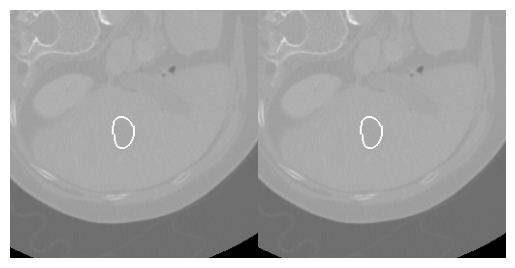

129


In [11]:
before_after(129)

2798
0.3305405386365528


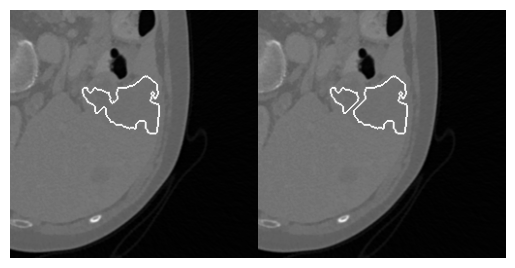

147


In [14]:
before_after(147, savefig=True)

60
1.1240316092611384


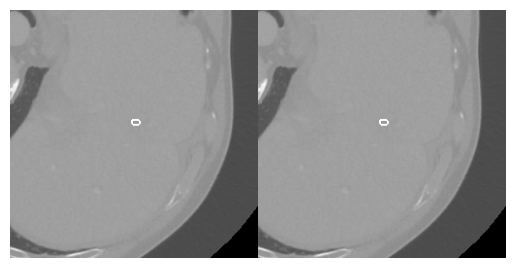

0
262
0.51208051793167


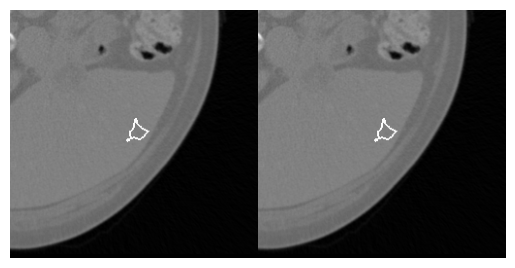

1
248
0.8744498905256761


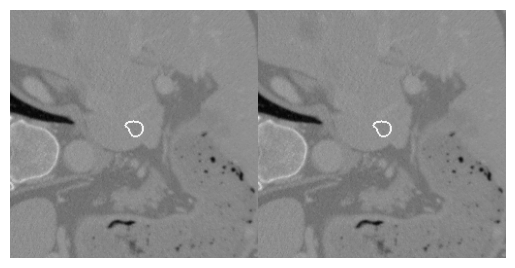

2
641
0.7948331540704261


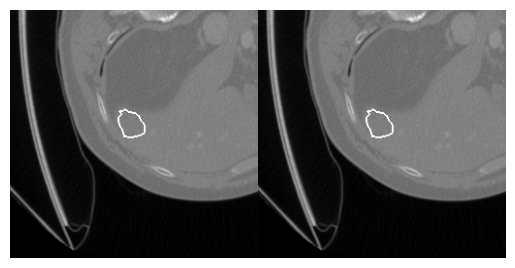

3
1105
0.6130254869354667


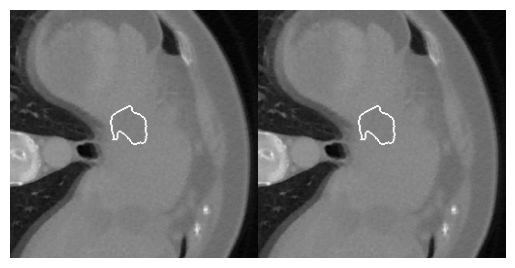

4
153
0.9912301781667335


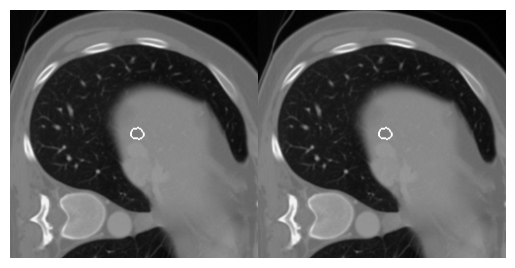

5
420
0.8688119958859659


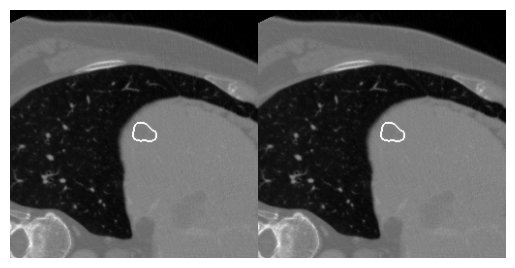

6
4495
0.44425887173683787


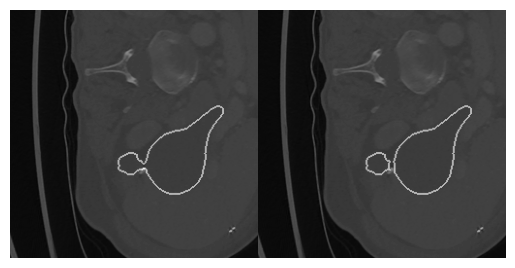

7
167
0.818756563539872


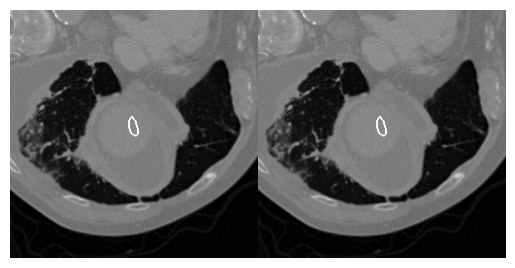

8
18
1.3239153988972323


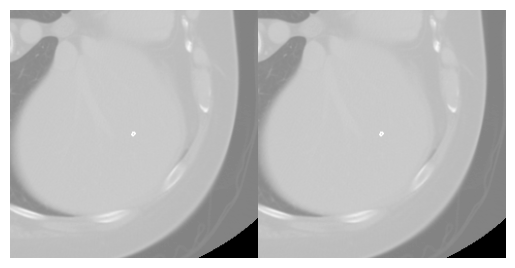

9
153
0.9166203522790672


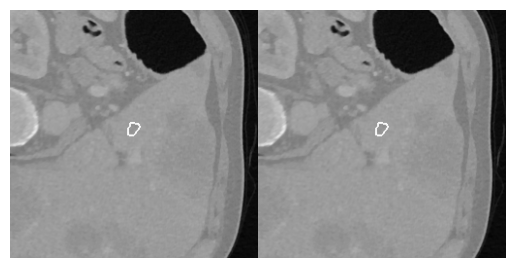

10
10
1.5392254097658196


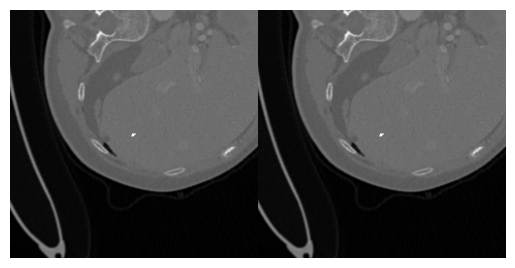

11
104
1.0337341843865526


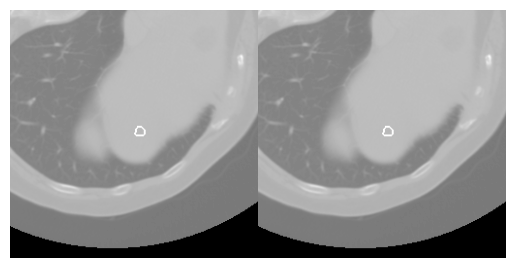

12
42
1.043908662112716


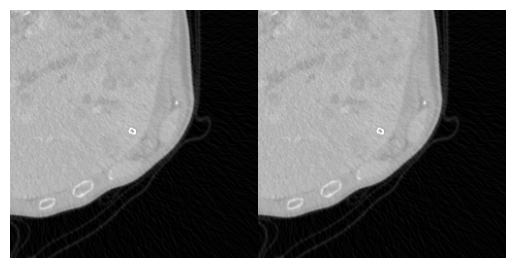

13
158
0.9132385496201394


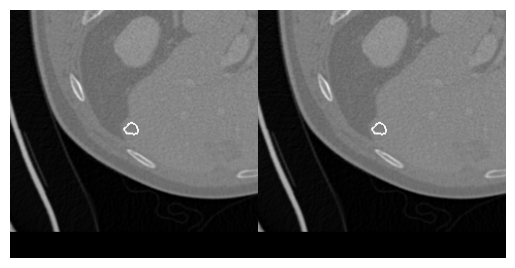

14
31
1.0081926404352783


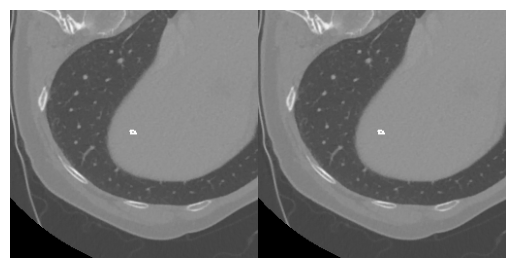

15
140
0.9421172926239537


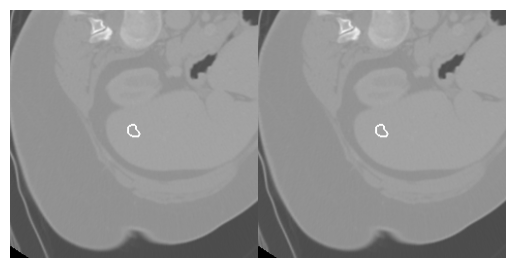

16
89
1.04415027248501


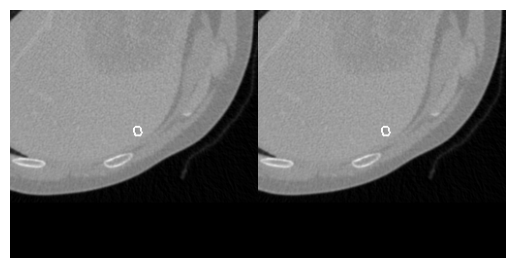

17
118
1.0246454693452451


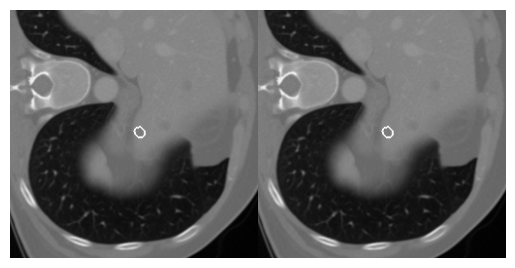

18
198
0.859660181908299


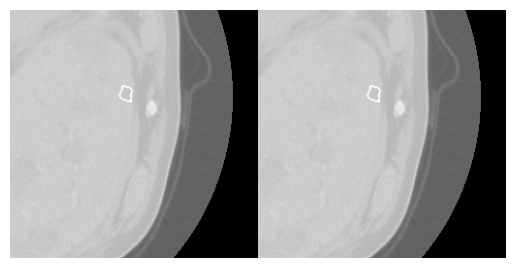

19
1362
0.7237313693470085


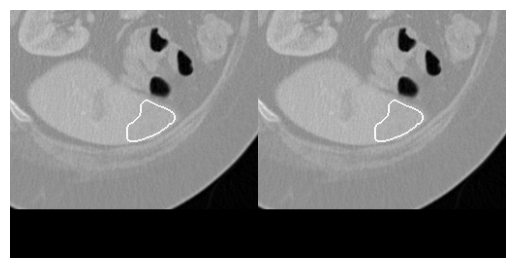

20
344
0.36931348547070525


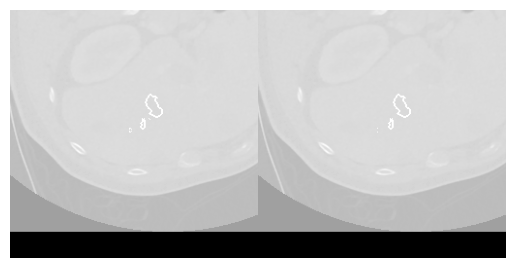

21
33
1.1697571821464499


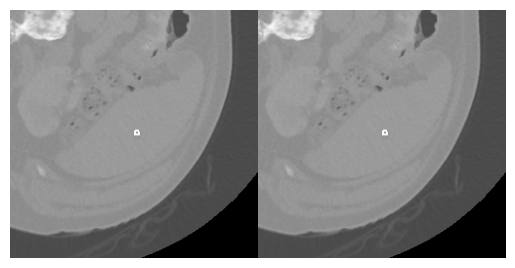

22
164
0.997411239597103


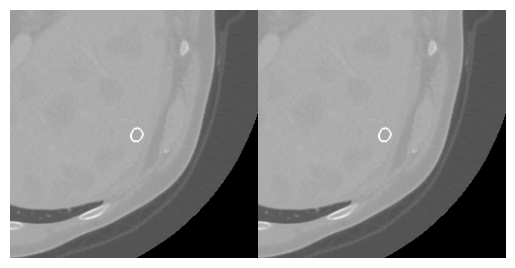

23
157
0.9306965948731044


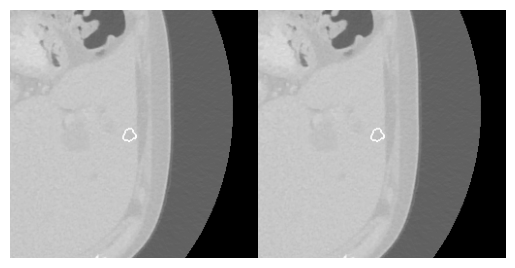

24
133
0.9565990203218339


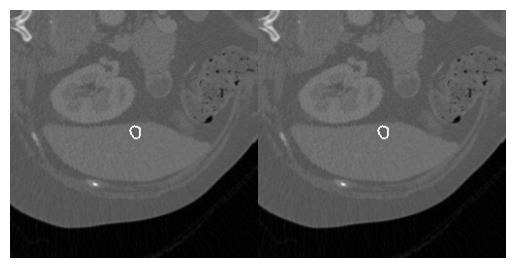

25
50
0.6654470178427746


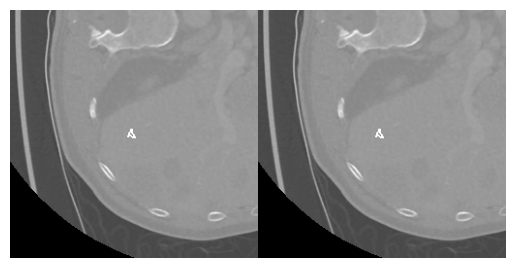

26
55
0.9264270201529872


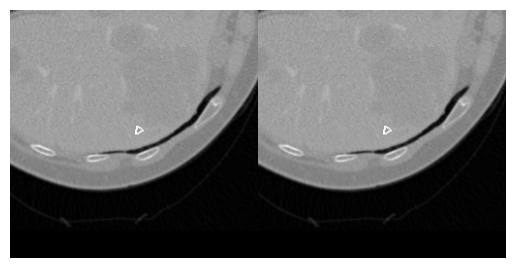

27
255
0.729338387860892


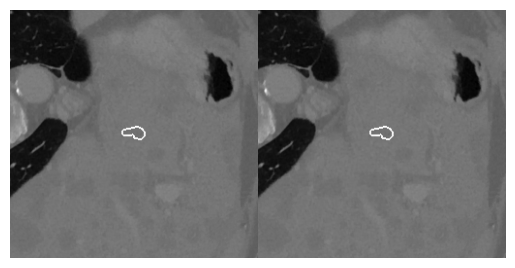

28
237
0.8261392464023357


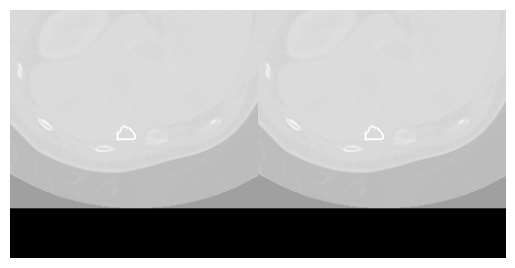

29
33
1.0472242640569587


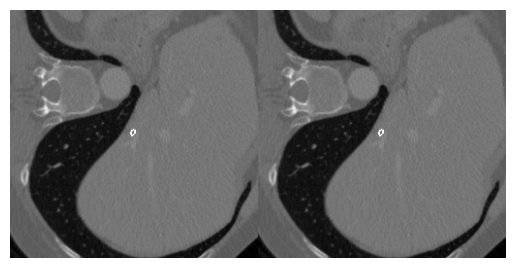

30
158
0.9817712417488641


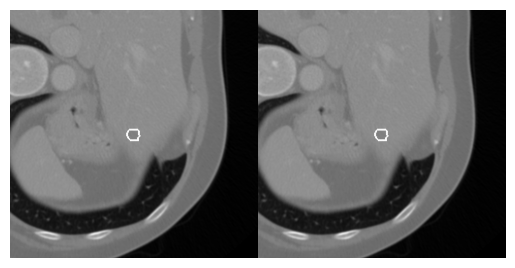

31
42
1.1005023051819023


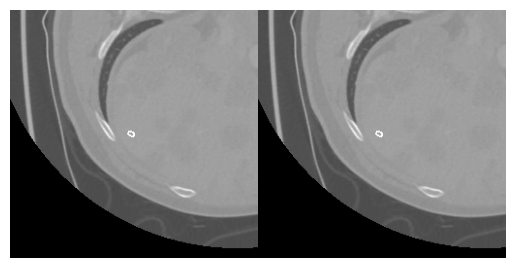

32
409
0.6043513944340506


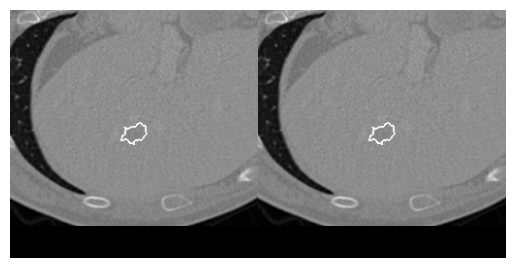

33
467
0.7254543827479737


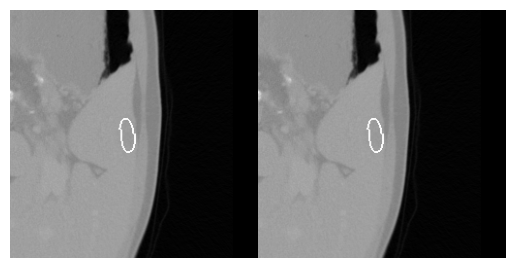

34
25
1.1907938922533645


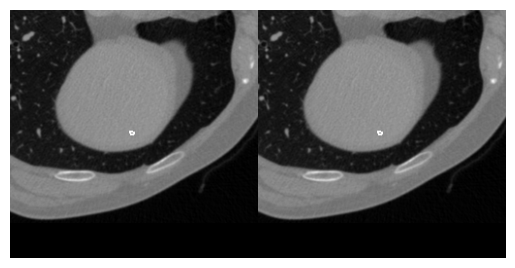

35
12
1.4373655585403928


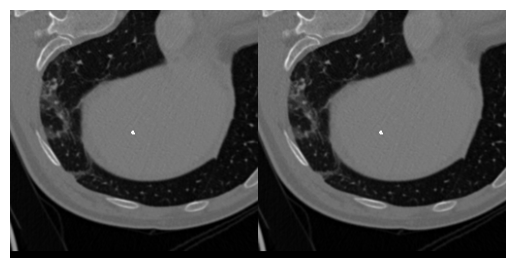

36
913
0.40175799370132215


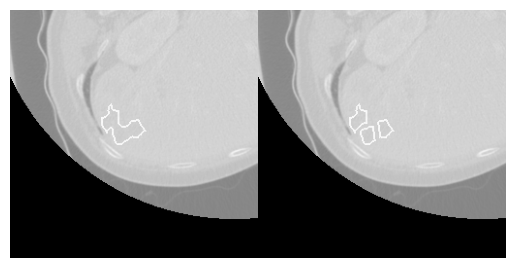

37
150
0.9068303826593173


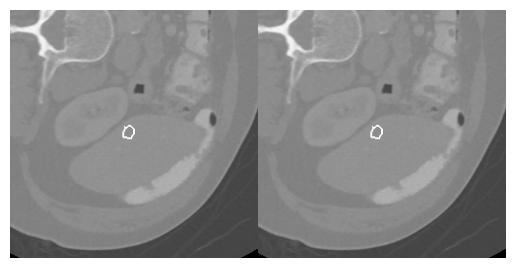

38
825
0.8701254764634222


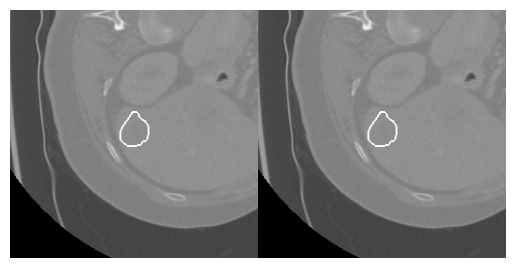

39
504
0.8763507411427566


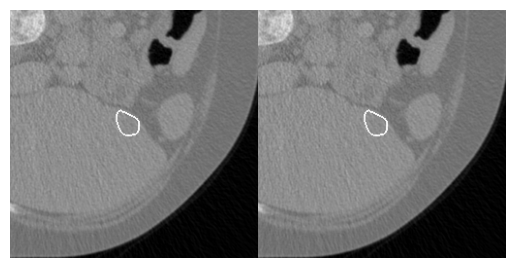

40
67
1.0201786698650586


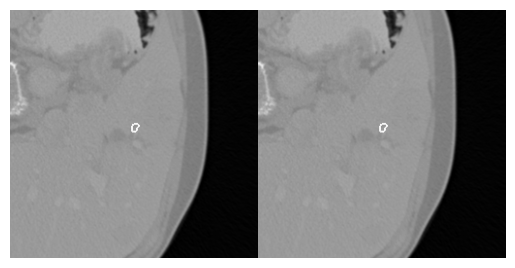

41
976
0.8209879264294453


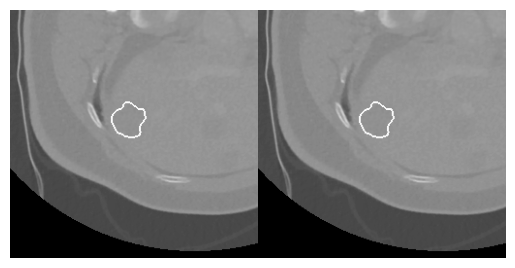

42
331
0.9565884807729943


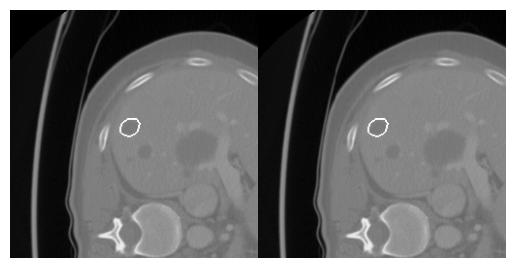

43
51
1.0995846522834003


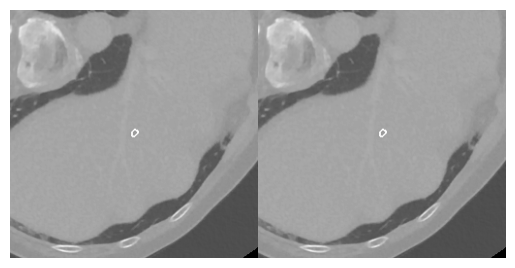

44
26
0.8250857838024523


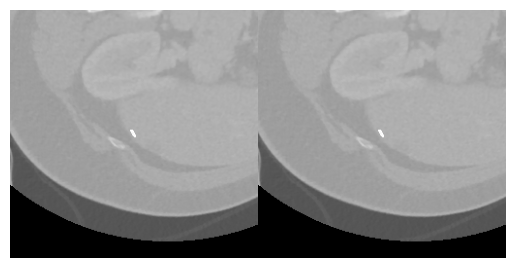

45
349
0.6553520681296567


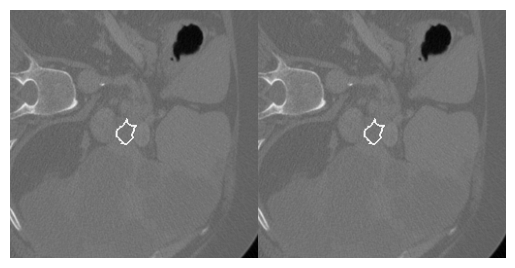

46
17
1.1454006794618754


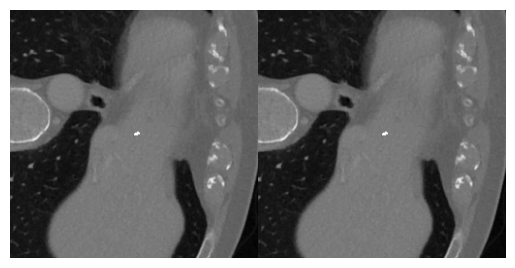

47
222
0.9348490839725597


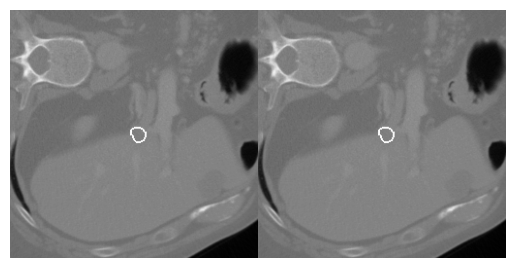

48
867
0.30703561318640915


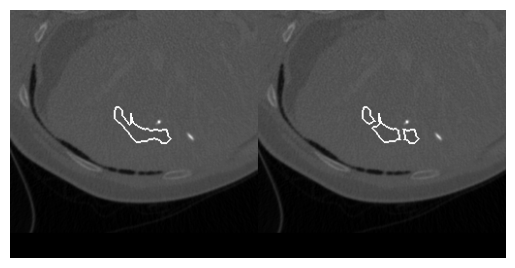

49
1077
0.581110332678092


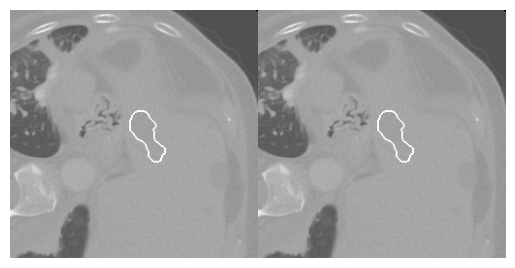

50
24
1.109758237513081


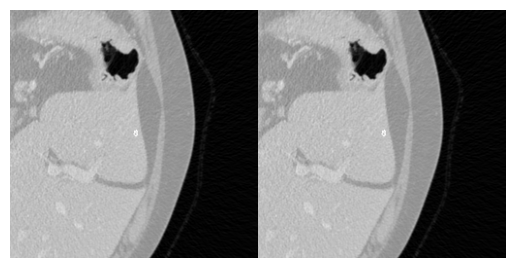

51
167
0.9753834942225342


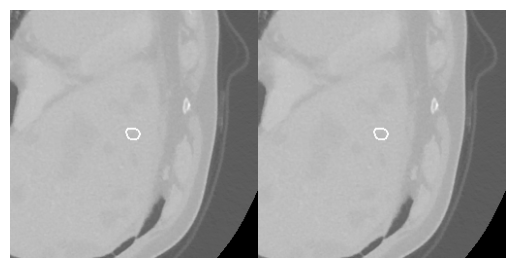

52
155
1.0107005796181538


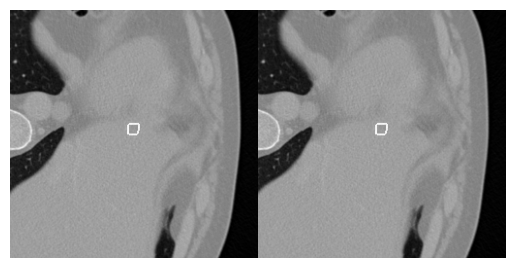

53
82
0.9578616350448831


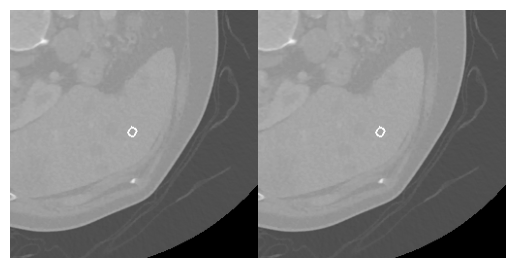

54
7724
0.8009300275332975


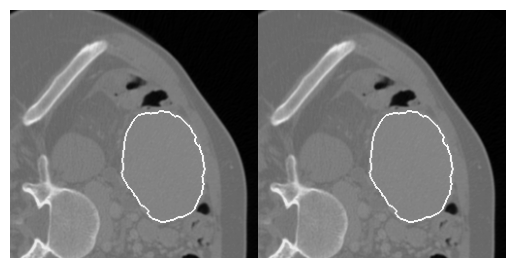

55
3027
0.4715891014934715


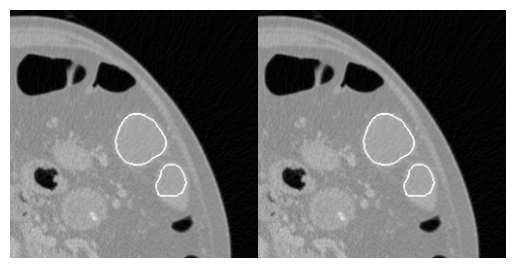

56
82
1.0347852038717007


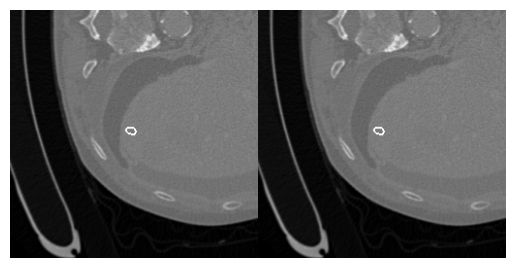

57
99
1.089024415526777


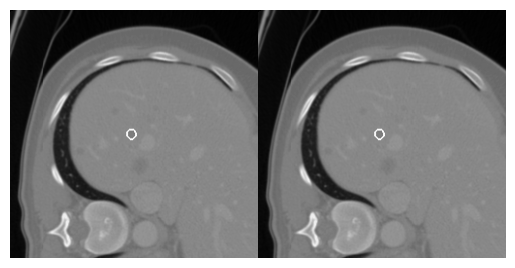

58
174
1.0162678323037178


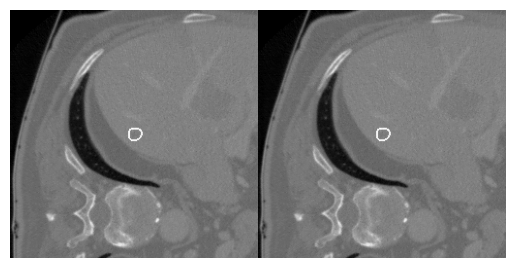

59
902
0.7385811601741634


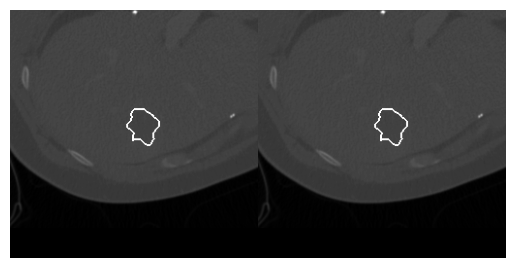

60
242
0.9682861153242615


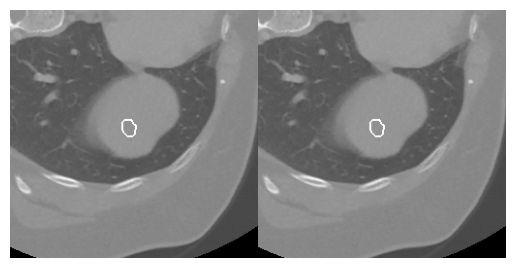

61
1070
0.4500292424587638


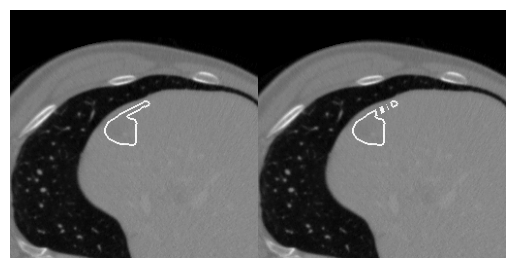

62
599
0.7381459606837202


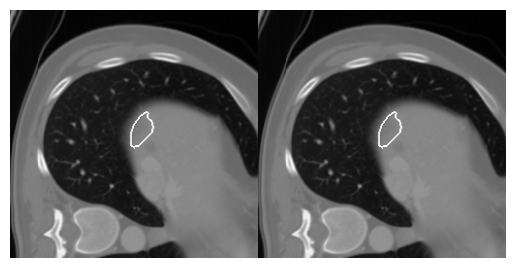

63
220
0.7757216770792289


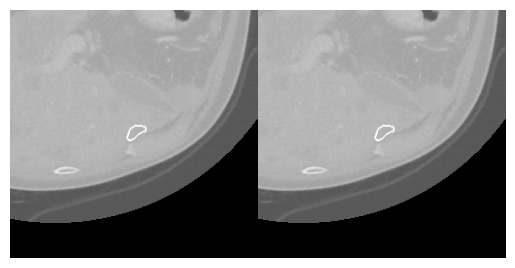

64
124
0.9837561268413857


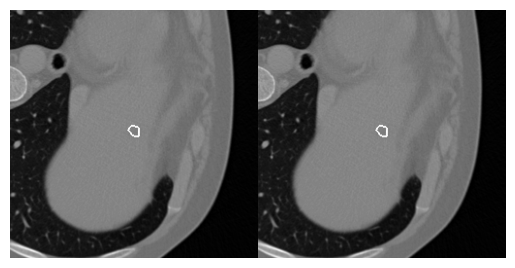

65
72
1.0529332270693823


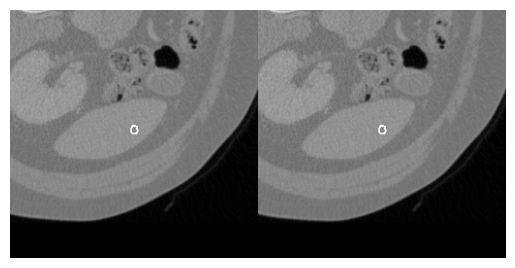

66
91
0.9350740704971333


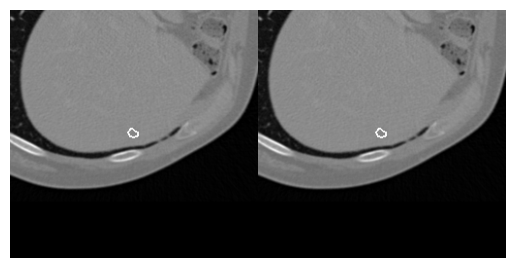

67
284
0.7346517713975099


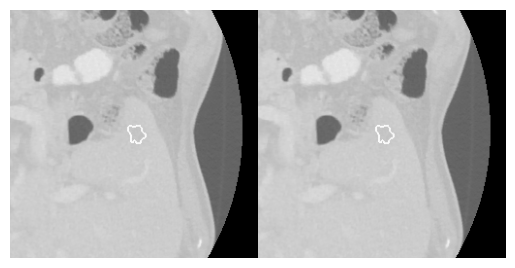

68
845
0.2794708211662045


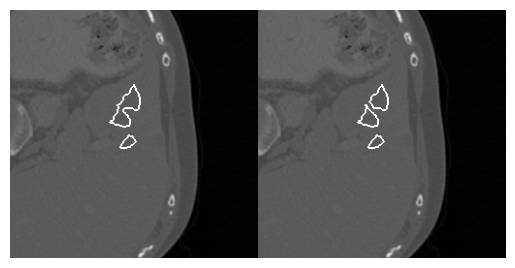

69
398
0.953452487165127


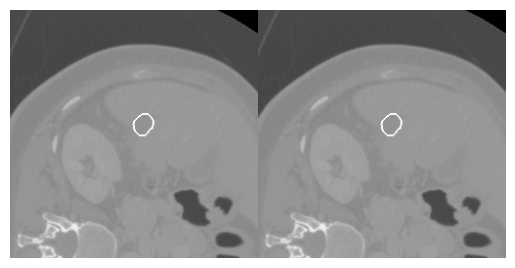

70
444
0.8914570806074266


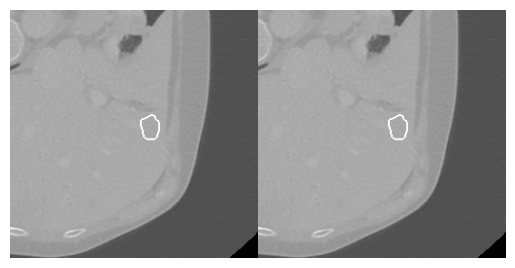

71
275
0.6645368439339071


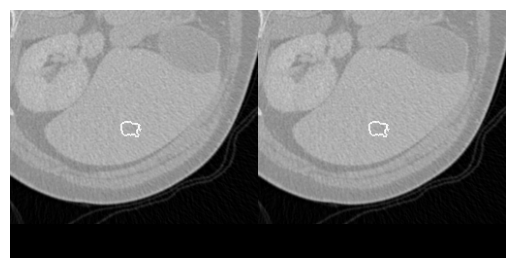

72
98
1.0564636855271885


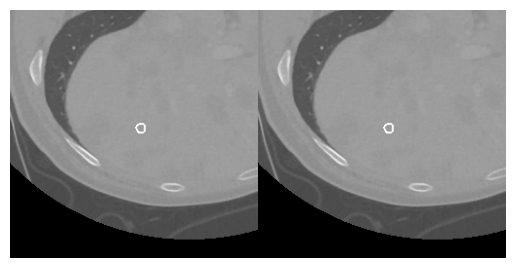

73
211
0.32648374765654525


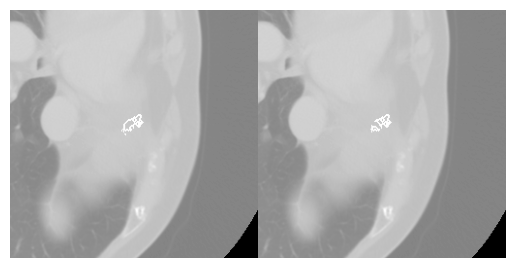

74
383
0.7066712920301721


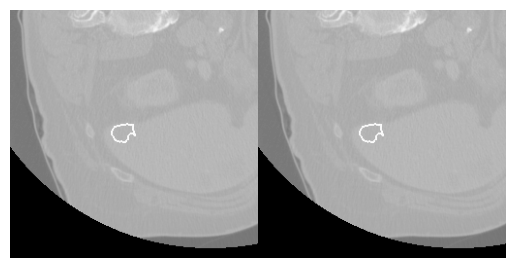

75
29
1.2505080359301415


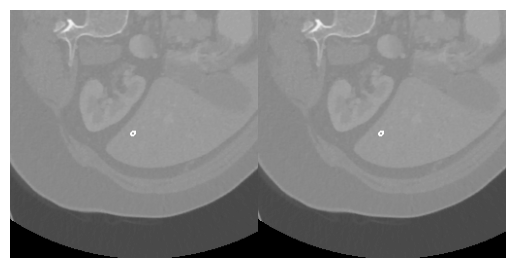

76
23
0.9021030400678826


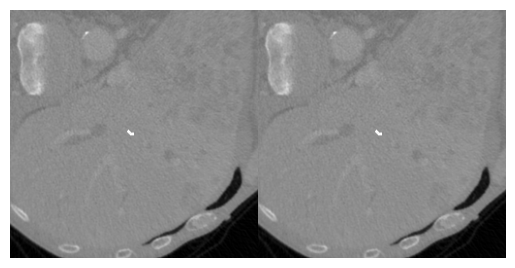

77
177
0.5246283353265588


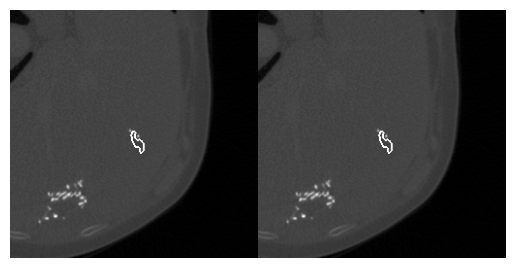

78
116
1.00197720430288


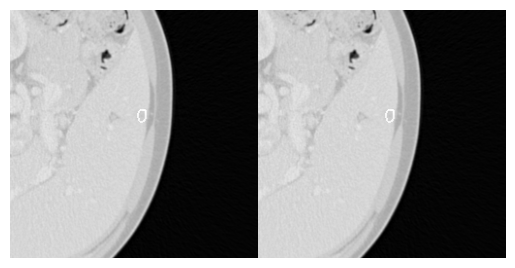

79
38
1.2058946070958918


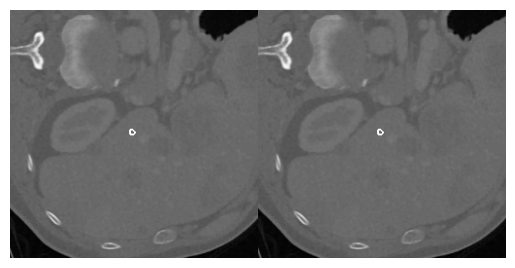

80
33
0.8646803826429229


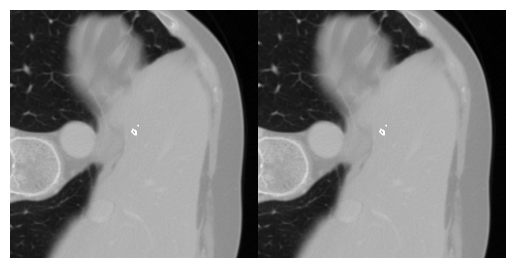

81
58
0.8684083582848207


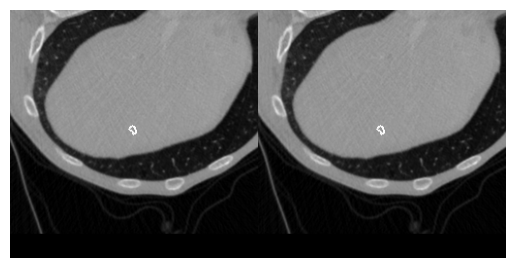

82
27
1.0882958272169045


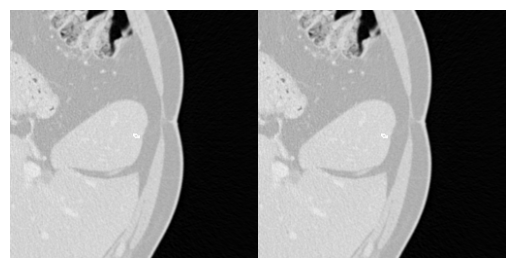

83
177
0.7107563210248401


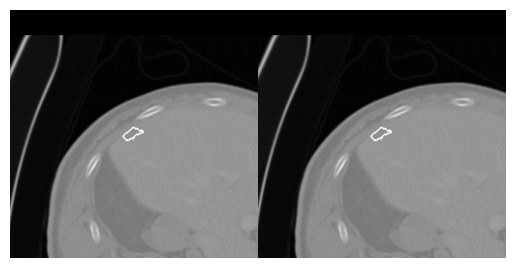

84
270
0.8210397399122494


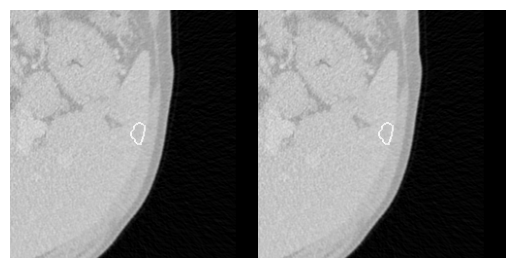

85
199
0.6278117547880137


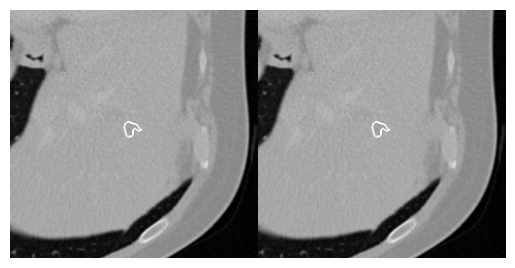

86
27
0.8422338105333187


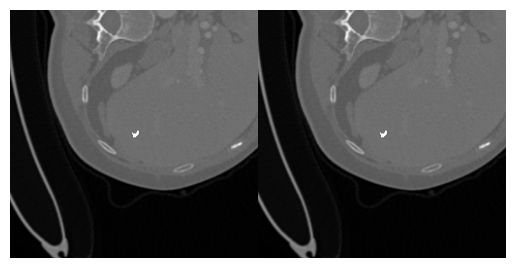

87
1855
0.4926883592989409


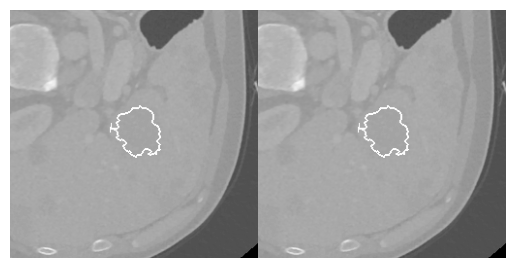

88
69
1.009061009274825


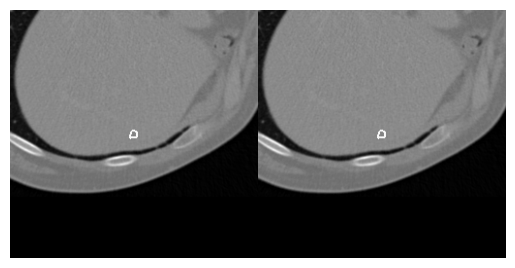

89
157
1.028445606628325


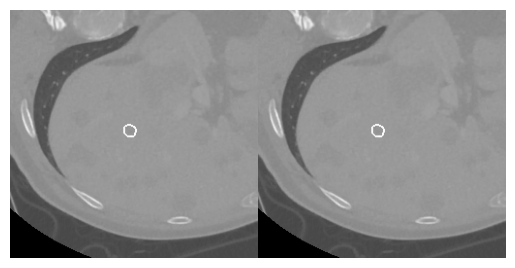

90
78
0.9288192359576243


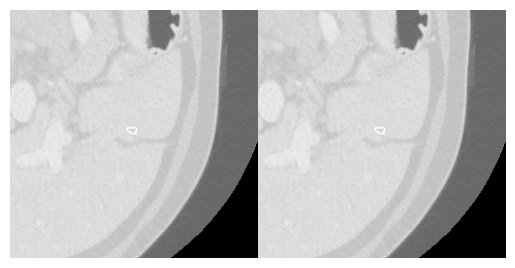

91
173
0.5685830729492324


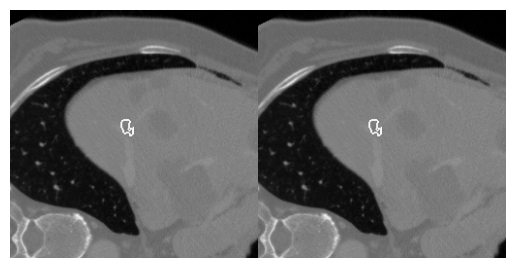

92
1065
0.7908910117629478


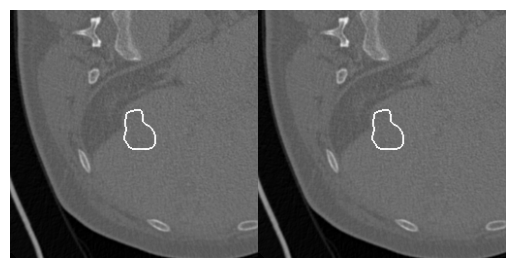

93
969
0.9090040521173215


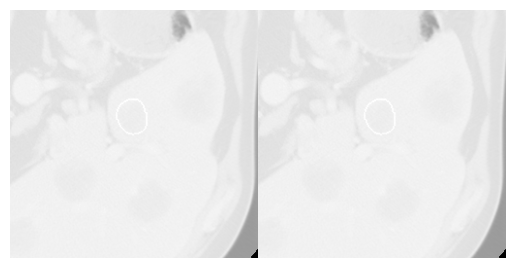

94
32
1.1768136879086513


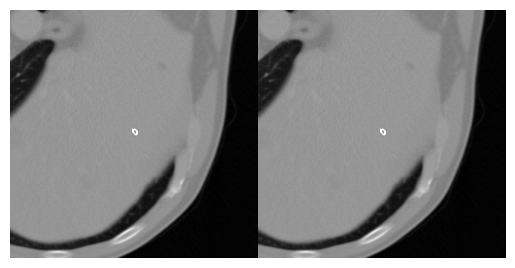

95
580
0.870601962993645


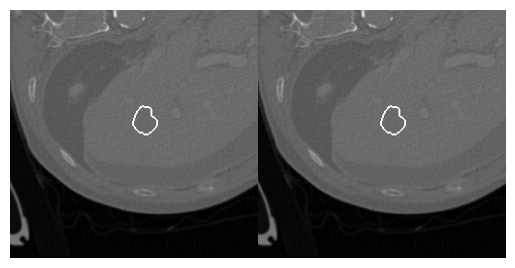

96
136
0.994436936676639


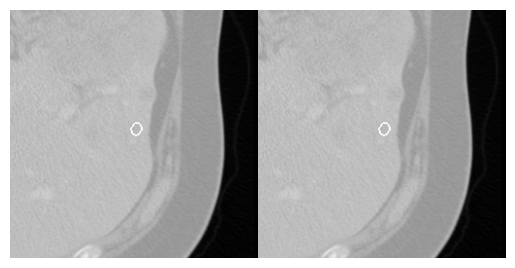

97
31
1.1400382601615053


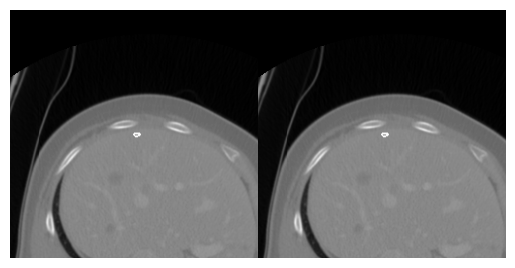

98
1346
0.8686864677430958


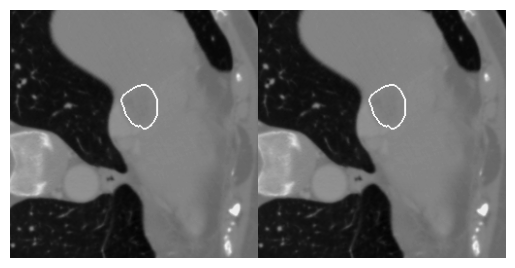

99
188
0.9851390257324144


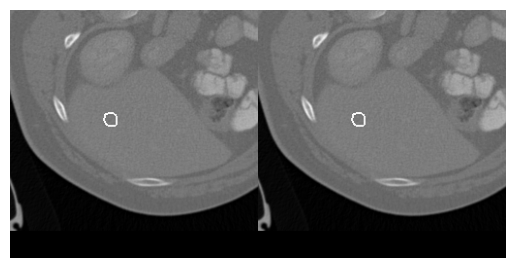

100
57
1.1178233322580289


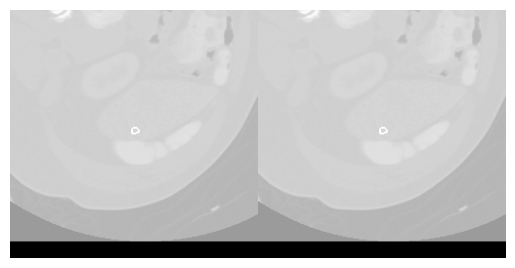

101
1808
0.7402188124140175


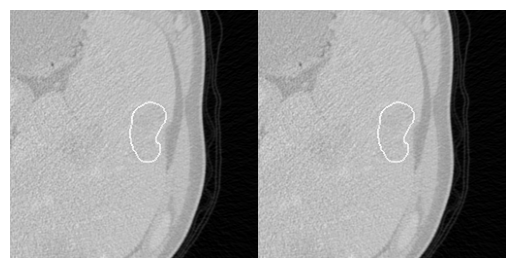

102
817
0.6411835948297193


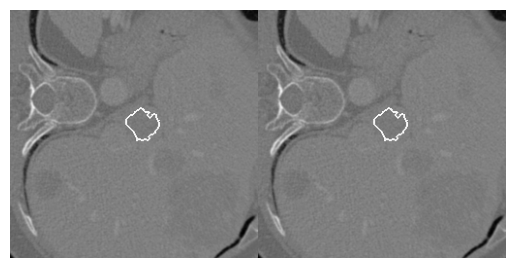

103
237
0.9287625722844317


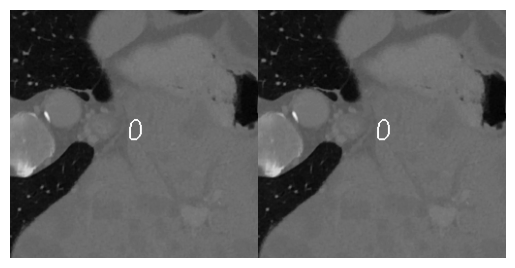

104
69
0.9183168846230286


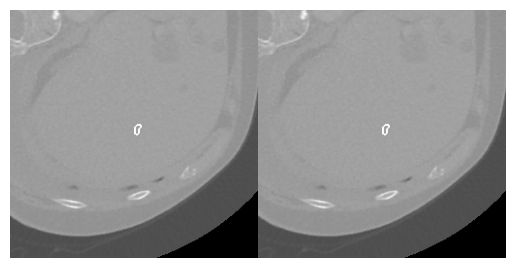

105
65
1.0313572297530655


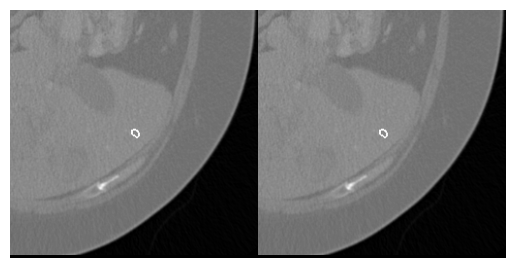

106
95
0.9139150870484555


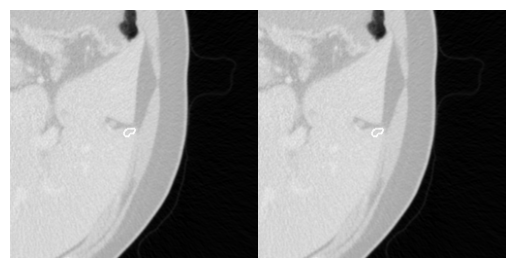

107
123
1.0359138498074314


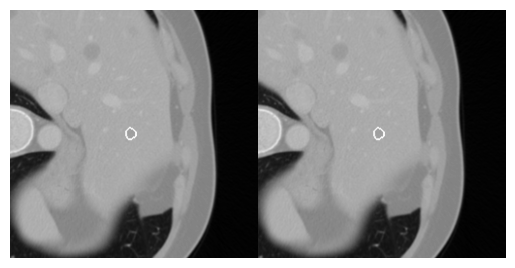

108
921
0.898456586977393


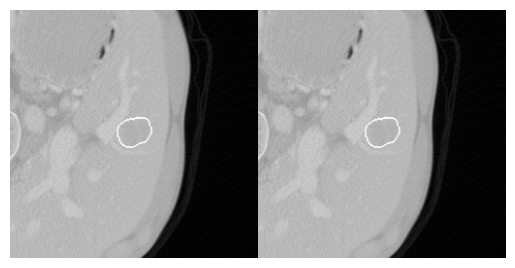

109
246
0.9674631898687335


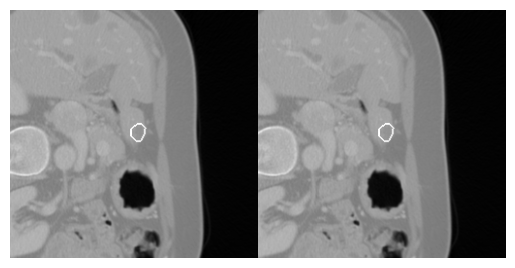

110
28
1.1286030800767899


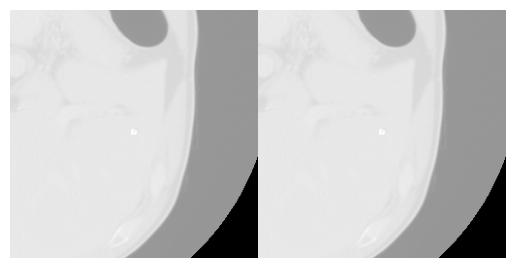

111
78
1.0964195283831062


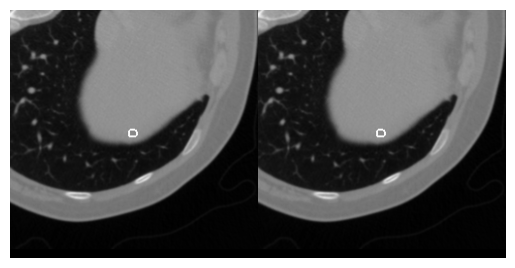

112
61
1.0927744108680026


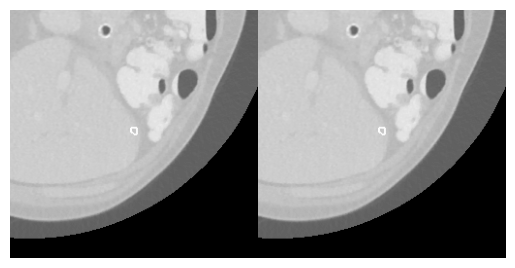

113
30
1.1766561392189778


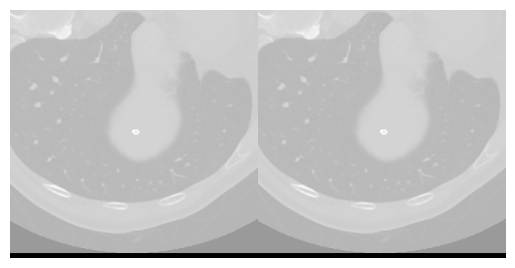

114
75
0.9464498815899702


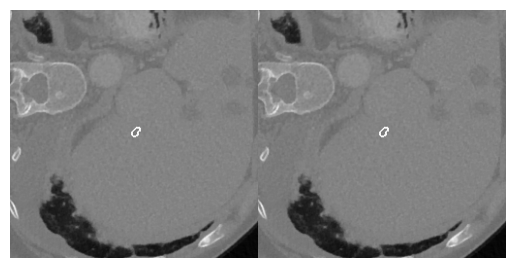

115
202
0.9285795506154199


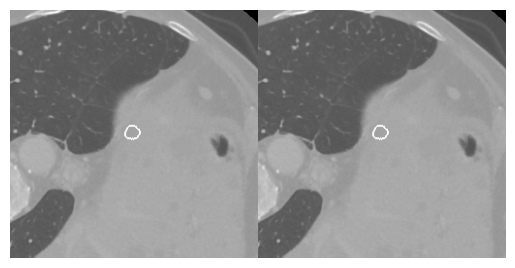

116
69
0.8842802920116035


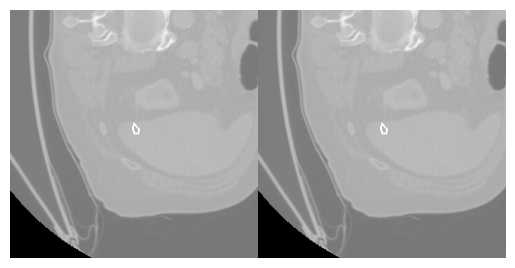

117
51
1.0689806449436836


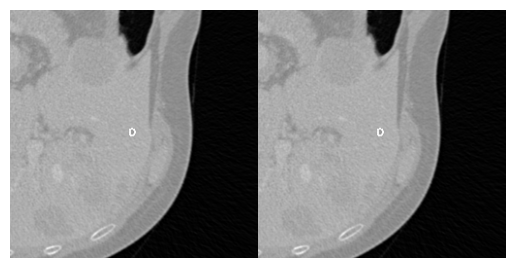

118
536
0.7901827360229761


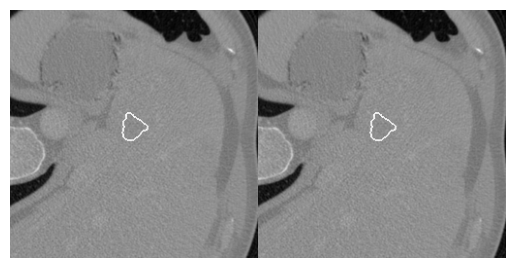

119
35
1.073355474593179


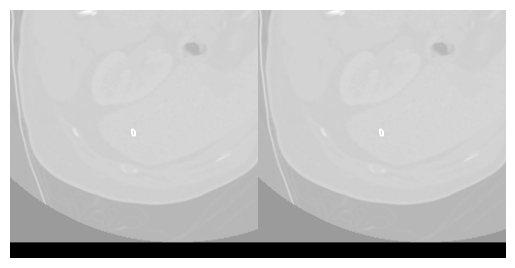

120
132
1.00495212255364


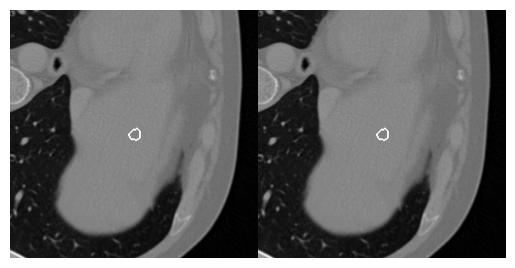

121
174
0.9851064306770968


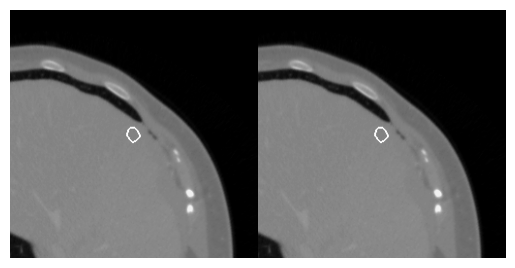

122
289
0.6904135942014665


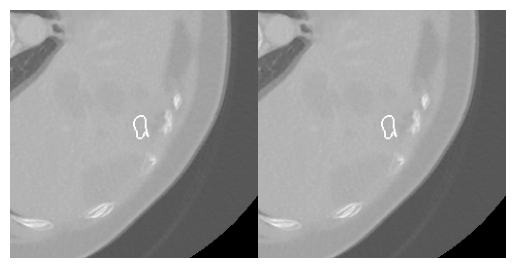

123
187
0.8959578648235114


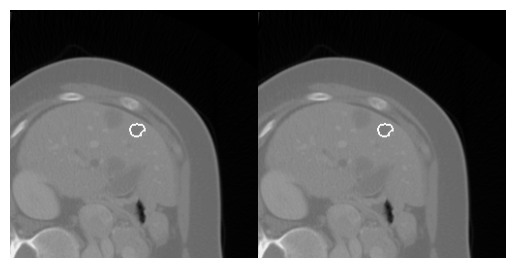

124
214
0.992937348607995


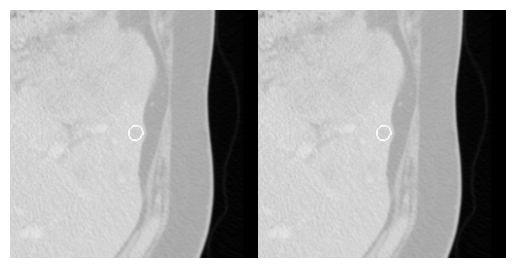

125
26
1.2022380906391716


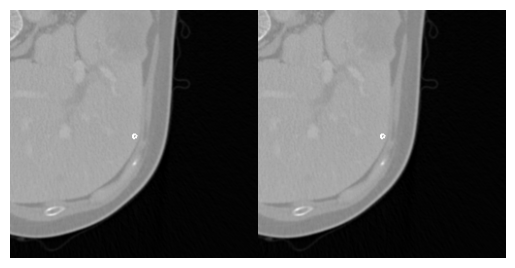

126
233
0.8379232020112306


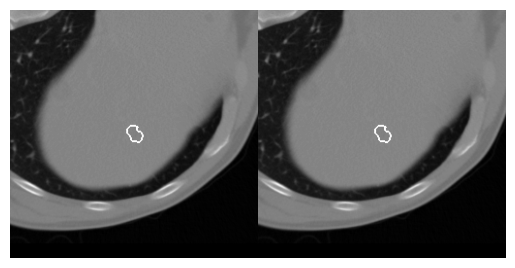

127
73
0.9715526460504506


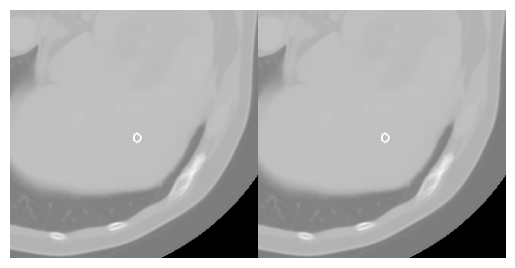

128
636
0.8745196064078664


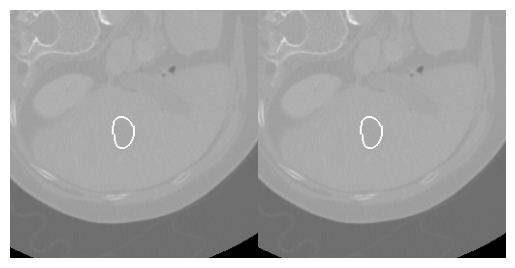

129
393
0.8150604814664916


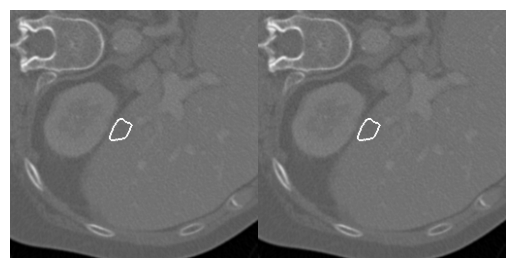

130
1536
0.733061682992397


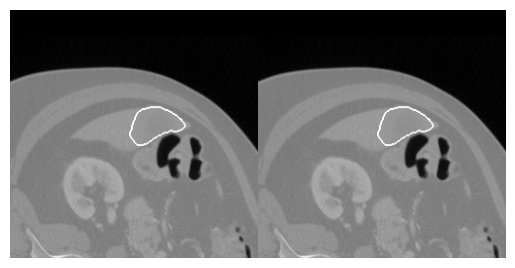

131
1438
0.6996474939222607


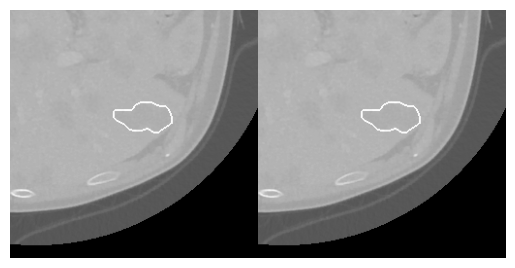

132
154
0.7280584922235348


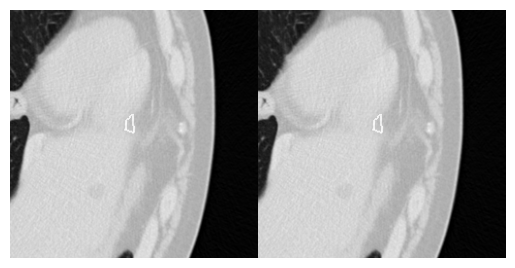

133
258
0.8680937910606429


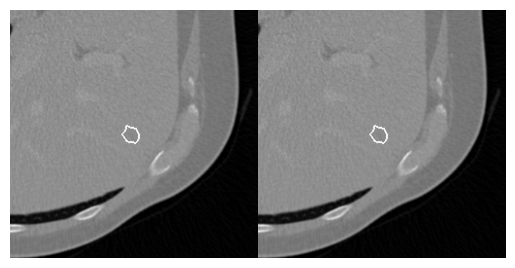

134
394
0.7257168981651785


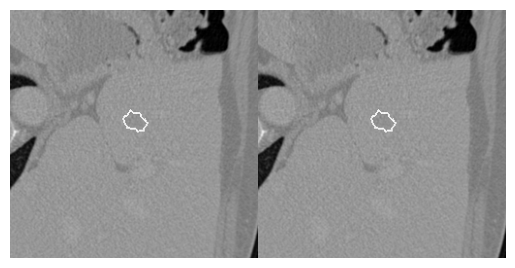

135
84
1.0002668694928258


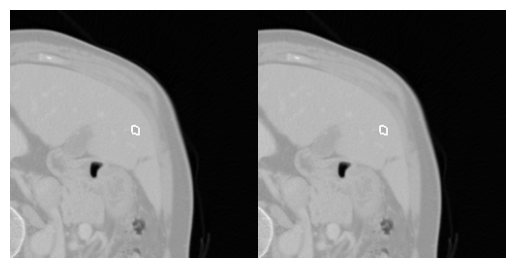

136
80
0.6050034585900116


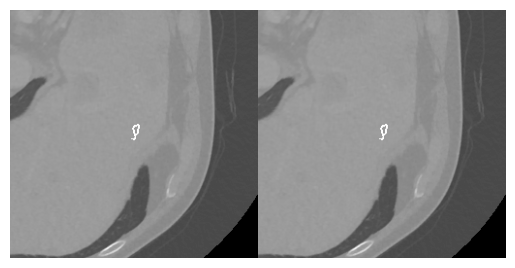

137
249
0.9028597417408974


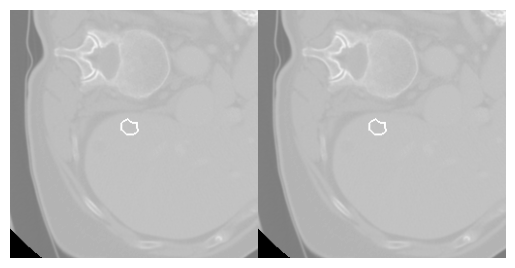

138
7511
0.527707880790635


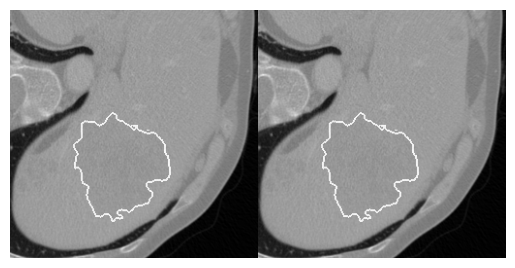

139
128
0.42303005642757036


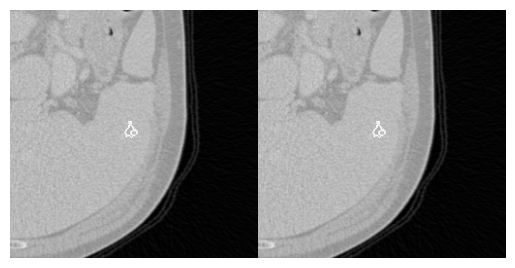

140
114
0.6426696314792301


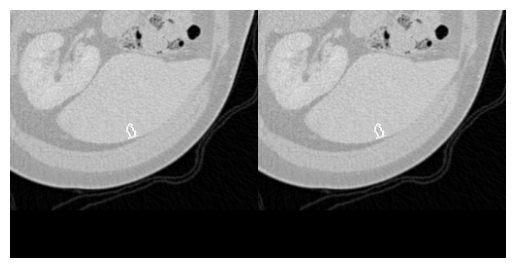

141
93
0.584164777721802


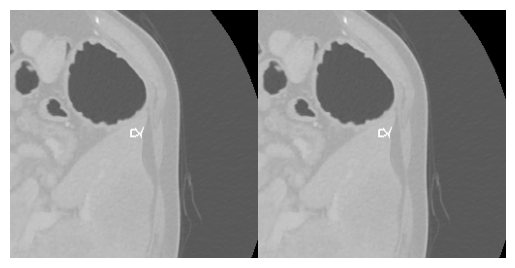

142
25
0.8422063819572613


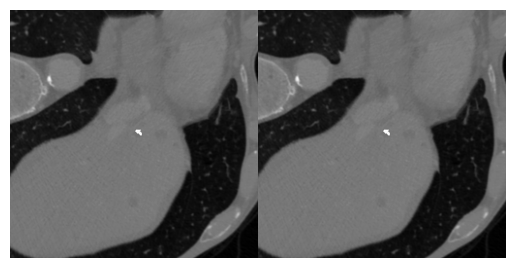

143
2540
0.5531820680852254


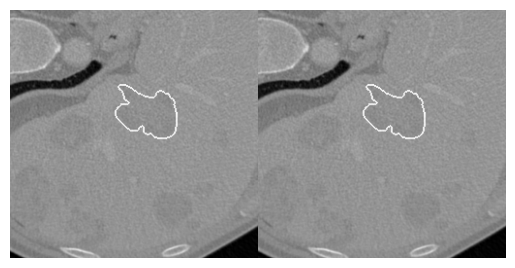

144
121
0.5095348610841431


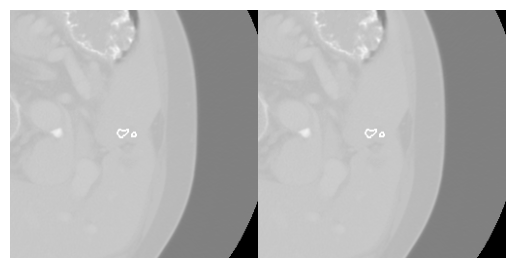

145
413
0.9081122543664202


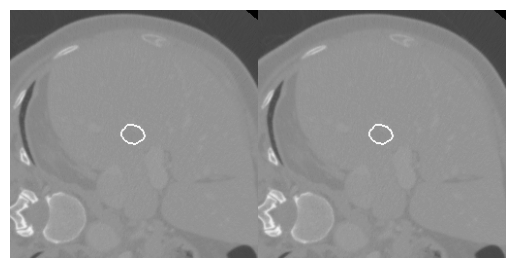

146
2798
0.3305405386365528


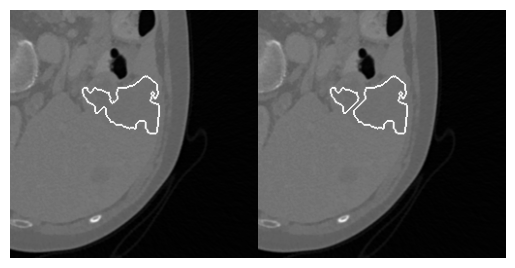

147
1311
0.7777735224842364


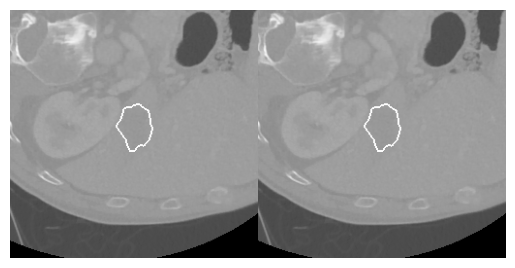

148
148
0.5304378001893961


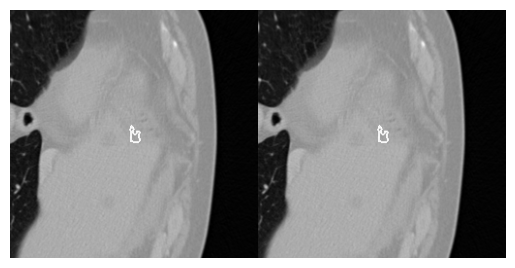

149
142
0.9405789752347541


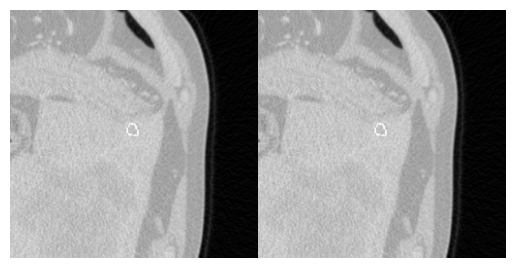

150
175
0.8721919120796641


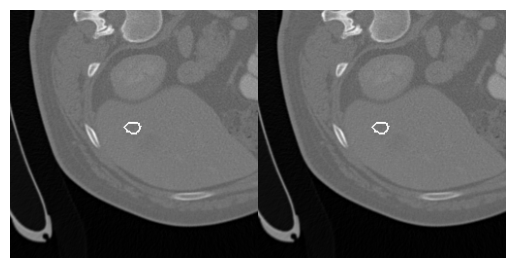

151
246
1.0140493252248546


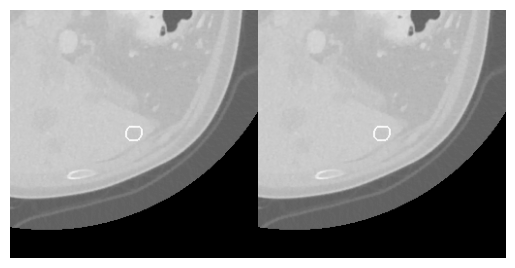

152
97
0.717643660258459


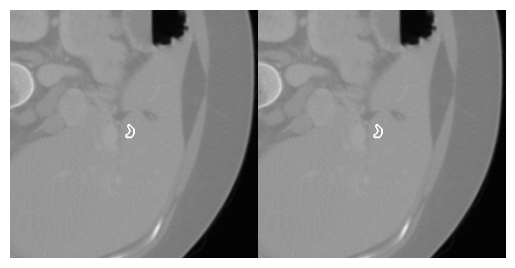

153
62
1.1106887454723964


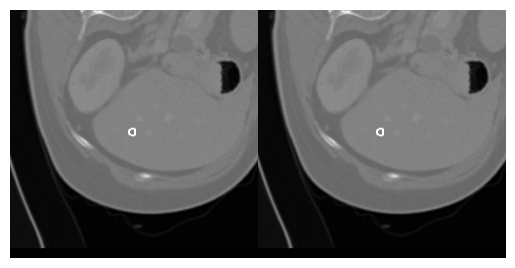

154
1783
0.7926786701667391


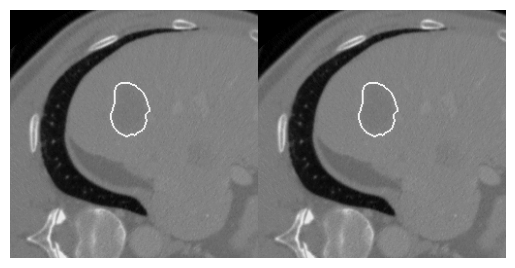

155
325
0.48897603379495524


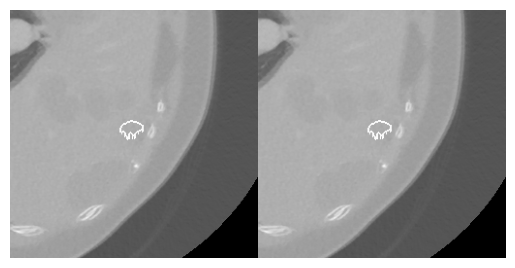

156
498
0.7941657338976873


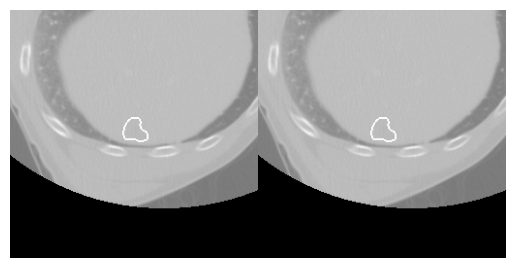

157
534
0.8313916073197696


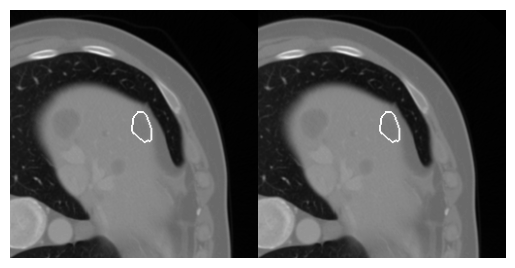

158
38
1.137914400511144


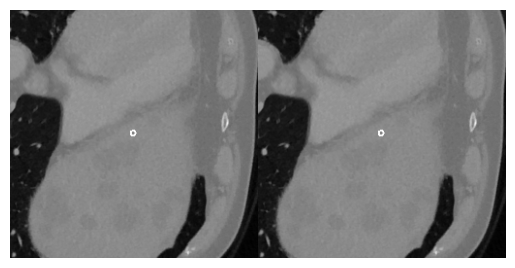

159
7042
0.8689569694036342


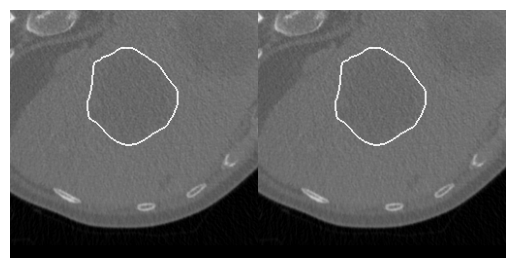

160
44
1.017278384386991


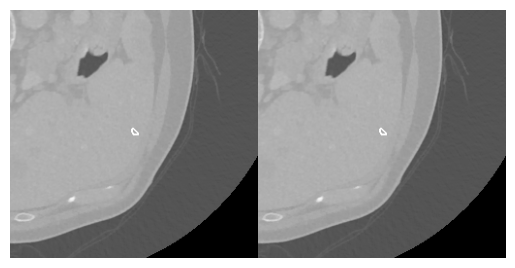

161
387
0.8251688205454906


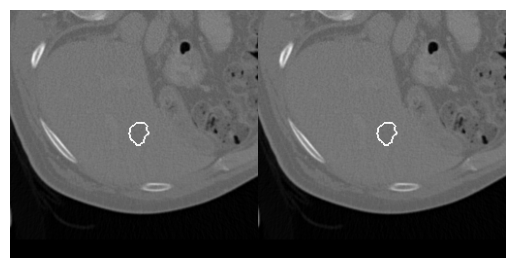

162
54
1.1318618593521355


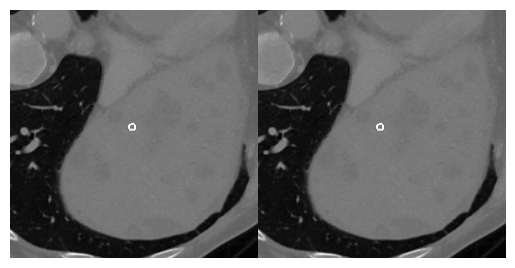

163
127
0.9395953077610752


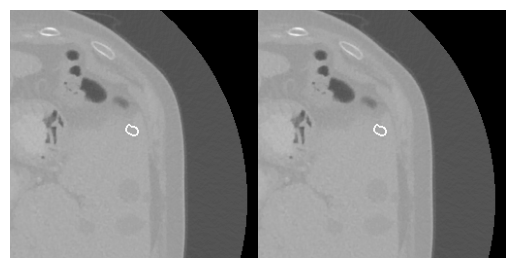

164
83
0.9737581192837734


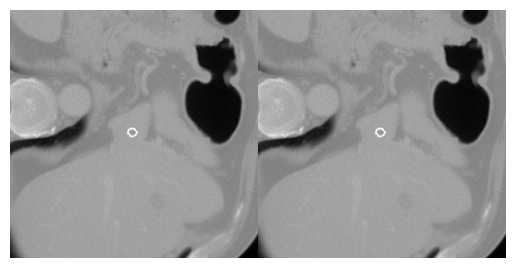

165
20
1.2389643882700017


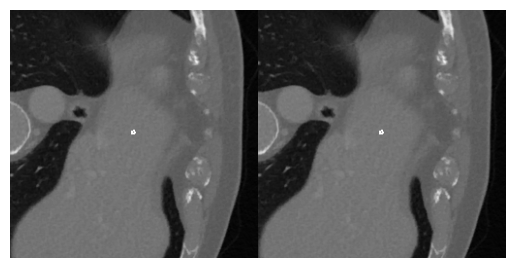

166
137
0.7803310789409964


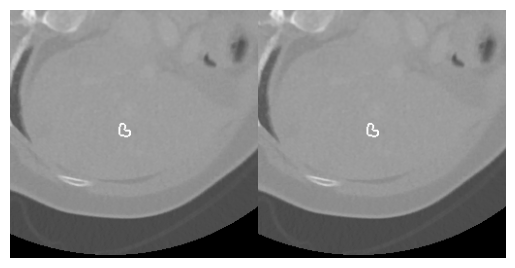

167
896
0.6213869218098383


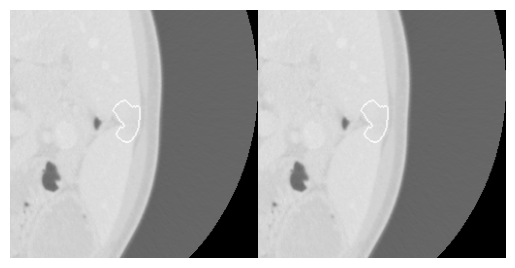

168
418
0.885660266358223


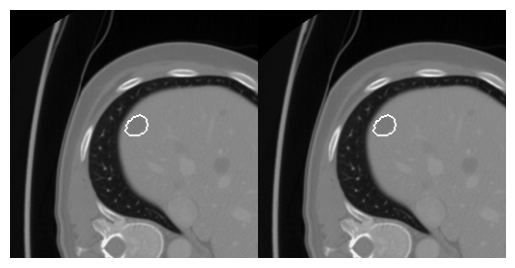

169
138
0.584790032332224


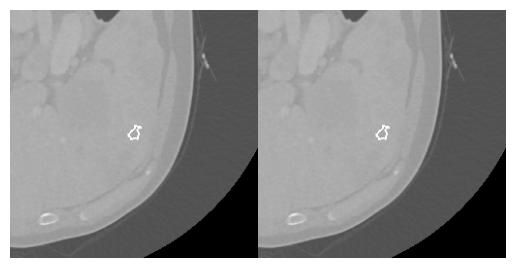

170
43
1.0460654464067178


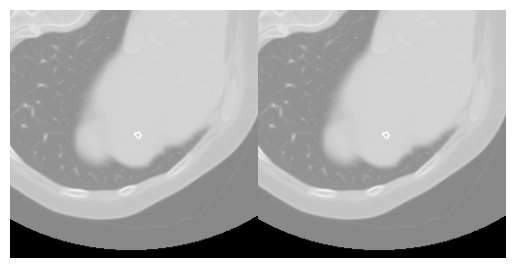

171
100
1.0076813214971339


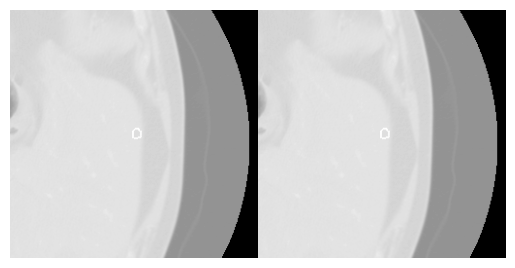

172
101
0.5499152448485018


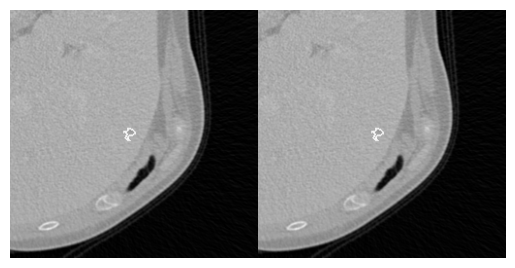

173
25
0.9193856936786334


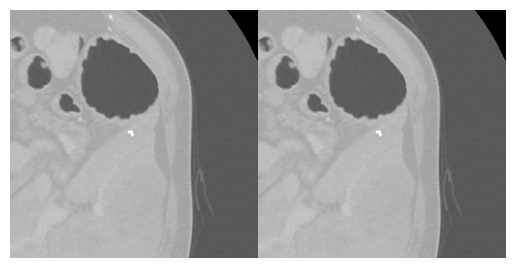

174
1319
0.7264257192636857


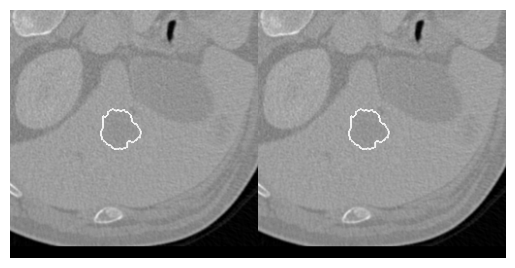

175
365
0.9311708872848571


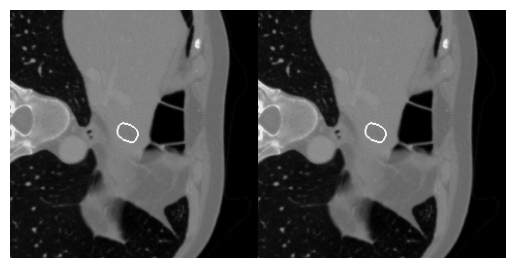

176
88
0.9169273771200884


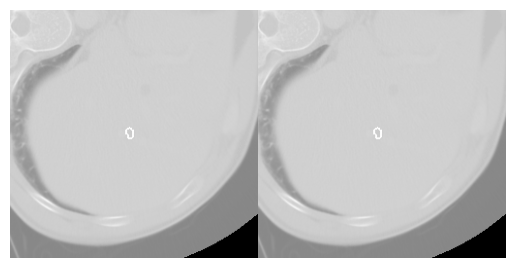

177
56
1.0490961686437295


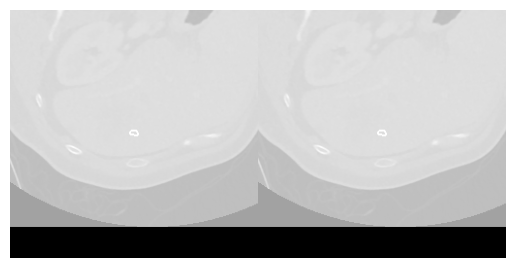

178
255
0.8677167205027598


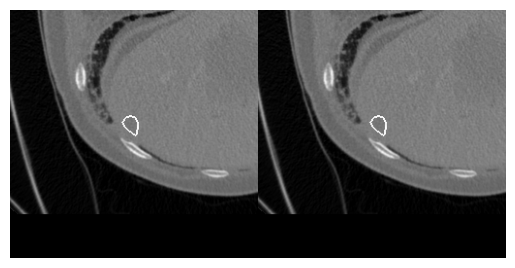

179
180
0.9565770709465284


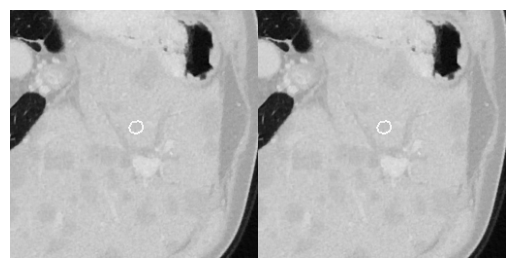

180
3
inf


/var/folders/x5/24949l4x02j5jtrqrp1bjr9h0000gn/T/ipykernel_43253/907209794.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  largest_circularity = (4*np.pi*regions[largest_region].area)/\


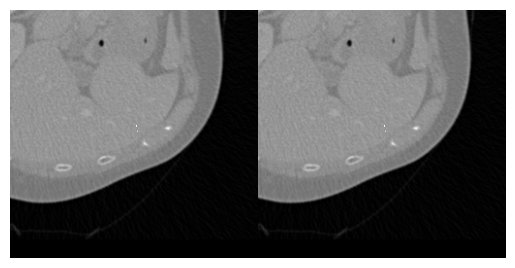

181
43
1.1894885778814956


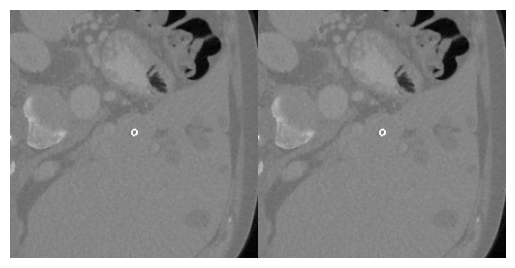

182
45
1.1184735665493388


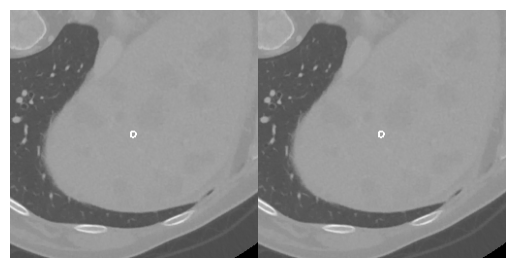

183
31
1.249524838656446


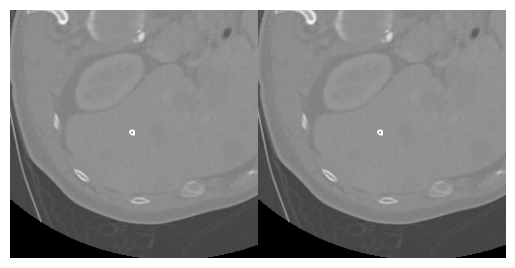

184
300
0.971794292320327


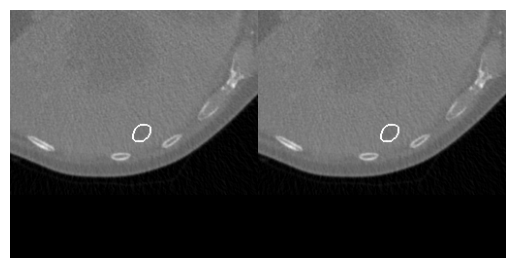

185
121
1.0319940804754968


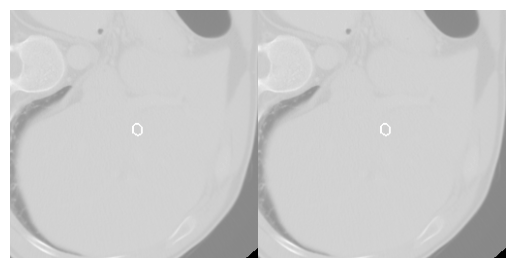

186
98
0.9427755634815644


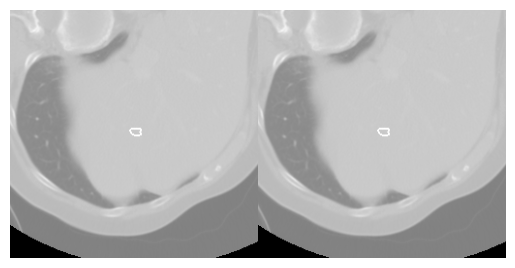

187
48
0.8336098733656229


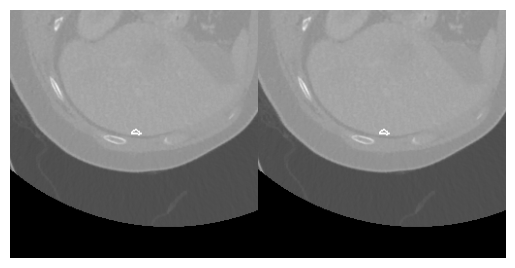

188
395
0.7608720044365126


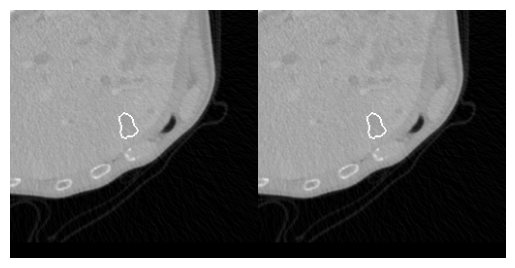

189
77
0.8718758064613388


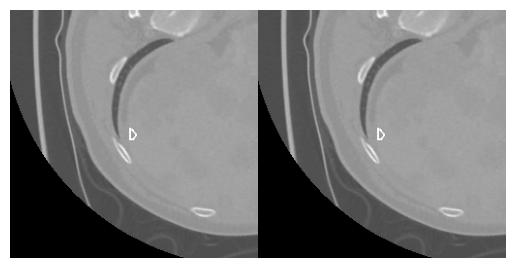

190
193
0.9685103548662044


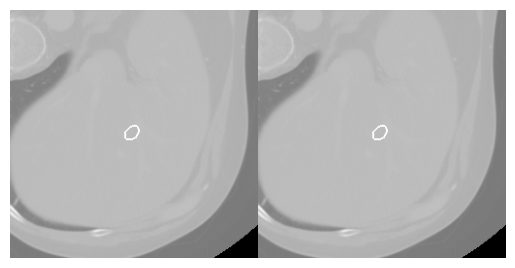

191
85
0.8666648945701504


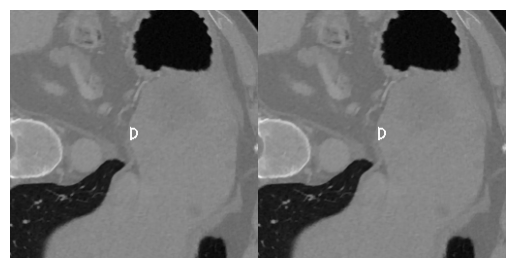

192
99
1.0315432992600997


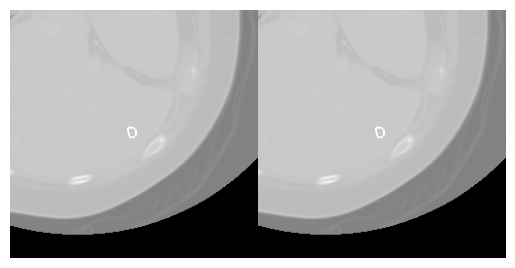

193
89
0.9273470064055445


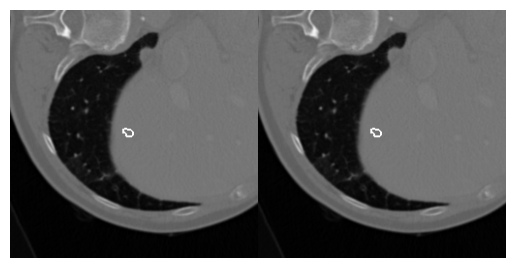

194
676
0.7418054661112066


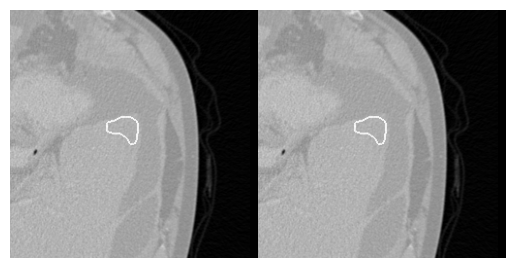

195
367
0.9627156403345346


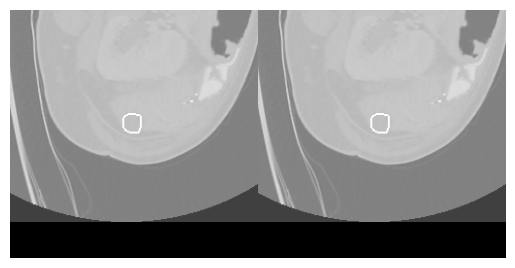

196
2514
0.5489524867720903


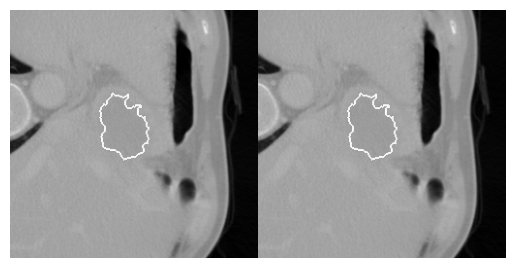

197
75
1.0788710755509403


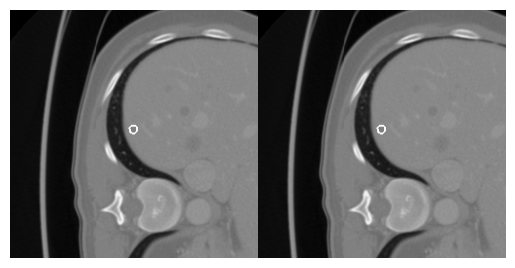

198
174
0.9182003367035315


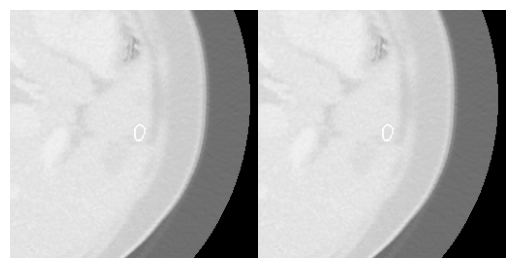

199
1888
0.4659445493422499


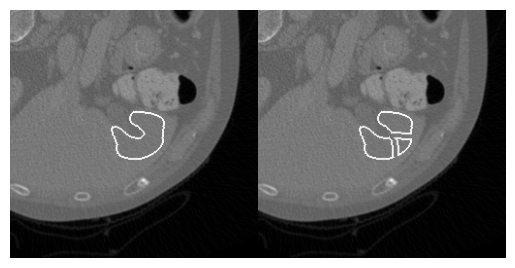

200
413
0.7078385784205792


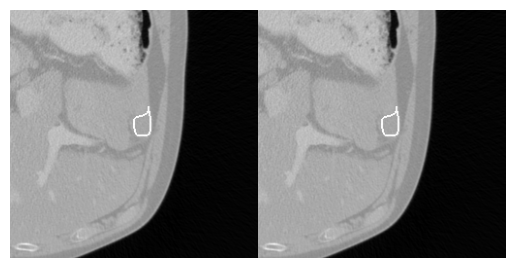

201
88
0.9680217026904686


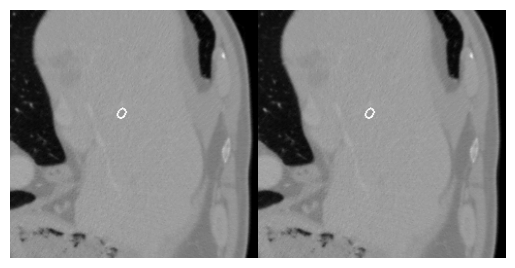

202
53
0.764238722998842


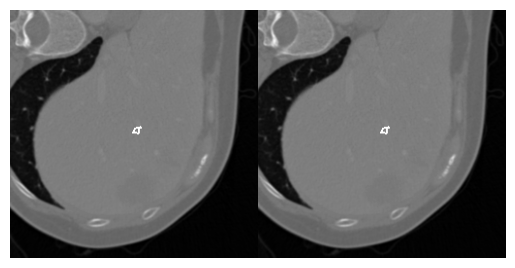

203
71
0.8454636634998889


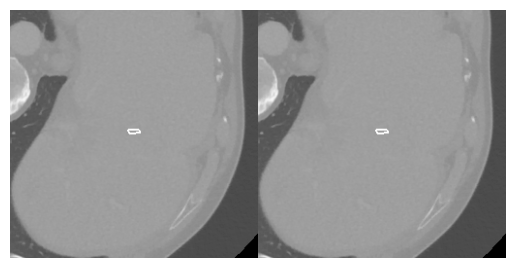

204
399
0.4272854784427697


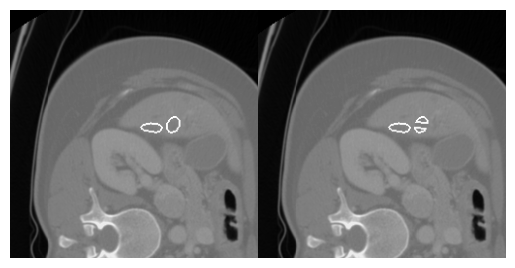

205
67
1.0894984985348972


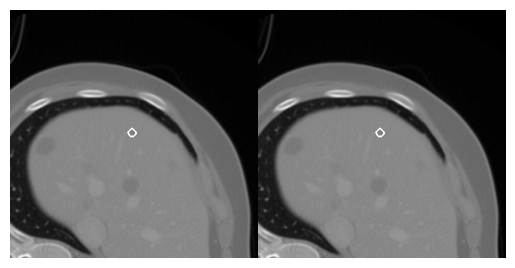

206
1321
0.9133996502285118


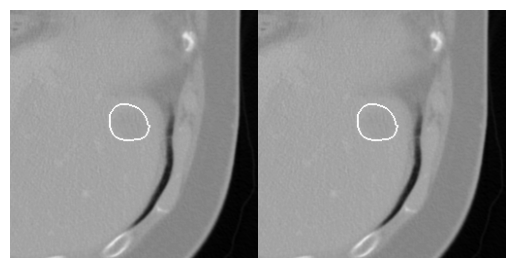

207
2246
0.40240835322845625


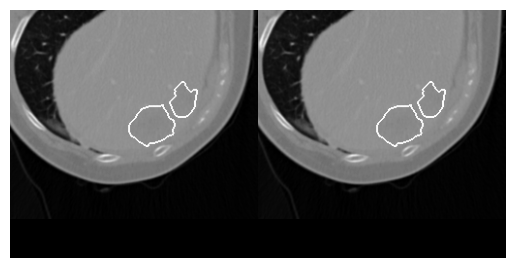

208
83
0.8947600601913944


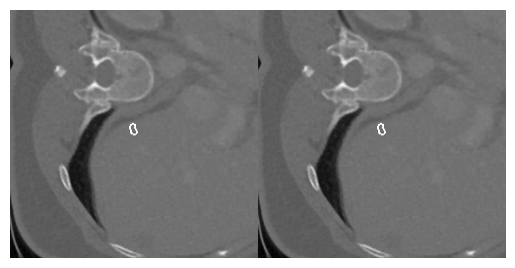

209
153
0.9319682188107398


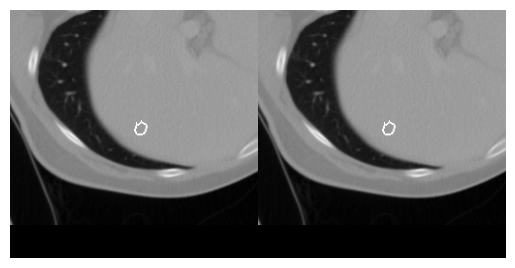

210
1220
0.9073988245188184


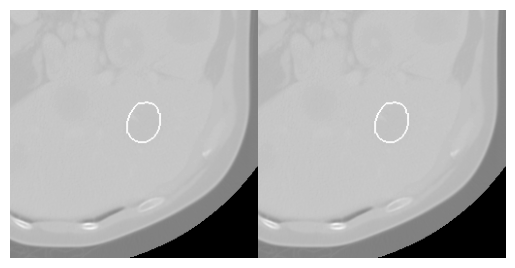

211
352
0.9260551014395719


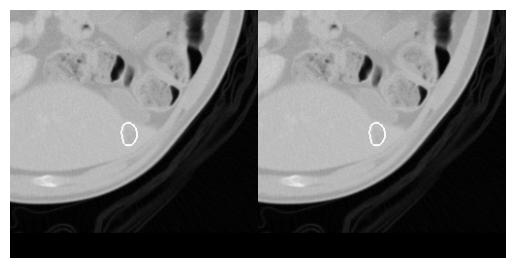

212
605
0.6321164539443334


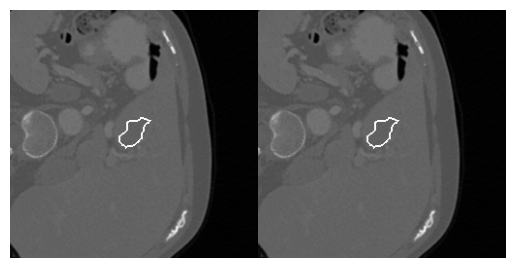

213
236
0.6749955275889037


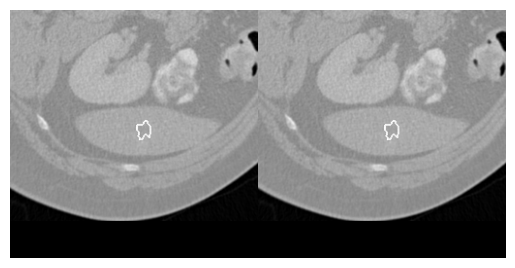

214
41
0.6906092332049542


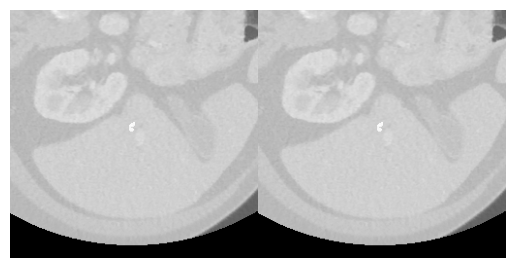

215
34
0.9109573275738239


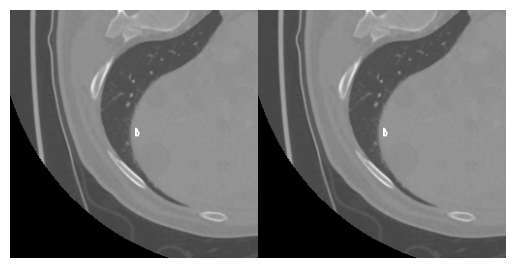

216
23
0.9681485151413707


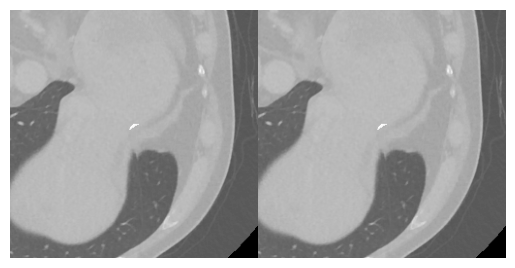

217
93
0.8827818470301629


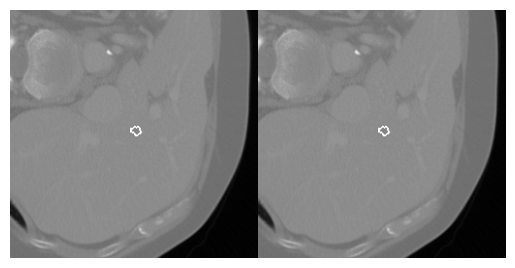

218
280
0.5611714749950065


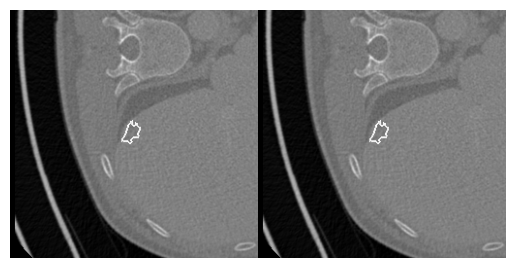

219
119
0.928016883828379


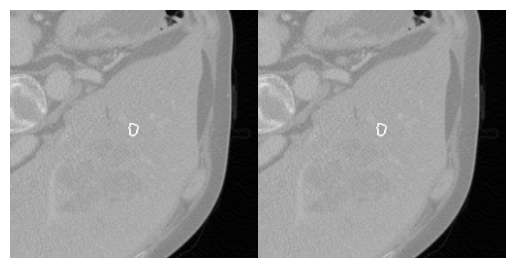

220
246
0.8993804647884308


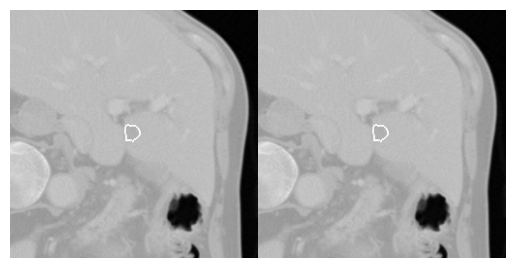

221
30
1.0365281423822896


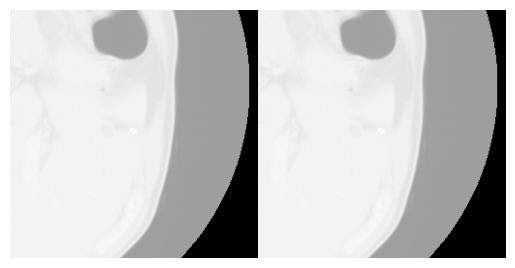

222
62
1.0710790804616992


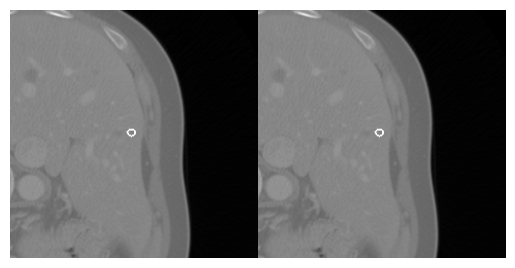

223
56
0.960256194713113


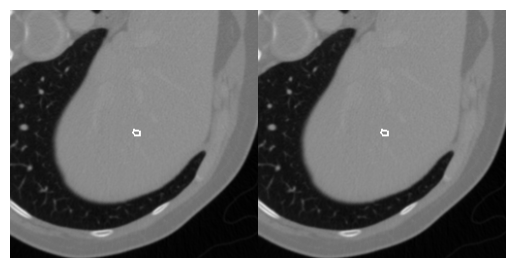

224
6552
0.5810414394235425


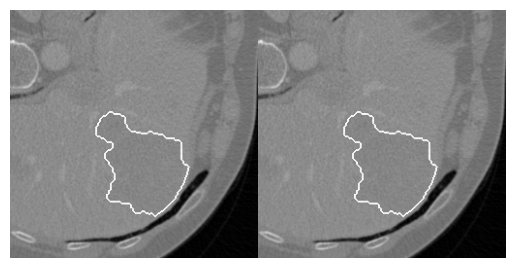

225
32
1.078024168905294


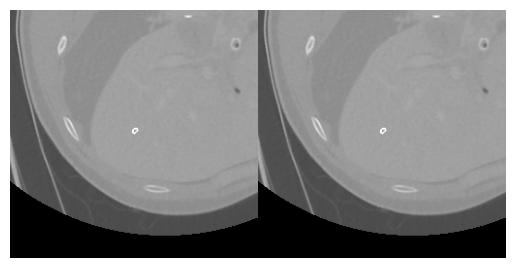

226
93
0.7931855329274478


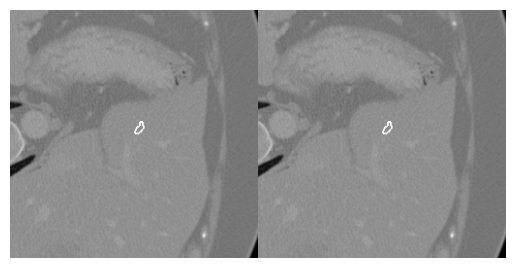

227
126
0.8958211382304695


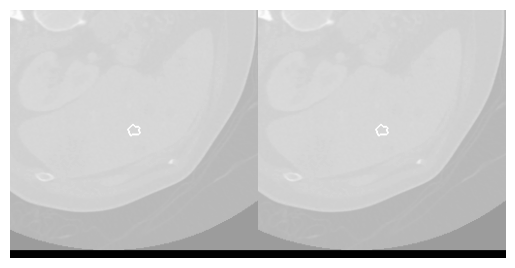

228
44
1.0936185984037976


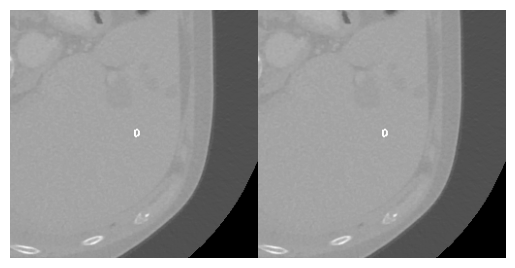

229
118
0.8254144744360962


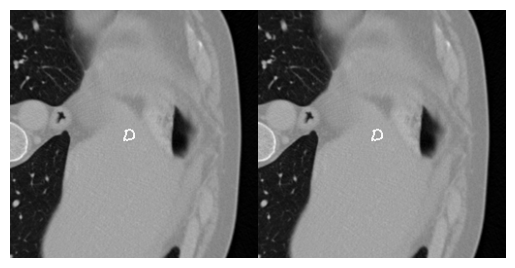

230
1181
0.9158557525244602


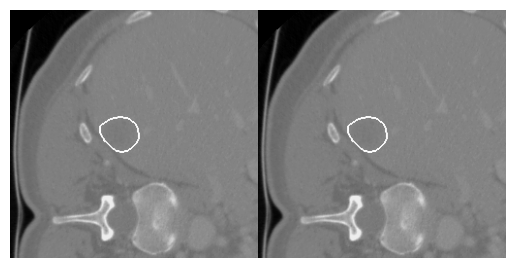

231
526
0.7196086501061901


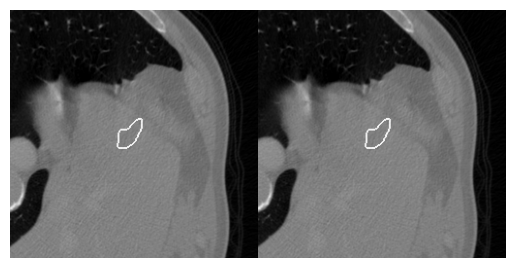

232
54
1.109758237513081


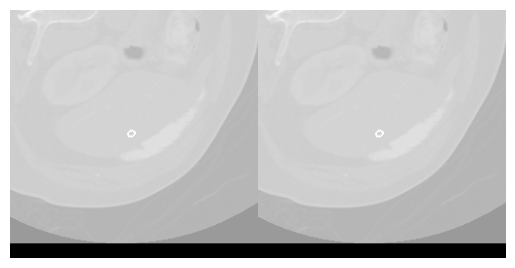

233
59
1.1052977491067861


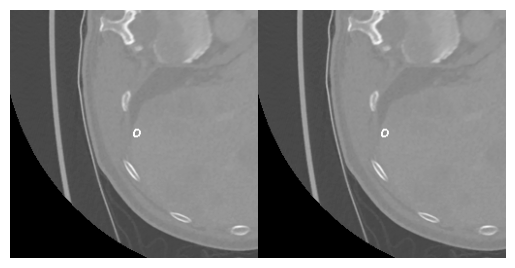

234
72
0.9432876901559162


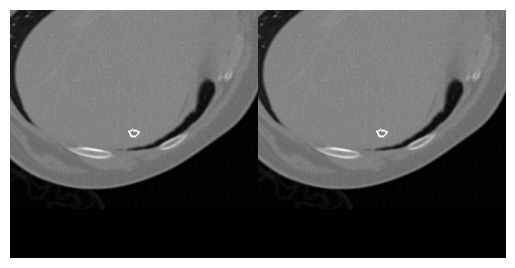

235
4160
0.784085266180254


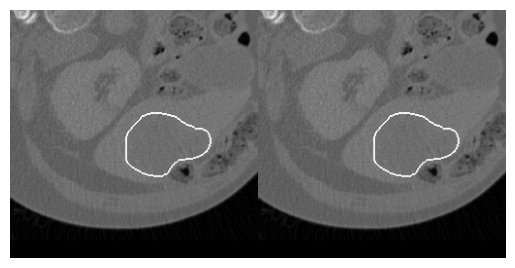

236
61
1.0927744108680026


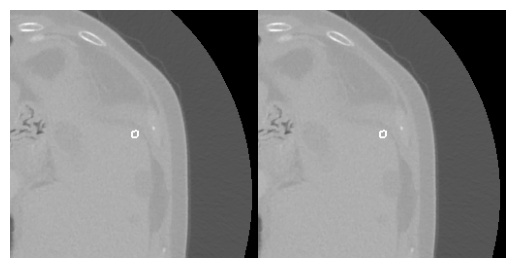

237
6
1.8326278532479736


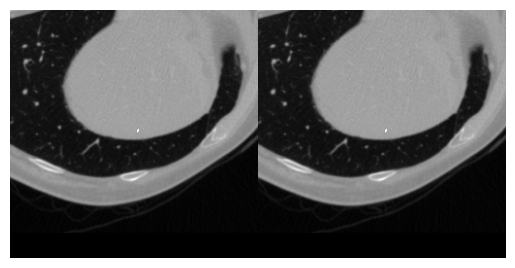

238
134
0.9266945897448862


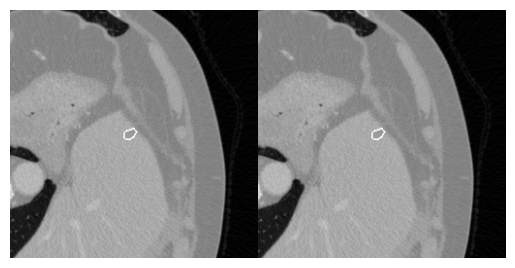

239
75
0.8669986230570945


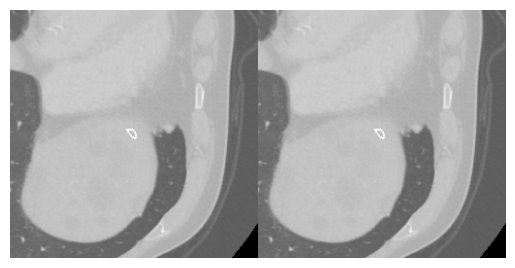

240
209
0.9570749791692509


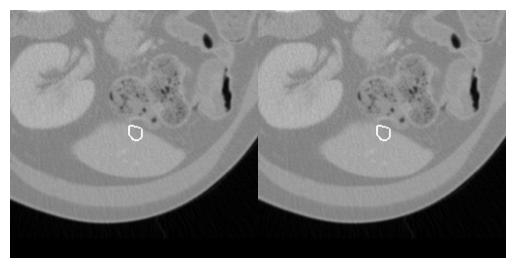

241
87
0.985106430677097


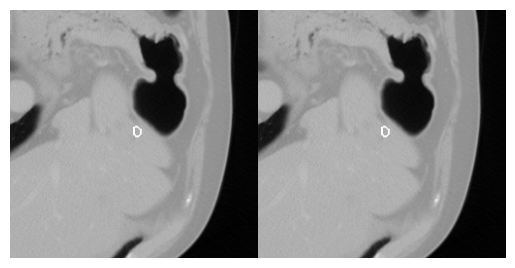

242
162
0.5055703861600135


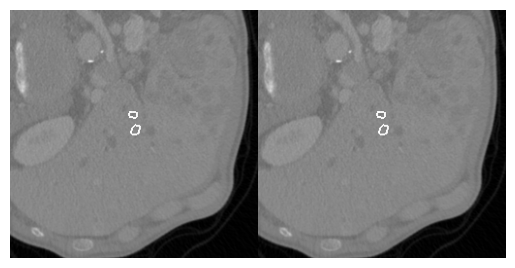

243
1662
0.7931956491753671


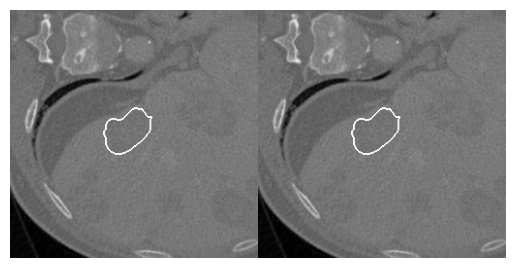

244
162
0.6465506774042351


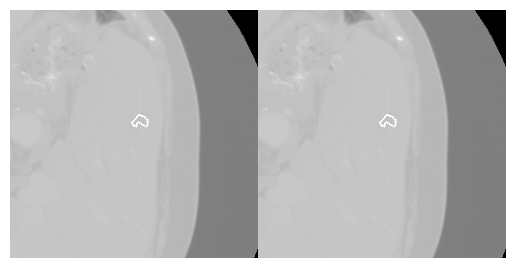

245
150
0.7684553226326479


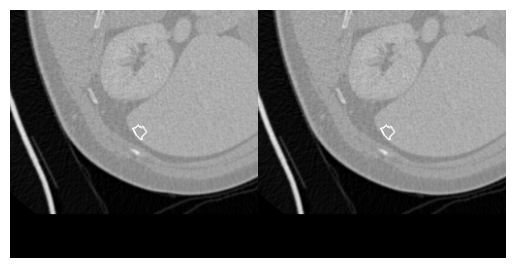

246
364
0.6812513845165404


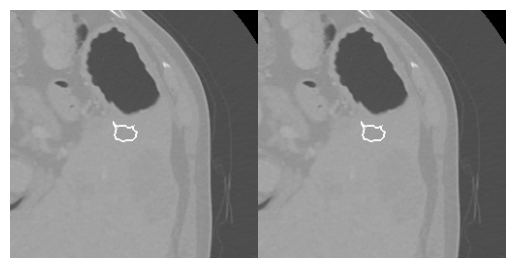

247
56
0.960256194713113


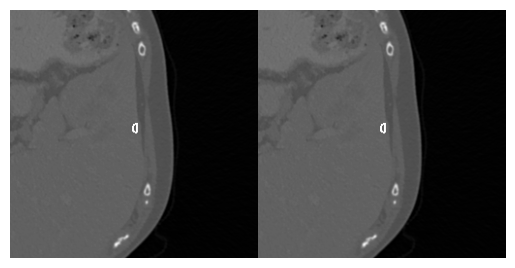

248
821
0.7927005632320999


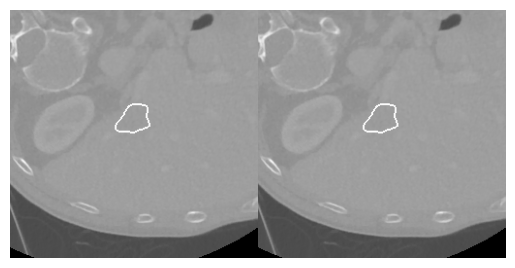

249
864
0.7198595583286497


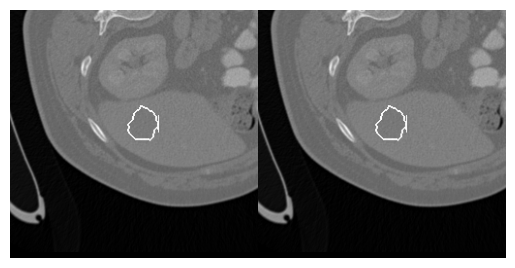

250
56
1.0982123966043793


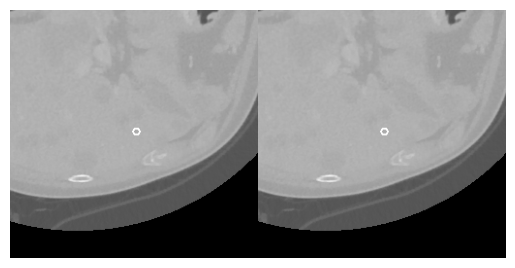

251
1738
0.6955878809396543


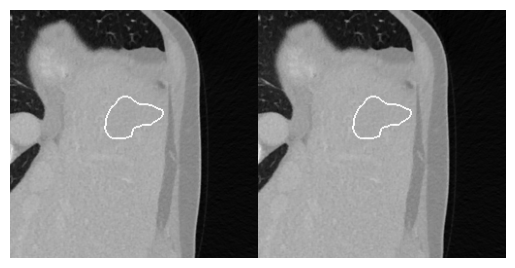

252
712
0.8129093262441501


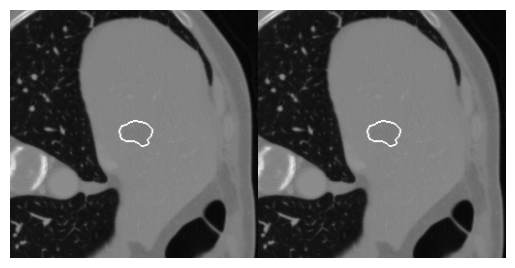

253
453
0.8212760301378044


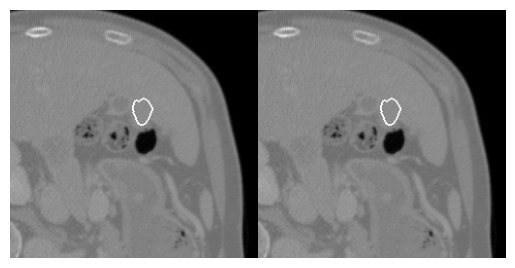

254
1243
0.8374900262183006


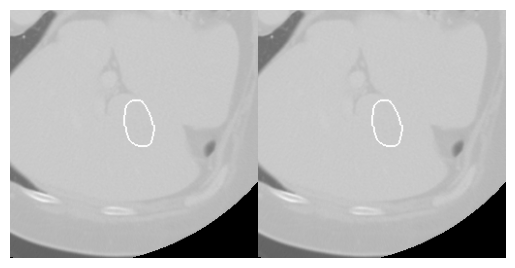

255
381
0.8175352026184601


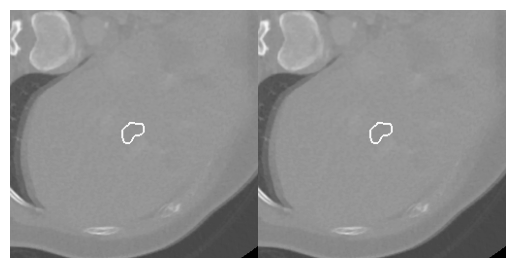

256
44
1.2171511029485071


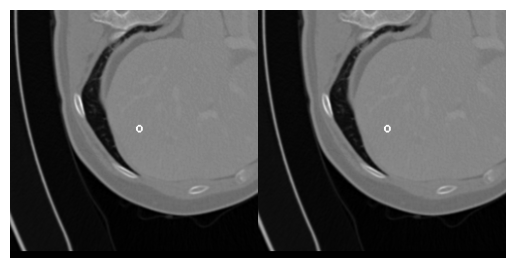

257
390
0.8653776347663333


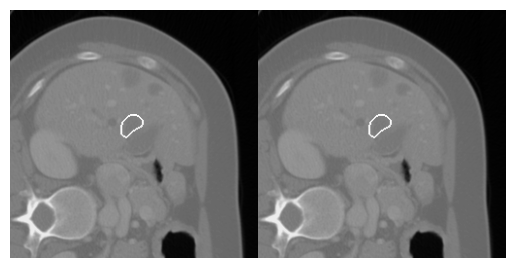

258
33
1.0732373269149738


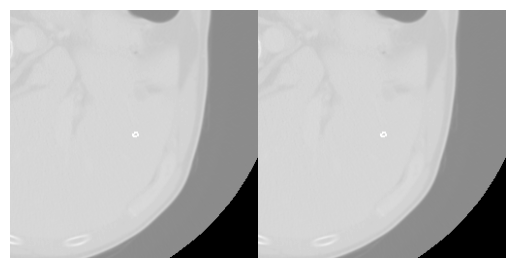

259
155
0.7537443042390118


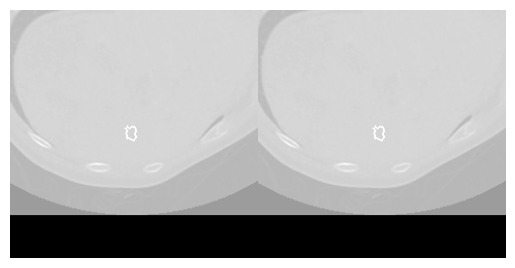

260
4862
0.7671595688165055


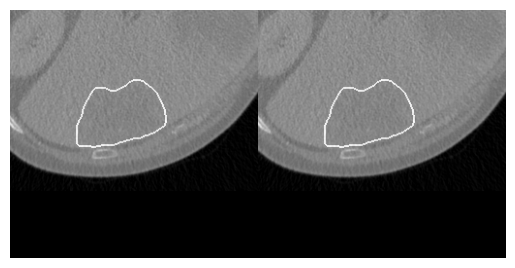

261
959
0.7318124965768048


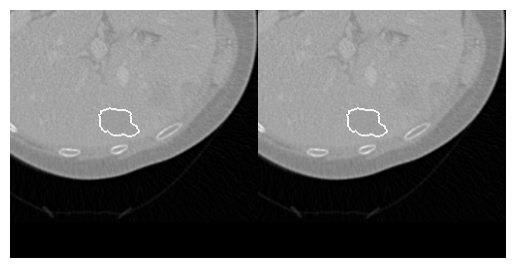

262
114
0.5192194786117761


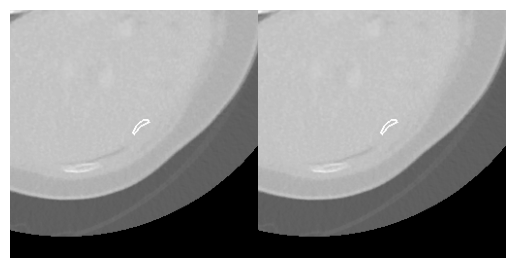

263
293
0.4874399405698322


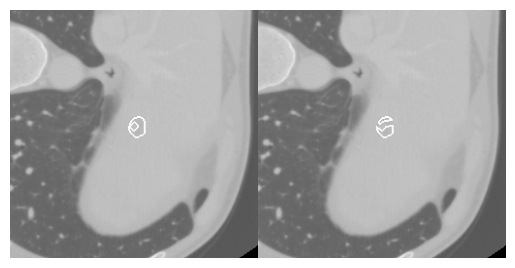

264
31
1.0710790804616994


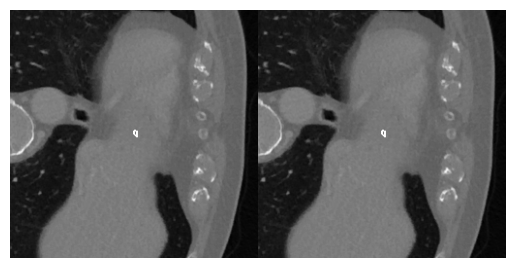

265
270
0.8148766342743595


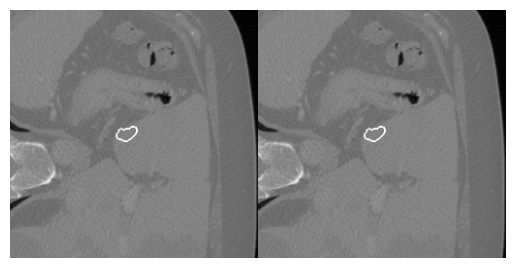

266
4
12.566370614359172


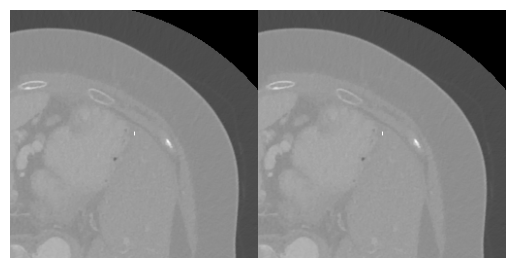

267
29
1.0240993270417402


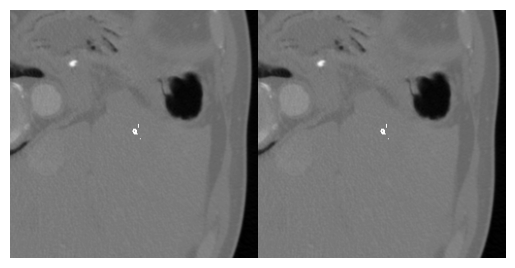

268
154
0.6968420148448133


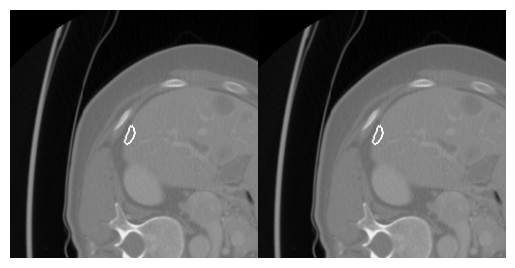

269
470
0.8402311051246727


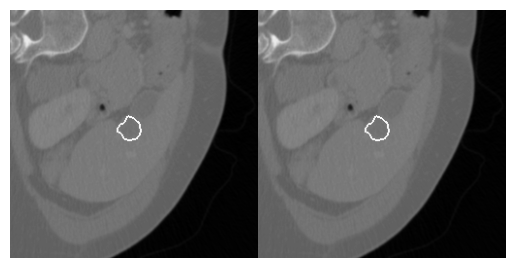

270
898
0.6963915882870156


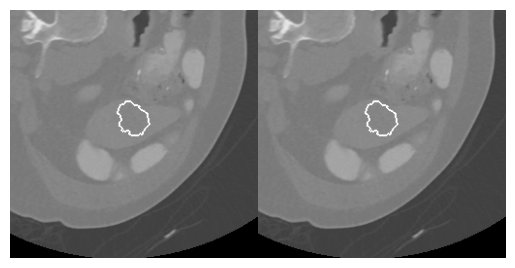

271
46
1.1433285346948796


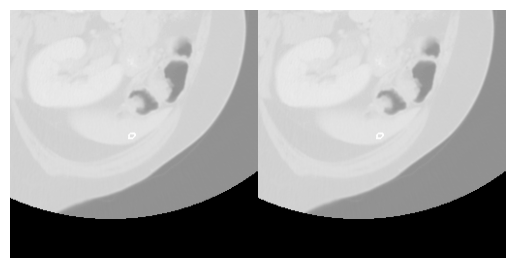

272
35
1.0236850818730105


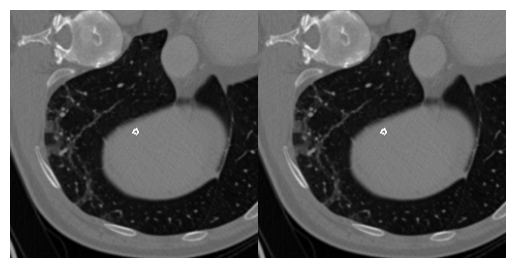

273
98
1.041606143919553


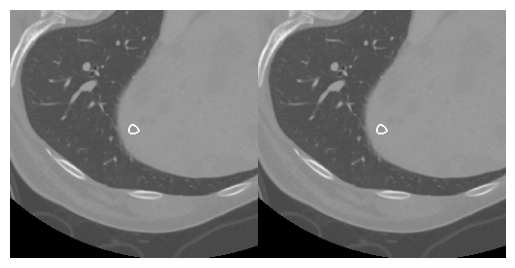

274
691
0.8568326200665589


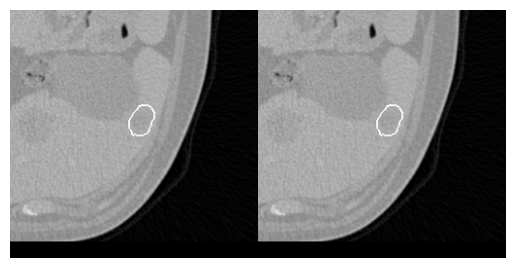

275
51
0.9087476465152069


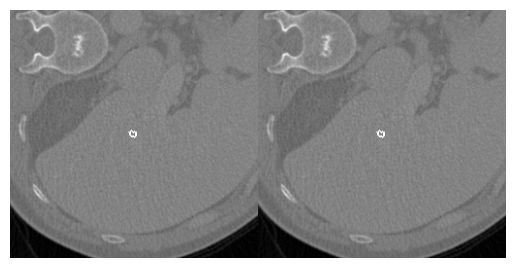

276
147
0.8167895717207155


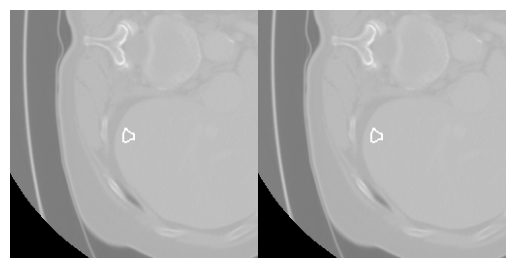

277
23
1.0955303808730954


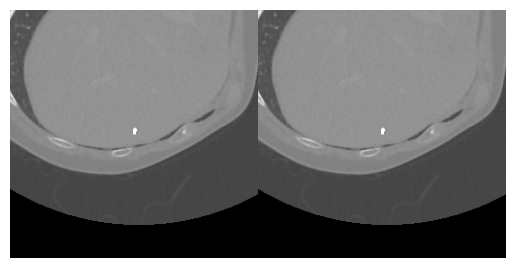

278
191
0.9546354920700177


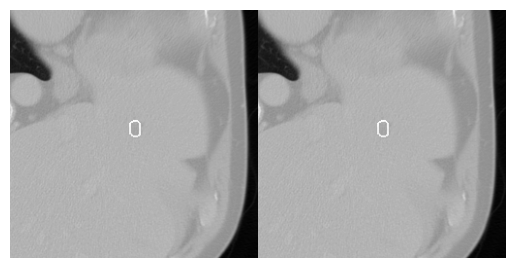

279
19
1.3268842295691072


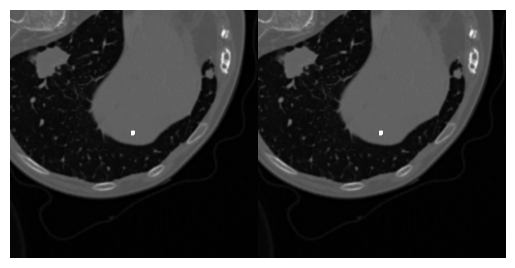

280
16
1.3414659073803088


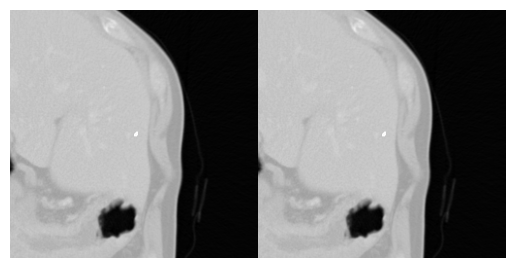

281
4112
0.4249570687184852


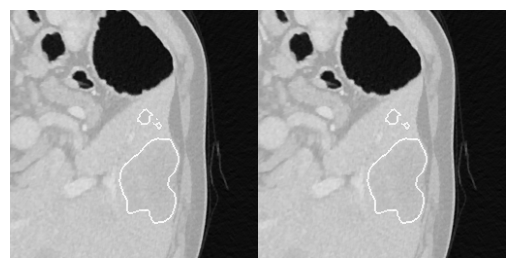

282
62
1.044335913627004


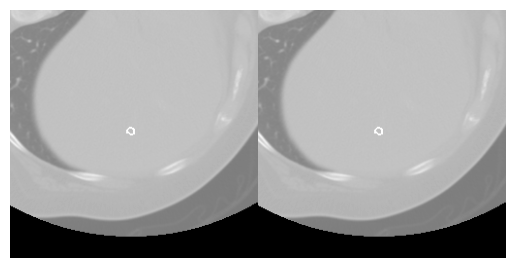

283
2864
0.8140302202281324


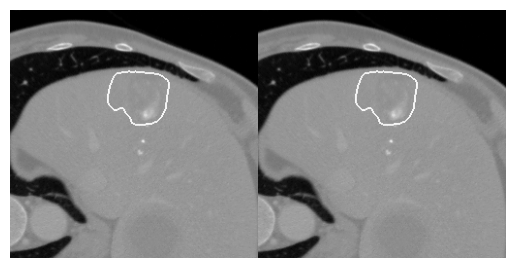

284
63
0.66297126580333


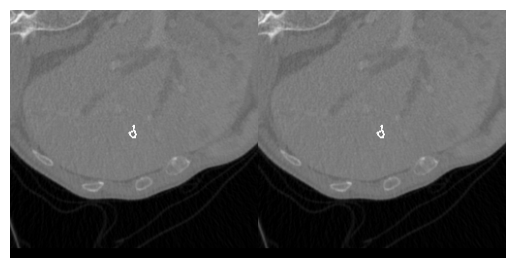

285
300
0.7475930674968546


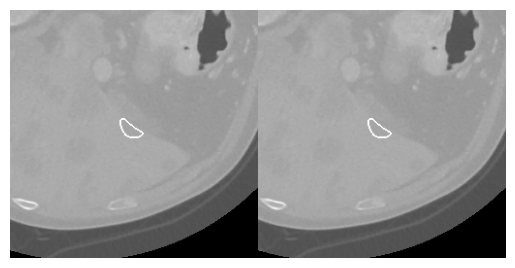

286
401
0.8874138041497296


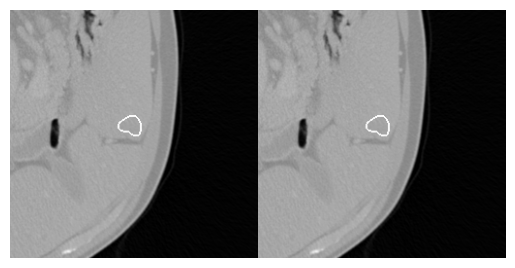

287
5834
0.40399657822894536


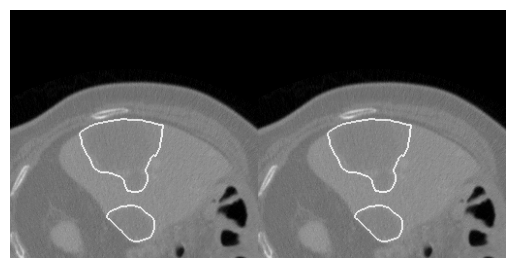

288
905
0.6723759816645531


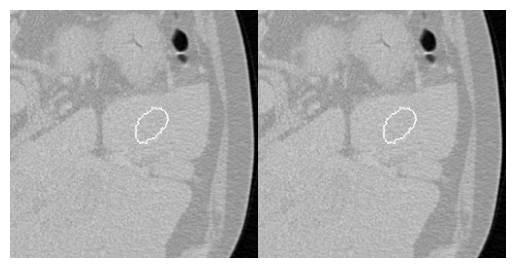

289
48
1.0144100643092022


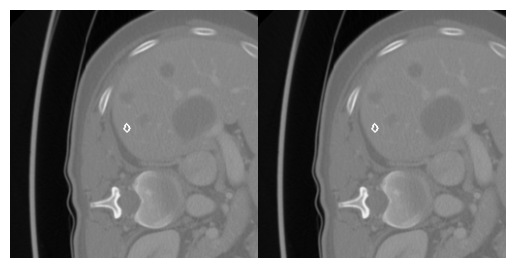

290
53
1.0393795896434308


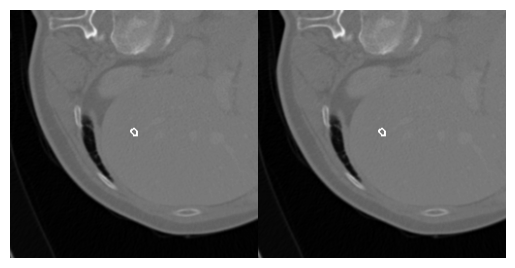

291
754
0.7218557721403788


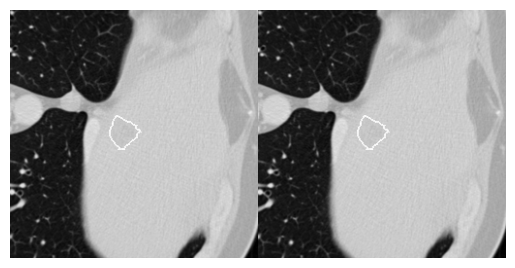

292
159
0.9525662484468735


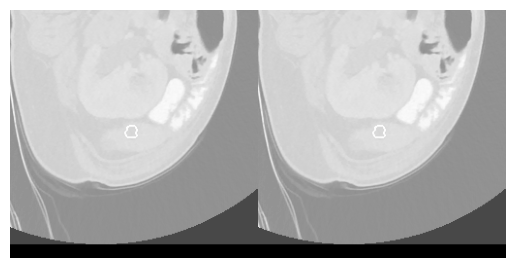

293
52
0.8250857838024525


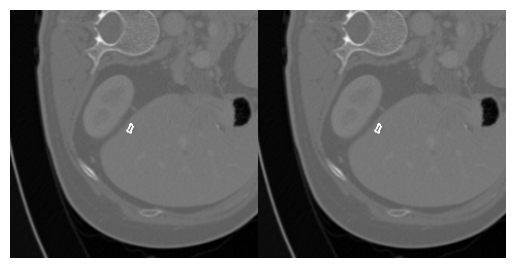

294
1056
0.6829157311582483


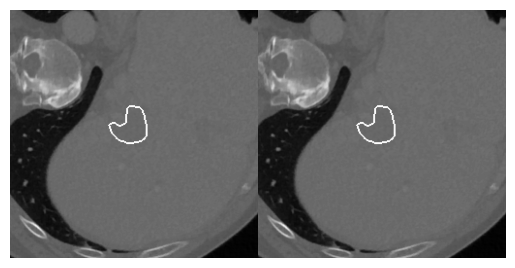

295
189
0.9944568987049947


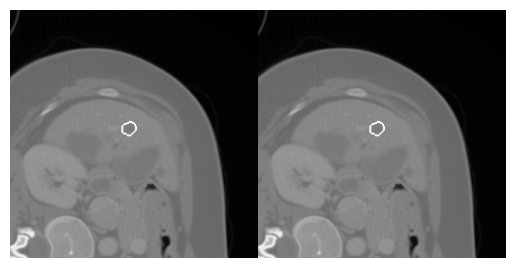

296
160
0.6972777121297646


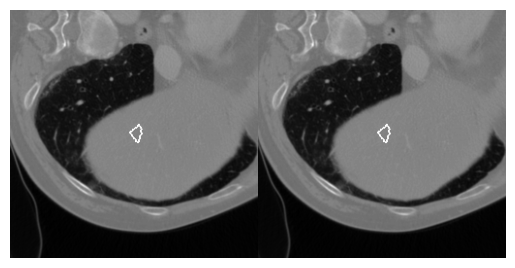

297
591
0.7851903457352754


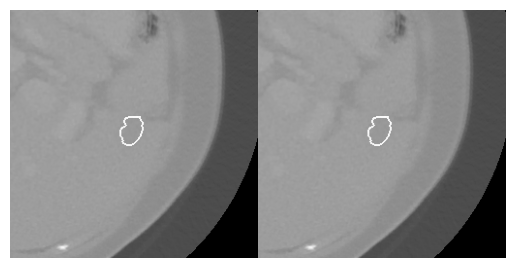

298
1429
0.7535813974946852


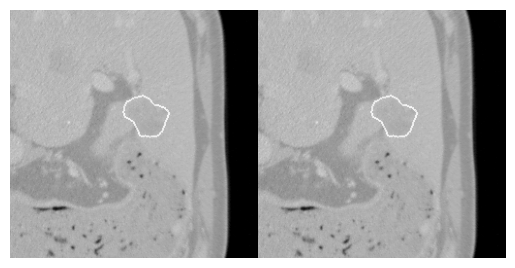

299
585
0.7513988066494821


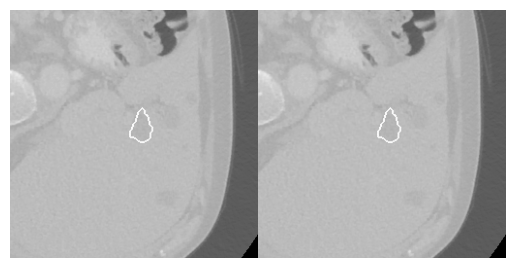

300
411
0.6569126104465728


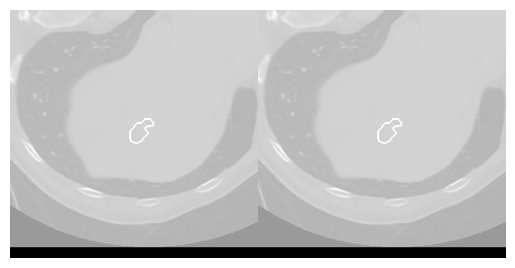

301
616
0.9061465396896613


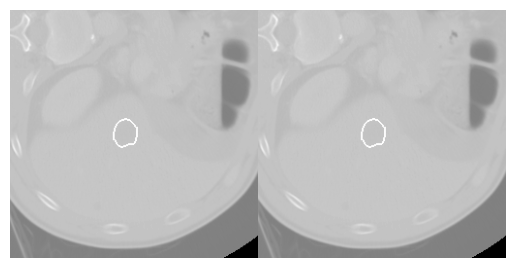

302
127
1.037884294197213


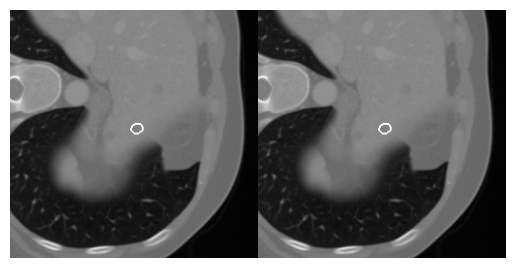

303
157
0.8786822366654216


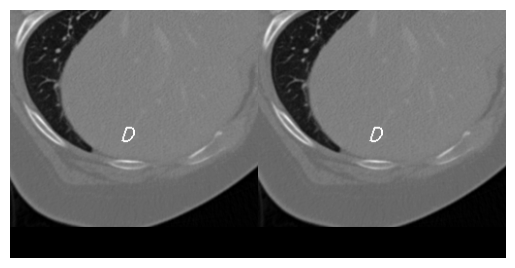

304
50
0.9544936735666534


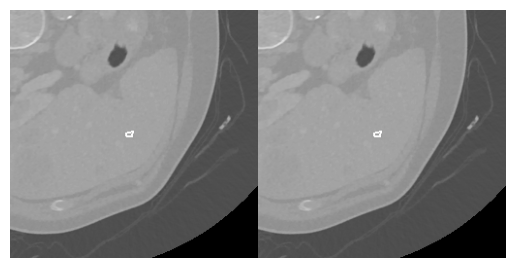

305
626
0.7725049186682582


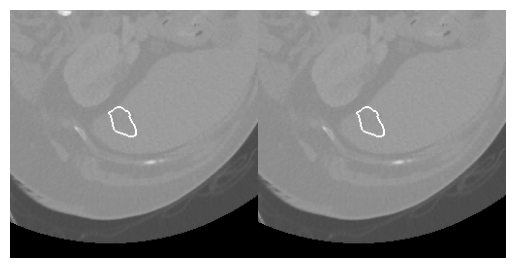

306
588
0.4957639536403189


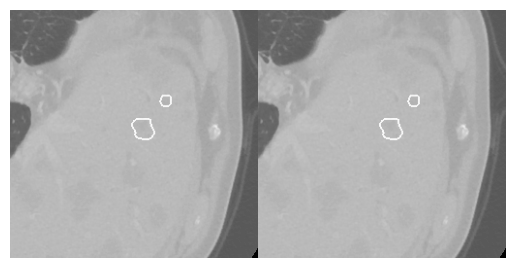

307
69
1.009061009274825


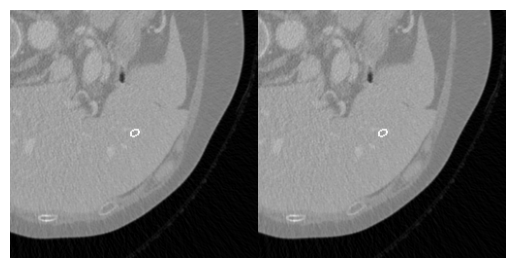

308
434
0.784933290533837


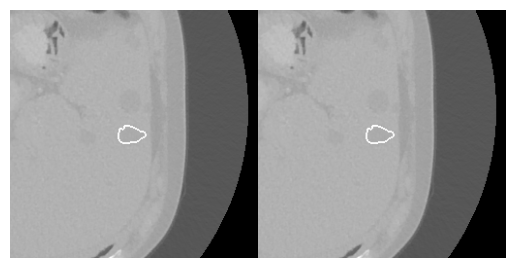

309
150
1.009411384954236


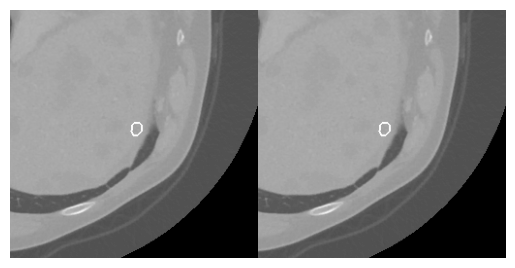

310
265
0.8887211636394546


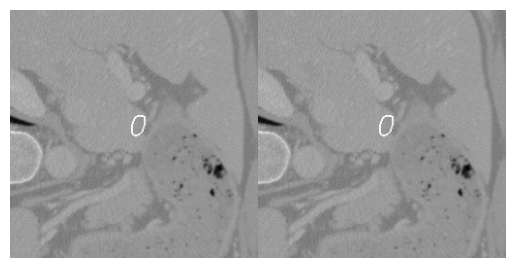

311
189
0.7050054253394485


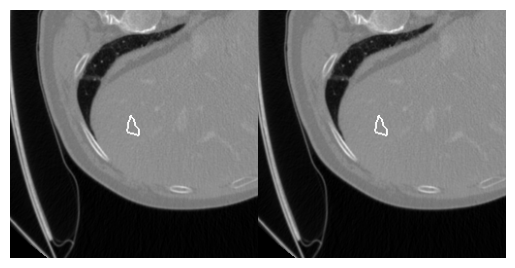

312
55
1.0303623084893772


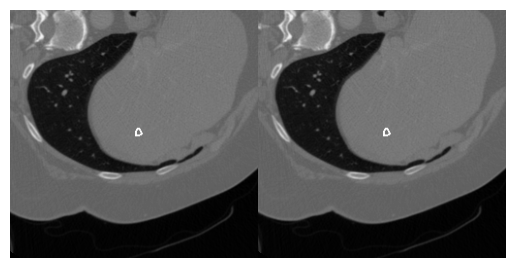

313
24
1.0349032021490827


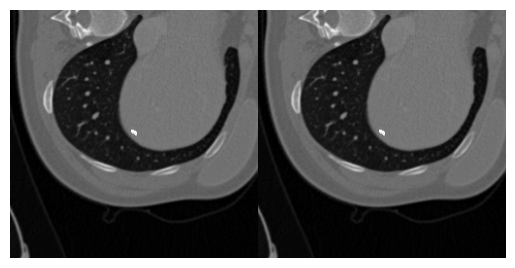

314
77
0.775914617552793


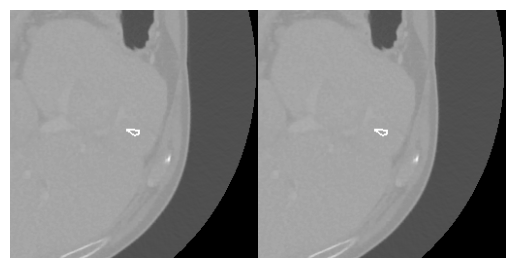

315
2092
0.7934368955807976


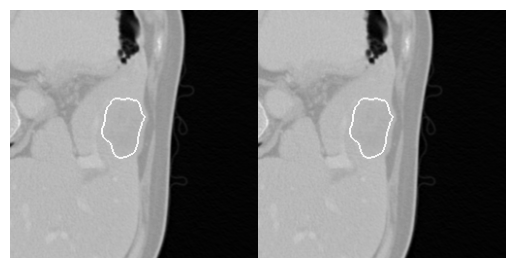

316
64
0.9359406462838954


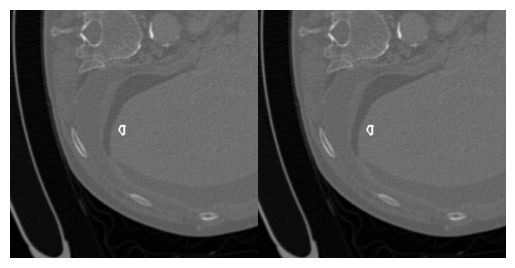

317
11
1.5596762428619324


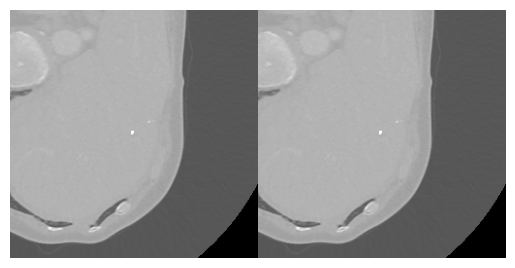

318
647
0.9418319992760459


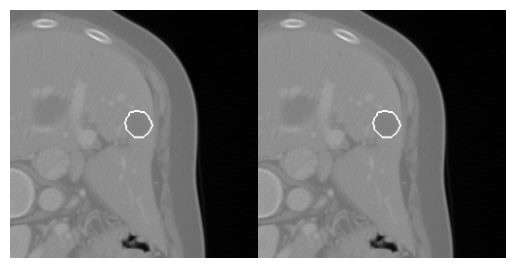

319
286
0.7058671141824978


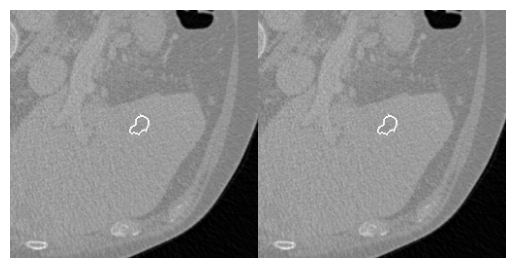

320
905
0.8504429871937986


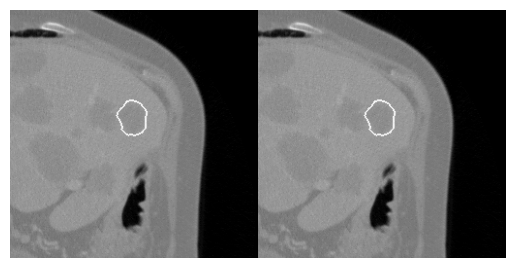

321
47
1.1681835028404202


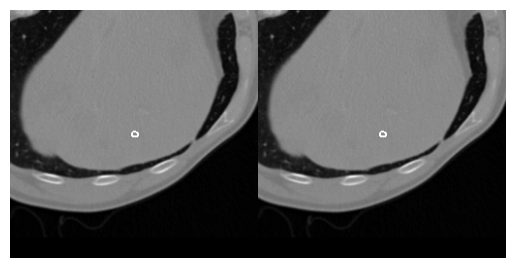

322
15
1.308996938995747


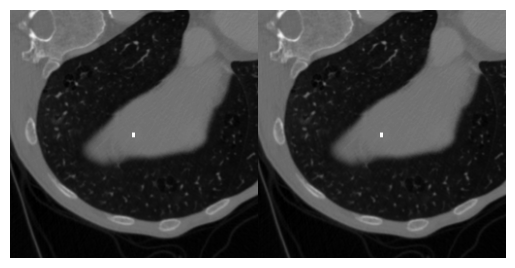

323
1195
0.6095884960828063


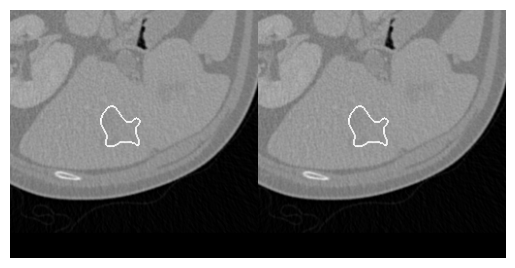

324
18
1.2127771900184563


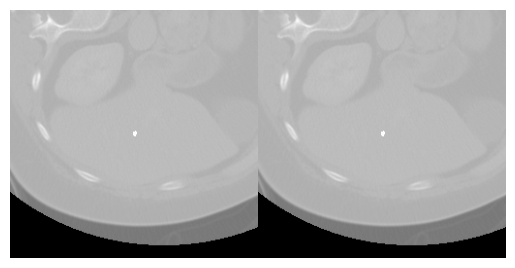

325
74
0.7865189250004789


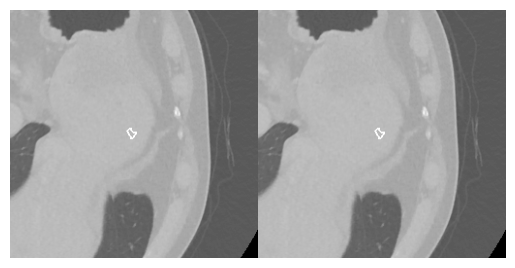

326
14
1.3503486408337697


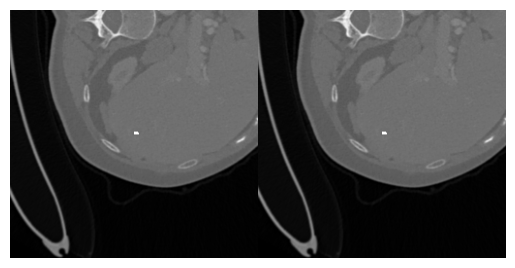

327
898
0.9329041043119897


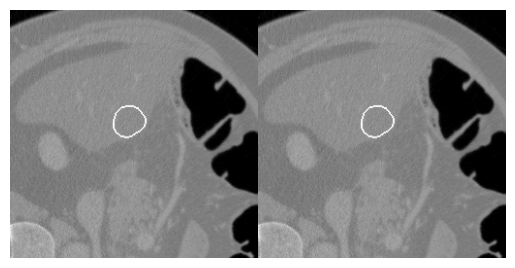

328
453
0.9312684546219071


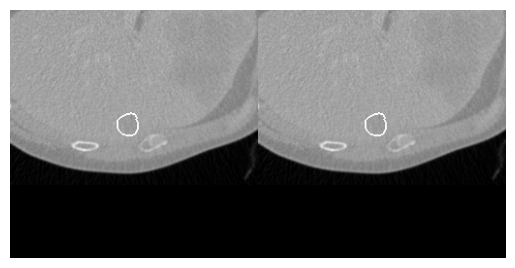

329
283
0.8450992792249264


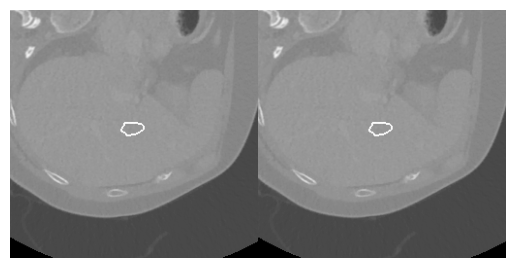

330
246
0.8868053106495997


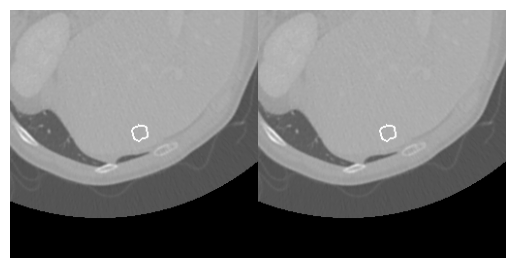

331
55
1.0786014609507297


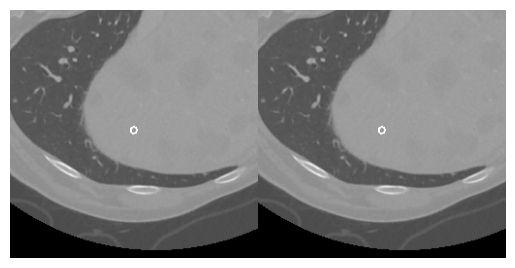

332
12
1.4373655585403924


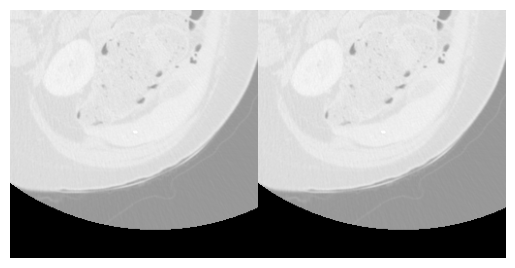

333
166
0.6505256835409945


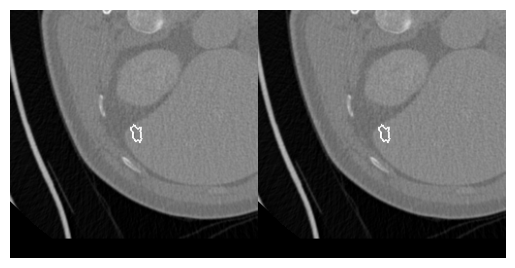

334
19
1.116838252247889


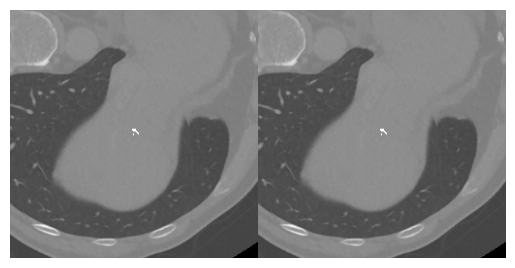

335
76
0.9956925618312449


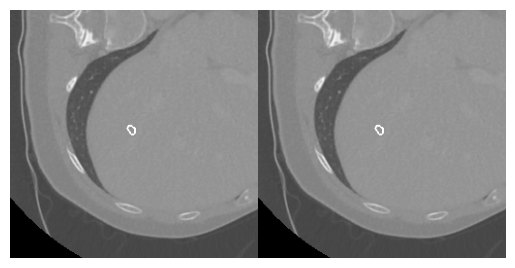

336
226
0.8781141301093558


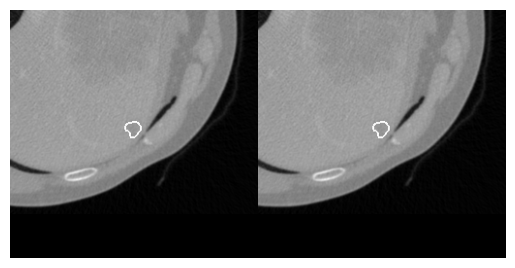

337
46
1.1790403893488046


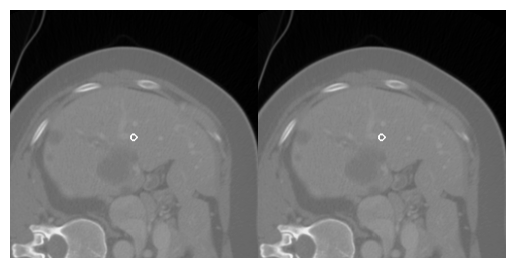

338
120
0.980678073257209


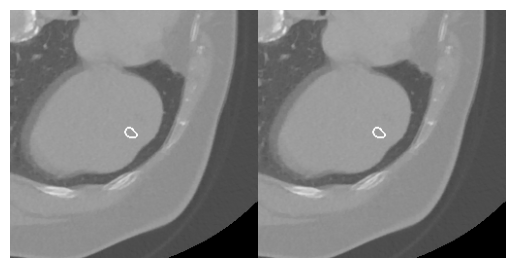

339
245
0.7587832660148994


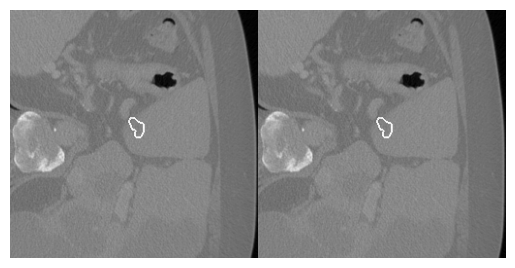

340
135
0.8518048934309731


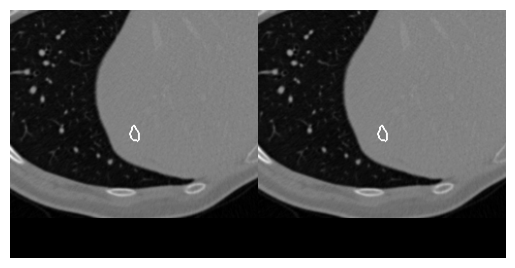

341
1416
0.7232500790271917


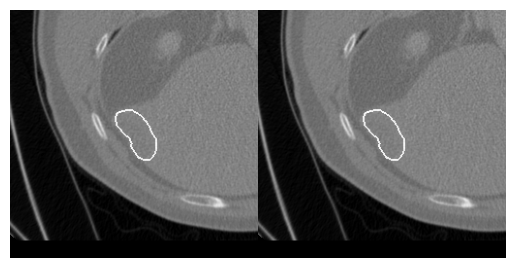

342
61
1.0274917859878592


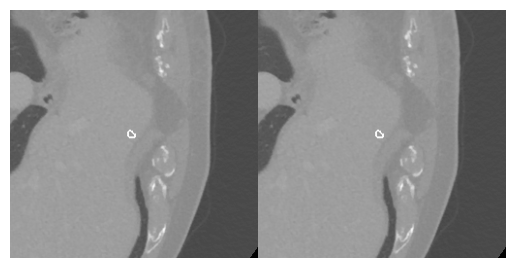

343
38
1.205894607095892


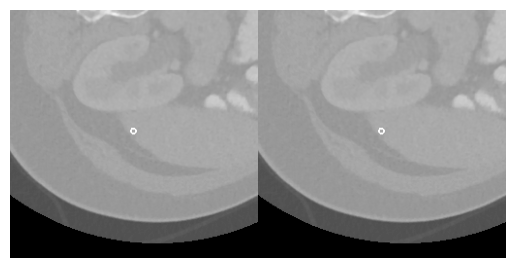

344
55
1.0786014609507297


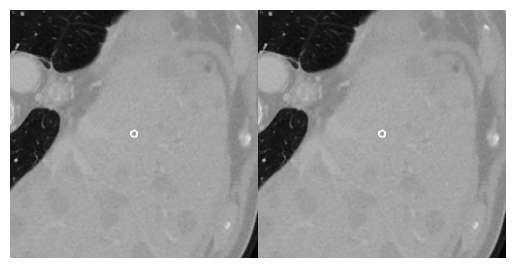

345
57
0.7193019100083772


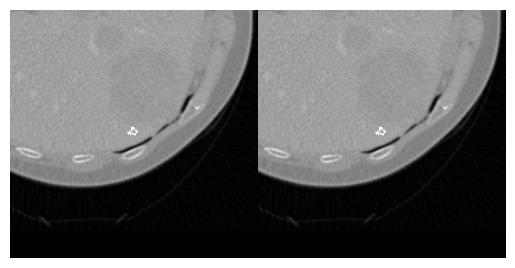

346
148
0.9440685029466483


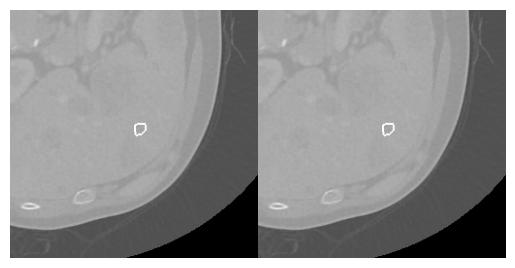

347
32
1.2083268721137757


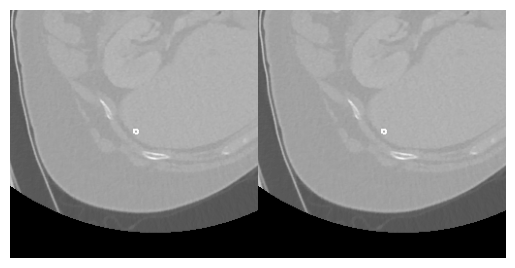

348
40
1.1065010026804611


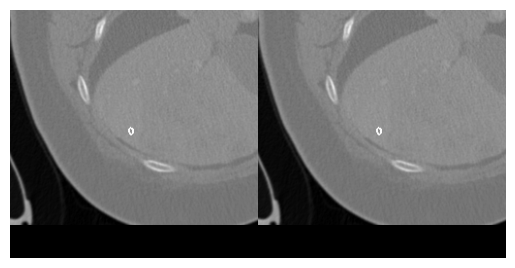

349
66
0.9651887914802673


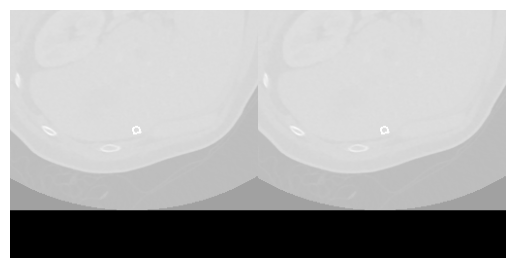

350
50
0.9805467826824815


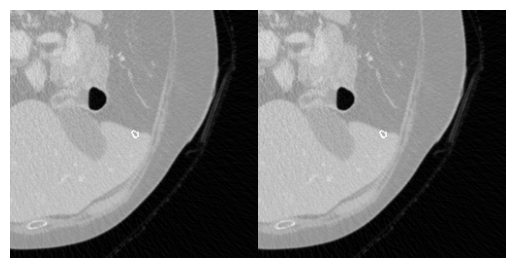

351
67
1.0894984985348972


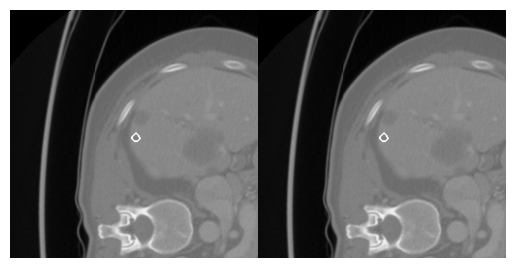

352
667
0.6655081818342975


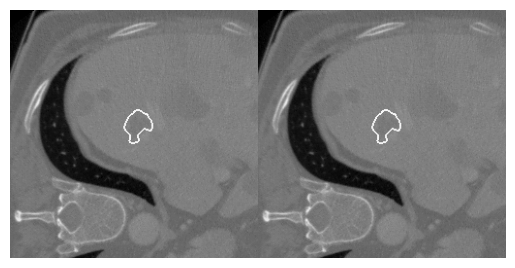

353
391
0.9070993067890792


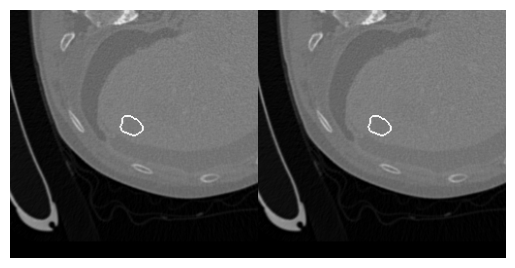

354
78
0.9996211996652911


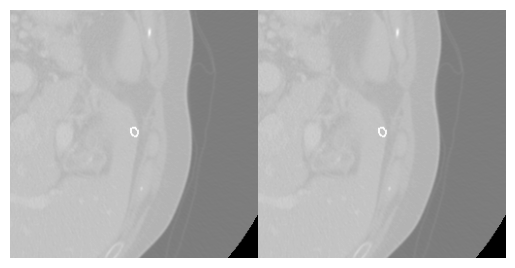

355
209
0.8992889596309476


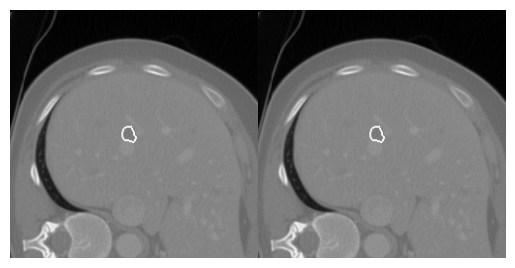

356
72
0.995850902412415


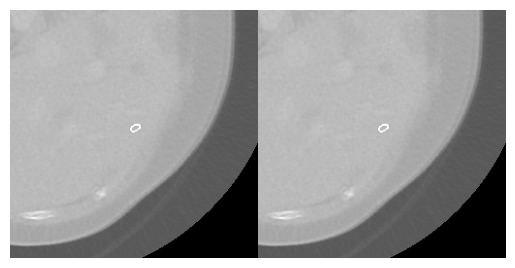

357
296
0.8617690008831826


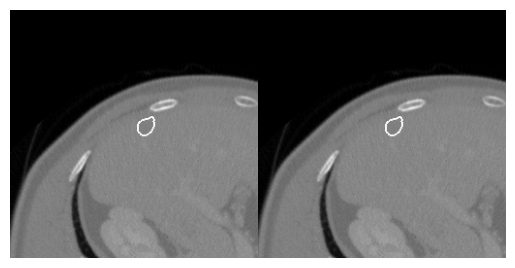

358
158
0.9366245986621051


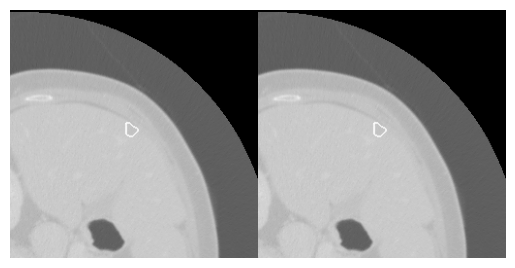

359
685
0.9304582239430751


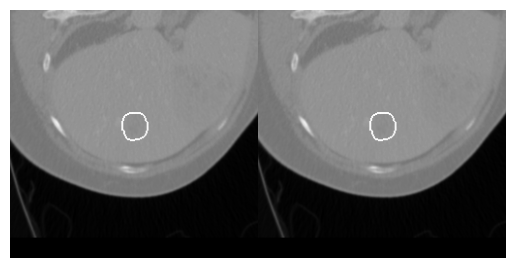

360
957
0.8193018376885991


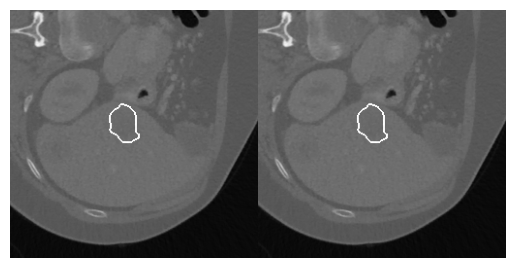

361
33
0.9128633272113801


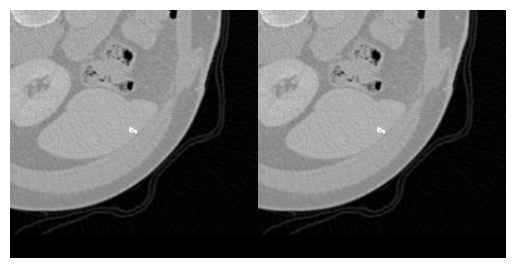

362
92
1.0635183109500363


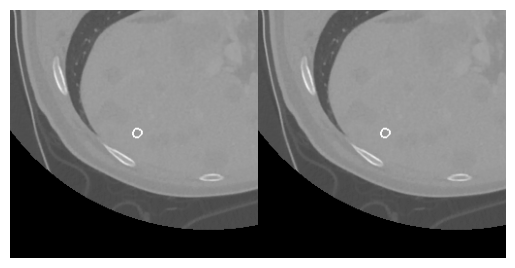

363
103
0.7204889056518465


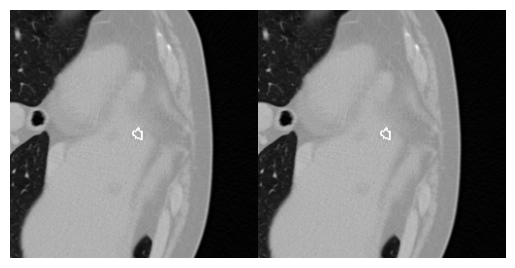

364
14
1.2073870691739297


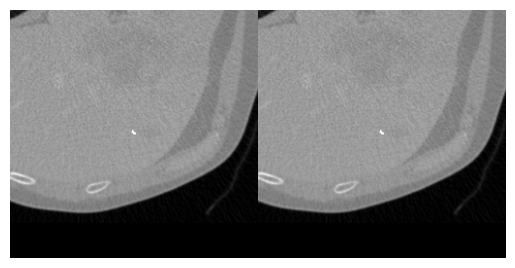

365
647
0.5436628301496355


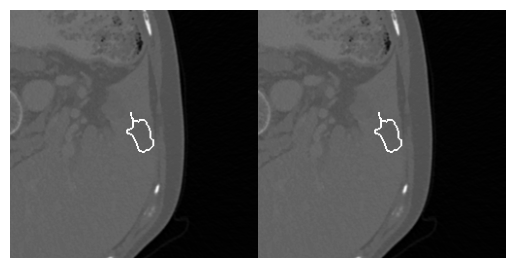

366
58
0.9769594030704228


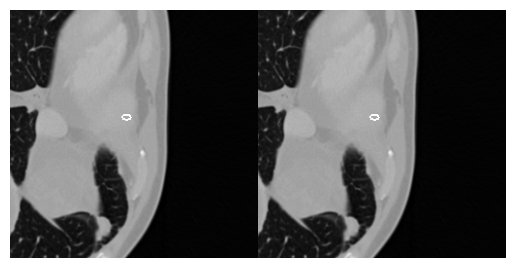

367
1456
0.6812513845165404


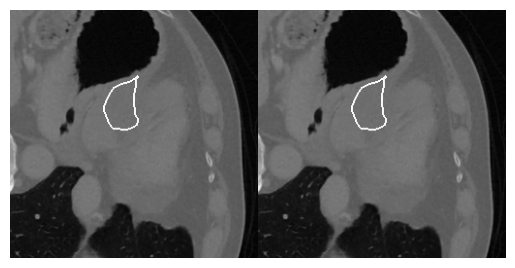

368
16
1.3414659073803088


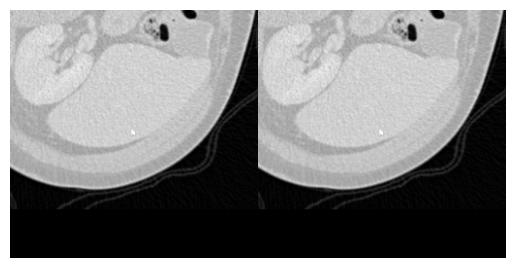

369
183
1.042340054351842


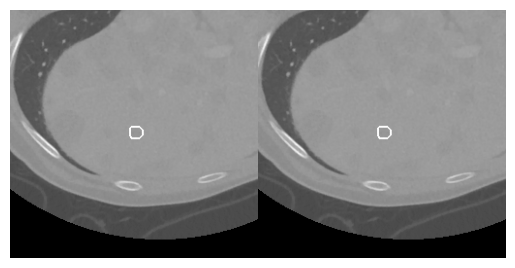

370
188
0.5716869300129738


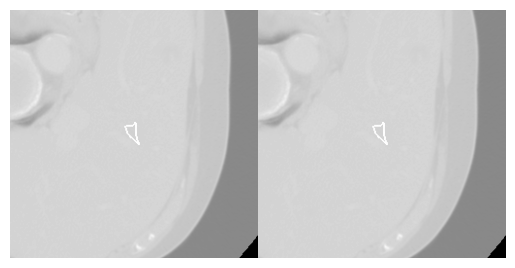

371
1263
0.7019482071411742


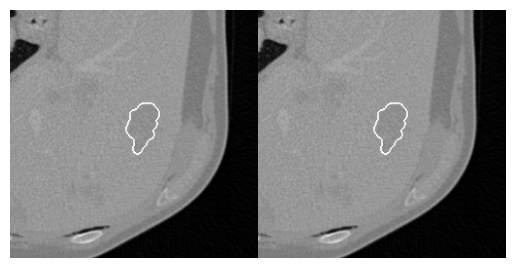

372
153
0.726159261266747


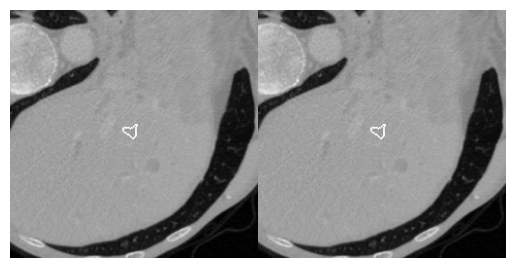

373
35
1.1106924012725323


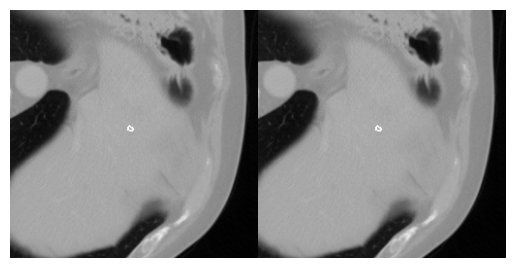

374
423
0.8441078288333069


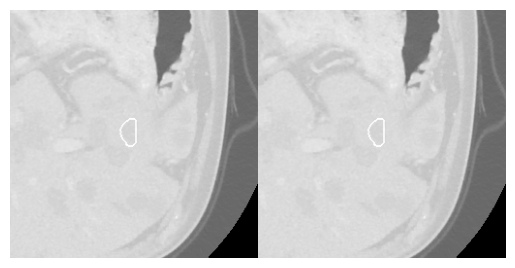

375
299
0.9610524531342178


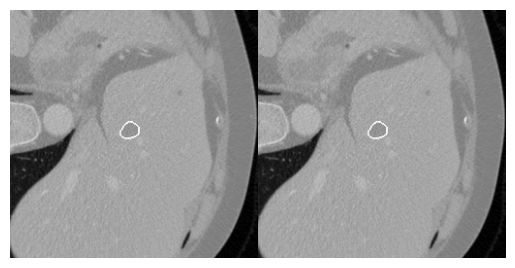

376
341
0.7566507011674863


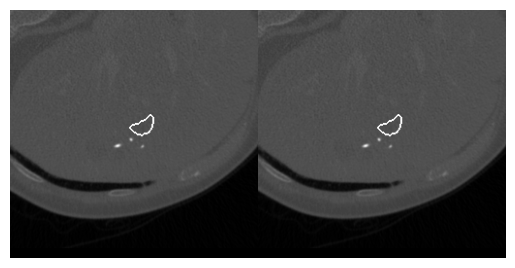

377
123
0.8846742819517711


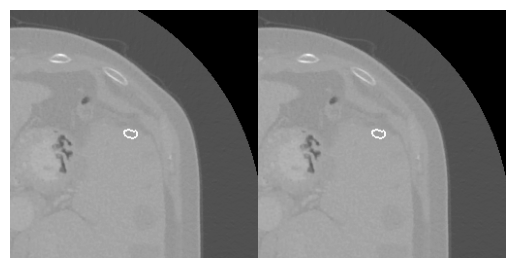

378
83
0.926272021982228


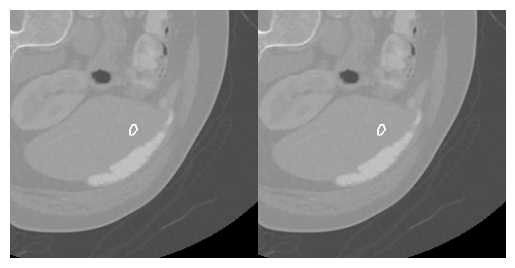

379
1206
0.8681362344728257


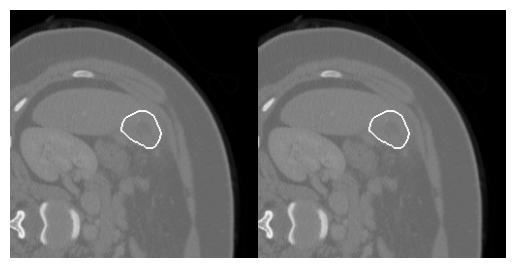

380
45
1.1184735665493386


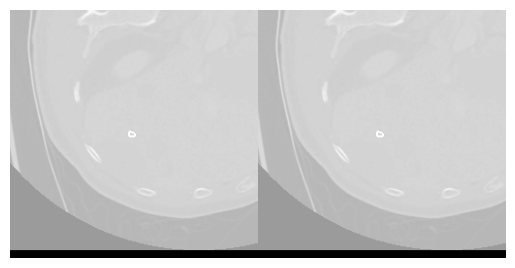

381
1407
0.8032046502988196


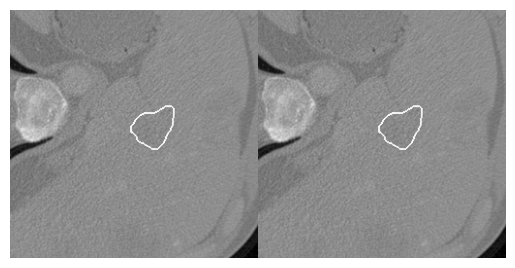

382
570
0.9181392615753333


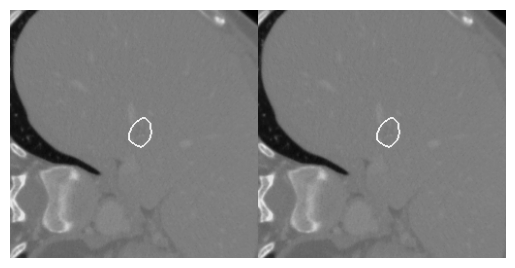

383
420
0.8955320533051832


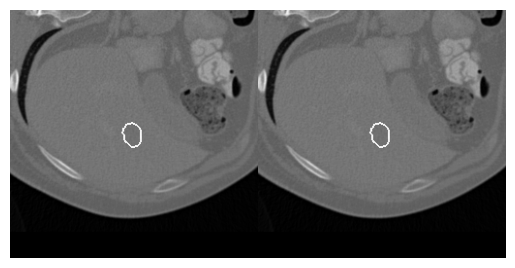

384
95
0.9898647821182778


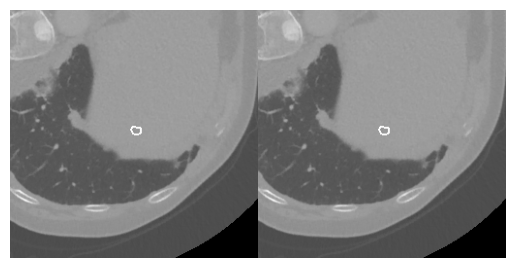

385
120
0.7860730751299299


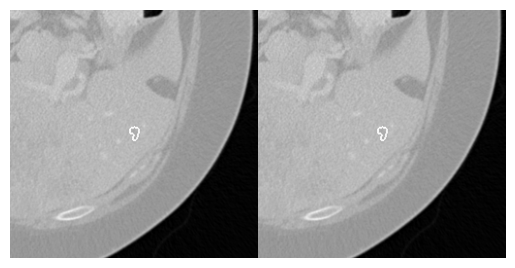

386
21
1.1618260528144841


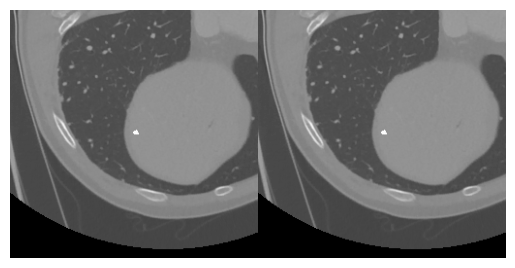

387
241
0.9363960413997998


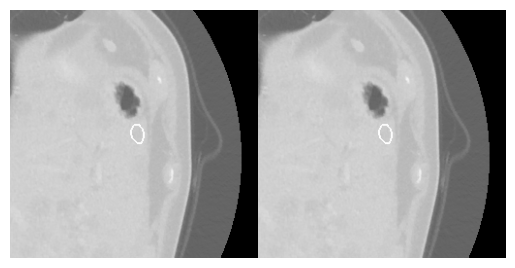

388
58
0.5797786234561365


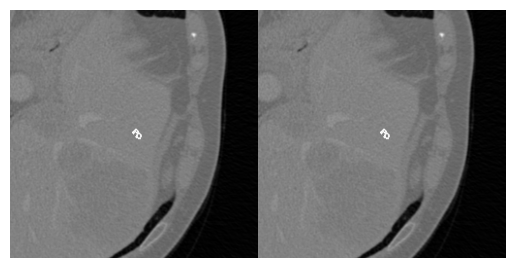

389
101
1.0177581347121054


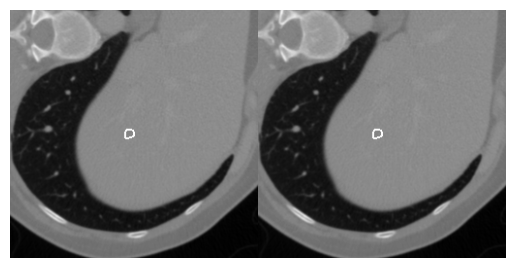

390
89
1.0663949196449276


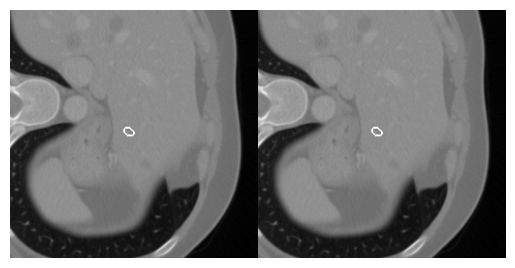

391
50
1.1559981640761263


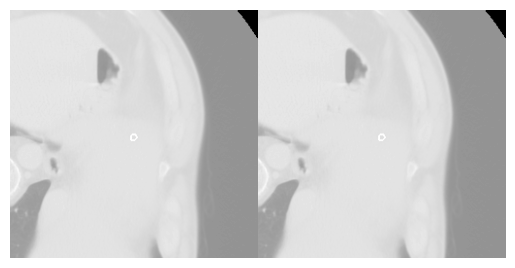

392
11
1.8597517845668707


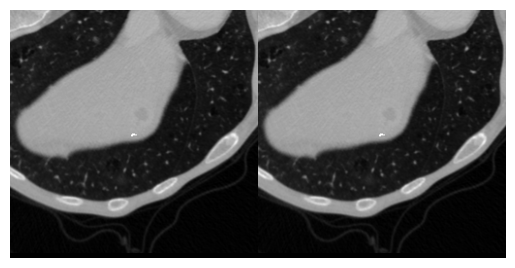

393
313
0.33012033228248616


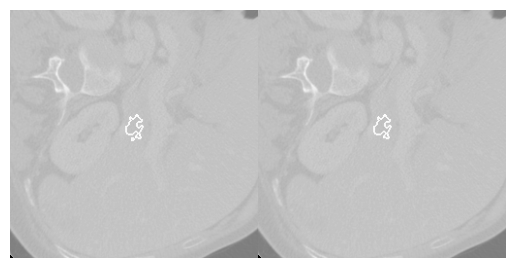

394
82
0.8229828922179145


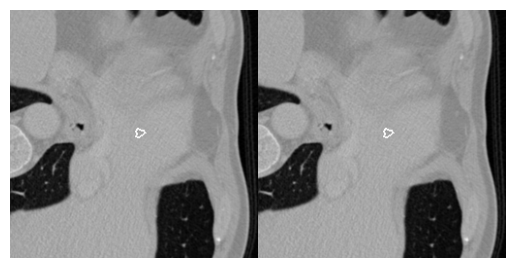

395
678
0.7155507394181501


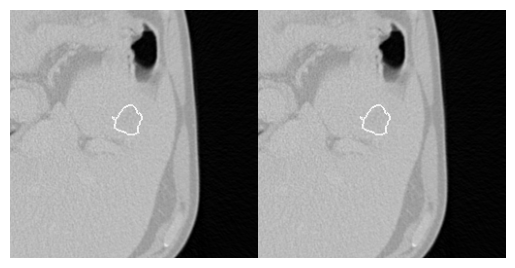

396
41
0.8196870193690204


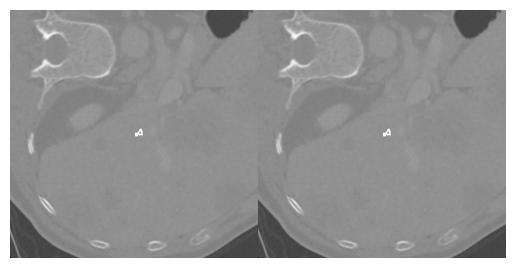

397
355
0.9803904101852229


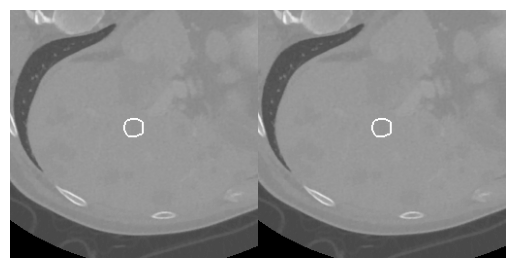

398


In [13]:
for i in range(399):
    before_after(i, footprint_size=20)

In [57]:
def convert_images(label_folder, output_folder):

	for filename in tqdm(os.listdir(label_folder)):
		if filename != ".DS_Store":
			# Open open label file
			image_nii = nib.load(
                os.path.join(label_folder,filename))
			image_label = np.squeeze(image_nii.get_fdata().astype(bool))
			
			# Apply the watershedding separation on each of the slices
   			# Only apply transformation if the slice contains 1s
			slices_with_ones = np.unique(np.argwhere(image_label==1)[:,-1])

			new_label = np.zeros_like(image_label)
			for idx in slices_with_ones:
				unprocessed_slice = image_label[:,:,idx]
				processed_slice = separate(unprocessed_slice)
				new_label[:,:,idx] = processed_slice
			
			# Add extra dimension (original files have it)
			new_label = np.expand_dims(new_label, axis=-1)
			
			# Save to the output folder
			final_label = nib.Nifti1Image(new_label.astype(np.int32), image_nii.affine)
			nib.save(final_label, os.path.join(
				output_folder, filename))

			
convert_images('lits_labels', 'modified_labels')

  0%|          | 2/833 [00:00<01:41,  8.15it/s]

0.9881888214965198
0.8945418223703228
0.9287625722844317
0.8049163623014416
0.7867418925857587
0.802031561345916
0.6984691259492755
0.6994383625358164
0.7128537686353993
0.7915748464210925
0.7639799816552021
0.7928255406068733
0.8531325795770678
0.829920530460093
0.7884245039370883
0.7723855331026347
0.7677828201789083
0.9682123483556626
0.9585572311415079
1.00495212255364
1.1240316092611384
1.1768136879086513
0.9076962049650007
0.7585564513032622
0.9018174337830268
0.7488990713965318
0.51208051793167
0.7931855329274478
0.5571446446334054


  0%|          | 3/833 [00:00<01:37,  8.54it/s]/var/folders/x5/24949l4x02j5jtrqrp1bjr9h0000gn/T/ipykernel_39025/907209794.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  largest_circularity = (4*np.pi*regions[largest_region].area)/\
  0%|          | 4/833 [00:00<01:38,  8.42it/s]

0.9958509024124149
0.952022058233599
0.8744498905256761
0.9509697518431229
0.8345398386465194
0.9779982109763028
0.8892005683500998
0.7126537632957892
0.8461189049974972
0.8745706201350572
0.909157484101866
0.8146119451644629
0.7948331540704261
0.8228392259012185
0.8255135662939471
0.8428995559341806
0.8574964010211598
0.867694974159028
0.7959671046286937
0.8291053937934815
0.7907378118028837
0.7953660554567911
0.7846960181901237
0.7957260241919131
0.7918506145657079
0.8575082884968451
1.0189180956789345
1.430983102553298
inf


  1%|          | 6/833 [00:00<01:36,  8.58it/s]

0.5600238335771284
0.6819395443992973
0.7321391728314126
0.746069572250788
0.803349948318137
0.7809546774958561
0.7521984098251567
0.6363754951189455
0.6641939074891737
0.652190004211074
0.6042930316613784
0.6313643414983167
0.6314086790810868
0.6496688243137394
0.6790896991847083
0.6741825065951521
0.6918597497883464
0.6823331433124316
0.6133471513314996
0.6156802388232786
0.5286417516110199
0.6484386084809067
0.6330440838955675
0.6658982741855073
0.6698737492353382
0.6516566183352549
0.6355899097219356
0.6379317005249595
0.6130254869354667
0.6785096513788951
0.8358176833213503
0.8758381018311729
0.8552480650747455
0.7963663481019496
0.7097375369216727
0.8463137261421905
0.6233016322193878
1.0546881124122227
0.9912301781667335
0.8191767767743917


  1%|          | 7/833 [00:00<01:36,  8.55it/s]

1.0640577365072394
0.9975780532192605
0.8751307312201709
0.8688119958859659
0.8579360588074273
0.8202529351288405
0.6936115300967423
0.5034007881643872
0.43226395446405197
0.49430825306326964
0.5212094759028159
0.5550403852872858
0.5530576077354514
0.5417195773136995
0.5625791044918669
0.7537628169822966
0.8080172866040723
0.814505880320724
0.8084440371756996
0.7676604101404323
0.7549639814547234
0.6863442315062783
0.5995428902278823
0.5021954841356456
0.4708835598132537
0.5030454842584491
0.533048953703066
0.5336486288888759
0.5615300878872751
0.5739973951404889
0.5797135857764343
0.5874278500558412
0.586828121284767
0.5834666896965557
0.57485351335112
0.5761004274990061
0.5685283415803565
0.5744002089121043
0.5656430084579745
0.5564059342183598
0.4850465051380464
0.41198891527927306
0.4070569577700882
0.41590332196717816
0.4131308720504654
0.419609589528061
0.40452132426615217
0.42019064493502783
0.44425887173683787
0.44676272064737665
0.4527010303367852


  1%|          | 8/833 [00:01<02:31,  5.46it/s]

0.4527010303367854
0.4596197237471292
0.4590026427048878
0.4559361391743266
0.4557588727603302
0.4530387791923218
0.4547283032493185
0.46625418388640943
0.4651058224841341
0.47285609238085485
0.4725932387985953
0.47175292967212207
0.43589664262519145
0.4133357659693785
0.6007053694757534
0.6174024301624138
0.5803208298929444
0.5885323203966768
0.5847094615074981
0.6039483396390188
0.6039784642880884
0.6053751788686198
0.6138510919875303
0.5990645470976006
0.5929421710533098
0.5898215222652566
0.5703513785936435
0.5553874329385345
0.5606806970295166
0.5685478213051114
0.5656394471287356
0.5698541119318901
0.5793776859296352
0.5643762349427002
0.5634442497187704
0.6155840352393798
0.6148698536567088
0.602057919192628
0.5677875084272811
0.5350936042088382
0.5043689611881359
0.44770445633528505
0.39802018130295463
0.3036265590531624
0.43918687851018945
0.920750958730385
0.8726868867141324


  1%|          | 10/833 [00:01<01:59,  6.90it/s]

0.9316128049591125
0.9807025425457886
0.9528203078637305
0.9260551014395719
0.9171079600855943
0.8595006235222494
0.8331544130874713
0.8412873539106881
0.8705031461624041
0.8300159807836452
0.8673823719374387
0.8703432086039633
0.8723390552517467
0.8790294681760771
0.8432544610103635
0.8480738340538269
0.818756563539872
1.3239153988972323


  1%|▏         | 12/833 [00:01<01:43,  7.95it/s]

1.341465907380309
1.051175952546438
0.997411239597103
0.937881026947606
0.9123544724738658
0.9174001430108136
0.9166203522790672
0.932308987714613
0.9055403018804473
0.9432876901559162
1.2801537005750372
inf
1.5392254097658196


  2%|▏         | 14/833 [00:01<01:35,  8.53it/s]

0.8990320646778744
1.0337341843865526
0.9021030400678826
0.9498898157053114
1.043908662112716
1.10326283241436
1.1056300185411094
1.0882958272169045
1.2217519021653156
1.3503486408337697
1.393228853936436
2.050505024954443
1.4510611029558718
1.5079644737231006
1.387197796891351
1.387197796891351
1.2083268721137757
0.9958509024124148
1.068763630258257
1.1642661024177179
1.5571460217520925
4.887007608661263
3.2340725067158833


  2%|▏         | 16/833 [00:02<01:30,  8.99it/s]

1.5707963267948966
1.1424264698803188
0.8831397440622895
0.9879437932540102
0.8344353493246771
1.0177581347121052
0.873805200695445
0.9132385496201394
1.0274917859878587
1.0630516110038322
1.011479467121017
1.047224264056959
0.952022058233599
1.1211451356615063
1.0081926404352783
1.10326283241436
1.0780241689052947
1.0529332270693823
1.1379144005111443


  2%|▏         | 18/833 [00:02<01:30,  9.02it/s]

1.0522347780411814
0.9421172926239537
0.9709839679958463
1.1076409708989658
1.04415027248501
1.0383091544711966
1.0236850818730105
1.033230351753074
1.0655188002453575
1.1741605384881055
1.2303030149726657
1.1766561392189776
1.292458343568125
1.4822832322447796


  2%|▏         | 20/833 [00:02<01:35,  8.50it/s]

1.0246454693452451
0.45297275654405045
0.49303457387263827
0.5411163598825711
0.5492183999175985
0.5752251206535985
0.6053117549119684
0.6254859681678486
0.616158845743154
0.6879763698211235
0.7636683480483906
0.8250067845616302
0.834582881635929
0.8132856633260546
0.8157805665999464
0.5740047301497744
0.4985732647397589
0.5133881801346157
0.5571348077094744
0.5327885636304637
0.5466402408316755
0.5494889187648443
0.593465569203171
0.6197074342586161
0.7179930510826759
0.7872813059467043
0.8153084592353325
0.8405462357645633
0.8548013655931781
0.9032299878394854
0.9761762274420619
0.9794451528328219
1.0067498436884152
1.052678107874826
1.0332928748195114
0.859660181908299
0.9702133938218033
0.961654285289678
0.9801135304934548
0.9988113971977035
1.0256202162501757
1.0215984183320814
1.042908706365909
1.070392549811525


  3%|▎         | 21/833 [00:02<01:34,  8.63it/s]

0.7554211347440193
0.8481526948271001
0.8237285242176764
0.8276627500049851
0.738181274211976
0.8197920077209939
0.8421407886558463
0.8354934789311923
0.8373004994053963
0.8128120051052736
0.783269985007812
0.7237313693470085
0.7593025875765346
0.7895907427765614
inf
1.0936185984037978
1.1286030800767903
0.7876308501630536
0.595339054499205
0.8305186199219363
0.48459657763324443
0.3792679001023807
0.4776631897689418
0.5336421138050714
0.5027866495046196
0.47792381390908517
0.4578369491849986
0.5225564048719064
0.5241757267389733
0.5429778115861484
0.5058230195253239
0.4816796718029056
0.5531183545637066
0.5565205135031568
0.620624117947885
0.48065090813403855
0.435641089122091
0.44502553975758685
0.44826058906800254
0.43443973901135513
0.44349352351030114
0.4201468859250188
0.41524601900983554
0.4491085279669278
0.43230164707931906
0.4811233552215745
0.5243758217828561
0.5191953636150693
0.4557047393507031
0.4649827700714216
0.5165851624548238
0.5805319012510417
0.5885598077908548
0.58

  3%|▎         | 23/833 [00:02<01:53,  7.17it/s]

0.3455642456743083
0.335529261554953
0.22401470614455113
0.1857041092900245
0.19340728303954935
0.203452108642383
0.36931348547070525
0.6272253510207567
0.6945548123739737
0.7168740191680181
0.6596688088239252
0.6773957201697155
0.7045901963014086
0.4654675706317363
0.5831135106680794
0.7590596734959967
0.6650520354795069
1.506261090013991
1.030835089459151
0.9881888214965202
0.9350215988108153
1.0031613793979823
1.034023182419364
0.98798090775282
1.1697571821464499


  3%|▎         | 25/833 [00:03<01:39,  8.10it/s]

1.0786014609507297
1.064715228548439
1.0834329432512908
0.997411239597103
1.0199553985328214
1.0200645224376907
1.070392549811525
1.137914400511144
0.9212112180809041
0.9794451528328223
0.979812864078453
0.8983534740877454
0.9306965948731044
0.9247985312609011
0.9487246752632352
1.0266010524313653
1.4823935068722365


  3%|▎         | 27/833 [00:03<01:34,  8.57it/s]

1.1401809566205188
1.1568326904292363
1.0995808945896264
1.0628199178456335
0.9594091255755071
0.9320613054577821
0.9863003465719453
0.9605257709589821
0.9565990203218339
0.9507574267428637
0.9373350811392952
0.9187588805323338
0.9847017352631748
1.0288383660277527
1.0927744108680026
1.1318618593521355
1.3932288539364366
3.015928947446201
1.488740150402318
0.6654470178427746
0.7572897054293392
0.9011608286942696
0.8744920635106966
0.8681362344728254
0.8357430913954811
0.7380920753758119
0.6956289851555015
1.1274905815425096


  3%|▎         | 29/833 [00:03<01:31,  8.74it/s]

inf
2.5796641830326625
1.6646373562696222
1.1057596701548216
0.8323186781348109
0.8795276071345476
0.9264270201529872
0.7607194393428172
0.789699920302037
0.8193303597550079
1.0120226891763986
0.994436936676639
0.9432711477921326
0.9287982518850461
1.0032027378460355
1.6646373562696222
3.141592653589793
0.7868221264827969
0.9506303820249116
0.8949861416422831
0.8681651841739872
0.7860439021524905
0.729338387860892
0.7033380278278702
0.8730504878310246
1.0195566651856816


  4%|▎         | 31/833 [00:03<01:29,  8.92it/s]

1.7652205318629761
0.8394996607993727
0.8564728489860216
0.5495142638412772
0.6376175858504582
0.7832036313896942
0.8261392464023357
0.8085181266789708
0.7426436221000662
0.7745507018763228
0.6318127024181672
0.7592568214995807
0.8732895691051077
0.7149793072908001
0.9269299015470711
1.0472242640569587
0.9651887914802669
0.7532175408246162
1.1559981640761265
1.2328052730110581


  4%|▍         | 33/833 [00:04<01:25,  9.36it/s]

0.9817712417488641
0.9527869872187166
1.9347481372744961
1.8865422955842652
1.4822832322447796
1.1005023051819023
1.235849043114212
1.1678595163140688
1.1267047410195665
1.2033266998743648


  4%|▍         | 35/833 [00:04<01:31,  8.77it/s]

2.3536273758173025
0.4587000715054068
0.3835027416713705
0.3710668039868564
0.47708589084024394
0.5841753021332236
0.5351870128085737
0.5340411823977157
0.5810574412535835
0.6154841738254256
0.6006197997659717
0.6043513944340506
0.6496231994664625
0.6883636477328023
0.7097400722713471
0.5988441186579184
0.417655251355758
0.5530079653576466
0.5239365463179132
0.6948944300953902
0.5667412197198564
0.47797492008931164
0.48042761839779224
0.9212061123408367
0.7254543827479737
0.8564378639483791
0.8726372611785174
0.8470304440877855


  4%|▍         | 37/833 [00:04<01:31,  8.73it/s]

1.8288145488861385
1.8326278532479736
1.3503486408337697
1.1150679494430014
1.1537086777593577
1.1907938922533645
3.2340725067158833
1.9634954084936203
1.1454006794618754
1.1454006794618754
1.1277777637249438
1.4373655585403928
1.4373655585403928
1.612290114395414


  5%|▍         | 38/833 [00:04<01:57,  6.76it/s]

0.5740425679357406
0.5017935815259449
0.5434329112094283
0.4292070400825967
0.3352690308505128
0.4716875928625691
0.46719291246503214
0.4310692117552918
0.3620304936508984
0.4094558474366877
0.4276779970379279
0.40819726600129524
0.43497500665098016
0.3912543280752607
0.35342025885210177
0.3230948436533431
0.30461957432108455
0.3456005505087379
0.315627632512599
0.28709981815491886
0.33216170896993313
0.35736488890446244
0.40175799370132215
0.3379103780801213
0.24386664536788502
0.2535177103746623
0.28115871149099375
0.29761778359233465
0.3509082995049953
0.3592287526638678
0.3267364770561883
0.39841451391446336
0.4860875775216317
0.4809219544889529
0.8986474041951639
0.9557062395701239
1.0497711700537058
0.9664986512866504
0.9681883773454034
1.2924583435681245
3.2340725067158833


  5%|▍         | 40/833 [00:04<01:42,  7.76it/s]

inf
1.2505080359301415
0.638343193342146
0.877481808114765
0.8483174353883534
0.885200802144369
0.8644603402229215
0.8963550123262952
0.9068303826593173
0.9039840363994197
0.8834259357370894
0.8970959484175689
0.9397473005145789
3.2340725067158833
1.0070028451507589
1.0072319579169293
0.9850709199906932
0.9406582083245648
0.8960869111615223
0.8979687790435732
0.9081736433074472
0.9235606932173808
0.8901284453581052
0.8767637396678211
0.8851586125247112
0.8706387461519335
0.8609353060133983
0.8676351916633076
0.8701254764634222
0.8903872327638471
0.8900023343744902
0.9087685183010039
0.8780218102795703
0.8602832975760197
0.8223563576794907
0.8835452666263841
0.8964728707691213
0.9504873793514814
1.0481050020956875


  5%|▌         | 42/833 [00:05<01:35,  8.31it/s]

0.9222578113239623
0.9268425242608704
0.8810890267373187
0.8848606684850251
0.8799693797213147
0.8747959030321255
0.8615914365712632
0.9119557394251094
0.9042198864982636
0.8815526095266996
0.8849306392866221
0.8688335064739401
0.852869756607275
0.8752551803820592
0.9281213998563337
0.8957957752001493
0.9004137905941256
0.8763507411427566
0.9428015301318677
0.9765919146186376
1.1000246621482594
1.0480996907936426
1.1604344978565644
1.1604344978565648
1.0860061991784666
1.1318618593521355
1.0201786698650586
1.2505080359301415


  5%|▌         | 44/833 [00:05<01:31,  8.65it/s]

1.0275539236232234
1.0166858949758502
0.9399301637975915
0.8556507898419234
0.8357438578802215
0.8514555804630206
0.8917332196552888
0.8897617264911403
0.8921269226455104
0.8800407374575271
0.8739903355842537
0.8663902850988009
0.8507760397692151
0.8459112663263126
0.8638915607854888
0.8700655569617863
0.8506226458106041
0.8389824057032155
0.8456739951504272
0.8283941241700769
0.8107448787716072
0.7602563814692883
0.7948449289878841
0.8209879264294453
0.8127921625193351
0.814680316781667
0.834584523521329
0.8497519400400365
0.8309710550125272
0.7835095389672946
0.891828741827723
1.0172783843869908
0.9587885317036179
0.9565884807729943
0.9527595474672365
1.0203488756762968


  6%|▌         | 46/833 [00:05<01:24,  9.26it/s]

1.135054762326193
1.2495248386564464
1.1747318946999283
1.1618260528144841
1.0995846522834003
1.1790403893488048
1.4473907532358592
inf
0.8250857838024523
0.8422063819572613
0.9193856936786339
1.152822264154953
1.0780241689052945
0.9101839956900596


  6%|▌         | 48/833 [00:05<01:26,  9.08it/s]

inf
0.9285314456456398
0.6864746512800466
0.7729561926370222
0.8222335548166144
0.7387768248535985
0.756017375029817
0.751039623717617
0.7242770760704169
0.6610971630526944
0.6553520681296567
0.6874139383812949
0.7448502314171044
0.7401130402754641
0.7388217364203602
0.714317555205506
0.7142369119790682
0.7359988311072914
0.7380600645931484
0.8091828742081631
0.8276245092910756
0.8099911142820331
0.7404369468127049
0.7194762017932708
0.6374327146815884
0.6056286614419545
0.5643829893944524
0.5511607250193216
0.5604410974151937
0.5511168277263083
0.5450068561531447
0.6283804501262191
0.5975378886569467
0.6135668023341404
0.6290332701029361
0.601427549508184
0.6324712401500371
0.6842535429714756
0.6953921336456993
0.6975516365680543
0.6248921884896943
0.7499281613647764
0.5414030727823989
0.7544158113156421
1.1454006794618754
1.1770161688565013
1.4710171098858134
1.6170362533579417


  6%|▌         | 50/833 [00:06<01:37,  8.00it/s]

1.0213312848548903
0.9390601158823464
0.9348490839725597
0.8855198530293489
1.1153583385525891
0.3549277129461003
0.3362730591965875
0.38501105989298207
0.30703561318640915
0.4066812076419084
0.45843275432133235
0.4457147487200127
0.42358448310997626
0.4071205669617286
0.3203087718592399
0.42057673633157755
0.3744176292660787
0.2979306554457861
0.3297311172045167
0.4972154359403645
0.4953769914413699
0.49468753976950874
0.5083029793674013
0.4743327013812205
0.4947041064130816
0.5009252955426703
0.5220355036874403
0.5539338266185005
0.5566984746366141
0.5207494850867163
0.6110275780282317
0.6226582769269082
0.7195180616715674
0.715453738262965
0.8303034525806791
0.8481047113656218
0.7992097273539774
0.787877498622526
0.8879323335377983
1.6906834405153366


  6%|▌         | 52/833 [00:06<01:34,  8.28it/s]

0.5112892359673404
0.7563229874715544
0.7842561453552526
0.8231047469827568
0.8153894409317975
0.7727377952153653
0.7451099830024968
0.8563173249028436
0.8648244235914606
0.8545794724269131
0.5509177716755586
0.5511606356579268
0.5702390943622581
0.5927866482095661
0.581110332678092
0.6050851263881878
0.6321784317036536
0.6848336235583732
0.706822690687078
0.6118772624404653
0.5651279632686551
0.9710384578239463
1.109758237513081
1.612290114395414
0.9185531380021443
1.1899045370804562
1.051175952546438


  6%|▋         | 54/833 [00:06<01:33,  8.33it/s]

0.9896326125031937
0.9768184486443263
1.0860061991784666
0.9753834942225342
0.8909290652109872
1.0527922631666484
2.2831238497444226
1.1809473206012995
0.9240207162045382
0.9825913439124125
0.9716360399146736
0.9146241807091059
0.8998540674212483
0.9008362016332854
1.0107005796181538
0.990404573497514
0.9594415103257125
0.747637441817869
0.9762150350271482
inf


  7%|▋         | 55/833 [00:06<01:31,  8.50it/s]

2.3173247538676778
0.6309665877266467
1.011479467121017
0.9825211619200456
0.9578616350448831
0.9320613054577822
0.8015197990756118
0.6472615841436798
0.8467515397761582
inf
0.9725057559800656
0.8449464167840723
0.8837540042935703
0.8225833002931445
0.8424984514310367
0.8234580460774614
0.7359502471740873
0.7356844267790833
0.7860272184981619
0.7653528459007682
0.8081286962829942
0.7587730824427835
0.7755372622803678
0.7716068479822608
0.7387421190606883
0.7434615310405585
0.7560343800357138
0.7599523717103124
0.7581416033644286
0.7706477965986339
0.7438211052017764
0.7505113814000953
0.7397948456091816
0.7452117365848123
0.7573319683386068
0.7443272013109705
0.7991601965787972
0.7861717486052512
0.8071814698626437
0.8037690017967548
0.8049368870413228
0.7425930681837826
0.719633665640716
0.723514513750431
0.7452121817657364
0.718091633034052
0.7253255379628739
0.7731671084609735
0.7249457355939212
0.7508488356810323
0.7548071352202299
0.7592978060508548
0.7855046969306639
0.7676347366

  7%|▋         | 57/833 [00:07<02:00,  6.45it/s]

0.7127432521687896
0.7708391765539028
0.8302896856059886
0.4997677732768642
0.5009831547859903
0.5054714358833031
0.4986184435014844
0.4837076272508999
0.4819521398717552
0.4720645395082234
0.4715891014934715
0.47282434490001124
0.4662808393878811
0.4675628261713556
0.45998715955969177
0.500345143919
0.5209766054982696
0.6068380246010082
0.6514965203610257
0.6694872075629715
0.6907419355219784
0.6948748326660539
0.7063276934909556
0.7112557899297995
0.7095472731851016
0.7128524867406894
0.7074754698838016
0.7066166009295056
0.7126887709408128
0.7077864549710923
0.6953417607199609
0.6896203993072668
0.6891994956836953
0.7086464838600097
0.7199277260470822
0.734557893565024
0.737750413154788
0.7420846989041135
0.7427733930180243
0.7748296599320023
0.7575293235902852
0.7466818524642813
0.7231008749282406
0.7483956315047555
0.7749825876845278
0.7928929434126271
0.8046686565102656
0.7985230194061556
0.8083102168056082
0.8159786499085824
0.8124194045710669
0.8033192735547711
0.80289736990404

  7%|▋         | 59/833 [00:07<01:41,  7.63it/s]

1.1689103329366752
1.068763630258257
1.0347852038717007
1.0096821649459204
1.0383091544711966
1.1106924012725323
1.0717145030280277
1.1677009634307547
1.089024415526777
1.1084494536468468


  7%|▋         | 61/833 [00:07<01:32,  8.38it/s]

1.1286030800767897
1.045465838918826
1.0162678323037178
1.0269934390162863
1.0379367173186649
1.1737826689577702
1.0480202401408665
0.7963963333638477
0.7076213798298487
0.7002100724968642
0.7624617183921084
0.7537901099491283
0.7385811601741634
0.7224019967614546
0.820854233532403
0.7515384823198092
0.7901676022496774
0.6915275566794058
0.7229353400942804
0.7825081882603989
0.7078389704258486
0.7320480005574921
0.9402118401152494
1.0247884074778726


  8%|▊         | 63/833 [00:07<01:34,  8.16it/s]

1.1184735665493388
1.0786014609507297
1.1260535900603117
1.0138546808406572
1.0177511951807026
1.0206145977801604
1.0206145977801604
1.0147415233882588
1.0003514919082472
0.9851991534262872
0.9682861153242615
0.9729584873181903
0.9528234440444334
0.9723102707340456
1.0106476583487134
1.0097202415546689
0.996927208608102
0.9820196398789092
0.8852008021443688
0.9243126522603589
0.7824965001480874
0.8264978136407238
0.8731131619767
0.8782767723617956
0.8616440680459626
0.8986090437215062
0.8679131967508705
0.8509382243069403
0.4500292424587638
0.3741059544119843
0.4399762655246542
0.37107707497285974
0.4183666272778588
0.5211935031484275


  8%|▊         | 65/833 [00:07<01:28,  8.67it/s]

0.8605527440397628
0.9187452615388196
0.8957100811720968
0.9037424828562995
0.8664771155992341
0.7381459606837202
0.7354231675137471
0.7520600255995056
0.7757216770792289
0.7220796964524026
0.6497255162883881
0.6497255162883881
0.7475984660643653
0.7256102758860019


  8%|▊         | 67/833 [00:08<01:26,  8.84it/s]

1.1454006794618752
1.1106924012725323
0.8596497825379054
0.8892005683500995
0.8914570806074269
0.8679175917407892
0.8748232002936712
0.9939492513651654
0.9837561268413857
0.8580933141000581
0.8945776595652861
0.9112750170291604
0.9315453994284613
1.0240993270417398
3.141592653589793
1.20921758579656
0.9109573275738235
1.0569457416592158
1.0106476583487134
1.0780241689052945
1.0529332270693823
1.1286030800767903
1.160630003447611


  8%|▊         | 69/833 [00:08<01:22,  9.23it/s]

2.3173247538676778
1.2382388078556779
1.0780241689052947
1.030449023477121
0.9673886833936108
0.9554268678719678
0.9350740704971333
0.8438970458222919
0.924798531260901
1.2389643882700017
inf
1.1415619248722113
0.5467599492900965
0.697194095246529
0.7395947135814785
0.879860221414727
0.8138832519412736
0.7346517713975099
0.8386294956492335
0.8541691785110928
0.8768661348408101
1.0108601073016557
0.9898647821182778
0.9841604719253493
1.0089541958843913
1.0474045356262338
1.009546540362635
0.9453496097333655
1.105630018541109
1.3744708899359803
1.446802115179039
inf
1.4822832322447796
1.2638881569256477
0.6971475661249853
0.6978130153512798
0.4883326004280767
0.32107936187619407
0.32296996039062886
0.3251244836464104
0.2949925583407306
0.28443342740640104
0.2972924949175341
0.2984056275175693
0.3661062562873656
0.3761742757144873
0.37639367391340384
0.33528423000439866
0.36443655423032234
0.3780149524014063
0.4251283757305158
0.34479169790747566
0.2682211058078248
0.2126097060163052
0.22

  9%|▊         | 72/833 [00:08<01:42,  7.46it/s]

0.9030773628127582
0.8463826119504375
0.8774826746008074
0.8842789388097876
0.953452487165127
0.8162430010038391
0.8237601205122335
0.7749563814850886
0.7529931480163435
0.8602999230951612
0.8967680081085176
0.8928956109659754
0.8914570806074266
0.9143695767132554
0.9339301139942698
0.911662025481788
0.9312684546219071
0.8735974513497659
0.7924144659975279
0.8254317354140915
0.8537464561529636
0.8696050353410284
0.8710063945599895
0.8633432497131721
0.8291247626508998
0.84702729938381
0.8502478895140003
0.8868803249796419
0.8906881939672703
0.8974334274400037
0.9150260072599702
0.9042401270213494
0.85981865840508
0.6588206755275969


  9%|▉         | 74/833 [00:09<01:33,  8.12it/s]

1.294717943765261
0.7616176465868794
0.597864806048699
0.5143256503805057
0.6798505284813331
0.5687753258606154
0.7752459444732259
0.7234114925505359
0.729813102144222
0.7792437358424085
0.8063812308781547
0.8298137522862512
0.6645368439339071
0.6841747135390132
0.7808112428045154
0.8911666462950432
0.7080197237433107
0.5898330537458375
0.6201198198483802
0.47429591487041783
0.5324619563572498
1.2120082879716694
1.3962634015954636
1.0564636855271885
1.0675572996675682
1.0742998693442378
1.0339018947043142
1.0087937797500768
0.9612727460786505
0.9744990279308023
1.0016542843214846
0.9997538633438717
1.006816931237201
1.0538036114219949
1.048105002095688


  9%|▉         | 76/833 [00:09<01:26,  8.75it/s]

0.8484521619267048
0.900592888665107
0.5068163397105864
0.32648374765654525
inf
0.7058919111414994
0.6265432020694132
0.5007041409680376
0.7992407394745633
0.7926844326212559
0.7679188152876297
0.7332100907087105
0.7247686110656236
0.7413747882819448
0.709982791655012
0.6814722313835003
0.7454809839830313
0.7066712920301721
0.6074229548160729
0.6017004841102467
0.7410680975632894
0.8537671255044654
0.8353204574048855
0.7092510623932992
0.6369238635071384
2.4255543800369126
inf


  9%|▉         | 78/833 [00:09<01:27,  8.66it/s]

1.5596762428619324
1.5596762428619324
1.5596762428619324
1.3503486408337697
1.3268842295691072
1.0982123966043795
1.0218949976689091
1.2505080359301415
1.242748407277043
1.2801537005750367
1.2801537005750367
0.9021030400678826
1.1454006794618754
0.9694901259935806
0.9694901259935806
0.9479184945424233
0.9404200065064448
0.9273470064055445
0.9440053688388873
0.9331554046705282
0.9972221703508523
1.0172783843869913
1.2495248386564464
1.4796776500174413


 10%|▉         | 80/833 [00:09<01:28,  8.48it/s]

1.015565608651061
0.7256512118672764
0.8196547399941082
0.7167188617271982
0.5731775106847204
0.5763985410164821
0.5246283353265588
0.48188153344517004
0.5906306264478988
1.075524656549987
1.1978046321169937
1.2389643882700017
1.2424554991254615
1.1568326904292363
0.6644594547538861
0.7738519523262387
0.817614530924635
0.836783927566542
0.8680001760061715
0.8029373410689096
0.8642079653788932
0.9678024813450345
1.03429999510234
1.0241229604600297
0.9996211996652911
1.1791181273576488
1.0506317644878962
1.00197720430288
0.997411239597103
1.1374342679116785
1.0414082847823845
1.1328064426066646
1.6290025362204208
37.69911184307752


 10%|▉         | 82/833 [00:10<01:25,  8.80it/s]

1.0414082847823845
1.2058946070958918
1.1040227738672694
1.1057596701548214
0.8646803826429229
0.8393749105272675
0.9128633272113804


 10%|█         | 84/833 [00:10<01:22,  9.05it/s]

1.043908662112716
1.1097582375130814
1.132306242157583
1.1056300185411094
1.0480974335065736
0.8684083582848207
0.9343366666570765
1.0203488756762968
1.20743772745056
1.0955303808730954
1.2503645434029418
1.0882958272169045
1.2303030149726657


 10%|█         | 86/833 [00:10<01:24,  8.84it/s]

0.9009979798050608
0.7688745119294969
0.7107563210248401
0.8810934917037632
1.0963114064221526
inf
1.0190536939671753
0.9851390257324144
0.9699095828004402
0.9709116374994438
0.9709116374994438
0.935074070497133
0.9967836950673131
0.9091684251898237
0.9062517034627903
0.9197789584781333
0.8514486191682586
0.8425727428874481
0.8260832438978
0.8726866365874085
0.8608112408563656
0.8465826974463228
0.8228819584280669
0.8153325826626718
0.7916275427593313
0.7495398216646344
0.755282365251549
0.7574107107843396
0.7786680701415573
0.7477696575133062
0.740234803469314
0.7708867077532703
0.7714015356984596
0.8065892626258716
0.8210397399122494
0.8793331072344348
0.8672391544613948
0.9709116374994435
0.9782071162288783
1.055433128561457
1.0021304061097107
1.0506317644878962
1.1341635277474724
1.1277777637249438
1.4822832322447796


 11%|█         | 88/833 [00:10<01:22,  8.99it/s]

1.4384513034845996
0.9432182161267797
0.8464523100575925
0.6569663443972628
0.5973165878816328
0.6278117547880137
0.559506348388262
0.9898647821182778
0.6921895064788268
1.4539602363721356
12.566370614359172
0.8422338105333187
1.430983102553298


 11%|█         | 90/833 [00:10<01:26,  8.55it/s]

0.9477190536272508
0.7740906224628281
0.8091378456864704
0.6333192410632668
0.6113649384093499
0.6152307521539829
0.6988060488910175
0.5677015530219591
0.5209880045529541
0.36812858255889397
0.42740062912175947
0.5896845058658697
0.649911416320186
0.6019617780391842
0.5917909374600145
0.5850906484509235
0.568863709899405
0.4926883592989409
0.5972630274250006
0.5843443550453696
0.5664206254536037
0.576169068208509
0.610471794209086
0.5943202999481036
0.5843818977961726
0.5392303859647078
0.5874946529411279
0.5908835878813894
0.5027768719153124
0.5392832794692239
0.5001120861620157
0.47829632319738286
0.5555688180539802
0.5857281627097821
0.5834646455201017
0.580339366345401
0.6380994648855589
0.6096376299299501
0.7641587863844397
0.7726500018718669
0.7964937642952857
0.718727769970135
0.700940030062546
0.7432915070880398
0.7513404832495367
0.7100682531632584
0.9137025440575064
0.9093208982997518
0.90120483595385
1.0479885743570192
1.0560236756623291
1.009061009274825
0.9932314452580517


 11%|█         | 92/833 [00:11<01:25,  8.71it/s]

1.0742998693442374
1.0339018947043142
1.028445606628325
1.0403983476685137
1.1097582375130814
1.0349032021490827
1.2801537005750372
1.2127771900184563
1.8288145488861385
3.141592653589793
1.6646373562696222
1.6646373562696222
1.257694863722844
1.1689103329366752
0.9941987258216342
1.0393795896434304
0.9288192359576243
0.938562042683155
0.9001028259778735
0.8523916274614243
0.9122663776802772
0.978176441832853
0.8404053093748803
0.8783900635524622
0.9227272612294994
0.9359406462838954
0.7931580154731458
0.8793527840758079
0.8919574718869023
0.9881888214965198
1.106501002680461
1.8656479534119152
1.5707963267948966


 11%|█▏        | 94/833 [00:11<01:32,  8.01it/s]

0.8178065510887043
0.6317544938039175
0.5685830729492324
0.9053718606040558
0.9380143215289312
0.9486612686366593
0.9738232290948299
0.9928945881806723
0.9288193859965458
0.9264906129018211
0.8863085782064436
0.9596295402285514
0.9132236625256736
0.9221115824933717
0.9186262511795905
0.8779428831564713
0.8770735022274522
0.8257700100187397
0.8310742933673368
0.8209992945219059
0.8067264085587621
0.7870521972930431
0.7883060187783364
0.7908910117629478
0.8005263787450233
0.8130033564075295
0.8178665769377627
0.8276477677677835
0.812800119252931
0.8179473990761962
0.8271809085166946
0.7981055808953423
0.8247414152244716
0.8040480367809749
0.805345837748381
0.8179802621142025
0.8140091223407772
0.8072338914562129
0.8059314283700328
0.7998460550040274
0.7911174027243364
0.8081016657442175
0.810902217293675
0.8219704917836859
0.8185191160418138
0.8180910084231043
0.8157343979097625
0.8201212362315152
0.8113110488143073
0.790301017943794
0.778257243359745
0.7666438363378069
0.755310912269944

 12%|█▏        | 96/833 [00:11<01:27,  8.44it/s]

0.9106293695844325
0.9001028259778735
0.8739537501001767
0.911139655891627
0.9124394269810374
0.9287869665485984
0.9065064845963622
0.9090040521173215
0.8957552716014673
0.9480552996576256
1.1768136879086513


 12%|█▏        | 98/833 [00:11<01:25,  8.59it/s]

1.1005023051819023
1.0506317644878962
1.0107040406891887
0.9693437576760936
0.983657560303247
0.997134252926694
0.9804828329307417
0.9831486562505986
0.9449867913774341
0.9141343816888935
0.9308660124950745
0.870601962993645
0.8691009251264145
0.8965432697165594
0.9151062919349745
0.8651834193283798
0.922278128433517
0.934953060069098
0.8981328854430072
0.8911209161018391
0.846585357117958
0.8676927124217712
0.8676927124217712
0.8676927124217712
0.8854734457114385
0.8726868255567607
0.8485249976341533
0.8647958480606328
0.8682406045556885
0.8419380451748288
0.8283806873465955
0.8247693023694158
0.7694045137769757
0.8253115237157688
0.8133119886845701
0.7982107128447348
0.7806562731257867
0.7704492466044726
0.6998185945042283
0.6862728177913037
0.7107811723344494
0.7130284895262072
0.7417810397527567
0.7878332407109246
0.8379519572591171
0.8438786597755717
0.8664033742267215
0.8471154546349852
0.867319933020318
0.8849087301656852
0.878182964256921
0.9040205778226013
0.895054546442065
0.

 12%|█▏        | 100/833 [00:12<01:21,  8.98it/s]

1.3175850953286932
1.1400382601615053
1.0564636855271885
0.9169772969636993
0.6872252797410907
0.7676221190815535
0.8098039549230188
0.825770774644127
0.7225434599054871
0.7431416769060809
0.7305160598907541
0.8179802621142025
0.854178207804014
0.8592253637586763
0.8472516858744514
0.8686864677430958
0.8667583845608041
0.8146624461083747
0.9446311149581196
0.9862442184088464


 12%|█▏        | 102/833 [00:12<01:22,  8.88it/s]

1.0765151381010827
0.5581522153942168
0.7759282249464872
0.9212112180809041
0.8339388558621459
0.7826484019118419
0.8707293900956078
0.933008968990804
0.9002210661121658
0.8781632740935331
0.8812664209358803
0.9205889286366146
0.8762406289514238
0.8575751842281899
0.8300634328731128
0.8922014390463101
0.8492965681551911
0.8559829140747589
0.813606458316336
0.43122224867439024
0.36622886909675834
0.31042163175240733
0.32104594694062577
0.5288930443244161
0.940521086136762
0.9851390257324144
0.9694187221303012
0.9569023449787404
0.9422012543900032
0.9472318960126612
0.8791265450739049
1.7671458676442586
1.230303014972666
0.9623115348078831
1.133223860012313
1.1318618593521357
1.089941049746501
1.1178233322580289
1.205894607095892
1.1341635277474724
1.1689103329366752
1.2503645434029418
1.8288145488861385


 12%|█▏        | 103/833 [00:12<01:31,  7.94it/s]

1.6290025362204208
1.1618260528144841
1.089207159040617
1.0116284483350246
1.0197686539897808
1.0865638889524338
1.0376326751761262
1.0236850818730105
1.0247884074778726
0.985106430677097
1.0138546808406577
0.9808208202866289
0.9732162635950573
0.9301864722370841
0.9421385037220429
0.9453496097333653
0.9395860963622024
0.8579031579899337
0.8380986689551917
0.8662336809126892
0.8711179447605051
0.8746119499896955
0.8946968029990273
0.8963082060733734
0.8816616097129729
0.8861359103332912
0.8515765821954916
0.8584083876517341
0.8484710599238845
0.8354076184203726
0.7921427197651795
0.7606884061755782
0.7463304346907652
0.7570879176207876
0.7639278919568223
0.7700123236054864
0.7689614170906267
0.7754713992898872
0.7793621838037095
0.7860383188524057
0.777589172222029
0.7743689397003221
0.7672488006364909
0.7632259859814459
0.7520496931059532
0.7485789228764305
0.7402188124140175
0.7318369736002375
0.6978680423931756
0.6927910423243937
0.6924480269723826
0.7051618030045642
0.7103888514384

 13%|█▎        | 106/833 [00:12<01:28,  8.22it/s]

0.9365934810850846
1.006030704634801
1.024568424992635
1.0227255991734703
1.0078569153079087
0.9287625722844317
0.9034339003383879
0.9893496969847742
1.0347852038717007
1.0786014609507297
1.1529071768572303
1.1341635277474724
1.070392549811525
1.0947196532163326
1.0217383430019105
1.05899052529708
0.9183168846230286


 13%|█▎        | 108/833 [00:13<01:23,  8.65it/s]

1.0635183109500361
1.1000246621482594
1.0313572297530655
1.1741605384881055
1.1804415208461596
1.10820478498953
1.0963114064221526
1.0107040406891885
0.8815526095266999
0.9139150870484555
1.1766561392189772


 13%|█▎        | 110/833 [00:13<01:19,  9.07it/s]

1.0359138498074314
0.9814349079705512
1.071714503028028
0.8928052662167595
0.8885539210180258
0.898456586977393
0.8989013246962196
0.9047445054245865
0.9145555192378191
0.9332386587913822
0.9266887751644274


 13%|█▎        | 112/833 [00:13<01:20,  8.92it/s]

1.6935030795523165
1.019525798345998
0.8801763002684543
0.9674631898687335
0.932366439060114
1.1286030800767899


 14%|█▎        | 114/833 [00:13<01:19,  9.08it/s]

1.0116284483350246
1.0964195283831062
1.0678300287980818
1.0950462278531092
1.1032628324143605
0.9170852543182515
1.2033266998743648
1.0623973687615436
1.0553432423723308
1.0795877816079782
1.0927744108680026
1.0635183109500361
1.126704741019566
1.1978046321169937


 14%|█▍        | 116/833 [00:13<01:18,  9.18it/s]

1.1766561392189778
0.9183168846230289
0.7982634938950054
0.8330176663877426
0.8833532228173053
0.8833532228173056
0.9170852543182518
0.9464498815899702


 14%|█▍        | 118/833 [00:14<01:18,  9.12it/s]

0.9846535953374277
0.9903522505093066
0.9285795506154199
0.6802540405114738
1.4973045520592334
0.7844374261459854
0.8561941341822372
0.844812735329941
0.818772163021882
0.8149915632379242
0.8343269650927275
0.8392595225823933
0.7378170951310392
0.8879392742754697
0.8842802920116035
0.9430726846731465
0.8804704864715385
37.69911184307752


 14%|█▍        | 120/833 [00:14<01:18,  9.10it/s]

1.347530211131618
1.137914400511144
1.0689806449436836
0.9592724806193837
1.0201786698650586
0.9744990279308025
1.0795877816079782
1.0780241689052943
1.2815656405965272
1.370446597236102
1.6646373562696222
0.9601152754312778
0.9737581192837734
1.00197720430288
0.9382750474941672
0.9191063494556022
0.9234718523172055
0.8979037193386344
0.8986474041951636
0.8750455187361807
0.8596601819082986
0.8448874541766407
0.7901827360229761
0.8238218316733192
0.8425051764307997
0.8311994924059075
0.7852529469951738
0.8346817695194486
0.8560604711129677
0.7766401982283709
0.7500567806000263
0.7117533309852219
0.868128984922216
0.8789496118222955
0.8472477928505707
0.8210096562468158
0.7977746112713381
0.8209992945219059
0.8297139154209231
0.9492277925055517
1.0235134274794266
1.0303623084893772


 15%|█▍        | 122/833 [00:14<01:18,  9.08it/s]

1.332828266220388
1.073355474593179
1.0804068217540577
1.1400382601615053
1.1980820884424097
1.0629966810196232
0.8885539210180257
0.935074070497133
1.00495212255364
0.9669180539630468
0.8935537858572323
0.9740277455363044
0.8488863352582923
0.8628811687605836
inf


 15%|█▍        | 124/833 [00:14<01:19,  8.90it/s]

1.044763994128228
0.9851064306770968
0.9908763575367465
1.018159908778909
1.037842576418766
0.9162342592534615
0.8599986950903491
0.7183492716925063
0.6904135942014665
0.5659626886752798
0.5670817638737363
0.6715022458029536
0.6946748944713523
0.8005920011893729
0.9295991424466886
0.9561611214257791
0.966320097970574
0.9573238184125146
0.9290619979520539
0.88562478831641
0.8789496118222949
0.8663566697005092
0.8557181400433191
0.8598679946725654
0.8604830105851345
0.8489930209376496
0.8274029268502336
0.8435357168609083
0.9057003207090525
0.9405789752347538
0.8609220793340896
0.9355429176354647
0.8396793856950945


 15%|█▌        | 126/833 [00:15<01:17,  9.11it/s]

1.0687959931239048
0.8959578648235114
0.8392850674658549
0.992937348607995


 15%|█▌        | 128/833 [00:15<01:17,  9.04it/s]

1.4373655585403924
1.2022380906391716
1.3744708899359803
1.3414659073803088
1.030449023477121
0.9535810810863503
0.8379232020112306
1.393228853936436


 16%|█▌        | 130/833 [00:15<01:17,  9.08it/s]

0.9715526460504506
0.866759118766361
0.848470600672169
0.8706899576957106
0.8237623054809212
0.8276546503873491
0.8884082733862039
0.8745196064078664
0.8898483524395773
0.9191041644653131
0.8866210562269083
0.9143618758429012
0.9696419001265579
0.9432815955333341
0.9739898868533605


 16%|█▌        | 132/833 [00:15<01:18,  8.87it/s]

0.8011547000684208
0.75701252749794
0.568856938540772
0.670063589423979
0.7382375430122902
0.7807172277244002
0.7752218901635809
0.8049449253490633
0.8347998488230725
0.8706687240640596
0.9109202334606175
0.8841525317376185
0.8150604814664916
0.8483858844047584
0.997411239597103
0.6651503745765808
0.7349730178116948
0.699026888484751
0.7464001281729749
0.7539627439769857
0.7199689033887018
0.7336317565736427
0.7361750295982136
0.733061682992397
0.7477621908930978
0.7782179640560484
0.8072960359253383
0.7959962209119813
0.7734222292154552
0.7631842830402249
0.7585580683387297
0.7790398475123772
0.7435770950548515
0.6687593767639195
0.6688123062305082
0.653816963279624
0.6167545804007407
0.6200749546098977
0.5846542492862494
0.5554784272081429
0.5871346025744271
0.6141564072947808
0.5257620584870962
0.6984787579420411
0.6837858956338593


 16%|█▌        | 134/833 [00:15<01:15,  9.22it/s]

0.7480632412883218
0.4590408644081106
0.45188442802065865
0.4236819193218924
0.4499238160305207
0.4494350343206959
0.454363264684305
0.4492783547955464
0.42260526455339936
0.4224515741258623
0.5334577634818544
0.5923758724210796
0.6186416165680636
0.46013596389376055
0.3587925274648932
0.4092159851403885
0.4553064365409422
0.6867027223074723
0.6996474939222607
0.6247494889409194
0.6134203201317299
0.5924259185731792
0.8135441178721616
0.8328610003510982
0.830845008446928
0.8199288571779974
0.8818574984242679
0.932366439060114
0.9543920842612497
0.5289479333706141
0.49046359554724744
0.4958448219966661
0.48263166274298913
0.47072547516346047
0.45507608041161673
0.43364774659847455
0.4199702620606914
0.3961095964959894
0.4711724892515789
0.5063930241624113
0.5196724096710915
0.5161040708634096
0.6474758241801513
0.7514829032271602
0.700338518440508
0.7732809019888536
inf
1.0531197300295012
0.9282985898906704
0.8617575671002061
0.7953589806573076
0.8289510052040838
0.8768623150343176
0.85

 16%|█▋        | 137/833 [00:16<01:16,  9.05it/s]

2.3173247538676778
1.0154901954491722
1.0780241689052945
0.6227684331866706
0.5122728349770622
0.7735179223147993
0.8215445276659632
0.8680937910606429
0.88181155489957
0.9209249134465887
0.8978814890300615
0.7305261471379156
0.5662781920940851
0.5078691640176053
0.8202565640446406
0.8918667557887776
1.0907926907733618
0.7468881768093111
0.6134108002517418
0.532816229635835
0.5805472227573976
0.6967881075906099
0.657381725276324
0.7299379251855754
0.6254818981107154
0.6652423121023436
0.6725864688429597
0.724304216592716
0.7747878195046625
0.8393634205419602
0.8051725706714341
0.7468196546286839
0.734945370007824
0.7183644356257648
0.7257168981651785
0.6920657177631838
0.605831983811657
0.7458277025074792


 17%|█▋        | 139/833 [00:16<01:14,  9.27it/s]

2.3173247538676778
1.2001595477065283
0.9359406462838953
1.0002668694928258
1.0743888751637363
1.0206862214179306
1.0026614721333842
1.7671458676442586
inf
1.3871977968913514
0.9645430527252252
0.7578427087830839
0.6050034585900116
0.6823810270683408
0.994436936676639
0.9440459333079646
0.8781032674758875
1.3575021135170178


 17%|█▋        | 140/833 [00:16<01:15,  9.24it/s]

0.876627115546569
0.8129290521159876
0.8736956588133016
0.9028597417408974
inf
1.4822832322447796
0.6504563038417509
0.5084997416889233
0.27246075042165807
0.2794153146024128
0.2217011461817588
0.175147026735555
0.16922372572614777
0.18754503813295348
0.16368105413046327
0.17066185805916925
0.1491064212555891
0.10248528161005364
0.10522326403965791
0.13448233677362956
0.16801894420981012
0.1824962750913029
0.19854465251165185
0.18576483804262373
0.19318294996222862
0.17989480948704867
0.169387197654706
0.17828434220192893
0.20497069871278736
0.22962910777711823
0.24255403087015728
0.24912195803971451
0.27448600558078284
0.27984900493298936
0.28804882722601394
0.28768928761679363
0.29222000555152516
0.3082658380728215
0.41396888738870574
0.4469841419048695
0.47524760513049397
0.4134469665663051
0.34434457921007294
0.33663203695061755
0.35191452323664435
0.47182429343750676


 17%|█▋        | 141/833 [00:17<02:49,  4.09it/s]

0.5110734766241313
0.527707880790635
0.5153680521043185
0.5100662657206391
0.4888974552669459
0.46411468646855564
0.4337852005984504
0.43440912422089295
0.42376432654453505
0.410661650103022
0.4506711788329936
0.40163851610024137
0.35697183067279237
0.3561316215841895
0.30001541891041517
0.25806887677991486
0.2274040439251794
0.1915986162210244
0.18214342202428077
0.15782145731507766
0.15241605614002585
0.15044034340887638
0.21016564356464493
0.21990976437640297
0.20978988854840802
0.14698391912480577
0.08371210792417141
0.26111179617718405


 17%|█▋        | 143/833 [00:17<02:03,  5.59it/s]

1.3525467524122698
0.5947442889407477
0.7319917196270518
0.7256018794251765
0.7673279929187248
0.6452091330231594
0.7376673351203072
0.7532935118530165
0.6865840921864272
0.5748021610060591
0.42303005642757036
0.5009290733698868
0.6025832066400708
0.48908822091642634
0.6238768966913473
1.2550998818335763
1.8326278532479736
inf
5.390120844526472
0.8804605177750309
0.7192389433877452
0.6304953446321218
0.7448385402885923
0.7121478454486145
0.6070865135983542
0.7103940772559255
0.6214915587448326
0.6426696314792301
0.6473661420786222
0.7251885475830503
0.5419404223715534
0.6582010500037041
1.5680066493388476


 17%|█▋        | 145/833 [00:17<01:39,  6.93it/s]

0.83101082490629
0.5397897831536871
0.6576926895862887
0.5828940128215375
0.584164777721802
0.5923686784416392
0.7747681651131334
0.5771800730846957
inf
inf
1.341465907380309
0.8422063819572613
1.0172783843869908
0.9837561268413857
1.4796776500174413
37.69911184307752


 18%|█▊        | 146/833 [00:17<01:53,  6.04it/s]

0.4520786716060039
0.4430381939387159
0.4867059749044956
0.5475542712191686
0.6019556997124303
0.6327279990275759
0.7208232747642174
0.6765441398713861
0.6155393893608636
0.59157607148021
0.5828838308706986
0.6489483761448511
0.646364799959249
0.7412333167062787
0.7812448156048178
0.7826000749197198
0.7864613598225677
0.7630384708265923
0.7209026084182437
0.7315994558870978
0.6983183708262768
0.6433858921071299
0.6504159594827327
0.6196942421430811
0.5611810841947537
0.5531820680852254
0.5579293053321648
0.568643502318684
0.5208372752297403
0.5181911978127991
0.5131268362052673
0.541501904382008
0.5300782725279373
0.4918552432328332
0.40587465557315966
0.364318581308671
0.37172946908232013
0.35514553845933755
0.37320947576465857
0.3391676494369665
0.5288691600648278
0.8654287490071146
0.7101286769493887
0.5902103600383833
0.6926650011008221
0.7850743218567802
0.7990308625744911
0.8010283181114916
0.7518269541176584
0.7296082179859222
0.6252570830156472
0.5578927616973849
0.646817330750

 18%|█▊        | 148/833 [00:18<01:34,  7.22it/s]

0.7788277503024752
0.5095348610841431
1.2505080359301415
0.9282215067777588
0.9494065464848278
0.9044955837624988
0.9081122543664202
0.9091369508380847
0.9481955641290777
1.0172783843869906
1.4353535174681107
2.2831238497444226
1.0765151381010827
1.0671011769976
0.8121046091735982
0.6299379753243013
0.8208858219420352
0.7511723706207902
0.5960615115801179
0.4725504529058213
0.4744137046170985
0.5887867557360003
0.5836381498319575
0.5767481881760301
0.5182343553490808
0.5298714802727676
0.5944237635666341
0.6540921322174609
0.681201285677502
0.7241314090138836
0.6504992156535392
0.5350717330777162
0.20758836615155668
0.23623278130906777
0.36047644293308856
0.27388462301355604
0.34620714651126494
0.30161787172030574
0.302228409601769
0.32064091123054195
0.3827238629256741
0.44380338193867114
0.4331351537340848
0.3679331552573492
0.3576576902988012
0.3302002758054428
0.3650280271273061
0.24020148743782838
0.18653503662794452
0.1935612033637658
0.19320342986208683
0.23598555250802197
0.253

 18%|█▊        | 149/833 [00:18<02:36,  4.37it/s]

0.311431046737659
0.32055226107775464
0.3305405386365528
0.27887732902031476
0.24560802434117152
0.22470157780410482
0.2216713553285648
0.19641948607250395
0.1976715322709514
0.16973671100053267
0.18555011437495533
0.17225620869851302
0.16285933402861205
0.17842889784332522
0.17326596215598714
0.1586074773471516
0.20667527435215943
0.2802934371662817
0.34046748392461323
0.3314345108718648
0.4035760679205927
0.3293426731571562
0.35188223675751634
0.47072141999324296
0.5455293848945099
1.8288145488861385
1.0252525124772216
1.1766561392189778
0.970221752014765
1.0655188002453575
0.7080513772099863
0.7176767587340551
0.716874019168018
0.6745087804630191
0.667651011512319
0.7016780096340792
0.7039753633679717
0.7196982266096675
0.6736256754421944
0.654679759919273
0.6352343085882697
0.61498844133337
0.6294353448480746
0.6191554932178575
0.6388554984027642
0.63424767255704
0.643974629995226
0.6189984673374099
0.5997491772297464
0.6147295537944742
0.41725037539387333
0.39708286694884365
0.384

 18%|█▊        | 152/833 [00:18<01:58,  5.74it/s]

0.5304378001893961
0.7344534238200012
0.7953589806573071
1.3725291727209639
0.9784816498904669
0.8911336348207253
0.7679793066744199
0.7069886122684227
0.8115923347633566
0.8490682879800738
0.8812210394097324
0.9415774268069216
0.940521086136762
0.9405789752347541
0.9708341524962082
1.1178233322580289


 18%|█▊        | 154/833 [00:19<01:35,  7.09it/s]

inf
1.3725291727209639
0.5957567971789479
0.7872769851163849
0.8721919120796641
0.8220961324090683
0.9137939244236284
0.9483567193790401
0.8819123600835063
0.9101687751641814
0.903177875998161
0.9242599045235003
0.9213165736857096
0.8717881092916564
0.8698880686307171
0.9737833682555213
inf
1.1000246621482597
1.0511759525464381
0.9964294930986728
1.017751195180703
0.9805467826824815
0.9805467826824815
1.001364672449807
1.0190697221682863
1.0140493252248546
1.0598411466499587
1.0548713072778648


 19%|█▊        | 156/833 [00:19<01:24,  8.04it/s]

0.9113355666464191
0.843270233106934
0.8790535743516998
0.717643660258459
0.9881888214965198
1.3009126076835016
1.1697571821464499
1.1106887454723964
1.0732373269149733
1.00197720430288
1.0297119769200693
1.5707963267948966


 19%|█▉        | 158/833 [00:19<01:20,  8.34it/s]

0.8591111746295811
0.9300366508573511
0.8509686711968438
0.7770083075965377
0.7381377019513146
0.81227954670569
0.7926786701667391
0.8269711737285911
0.8358668657090041
0.8688236778262498
0.8018793607223759
0.7350343238140665
0.76711400424836
0.7986377439716053
0.8061661396486781
0.8405191187110298
0.6842928397117274
0.7158188898357633
0.6779037121524337
0.7591345866834946
0.7814778396268388
0.9527869872187168
0.9255645018696105
0.7823747154065086
0.7981165105056154
0.7874793826729162
0.8125118494382679
0.6161306392512447
0.6582381803085925
0.6095833207036923
0.5452694841156881
0.48897603379495524
0.6168473501282165
0.5913304154388088
inf


 19%|█▉        | 160/833 [00:19<01:16,  8.81it/s]

inf
0.9980229040410329
0.9232532300942212
0.895574249044498
0.8936626109861461
0.8831289708641044
0.9037365739162552
0.8748750583922095
0.872686825556761
0.8738887240014057
0.8390314094313832
0.7941657338976873
0.7935455687775083
0.7823771859994818
0.8682452232857305
0.9553631888143271
1.0060994305352315
1.0824581872800612
0.9492462943164981
0.9469591066270316
0.8915185211884123
0.894135555212047
0.8313916073197696
0.7693446451770337


 19%|█▉        | 161/833 [00:19<01:14,  9.02it/s]

1.1708043566345168
1.2464654452967467
1.137914400511144
1.2981113960506478
1.0158543862404024
0.9725119611179757
0.9162528992727307
0.8795276071345476
0.8673665618565145
0.82990978825433
0.830600344474151
0.7883545335051177
0.7888924267461586
0.8215832868877235
0.844490428009299
0.8692545879208001
0.8902610041423764
0.8938443540244145
0.9117123985381712
0.9143558339184951
0.9078089402214946
0.9069191770013183
0.8934322808275942
0.8925144891002276
0.8946324572711607
0.8913822347340649
0.8933941156956968
0.8896989668326127
0.9077865532712488
0.9051931453316627
0.9090662679268312
0.914528768332278
0.9149020967333515
0.9084191622048832
0.9066923970731139
0.9093912259250643
0.9082791054077578
0.9020889815287545
0.9062867626935253
0.8945567618794869
0.9011795705912471
0.9027501249483305
0.902103270459259
0.8965544875696763
0.8941612348183592
0.8940329476971515
0.8908501326157198
0.8882979190858084
0.884377542774472
0.8799103289154399
0.8747039219516697
0.8743447716705942
0.8689569694036342
0

 20%|█▉        | 164/833 [00:20<01:18,  8.52it/s]

1.0439086621127163
0.902103040067883
1.017278384386991
0.9340082543723568
0.8140182499897121
1.1618260528144841
1.1669984799710218
1.0235134274794266
0.8366409812475564
0.8534660460424968
0.8635259030443772
0.7883819644098286
0.8297872873147341
0.7626993038915008
0.7254949069157761
0.7303628022529323
0.8251688205454906
0.8870031766070385
0.9028613087221862
0.8596256235895223
0.7759937203732885
0.7896829990160601
0.8219430238099257
0.959478476183185
0.9235816600887753
0.522963562463164
1.688693005698331


 20%|█▉        | 166/833 [00:20<01:15,  8.80it/s]

1.1318618593521355
1.0611800412661492
1.04415027248501
0.8637101430575447
2.2831238497444226
8.624193351242356
0.6472615841436801
0.728411280515714
0.7806114710312759
0.891633940548997
0.8984788141765343
0.9363585129016623
0.9395953077610752
0.963129119539889
0.963516848018367
1.0011578087188007
0.9620158811036373
1.1079692847082192


 20%|██        | 168/833 [00:20<01:11,  9.30it/s]

1.042688175319088
1.0274917859878587
0.9737581192837734
1.0780241689052943
0.9710384578239463
1.2576242881690394
1.294717943765261
1.5571460217520925
1.2389643882700017
1.612290114395414
1.3503486408337697


 20%|██        | 170/833 [00:21<01:14,  8.94it/s]

1.0554331285614569
0.9592724806193832
1.0456834438381355
0.9958509024124146
0.9059134353485842
0.9074428446627163
0.9274708173082818
0.9238286246237964
0.9665820945488113
0.9716304308687305
0.9776287470579407
0.9338355263186656
0.9002071001631459
0.895582286314142
0.9054184825270662
0.9054370533877381
0.9254970976929128
0.7803310789409964
1.0514394701373146
1.0435507873964818
0.9329274321887193
0.9638614160790014
0.8648292306928108
0.8968230389938117
0.8116763182109781
0.8863715112489016
0.761061452606433
0.8006982374582879
0.8030268922243221
0.6087891311710492
0.6704056119646498
0.4903755386241534
0.5753121824667099
0.5771490599500972
0.5478391299372533
0.6213869218098383
0.8063172031194903
0.7740816782223093
0.9685103548662046
1.0472213761144609


 21%|██        | 172/833 [00:21<01:13,  9.00it/s]

1.0181287778766264
0.9871969042057734
0.885660266358223
0.8595006235222494
inf
1.018133937299445
0.6095914298810041
0.584790032332224
0.821082040517302
0.8018361586898883
0.7675989028330144
0.8481729670203461
0.8502907297302474
0.7119208443791638
0.7632435370663762
0.7545656313407043
0.7571599052719762
1.6646373562696222


 21%|██        | 174/833 [00:21<01:11,  9.20it/s]

1.0460654464067178
1.0001577183361308
1.00391492906771
1.0076813214971339
0.994436936676639


 21%|██        | 176/833 [00:21<01:10,  9.38it/s]

inf
0.7284596087638918
0.5783480669154376
0.6524871605269115
0.6749444933918638
0.5499152448485018
0.6537768000518482
0.7207579362389992
0.550304511094663
2.9420342197716285
0.927066815777363
1.0349032021490827
1.1705666573602196
1.0950462278531092
1.1005023051819018
0.9193856936786334


 21%|██▏       | 178/833 [00:21<01:13,  8.89it/s]

0.651512950821609
0.698478757942041
0.6337994874037507
0.7185618096941934
0.6309021111183601
0.7205317743922933
0.7719414970077361
0.7660533815459285
0.7167780436574706
0.7287771497994223
0.751828904305066
0.7469367375348843
0.7817547686988235
0.7098795958730376
0.7786559613353338
0.7712844214746918
0.7595241450497978
0.7660075259398346
0.755142531917213
0.7552873700154746
0.7253958043711114
0.7339153169625372
0.7768497513414621
0.723288377407767
0.7376882699381525
0.7301363082517703
0.7264257192636857
0.7086877657920668
0.7734756865869313
0.7650690434014521
0.7198098399833642
0.6414725806094793
0.6057377618022468
0.6130215108807384
0.5922816158278408
0.5897383967411097
0.5483617818962432
0.5379148641045076
0.5715842839940415
0.7250481620499454
0.6714879719446193
0.6582026708792494
0.7215035406941271
0.5262516951193453
0.8127495435817086
0.9462276452885946
0.9019095957292408
0.9527595474672367
0.9311708872848571
0.9536229400717111
1.041606143919553


 22%|██▏       | 180/833 [00:22<01:13,  8.89it/s]

1.0678300287980818
0.9169273771200884
0.9235352458594918
1.1424264698803188
1.1887377782920905
1.0490961686437295
1.0560236756623294


 22%|██▏       | 182/833 [00:22<01:11,  9.05it/s]

0.9864517666782945
0.9835564468270763
0.8850279133949384
0.8730098135102904
0.8451156758482367
0.8459495214326267
0.9084715319499084
0.8352020748509655
0.8677167205027598
0.8593325011260778
0.8995475354517599
0.8809263665143325
0.9313695960967583
1.060988217797962
1.0181287778766266
0.9565770709465284
0.9598830470150876
0.9754487180477649
0.9479163669283968
0.9348490839725601
0.9306380520627737
0.9810721113964038
1.0024691233110612
1.033106495200907
1.05899052529708


 22%|██▏       | 184/833 [00:22<01:11,  9.07it/s]

inf
1.4353535174681102
0.8475304775517847
0.8242898467915019
0.7852274810544739
0.7090122073000241
0.8454952275537065
0.9400140206709315
0.9613862008862505
1.1431621365632298
inf
inf
1.2947179437652612
1.1894885778814956
1.1708043566345168
1.122705576991841


 22%|██▏       | 186/833 [00:22<01:11,  9.01it/s]

1.9347481372744961
1.2439911069477498
1.1184735665493388
1.1741605384881053
1.2033266998743644
1.193038470985961
1.111712424183585
1.1741605384881053
1.249524838656446
0.9641786209295969
0.9240207162045382
1.1400382601615053
1.0780241689052943
1.8865422955842652


 23%|██▎       | 188/833 [00:22<01:11,  9.03it/s]

1.0212755361666952
0.9583201948961455
0.978176441832853
0.9750791917310875
0.94598136588144
0.9498382991153319
0.9010565759281011
0.9305785220812818
0.9350740704971331
0.9059134353485837
0.9474687346514186
0.9691888607614242
0.971794292320327
0.9750336066280614
0.9561611214257789
0.9651495892666695
0.9464778059799506
0.9625312375642673
0.9426559612723798
0.9473610618333091
0.952807240666353
1.0282705740856453
1.030362308489377
1.0319940804754968
0.9515559954941533
0.9898647821182774
1.1220251553912248


 23%|██▎       | 190/833 [00:23<01:10,  9.15it/s]

0.9427755634815644
0.9673740686372484
0.8670012986538176
0.8336098733656229
1.0664874046672148
1.090752697176122
1.500400304239239


 23%|██▎       | 192/833 [00:23<01:11,  8.92it/s]

0.9279188107668589
0.9662872612108105
0.9340366101207089
0.8553916961443386
0.8647533695621857
0.8121365190930911
0.8192983683680236
0.8681677477877321
0.8548187469427203
0.8866654388058949
0.8908828184805876
0.8707338910627725
0.9591452970593354
0.9972221703508518
1.0780241689052945
1.0120226891763993
1.0472213761144606
1.0948682965444396
1.006030704634801
0.9793053086529954
0.9465384070842568
0.9095828925138422
0.8922662924438409
0.8516390934351826
0.8356622007769178
0.8076375266542997
0.7729976937699532
0.7608720044365126
0.7169861175706997
0.7276253678201217
0.7907272669995099
0.8056115449665596
0.8534358003833579
0.826848787613996
0.7801077424125108
0.829490203630056
0.8467806828082197
0.8382327802677191
0.8973204370303465
0.901299037576973
0.8275462284442119
0.8022132269433344
0.8647533695621857
1.0816630244914993
0.9147087114199294
0.997411239597103
0.7446959964736851
0.7853981633974483
1.10326283241436
0.8741010868127203
0.839285067465855
0.844878900700548
0.8718758064613388
0.

 23%|██▎       | 194/833 [00:23<01:11,  8.96it/s]

0.8411761541285303
0.9685103548662044
0.9764631750256461
1.0678300287980815
5.390120844526472
1.9634954084936207
0.7575609750634796
0.891828741827723
0.7743136852136026
0.7359990574024288
0.8212417873477607
0.8852008021443687
0.8666648945701504
0.9774036267615615
0.9194295768955286
inf


 24%|██▎       | 196/833 [00:23<01:12,  8.81it/s]

1.030362308489377
1.0315432992600997
1.1184735665493386
1.0683062071425138
0.9474414835451448
0.923503987491275
1.0070028451507584
0.9273470064055445
1.039031407054822


 24%|██▍       | 198/833 [00:24<01:12,  8.73it/s]

1.044335913627004
1.0506317644878962
1.0043913491373557
0.9850709199906934
0.9708341524962086
0.9629395170341642
0.909265800888117
0.9055403018804475
0.8895742780952152
0.8516880867256165
0.8540579288280176
0.8098623129214437
0.7917181955173359
0.7632447019080515
0.7659685176649997
0.77028457290277
0.7473104524040268
0.7418054661112066
0.771302277991948
0.8617575671002066
0.918537251148677
0.9124394269810374
0.9171079600855943
0.9479184945424235
1.2231020623630835
0.8598880610108873
0.8663512044930659
0.9085738847313346
0.8910467220676787
0.9186990421700137
0.913474467612808
0.8991273875104717
0.9022822204491048
0.913636993773042
0.9220841689003841
0.9443929845466924
0.9409807817955629
0.959478476183185
0.9748670839306582
0.9627156403345346
0.9278300698528712
0.9806008364823191
0.9323289502146882
0.9323664119108017
0.9488467018569819
0.9073422211864899
0.8557080591411718
0.8166919205711597
1.183238247413496
1.9634954084936207
1.5079644737231006
0.7269801181860678
0.3442075814605461
0.3

 24%|██▍       | 200/833 [00:24<01:14,  8.46it/s]

1.0705994346187395
0.42659128686887643
0.44940172261433864
0.4977724194532558
0.49514630897263373
0.3774473773806346
0.3331461739047872
0.5053576996164965
0.735738471271325
0.7396084006534827
0.622903057245525
0.5871599489878007
0.6175932916347902
0.6031942701969111
0.5489524867720903
0.6209203231390994
0.5920488265312598
0.5687162694824717
0.5543674235812577
0.5726080759995551
0.5883013845030821
0.566660183892212
0.6297740466042256
0.41778115052534526
0.3747303284557215
0.5164445301711915
0.6999773067975434
0.2351253208956492
0.3017590332146934
0.36005628086183306
0.5466971335648414
inf
1.0788710755509403


 24%|██▍       | 201/833 [00:24<01:13,  8.56it/s]

0.9786718685668203
0.8088172602856512
0.9128391193649424
0.9182003367035315
0.9154983380614632
0.9035917776196124
0.9202719277875215
0.9504873793514814
0.9629395170341642
0.9014888558893365
0.9062517034627903
0.3755198118588085
0.5078693144774539
0.49358622740345814
0.443121203471776
0.4493807765897435
0.44751558625005367
0.46739861932842247
0.447801034751226
0.4522861044417907
0.4637775989732839
0.467467106604951
0.46428977530771
0.4659445493422499
0.5111062574041663
0.5298091110176579
0.5590366570297952
0.5803696030953905
0.685102661210773
0.8416083655913744
0.8727841006522136
0.8835024545050787
0.8833565104400245
0.8936056188028358
0.885396491826135
0.893108507260487
0.8934309748915787
0.90273563393279
0.9064687112325063
0.9034703031065436
0.9066614805258197
0.9183599423293974
0.907039890616416
0.7781686574648118
0.7480172790486521
0.6741222259746003
0.6279326293070436
0.6451988907719882
0.6583850960657215
0.6399457927609483
0.6228943516604775
0.670261501793422
0.5329072193557951
0.

 24%|██▍       | 203/833 [00:24<01:23,  7.50it/s]

0.5576145254768922
0.6813869521800656
0.9509227754949258
1.020686221417931
1.2092828327793383
0.7035447771907262
0.7816078808288801
0.8788058924829829
0.7078385784205792
0.8591654716699022
0.693291521127063
0.7586053270780342
0.6391151126116034
0.6472724871088227
0.4842043444631294
0.6569934298782085
0.7593159943259643
0.6999500401194048
0.5562676835883577
0.5500256844867162
0.5757538202130228
0.5905900344098322
0.5878241964113962
0.5907635349024392
0.584885858744474
0.5493152687257389
0.5367939277265047
0.4446258625964105
0.4118158019180026
0.5997383403529117
0.375018465770719


 25%|██▍       | 205/833 [00:25<01:14,  8.39it/s]

0.9680217026904686
0.6716520881310974
0.7213543549736124
0.8570624552123086
0.8686924907219917
0.9079182300644844
0.9039781957194455
1.135054762326193
0.8826102659314881
1.3744708899359803
1.00197720430288
0.764238722998842
1.0472213761144606


 25%|██▍       | 207/833 [00:25<01:12,  8.65it/s]

2.2831238497444226
0.8454636634998889
0.8893897868599286
0.838463242481896
0.8987917976178019
0.9076146574422662
1.1005023051819018
0.4272854784427697
0.46030151107379697
0.7477135599133644
0.8589626606133746
0.8879337715411341
0.9536984853628041


 25%|██▌       | 209/833 [00:25<01:09,  8.94it/s]

1.2576242881690396
1.0894984985348972
0.9319110072462277
0.9277101654751113
0.9133996502285118
0.9346360833764104


 25%|██▌       | 210/833 [00:25<01:24,  7.36it/s]

0.8409528181063457
0.6449181266427956
0.7167214977985245
0.8438690547779426
0.8481494049821577
0.39782208709895744
0.386853892149328
0.4083347020601161
0.40240835322845625
0.39647340282030746
0.4581019487552289
0.5009289928800883
0.4028938978815558
0.4183777971947048
0.42340184781802237
0.42434143605606034
0.4892109161236417
0.47408672601024476
0.4868036713165021
0.4566336855247162
0.8981195832775739
0.9917822353928708
0.9202879896258125
0.9021030400678826
0.7843123281481783
0.6954558968915056
0.6541707991504734
0.6897139777302108
0.714525970835722
0.7292023004004147
0.6747766162934755
0.6477377766330371
0.7181519752351019
0.6609157795572993
0.6992775064176672
0.7754421979778143
0.7482582022854307
0.7933304189236247
0.7904203340112286
0.7887485327973417
0.8627015080273571
0.9168923006798686
0.8918041228682744
0.8466045600267609
0.9494065464848278
0.9316258249798841
0.8947600601913944
1.0630912983608525


 26%|██▌       | 213/833 [00:25<01:14,  8.33it/s]

0.9319682188107398
0.971261991241738
1.0349032021490827
0.9477048138798337
0.9130328160860088
0.8851433739062512
0.9073988245188184
0.9164785444744704
0.9024704147315566
0.8960862022860221
0.9220385816089081
0.8833754667046212
0.9418781225642788


 26%|██▌       | 215/833 [00:26<01:16,  8.10it/s]

1.0104272125778346
0.9260551014395719
0.9622033904278662
0.8035130793098845
0.9296475600977614
0.923071828352368
0.6805194712558688
0.5412336562347219
0.5412336562347219
0.47893081752244165
0.4309624659547017
0.4715145381020597
0.5032363920825557
0.5162537964424243
0.5010715060159953
0.38471618900453486
0.40456843403134646
0.41327280322689935
0.38729853630406014
0.4538245315120353
0.5700205147898102
0.5841329498474467
0.6308064162688971
0.6314090432627919
0.6087939296783623
0.6191531040478733
0.6321164539443334
0.5140136809494155
0.42569890967754287
0.4360934548148774
0.46604236978765373
0.4620861006679392
0.3491661932192358
0.4846143097508044
0.5282946226094642
0.6385738892521093
0.7450175417722263
0.7932953118088472
0.8909290652109872
0.9237677187139368
0.8719157644050148
0.8327576955218775
0.8330176663877428
0.9432182161267797
1.109660117314431
1.0710790804616994
0.9864517666782945
1.3744708899359803


 26%|██▌       | 217/833 [00:26<01:13,  8.42it/s]

0.9944369366766388
0.8945776595652861
0.874683473416626
0.7798219532892103
0.7537327486435584
0.7833207501728043
0.7475670426608494
0.6887942704914737
0.6824958014610388
0.6698690081535988
0.6601715145694542
0.7778639115712208
0.6008132722655349
0.6080995211126774
0.6749955275889037
0.6658319167737323
0.6972289282486023
0.7565230850841328
1.3956938910021734
0.9227272612294994
0.9825211619200458
0.7856803927907832
0.9284911185692178
1.0303986803634004
0.9908763575367463
1.0113242630464974
1.0025624770819237
1.007752555520249
1.0002668694928263
1.0373409829167108
0.9525092305223654
0.6906092332049542
0.8093995652932132


 26%|██▋       | 219/833 [00:26<01:15,  8.15it/s]

1.2092828327793383
1.0866382742315588
1.0687636302582568
1.17056665736022
0.9109573275738239
0.9106256107157352
1.3503486408337697
1.1178233322580289
0.9695838678911524
1.0034666175728333
0.9835649199677516
0.9809168059419829
1.0014780740717824
1.032474416146761
0.9881888214965198
0.9674803678480025
0.7927147758829106
0.8234906845804334
0.9681485151413707


 27%|██▋       | 221/833 [00:26<01:22,  7.45it/s]

0.3734831315905535
0.8827818470301629
1.2860574036336336
inf
0.9279188107668589
0.4800635073054691
0.4484715596777
0.5572712128431232
0.4699223156868537
0.4507519000026845
0.47819445403737415
0.5457348830115015
0.5679440124875804
0.6042737832415817
0.6187026297268283
0.5039386560826339
0.5934123908924114
0.5769308889137253
0.6542514781535514
0.64586844980924
0.5611714749950065
0.5592987244197801
0.583830010362608
0.6073353252975147
0.6590921893360281
0.8443465028491656
0.7651890182070563
0.7948808599874688
0.7774846808907725
0.472485021493712
0.7920177567467468
0.9128633272113804
1.1374342679116787
1.2801537005750367
1.3744708899359803
1.1433285346948796


 27%|██▋       | 223/833 [00:27<01:14,  8.14it/s]

1.0002668694928263
0.8450210548825748
0.589916579188252
0.928016883828379
0.8013275664128416
0.7683343934587373
0.9206366511368025
1.0203488756762968
0.9523634850031959
0.8993804647884308
0.9680275052394122
0.9509227754949258
0.9705391965307769
0.9693873549167646
1.0106476583487134


 27%|██▋       | 225/833 [00:27<01:09,  8.77it/s]

1.0365281423822896
1.1708043566345168
1.0936185984037978
1.027968432795365
1.1286030800767894
1.0710790804616992


 27%|██▋       | 226/833 [00:27<01:08,  8.84it/s]

0.9718414840653874
0.960256194713113
1.0227825537308184
1.0514394701373146
0.39687668453489294
0.20297587478438944
0.18198093253390624
0.2003501540423695
0.24370148564553157
0.17829950626648006
0.19648752200544795
0.19027213454439498
0.20020383100070796
0.21901111910524956
0.2230697783496994
0.22013687321355052
0.23158451631904836
0.2471029120910278
0.24830768814872534
0.21223468897836553
0.20689637293576604
0.208369895412429
0.21002556808693476
0.25812450599731057
0.2878949986215408
0.2906814585335006
0.30372735851973826
0.28425149087536516
0.23705903928945066
0.24862128341073167
0.24424242884953126
0.3095371813103947
0.31015177408371797
0.41446943570582007
0.4532266221729424
0.5364609568949663
0.5237642019342026
0.6040842768601279
0.5751582627617143
0.613884063232863
0.5871258962179103
0.6162841826792037
0.6138719814516918
0.659697746947342
0.6677411866528924
0.5770847421952895
0.5090879557513067
0.44358900184740246
0.44810480231439404
0.45937430450802075
0.4704804736735859
0.4883204

 27%|██▋       | 227/833 [00:28<02:15,  4.46it/s]

0.5144541598561305
0.502854311451668
0.52580226728611
0.5536058626124872
0.5752447727806073
0.5810414394235425
0.6032443130092656
0.5900109397704628
0.6000786713389104
0.5718843625641328
0.6017004952208355
0.5852963701680007
0.6227897838831693
0.6262397644501146
0.6510015613009338
0.6826962869990333
0.714288659477655
0.6728053230186689
0.6934544618020511
0.622001578337161
0.6298430898963502
0.621241007284764
0.6262310000129577
0.6138504360025486
0.6185820536118788
0.6098865138717621
0.629521588878458
0.7022865076662134
0.7260197645510666
0.6702720520390498
0.6827821687757327
0.6955670106274389
0.629587745783899
0.6516444204305443
0.6737659777919345
0.6767549129800119
0.6681055394087292
0.6611858813523259
0.5847283421081333
0.4855598998744834
0.5220893839683256
0.5368526778799837
0.496191945146494
0.4532074829921767
0.42166226629465725
0.4509306970587179
0.42398675669162533
0.42341439005737513
0.42803286793680073
0.5392947433057952
0.5491029657829086
0.5845376760562443
0.625448550941387

 28%|██▊       | 230/833 [00:28<01:30,  6.70it/s]

1.0780241689052943
0.7931855329274478
0.7681978240514805
0.9796259499776098
1.0328891308324937
1.2484780172022165
0.7739842942784019
0.7554321697191563
0.90395221422362
0.9176569371673168
0.9760640007433228
0.9015175052438678
0.8958211382304695
0.9477190536272508
0.9515559954941533
0.9620158811036373
1.0995808945896264
1.068763630258257
1.3391884655164739


 28%|██▊       | 232/833 [00:28<01:15,  7.93it/s]

1.249524838656446
1.3328282662203883
1.1032628324143605
1.2092828327793383
1.1768136879086508
1.0936185984037976
1.2947179437652612
1.2503645434029416
1.3267748571328708
1.0105849067293353
0.9690255235473666
0.8254144744360962
0.8912109537279765
0.8770858222311052
0.954475747722085
0.755770652653937
0.6248574880472154
inf


 28%|██▊       | 234/833 [00:28<01:11,  8.39it/s]

0.7981137783649861
0.9144462304905849
0.9148726690437045
0.8718053848083606
0.8356659927514373
0.8588866395336445
0.8457764231095503
0.8571082162435169
0.8571004169040455
0.9240505777293629
0.9158557525244602
0.8962918207015458
0.8452385966706556
0.9040873031810904
0.9266349723460633
0.9372671628843287
0.948661268636659
1.0802882190522525
0.9740956737488671
0.867660206493902
0.8231923492095605
0.7458994002037999
0.7698412762605236
0.7723310483566187
0.8870531908703793
0.903685811785373
0.8888341439340879
0.8313739347563538
0.8169187746849965
0.7695607180858459
0.7729718572110977
0.7196086501061901
0.7841295071841425
0.8149433260516623
0.8054786560974334
0.803349948318137
0.8522518287771392
0.9166203522790672
0.9440885410816524
0.9730841361922956


 28%|██▊       | 236/833 [00:29<01:08,  8.77it/s]

1.1400382601615053
1.109758237513081
1.193038470985961
1.1220251553912246
1.293629002686353
1.2073870691739297
1.1052977491067861
1.0460654464067178
1.0742998693442378
1.1887377782920905


 29%|██▊       | 238/833 [00:29<01:11,  8.29it/s]

2.3173247538676778
1.3782807828246635
1.0191265908277185
0.9565770709465284
0.9432876901559162
1.0531197300295014
1.0611800412661492
1.0202520242760755
0.8454952275537068
0.9453496097333653
1.019768653989781
2.5961553536300865
0.984653595337428
0.9595284114722553
0.9499831326066075
0.9106792163906772
0.9049783565572668
0.9036637632604738
0.8789585471268803
0.8892666568417606
0.8894405304427356
0.8946965358956316
0.8941847727367624
0.9037635378960608
0.8948945370098944
0.8734995438843297
0.8689595377459536
0.8645264623817596
0.8446113469863922
0.8372961192193948
0.8230617927636683
0.8126556092259711
0.8031582867199545
0.79352676976003
0.7930131090276634
0.7853781848131012
0.784085266180254
0.7879530682741753
0.8022976547097351
0.8120443428767303
0.790107088750883
0.7881609193646364
0.8024688363399981
0.8002589957177663
0.7977081589442685
0.7933415968160045
0.7858167087558285
0.7812106039617619
0.7825662493458528
0.7817241924066742
0.8050534136186193
0.8180098384378786
0.837926808405088


 29%|██▉       | 240/833 [00:29<01:08,  8.60it/s]

1.2503645434029416
1.1887377782920905
1.1065010026804611
1.0755246565499865
1.1433285346948794
1.0480202401408665
1.0927744108680026
3.2340725067158833
1.500400304239239
1.0982123966043795
1.1741605384881055
1.1097582375130812
1.0710790804616994
1.2171511029485071
1.5596762428619324
1.8326278532479736


 29%|██▉       | 242/833 [00:29<01:06,  8.83it/s]

1.086563888952434
1.0170861275069323
0.9169273771200888
0.9265662278194268
0.9266945897448862
0.9492277925055517
1.0152946766204196
0.9735582576112822
0.8717881092916564
0.8669986230570945
0.9678890925374923
0.9432876901559162
1.0095465403626347


 29%|██▉       | 244/833 [00:29<01:06,  8.88it/s]

0.9970227078114959
0.9419340332553546
0.9570749791692509
0.9779712907542649
0.985106430677097
0.9820715413787476


 30%|██▉       | 246/833 [00:30<01:09,  8.41it/s]

0.45105152003394144
0.542603240108742
0.6457689698456714
0.6921166839925862
0.6910587131856621
0.6294645782428107
0.5634001717158987
0.503398663619403
0.4854924297058592
0.49179546202067803
0.5055703861600135
0.5198180391098697
0.9355429176354645
1.0202520242760755
1.126704741019567
1.2092828327793383
1.2073870691739297
1.6170362533579417
1.0197686539897803
1.0076813214971339
1.1768136879086513
0.8603896640308459
0.8767261974919446
0.9323664119108017
0.9511783012366306
0.9631148398792374
0.8744498905256761
0.8759799604553651
0.8512553890645946
0.8662336809126895
0.869728280132917
0.8106186298930813
0.7925878017453911
0.7555824888026595
0.7715774728271421
0.799770869032023
0.7550929293917493
0.7310536638124342
0.8084205247091057
0.8489731744641338
0.8496521463181457
0.8592630367092615
0.8147398630777855
0.7314009545168357
0.7402736239938287
0.7541689083379682
0.7926369186121687
0.8090594104371974
0.785507888280864
0.7893760274032565
0.7678782271322354
0.7797291312579665
0.76541603425229

 30%|██▉       | 248/833 [00:30<01:06,  8.77it/s]

0.6465506774042351
0.545442770050112
inf
0.8422338105333187
0.5353869257077601
0.7109916031114766
0.7054273568133311
0.8121365190930911
0.7684553226326479
0.7305789300205391
0.7502133085527997
0.714651738533755
0.6809801131862542
0.6310256047228376
0.6899354680993884
0.46756544094130675
1.2073870691739297
50.26548245743669


 30%|███       | 250/833 [00:30<01:06,  8.72it/s]

1.3725291727209639
0.8132944308315531
0.5941697612642277
0.7452950317808008
0.7157393815137216
0.6548121782471781
0.6976929624112781
0.7017120929873866
0.7907595849070428
0.8113578746713943
0.8389741307556259
0.830217301043384
0.821205801135026
0.7229175512212129
0.6836051722700337
0.6812513845165404
0.8222471952169336
0.8073863535758121
0.7943423962385974
0.4840523977078953
1.9347481372744968
0.9568486483986863
1.0160080827145215
0.960256194713113
0.9847976790146487
0.952509230522365
1.0032027378460355
1.027059835338049
1.1106924012725319
1.2898320915163308
inf


 30%|███       | 252/833 [00:30<01:06,  8.72it/s]

1.0554331285614569
0.8681782130204374
0.8323186781348108
0.8314886010770005
0.6808729964469122
0.6163255050053554
0.6002979098086696
0.6634560564818419
0.7266936133014258
0.7664444019133108
0.7546169182337064
0.8303094208763245
0.7918668912448271
0.8015701358935767
0.7494290828978374
0.746890925968001
0.7598546427753355
0.8070888079604451
0.8165235995748323
0.7927005632320999
0.7856879184509635
0.8087656069748628
0.818197092075014
0.8875582255894772
0.8817171607304105
0.8303175726672921
0.6407737263575165
0.6063720922350018
1.8326278532479736
1.0985233081995356
1.0853065291071633
0.9302432366554405
0.5662846299155622
0.6779641606677147
0.6867751967479538
0.675719954887195
0.8142612042931557
0.6311625937793756
0.6851861270595239
0.6738905348161522
0.6152079203722792
0.6078084679562841
0.6527991497607664
0.6468961135300472
0.6800879152125902
0.7198595583286497
0.7428579145333545
0.7347419404183254
0.7424533213265513
0.7381848724102599
0.7232465267628305
0.7807963676940243
0.8506326734669

 30%|███       | 254/833 [00:31<01:06,  8.74it/s]

1.314460457011912
1.2424554991254615
1.2017112572104822
1.2495248386564464
1.0982123966043793
0.7713122008191327
0.6054361414508805
0.770075282691137
0.7195230885599722
0.6773181622211928
0.676099821317584
0.6572252663970686
0.663718236063397
0.621997367629202
0.5613191692504266
0.6201907489109326
0.6375749024938281
0.6486115201877295
0.6387850043560078
0.6243041713531499
0.6106392987523611
0.6735070088867111
0.6955878809396543
0.6983983089771495
0.7626027067949454
0.8749614445685632
0.9170872294444368
0.9725008277793604
1.0244580407824868


 31%|███       | 256/833 [00:31<01:04,  8.93it/s]

0.8888839828578354
0.9680275052394122
0.948661268636659
0.8756726390805467
0.8483940206818451
0.8137820695001823
0.8129093262441501
0.8988267739919523
0.9076489818978549
0.8935622555592773
0.8836016002762488
0.934008254372357
0.9206366511368027
0.9100405213769851
0.678756467444325
0.8212760301378044
0.6406238980192214
0.9691888607614244
0.9173635126925586
0.8749371418584007


 31%|███       | 258/833 [00:31<01:05,  8.79it/s]

0.9306900868113471
0.8293097088701977
0.8633591170336061
0.8374900262183006
0.8358299164181708
0.754937576539511
0.7361396308836771
0.7043684142200248
0.7127155484595179
0.6517280770014625
0.6223078511445281
0.7615193642100898
0.8431449833350892
0.836140629621835
0.8175352026184601
0.830388859787914
0.8359880007706526
0.833039925364562
0.852548646006143
0.8857633227765764
0.9147087114199295
0.8795276071345475
1.0014780740717824


 31%|███       | 260/833 [00:31<01:05,  8.80it/s]

1.393228853936436
1.2052043694842207
1.2171511029485071
1.0439086621127163
0.9315453994284617
0.7774846808907724
0.5494597756105075
0.9437328859933402
1.0742998693442378
1.612290114395414
0.9175183482016175
0.8653776347663333
0.8908828184805874


 31%|███▏      | 262/833 [00:31<01:03,  8.96it/s]

1.0732373269149738
2.08559227848091
0.5272064771278293
0.7882307225933134
0.8075595648229471
0.9017664028802741
0.8711380486092372
0.6689000668415832
0.6182181962200434
0.9525092305223654
0.8454952275537068
0.8274984886613711
0.7970119566011294
0.7687387791106239
0.7537443042390118
0.7742746610877363
0.8152000946680531
0.8285640306462181
0.7844447530794194
0.6805243983078328
0.7378170951310392
0.7457506122829859
2.5386823159562697


 32%|███▏      | 264/833 [00:32<01:08,  8.36it/s]

1.0026614721333842
0.9441193519516521
0.9335974051980427
0.9108054737990456
0.8687731944671973
0.7838756171369209
0.6430606654495994
0.6025592419854469
0.6269758621237388
0.6711349573799125
0.6926828465685259
0.6821436657412191
0.7157660158822217
0.7178493849970419
0.7214858350111941
0.6906956080031731
0.7207090953875368
0.7296613253965203
0.720113228341411
0.7222778921144162
0.7669051260071366
0.817023205386969
0.8372540313058483
0.8506059396367369
0.8451837673419618
0.8491932856917233
0.8477752724043414
0.8348623818245854
0.8299111088649312
0.8239290005784385
0.810073329232321
0.8167351193996016
0.8123990136870298
0.7962687284911446
0.794196345250525
0.7915655163701468
0.780491047545297
0.7820834668379135
0.7666717872120286
0.7671595688165055
0.7652956363974713
0.7694119234332636
0.7738790411443791
0.7753330103972719
0.7827091427370729
0.7849045384837253
0.8007627713704472
0.8023059062980115
0.7983412320081291
0.7939155808045624
0.7996891952994319
0.8060918257448002
0.809564873508840

 32%|███▏      | 266/833 [00:32<01:05,  8.69it/s]

0.7515209193943865
0.7480167702608165
0.7745187699310048
0.7651890182070564
0.6975516365680542
0.6179193608622388
0.5192194786117761
0.5048628133918832
0.48974050389790963
0.58809770145508
0.49456397726017937
0.6636624785477792
0.5557813493022851
0.4205957038929839
0.4663456875548806
0.4874399405698322
0.7048656818317405
1.0330697358966978


 32%|███▏      | 268/833 [00:32<01:02,  9.09it/s]

1.5079644737231006
1.612290114395414
1.2120082879716694
1.2092175857965604
1.0710790804616994
0.8915363951832279
0.9512785397655449
0.9432876901559162
0.9664187726758723
0.8148766342743595


 32%|███▏      | 270/833 [00:32<01:01,  9.18it/s]

12.566370614359172
3.141592653589793
1.0240993270417402
0.539314419561944
0.5236106880572304
0.5994996753502045
0.6737812591534232
0.725541512545208
0.5213333908549299
1.1978046321169942
inf


 33%|███▎      | 272/833 [00:33<01:01,  9.14it/s]

0.6968420148448133
0.7624022267226646
0.8614115633443824
1.0009419032607905
0.255420394240447
0.7529703964345038
0.8402311051246727
0.9344162864569003
0.8476663070972069
0.8684004782276153
0.7993113665856986
0.8907175594185823
0.7273362376657635
0.9813535767709062


 33%|███▎      | 274/833 [00:33<01:03,  8.79it/s]

0.2508519622909887
0.28069408117208905
0.2693378835763424
0.3231455626559578
0.43564513051330195
0.602559241985447
0.6313873723131429
0.5865992046083159
0.5477244075813994
0.5282642581670473
0.5316248124642123
0.7146175555798469
0.7106876556408118
0.7079019306918818
0.6963915882870156
0.7318881999583388
0.7480750270672808
0.7297573438282029
0.7026511855180199
0.7838917068564715
0.6642660773319308
0.6267557366726787
0.5045814966713472
0.6757341213046768
0.6338908856821615
0.7206694326254036
0.49001515234269566
0.3598307204925379
0.4060007901040178
0.44590968332438413
0.785171953979067
0.7485088112392919
0.8060440930419702
0.7598899338236126
0.7757215973573611
0.8702262570996602
0.8948687418472033
0.830303452580679
0.8069755849084668
0.744540573517443
0.6144737762760177
1.5680066493388476
1.1433285346948796


 33%|███▎      | 276/833 [00:33<01:02,  8.86it/s]

1.714743204844845
1.5091491458028476
1.500400304239239
1.242748407277043
1.0236850818730105
0.9730841361922956
1.2576242881690396
1.1000246621482594
1.0508838252891521
1.041606143919553
0.9688364886635568
0.9980229040410329


 33%|███▎      | 277/833 [00:33<01:23,  6.67it/s]

0.7910512707419229
0.4656186680961944
0.7465176151920582
0.7314412597425551
0.7948607923261859
0.6455942094015654
0.6628386212836231
0.6408362610617321
0.6716126444241957
0.6413407314220264
0.7977592247235248
0.6013799211401217
0.5567968956789259
0.536190325844333
0.5292380125427081
0.6425417849692655
0.6127664124107863
0.6034351656255803
0.6152304526815857
0.6029252924509544
0.6000736128906198
0.6187916753524693
0.5824065033498392
0.5326430323571707
0.5232303487883992
0.5085036910141149
0.4968136625869542
0.5040757280209165
0.5327024212704672
0.5185500134860414
0.4835136509501758
0.48492235081823687
0.49317548829430585
0.5139820570622354
0.45190732288672575
0.460402420548348
0.5160340343070849
0.49231152885522744
0.5041939895907998
0.4851308443270267
0.4887453103069034
0.4763061491390526
0.44420226687205094
0.3832209383960547
0.3458812863205877
0.4433678988356809
0.7543865438597942
0.690025810825506
0.6994309196370323
0.6264536639060578
0.6742507589636912
0.5179579809677517
0.47991603

 33%|███▎      | 279/833 [00:34<01:12,  7.64it/s]

inf
1.9347481372744961
1.293629002686353
0.963492166499022
0.9087476465152069
0.9504232173158095
0.7885971669699624
0.7146572801618577
0.7467029942017335
0.7400940071315693
0.5604964624467624
0.5472143781233835
0.6170561177648762
0.6725274565745873
1.2576242881690394
2.3173247538676778
0.40909023966938834
0.9057049739368308
0.8167895717207155


 34%|███▎      | 281/833 [00:34<01:07,  8.17it/s]

1.0955303808730954
0.9350904691068807
1.3503486408337697
1.2171511029485071
1.8288145488861385
0.9527295414034204
0.9546354920700177
0.9447103460558759


 34%|███▍      | 283/833 [00:34<01:03,  8.60it/s]

2.7488935718910685
2.1380658287893026
1.0780241689052945
1.3268842295691072
1.387197796891351
1.5596762428619324
3.141592653589793
1.3414659073803088
1.2801537005750372
3.141592653589793


 34%|███▍      | 284/833 [00:34<01:19,  6.95it/s]

0.6255109624659037
0.6012944308443415
0.5436475318629765
0.48653557848336637
0.44352999485348804
0.5024664905926713
0.6636825244610625
0.7498453545022303
0.7482996524919818
0.7571537552960407
0.7603490461626274
0.7655254329458523
0.7759883955686805
0.7814142551073187
0.7785726689733713
0.7719564405860676
0.7570721000218743
0.7381579535096603
0.7333232467279422
0.7333232467279422
0.7262561226968902
0.7388255736438466
0.7388427219154345
0.7270520282386344
0.7189344527809688
0.7295087548814517
0.7296757708417174
0.5912421454886285
0.5227422400966149
0.5206902160608521
0.4907887845488216
0.4249570687184852
0.4009349900427978
0.3960685265321103
0.3973551882194305
0.41741627192611663
0.3730528904193201
0.40964234115006753
0.5026410645115178
0.5847258287021218
0.6216377622517559
0.6434382181871859
0.6525601440138488
0.6886069416169492
0.7206029459849823
0.7189506271474617
0.7182567690821708
0.7019576077298921
0.6856368851776906
0.6597608217485861
0.6347629710912519
0.616725483519414
0.6383629

 34%|███▍      | 286/833 [00:34<01:11,  7.67it/s]

1.044335913627004
0.920751438280134
0.924691168581644
0.3498973333538853
0.7919052726492352
0.8140302202281324
0.7911117679352913
0.870859050238352
0.8746961017914907
0.8576737100036727
0.8590965937598712
0.8442600626074364
0.8250183896466036
0.8262976370949445
0.8415198545932849
0.8636005323083596
0.876642471282365
0.8899584456343924
0.8960060042955257
0.8902231017259504
0.8817490121237973
0.8766257375401545
0.8523408425336084
0.8502945379198988
0.8515919485802763
0.909089971499484
0.8924682019699339
0.91082026876464
0.8841920449096753
0.9071458435437979
0.894485041163223


 35%|███▍      | 288/833 [00:35<01:06,  8.25it/s]

1.00197720430288
1.2083268721137757
1.1328782007946037
1.0780241689052947
1.0235134274794262
0.66297126580333
1.082181372265754
1.1057596701548214
0.9609358470288317
0.8771604828971784
1.0010224425549161
1.0057184027462296
1.0982123966043793
0.719619979128602
0.7127432521687896
0.7268186107655145
0.7300360944561365
0.7418127257631436
0.7816779565817001
0.7440043885139664
0.7475930674968546
0.7960659991506648
0.8547804193399259
0.9082683809033358
0.9509227754949254
0.9580912783862933
0.942138503722043


 35%|███▍      | 289/833 [00:35<01:03,  8.57it/s]

1.013441752076958
0.9559042435214915
0.9427451118579651
0.9128633272113804
0.8908497133212265
0.8874138041497296
0.8896609301532121
0.9543988684776153
1.001832640341112
1.0177511951807026
1.0001329564221069
0.49808884985839647
0.3242584043815489
0.6723561827343998
0.7668428054642215
0.7947418685857006
0.83228831093839
0.7105747575426448
0.6233551847452194
0.5353811704346917
0.49790665365056036
0.4680180518007291
0.438502227397921
0.4235148868093554
0.4076098861695013
0.40399657822894536
0.40573248319898575
0.4059375670032838
0.4064136868224315
0.37857895230873106
0.37093551910524203
0.36569858138589234
0.36112095589942406
0.35284174632538007
0.3511245946615054
0.3569543451801843
0.3325521860108714
0.3222700786341515
0.28047987662681073
0.30428787228028176
0.3627117878809127
0.34293304958039666
0.3273009335260082
0.308249094928171
0.3079848067340277
0.3081429939880761
0.3154299937863182
0.29220386228620765
0.29812800740267187
0.3217237867923194
0.3108088057758138
0.3356318886435152
0.33

 35%|███▌      | 292/833 [00:36<01:39,  5.45it/s]

inf
1.354569979186982
0.182142143972484
0.2442639770441885
0.43357827306878854
0.5344801292437832
0.6241632329186256
0.6823328189563201
0.7420529829226542
0.7245278287487271
0.6921448102907187
0.7429884356084093
0.7108750196728632
0.6895804776999334
0.6181550427976609
0.6723759816645531
0.6044415970356998
0.6498297535619127
0.6599322016221939
0.6626186087016551
0.7180856395438902
0.753036896181557
0.7172884584690802
0.7475407484356676
0.699430730163879
0.6206286001708696
0.6376827060153196
0.6783888276373132
0.6666751980079904
0.7149974383789989
0.7281791187577055
0.688220200520501
0.7727580631600273
0.7709578959285164
0.6534238293044529
0.7446215762888281
0.9488816620579998
0.9357928256544539
0.8868165738596977
0.6781324106814003
0.6801191132433723
0.9477365596222872
0.9561943782168834
0.9570214560689858
0.9732162635950573
1.0203488756762968
1.065007215079944
1.08236286776281
1.0144100643092022
1.192028066835562
1.0630516110038322
inf


 35%|███▌      | 294/833 [00:36<01:22,  6.54it/s]

1.0393795896434308
1.0529332270693823
1.0451658769021421
1.0825106762924832
1.0650072150799437
1.0816630244914993
1.0420123417070288
1.0490961686437292
1.027059835338049
1.3009126076835016
0.9715577290957611
0.8628202832929661
0.6466924946707722
0.7218391949055362
0.7534847254121017
0.6258897188322317
0.5049488533177154
0.4599022402071756
0.43158246668314876
0.49489920056253417
0.6084980723743405
0.6823893130567689
0.6989652860296873
0.752384423935155
0.7695399800759901
0.7565509143664955
0.7436616964785826
0.7218557721403788
0.8036812539169843
0.8166995307097975
0.822799687108729
0.8364498111027823
0.8348698285855449
0.6837241309558458
0.5724001904176781
0.7031953029040978
0.3967309083917631
0.5008061799368757
inf


 36%|███▌      | 296/833 [00:36<01:10,  7.63it/s]

0.9285795506154202
0.9808208202866291
0.9896326125031937
0.9525662484468735
0.9751040086121563
1.0212755361666954
1.0260255951415214
1.053613687932448
1.053044805206552
0.9737581192837734
1.0347852038717007
0.9151121181029239
1.034023182419364
0.9848615864073064
0.8575382770773572
0.8250857838024525
1.2127771900184563


 36%|███▌      | 298/833 [00:36<01:05,  8.21it/s]

1.6290025362204212
0.9809168059419829
0.9469346646704282
0.9208541983890145
0.9031964526110876
0.8919113331942072
0.8654082466493968
0.7605197915171406
0.7513324407486549
0.7620088197770013
0.7146960644297193
0.7183209485770676
0.733233121214
0.7303459191655279
0.7225703163964075
0.7039503982217322
0.6874903761001203
0.6897762360565477
0.67698104449369
0.6829157311582483
0.6849076813746902
0.6656435029919436
0.6541494092989447
0.6316437035182694
0.6176078017217269
0.5956263500863952
0.5621051648117548
0.5728544003356117
0.6000733216559031
0.6065589263916983
0.5971230022832729
0.6148279009195905
0.6224813602671373
0.643582542746367
0.6397588231329785
0.6311500678447362
0.5731659262364756
0.5677663606322212
0.5454176143856606
0.5334777208036214
0.5199076586868839
0.5126270928177656
0.5128070921669402
0.577021356951009
0.655455214745287
0.7508562104032332
0.828562031366697
0.82393081909963
0.7860492644554413
0.9944568987049947
0.9223954845122941


 36%|███▌      | 300/833 [00:36<01:02,  8.53it/s]

0.7976411947615121
0.9079339427531055
0.3778346318163854
0.6204600578742312
0.9644790485800439
0.8879464592424998
0.7378476533840681
0.6767637517215315
0.7475984660643653
0.6972777121297646
0.7156621276522288
0.8501152484083226
0.8328758957991736
1.3962634015954636
0.916321142844757
0.8457347927754558
0.8282447350087692
0.7955379612350622
0.7851903457352754
0.8629265578757596
0.8879804697534405
0.8698501958600672
0.9006961736892793
0.8586648057664144
0.9133344294669735
0.9449347653367396
0.9904602249430768
0.9480524236578884
0.8831397440622895
0.8267149442446772
0.939860489991583
1.0628634121628093
1.00495212255364


 36%|███▋      | 302/833 [00:37<01:04,  8.27it/s]

0.997411239597103
0.7336682034546017
0.7325036637744652
0.744831863973018
0.7853891688242858
0.8164574273660299
0.7821301347885264
0.7535813974946852
0.7611897881389212
0.4911434175779084
0.5006620040199262
0.41613163250281343
0.34711387368037466
0.3864700842176151
0.41921660183297893
0.5466955670270354
0.5312503104365291
0.8245217121537499
0.8878065900104647
0.9582437056935953
0.9119532591950573
0.9881888214965201
0.9582437056935952
1.1032628324143605
0.9128633272113803
0.8358485342490933
0.7466212131675494
0.7466212131675491
0.7414740194086967
0.7357178403596082
0.7528438043545772
0.7513988066494821
0.7584275294059065
0.790748668747867
0.8290334614869912
0.8268184253368661
0.8120014446569692
0.7753878289174126
0.8091167315493696
0.8838588201421492
0.8500745647876297
0.827134491255721
0.820613392320818
0.827368265738279
0.8148187264210245
0.7996088360268607
0.7823322138858947
0.7753006382899146
0.8548394776866202
0.8496586505959528
0.8826102659314885
0.86992388509393
0.848933071040112

 36%|███▋      | 304/833 [00:37<01:01,  8.65it/s]

1.393228853936436
1.1178233322580289
0.9321969195109882
0.9247685910841034
0.7035573870538157
0.7680145325580179
0.7772834768135845
0.7234826521723259
0.6569126104465728
0.4644151080720584
0.879569173666251
0.9028597417408974
0.9326814017033531
0.9694772629877318
0.993641836694911
0.9824507652432458
0.9938661960620385
1.0175228124871398
1.0184670580878523
0.8999825787324385
0.93260893997356
0.917057475198015
0.9276885266710909
0.9372616996376429
0.9061465396896613
0.8759235620365288
0.884671097264639
0.9112586808053296


 37%|███▋      | 306/833 [00:37<00:59,  8.88it/s]

1.037884294197213
3.141592653589793
1.049255687842495
0.9405258522783919
0.9555761110900103
0.8786822366654216
0.920355529094182
0.9987824137617729
inf


 37%|███▋      | 308/833 [00:37<01:00,  8.68it/s]

1.393228853936436
0.9645430527252252
0.9544936735666534
1.0387885383446203
1.0623973687615436
0.9655267962129835
1.2017112572104822
1.1618260528144841
0.9440885410816527
0.9247985312609008
0.8547647256408843
0.7493544061740927
0.6995179051563243
0.6923021078130668
0.6640433433865836
0.7195436439746403
0.7795022175987995
0.6480089879569221
0.6511804534167663
0.6579722777013488
0.6899974770584939
0.710319066371781
0.7238037030194852
0.6651673778064126
0.6784074834994025
0.8385300054142383
0.8516538405403452
0.8577065178512334
0.8235317303382388
0.7725049186682582
0.7974481179238784
0.7994856277766117
0.8069129311216964
0.8409407620371503
0.8934832112278139
0.8561155694575185
0.8454396013091706
0.6915606552778073


 37%|███▋      | 309/833 [00:38<01:10,  7.45it/s]

1.0786014609507297
1.0237944326136048
1.0506317644878962
1.000157718336131
0.9825913439124125
0.487360224278888
0.5198646192832765
0.4957639536403189
0.5194226444052065
0.5304095406968692
0.50277867246981
0.4666272488546637
0.433920230875449
0.4844371109018167
0.4892942496037769
0.5712777081223743
0.718229297507851
0.7699351834231606
0.7446869214959176
0.7730484225119683
0.802362735593224
0.7886425454965671
0.7588093765867888
0.7428174531053636
0.5926370520172322
0.43421435951255055
0.43946852572642725
0.4161876344274533
0.42078245922985524
0.41472869487951913
0.4242213817039068
0.43052495116185513
1.0065225658656574
1.063245763680395
0.9290363350241266
1.009061009274825
0.9686534547685068
1.065518800245358
1.086563888952434
1.0274917859878587


 37%|███▋      | 312/833 [00:38<01:02,  8.37it/s]

1.082181372265754
0.9978405530363057
0.867392059388634
0.7608000438078324
0.808536521372443
0.784933290533837
0.7862996999484912
0.7986003043250424
0.7958989885690541
0.8120623213126563
0.8125916861965393
0.782535502570195
0.7797472213321398
0.7749178094055622
0.7729733751387132
0.7979331273702326
0.807529107963389
0.8108911961602348
0.8947600601913946
0.9913840255116859
0.9460599377947917
1.0347852038717005
1.081084859110734
1.0245684249926355
1.0004965163477828
1.009411384954236


 38%|███▊      | 314/833 [00:38<00:58,  8.91it/s]

0.926732795611697
0.844878900700548
0.7758789866169592
0.8887211636394546
0.8417486795457714
0.8699238850939301
1.262177014984596
0.707163171232008
0.7174853951742154
0.8688119958859657
0.7155880329305782
0.6948202651147405
0.7050054253394485
0.7113604546800798
0.8353204574048854
1.1240117499920903


 38%|███▊      | 316/833 [00:38<00:57,  9.01it/s]

1.2658753953131032
1.075524656549987
1.0076813214971339
1.0303623084893772
1.0202520242760755
0.7495920796390979
0.8300786100570767
0.8208878191823364
0.760615492574967
1.0520641379756888
inf
1.1454006794618754
1.1790403893488048
1.1454006794618754
1.0349032021490827
1.2981113960506478


 38%|███▊      | 318/833 [00:39<00:58,  8.73it/s]

1.4353535174681107
0.97416072802632
0.8778023956152807
0.775914617552793
0.9095828925138418
0.8772833911678827
0.7652616567572227
0.8514486191682586
0.694364549698105
0.8619370549918565
0.9673740686372485
0.7004211763252642
0.9679620470938507
1.0288459229069071
0.8541651973589616
0.7491377419694158
0.7443720111759716
0.7365898370630583
0.798276170267975
0.8025106287648286
0.8088790451762923
0.7279744576003084
0.7359074078642752
0.7825415383428711
0.6985056816128612
0.7215817029853908
0.7060982229938151
0.7207514749043352
0.8174002247145885
0.7934368955807976
0.8197198159883422
0.7463029731993439
0.7711603269547376
0.7632948905684313
0.6909397466960254
0.764444343059938
0.6395495620630939
0.5260396311001956
1.0795877816079782


 38%|███▊      | 320/833 [00:39<00:57,  8.98it/s]

1.000132956422107
0.9911715106160012
0.9911715106160012
0.9359406462838954
1.5610724755126892
0.7689393843579161
0.8534358003833581
0.9383670228918021
0.9555761110900103
0.9372586187795089
0.9249319792382703
0.9966891821308292
1.081084859110734
1.0564636855271885
1.2801537005750372
1.1697571821464494
1.2073870691739297
1.2860574036336336
1.5596762428619324


 39%|███▊      | 322/833 [00:39<00:59,  8.54it/s]

0.9478485703466011
0.9083253683524
0.740457512868217
0.8155317445548673
0.9418319992760459
0.949119092166186
0.9631291195398888
4.887007608661263
0.5330389516477365
0.5483415051471873
0.46570946470738506
0.38993091589871043
0.4548711469561337
0.4591740767657395
0.37258980084305043
0.3964648934083644
0.5874100652446673
0.6046752299050016
0.7058671141824978
0.6873463785410001
0.6164059053371167
0.594854619225485
0.550312212429326
0.7133789320411786
0.6022871372113079
0.6040652008920978
0.5626599814145999
0.9235352458594918


 39%|███▉      | 324/833 [00:39<00:59,  8.59it/s]

0.9215317559981849
0.8969161085292049
0.801774865024369
0.8015815021523683
0.8504429871937986
0.8589702990632062
0.7074776184201927
0.8997766263434874
0.8644539083441101
0.8244173753971201
0.9063477922332993
0.9041197043593429
0.8794604133462558
1.0172783843869913
1.1681835028404202
1.1894885778814956
1.14402564863419
1.1804415208461596
1.0181287778766266


 39%|███▉      | 325/833 [00:39<00:58,  8.67it/s]

1.308996938995747
1.5079644737231006
1.393228853936436
inf
0.5921314356795896
0.8672391544613948
0.874521240542219
0.9037686918579041
0.8539192961615993
0.8353524016362969
0.8531629887909232
0.8098931575066561
0.7354991742937886
0.7282022947543434
0.7524276558640262
0.7498956656599536
0.7881586000686758
0.7095207246819197
0.8087742378091731
0.8176064342156333
0.8077568448188573
0.8098811885017241
0.8036255822737354
0.7876726608434037
0.7695365035057565
0.701059833067161
0.714453960210977
0.7569434468901701
0.7291679117919168
0.7579531868361157
0.799390520303843
0.7231140472985378
0.7151895391987058
0.6775584049563007
0.625007485862432
0.6163797366370257
0.6793152095907908
0.6660617363791369
0.6504407067603426
0.6775407318127175
0.6324177466620399
0.6595265616623047
0.5835089581814318
0.4668203739009245
0.491010918175798
0.705131004465019
0.6346320437031984
0.6095884960828063
0.8530986125604294
0.851360646213923
0.8089651198654456
0.7921376070795608
0.7788426892459697
0.7228223001677548

 39%|███▉      | 328/833 [00:40<01:00,  8.40it/s]

1.2127771900184563
1.2092175857965604
0.8637734519852415
0.8758946372355518
0.8453417202576686
0.8646803826429232
0.7865189250004789


 40%|███▉      | 330/833 [00:40<00:57,  8.79it/s]

inf
1.3503486408337697
1.760039459437215
0.9033659660825367
0.9735065902025649
0.9323479070262961
0.9125075468076591
0.9478144798828527
0.9385860367651505
0.9329041043119897
0.9549103653132378
0.9314297713960727
0.9435017743557924
0.9377653288927885
0.9595976354795571
1.0205181199832831
1.037842576418766


 40%|███▉      | 332/833 [00:40<00:57,  8.70it/s]

0.8384632424818959
0.9193856936786335
0.9320613054577822
0.9235352458594918
0.9443301190582455
0.9473787386498942
0.9479888041486355
0.9572488828096262
0.9312986605341579
0.9310446224662751
0.9453496097333651
0.9436448778878179
0.9379876802124383
0.9411892148553321
0.9312684546219071
0.9244812403880912
0.93260893997356
0.8875279859926908
0.9286859397959344
0.9578796965642911
0.9394684642583881
0.9597482799836016
0.9559042435214915
0.9603132571501523
0.948458317327484
0.956916273603323
0.9504473441827747
1.0235134274794266
1.0755246565499865
1.17056665736022
1.1708043566345168
0.8617575671002061
0.9213165736857096
0.9171680561476421
0.9623558802700661
0.9623115348078831
0.9284231085210396
0.8912381465685759
0.8922662924438409
0.8450992792249264
0.8850445337308899
0.8644539083441103
0.9282742923769782
0.9391209924958995
0.9718780058836753
0.9986194850692991
0.9637128548335132
0.9891419528718288
0.9785391854525273
1.0177511951807026


 40%|████      | 334/833 [00:40<00:56,  8.85it/s]

0.4509547978646202
0.8586648057664146
0.8868053106495997
0.8993759840170984
0.8727300988214165
0.834646782729568
0.7442302697471943
0.8028043878406652
1.0064850926985833
1.0742998693442374
1.0786014609507297
1.205894607095892
1.1424264698803186


 40%|████      | 336/833 [00:41<00:54,  9.16it/s]

inf
1.438451303484599
1.4253075265915784
1.3871977968913514
1.4373655585403924
3.141592653589793
inf
1.597442784589879
0.9715577290957611
1.0389771515919282
0.5494742221329079
0.7706654427174175
0.8188384269073935
0.8328593943370565
0.7585262178192466
0.6751274265110266
0.6341475642931891
0.7377027394021107
0.8288808054249595
0.7584759180543628
0.6780574183379553
0.6505256835409945
0.7594001164639844
0.5832914279056005
0.47018301450067224
1.44805345171757
1.4373655585403924
2.3173247538676778
inf


 41%|████      | 338/833 [00:41<00:55,  8.94it/s]

1.393228853936436
1.0780241689052945
1.1328782007946037
1.1000246621482597
1.0717145030280284
1.0270598353380491
0.8684083582848208
1.116838252247889
1.0650072150799437
1.0650072150799437
1.0650072150799437
1.0190536939671753
1.0190536939671753
1.0190536939671753
1.0190536939671753
1.0190536939671753
1.0288383660277527
0.9850709199906934
0.9850709199906934
0.9680217026904682
0.9465752657522392
0.9956925618312449


 41%|████      | 340/833 [00:41<00:55,  8.91it/s]

0.9762150350271482
0.9915708775107742
0.9483585740414301
0.8561742331746603
0.8561742331746603
0.832746594554185
0.8738052006954447
0.8716775778299176
0.8590511522175239
0.8519579617556349
0.8362470995982259
0.8781141301093558
0.8219169554766211
0.8803131115638279
0.9271007852585531
0.9543571148118977
1.048099690793642
1.0936705801717872
1.1676138000715148
1.1790403893488046


 41%|████      | 342/833 [00:41<00:54,  8.99it/s]

1.14402564863419
1.0481050020956877
1.0106476583487132
1.051175952546438
0.980678073257209
0.9778343391897846
0.9527869872187167
0.9745488352993515
1.0217383430019105
0.8970959484175688
0.8994166142937663
0.8746834734166261
0.8974952577297072
0.8874909491559458
0.8528876698144604
0.7587832660148994
0.8908172041197364
0.9765301792254112
1.0047664554611717
1.05838054133192
0.9999983636362827
1.0726431991352994


 41%|████▏     | 344/833 [00:42<00:56,  8.61it/s]

0.8748499821073021
0.9074354673012887
0.8846742819517713
0.8518048934309731
0.8515791647240907
0.9794451528328219
0.9875450135682566
0.9659006882058299
0.6588904622460271
1.18802663512012
1.015738328035211
0.9145229920246686
0.9456038704103957
0.9243389051563993
0.8781653371100858
0.8218382358349808
0.8106290605250834
0.8068288154377898
0.7731846512557295
0.7604569178640601
0.7592339189052473
0.7260266611142226
0.7232500790271917
0.7485527554674085
0.7735453242313478
0.7989536845505644
0.8252349121095139
0.8506554978847904
0.881709569113604
0.8686256538764451
0.8763587575331083
0.8698843407190928
0.8485056158309859
0.8536770965593291
0.8512250148997855
0.8376369979582584
0.8333136431028042
0.81836133112493
0.8215270286317604
0.8094816677910018
0.8128129992093045
0.8287639000756031
0.8755575961059987
0.8526406474440006
0.8531178324091736
0.8615957357902623
0.8610002660085504
0.850342296684709
0.8746370959563233
0.9042945143300816
0.9300091628292472
0.9131250330127085
0.958788531703618
0

 42%|████▏     | 346/833 [00:42<00:55,  8.74it/s]

1.0274917859878592
1.0275539236232234
1.017278384386991
1.0780241689052947
0.994436936676639
1.7671458676442586
1.1768136879086513
1.205894607095892
1.021894997668909
1.133223860012313
1.2801537005750372


 42%|████▏     | 348/833 [00:42<00:55,  8.77it/s]

1.0786014609507297
1.1097582375130812
1.18802663512012
1.2056788159065315
1.1737826689577702
inf
1.2576242881690396
1.1400382601615053
0.7193019100083772
0.8027944123586439
0.8773445607720983
1.0007069663397519
1.0389771515919284
1.051175952546438
1.0982123966043789
1.063518310950036
1.4199491418576702


 42%|████▏     | 350/833 [00:42<00:54,  8.93it/s]

1.382300767579509
0.6906092332049542
0.7263146980061208
0.8578307329506027
0.8739012493492624
0.9440685029466483
0.9440685029466483
0.9085738847313348
0.8281281507505323
0.7709899075523686
0.7825304465744525
0.9917822353928708
1.3328282662203883
1.2171511029485071
1.0664874046672148
1.190793892253364
1.2083268721137757


 42%|████▏     | 352/833 [00:42<00:53,  8.97it/s]

1.230303014972666
0.9996183163036836
1.1065010026804611
1.2058946070958918
1.106501002680461
1.03652814238229
0.917959147563263
0.9651887914802673
0.9678890925374923
0.9136310648240678
0.8837131041997673
0.7648264904923352
1.193038470985961
1.2576242881690396
1.8865422955842652
1.8865422955842652


 42%|████▏     | 354/833 [00:43<00:53,  8.91it/s]

0.8323186781348109
0.997411239597103
0.985288403241642
0.9805467826824815
1.1184735665493386
1.1978046321169937
1.2092175857965604
1.2424554991254615
1.0894984985348972


 43%|████▎     | 356/833 [00:43<00:54,  8.79it/s]

0.6293947920401884
0.3930434981768484
0.5451272844603496
0.6655081818342975
0.7452106015003847
0.7994772271506886
0.8278367931539268
0.8983737754614827
0.911972644637795
0.9217096609333899
0.934278494793048
0.9426081140623929
0.9569301103574265
0.9233389363223878
0.9477274204657163
0.7550932297192726
0.546667116912195
0.8806744561112607
0.9102700713013975
0.9235447608505343
0.9061846018290753
0.9243126522603589
0.9717942923203272
0.9811530439149356
0.9589675356563994
0.949746693967396
0.9385089161071491
0.9048111916878638
0.9273483271120512
0.9057805276397787
0.9107166613053905
0.9070993067890792
0.9057447338731597
0.8727348346474652
0.9336102210116388
0.9673016721811178
0.95542408658357
0.9587568541784264
0.9350740704971333
0.9095321661632718
0.9458797778584518


 43%|████▎     | 358/833 [00:43<00:52,  9.12it/s]

0.9941987258216342
1.0383091544711966
0.9996211996652911
1.1240316092611384
1.0896762967677494
0.8992889596309476
0.7157654494150792
1.1406776626584976


 43%|████▎     | 360/833 [00:43<00:52,  8.98it/s]

1.1178233322580289
1.0686560805681522
1.000157718336131
1.0303623084893772
0.9361550239297058
0.995850902412415
0.9967273059145263
0.8617690008831826
0.9163211428447567
0.8703432086039633
0.8221505145754826
0.7718864273276494
0.8129597961504396
0.7844354228900762
0.8193565302063984
0.7961041675252095
0.7624022267226648
0.7306672693267945
1.0177581347121052


 43%|████▎     | 362/833 [00:44<00:50,  9.25it/s]

1.0554331285614569
0.9366245986621051
0.9155317480141223
0.9014888558893365
1.2092175857965604
0.909419253865266
0.9235816600887753
0.9512079493928701
0.927317148406853
0.9304582239430751
0.8980494243239483
0.937194195403987
0.9668121461183978


 44%|████▎     | 364/833 [00:44<00:52,  9.02it/s]

0.9850709199906934
0.973528543233387
0.8682830654616235
0.8786595302604133
0.8520466225404945
0.8846214539414253
0.8857839193062708
0.8913887624857137
0.8717198054525145
0.8193018376885991
0.8082113010254461
0.8417553978415547
0.8521209148803103
0.8782444507308218
0.8866182010047188
0.879755238808448
0.8927605978249892
0.8988808817696097
0.9171455620661114
0.9288525266384966
0.9029832944354675
0.9144462304905849
0.9446607638627937
0.9575553537014865
0.9257335757109566
0.9565574924991873
0.9234718523172052
0.9358171826802828
0.8804082017603776
3.113869235815346
0.785991430767764
0.9101839956900594
0.9202879896258126
0.8810489210249464
0.8715479979735039
0.9128633272113801
0.953471787245758
1.3239153988972328
1.3278012032165534
inf


 44%|████▍     | 366/833 [00:44<00:52,  8.84it/s]

1.0635183109500363
0.9850709199906932
1.051175952546438
1.1689103329366752
1.314460457011912
1.3725291727209639
1.0201786698650586
0.9805467826824816
0.9481598945901201
0.9760407349529964
0.9844629262168261
0.7204889056518465
0.8150900083145255


 44%|████▍     | 368/833 [00:44<00:53,  8.68it/s]

1.2073870691739297
1.5479685885568033
1.1526951565190382
1.4925183627295322
2.2831238497444226
1.8288145488861385
1.0748600762636094
0.7719185406976183
0.4845944303807121
0.4871176690950472
0.738226559197841
0.7971855869963174
0.70924418729483
0.5276680402903619
0.5607980662935148
0.5752668597267336
0.5831432233130862
0.5750592406888209
0.5545813966544614
0.54863668027371
0.5436628301496355
0.673940811708843
0.6686838630995701
0.6501328699163837
0.593381216090065
0.5596682738005021
0.6211344628990818
0.6922076704680608
0.5560916290287282
0.6331992335332256
0.6701807055249914
0.6946572663320318
0.7232287830302315
0.7554885634102434
0.7100048100532959
0.5564795696968746
0.5997252876246045
0.6569849703415237
0.5521474041324832
0.5792129870175393
1.143517856266062


 44%|████▍     | 370/833 [00:45<00:54,  8.53it/s]

1.089207159040617
1.006407450381063
0.8423403946150734
0.74505981767768
0.7638748689950501
0.8815019057718508
0.8738855711962618
0.8919819135271517
0.9422140726478216
1.0788384776134494
0.9769594030704228
0.8774443558911518
0.6165244909429142
0.7298131021442217
0.5501125470303267
0.48037799035717943
0.5522088379538981
0.57440067352675
0.6000799462106509
0.6443496443627152
0.6688501359889888
0.6929088588182346
0.7116417753960348
0.7316234021598587
0.7673299312775265
0.7926086493350056
0.8061588184148095
0.7998751599500671
0.8055563714085877
0.7996558032600958
0.8095315484981562
0.8288565882349206
0.8179339592039564
0.8240249196805904
0.8208204761132171
0.7880460604700606
0.7790556153146615
0.7799898956047185
0.8056590149321436
0.8207187500601242
0.829732073190168
0.834531471995761
0.8268621368707508
0.8285015037875189
0.8699192243320981
0.8611430628449386
0.8647530375748526
0.8697117146109464
0.8752447107749061
0.8804970248817338
0.8710747368743812
0.8765424841216242
0.8384933194949151


 45%|████▍     | 372/833 [00:45<00:52,  8.72it/s]

1.395693891002173
1.3414659073803088
1.0076813214971339
0.9710384578239463
1.947116515222565
2.0309803908983444
1.0340231824193642
0.9136829403192553
0.8688119958859654
0.8945776595652861
1.042340054351842
0.9505647188820812
1.041721742784976


 45%|████▍     | 374/833 [00:45<00:52,  8.74it/s]

0.5716869300129738
0.65769308748425
0.9236358632776676
1.10326283241436
0.8397522242659087
0.7935455687775086
0.8812261165765282
0.7728367676078409
0.9202879896258126
0.895054546442065
0.7874945390051831
0.6835395315910903
0.6646889691332089
0.7129763428706208
0.7898110823691086
0.8027251251344619
0.7347918527752929
0.7190803037878817
0.7019482071411742
0.7443836948290298
0.7674341067051463
0.7683617550697049
0.7750291553917417
0.794088005892817
0.8116483067447973
0.7779254318436584
0.7578786066680395
0.7525144380957298
0.7578724787491804
0.6818417241145266
0.636499242390981
0.6875334716551637
0.7300033644755864
0.6479558562538589
0.341579978596943
0.7540339559602496
0.7676661928003747
0.6191781896265283
0.5991248731585652
0.5797939918918424
0.544247355422782
0.5814569182383288
0.5828065743732145
0.852005772063955
0.8513013562557407
0.9208780945005216
0.7579060726872561
0.8032445134095899
0.9173994755129817
0.9117776089225537
0.8603896640308459


 45%|████▌     | 376/833 [00:45<00:51,  8.90it/s]

1.1454006794618752
1.8114099478736616
1.341980123598111
0.9506862774968157
0.9693437576760936
0.9264270201529875
0.8310688429591834
0.8800197297186079
0.9151121181029239
0.7551126984279009
0.726159261266747
0.7529703964345036
0.9071272177629185
0.6997328214125788
1.0189180956789345
0.948661268636659
1.1072126613373174
1.1000246621482594
1.1106924012725323


 45%|████▌     | 378/833 [00:45<00:51,  8.83it/s]

0.9753834942225338
0.9101116272167281
0.8599394935904427
0.7789925623464669
0.8441078288333069
0.830535222223511
0.8725949823031395
0.9076571934582899
0.9383128502730309
0.9519431404024071
0.9768119189387918
0.9801674590999067
0.9569384638551947
0.9904602249430768
0.8730855345210559
1.255099881833576
1.038097347834728
0.8731995768132884
0.9643334387029223
0.9643334387029223
0.966320097970574
0.9953568202560772
0.9610524531342178
0.9792032874918448
0.9651518688320947
0.963307130227367
0.9897255752422212
0.9859189384143662
0.991782235392871
0.9900221959334338
0.9589675356563995
1.0933726950242386
1.065007215079944
1.133223860012313


 46%|████▌     | 380/833 [00:46<00:51,  8.84it/s]

1.6002127302753713
0.8097398467322879
0.6834795467479081
0.4761558988503019
0.5152041391962571
0.7074533608440995
0.8907825832086316
0.9140777660293423
0.8758946372355518
0.8579541462589471
0.8207586964940495
0.7566507011674863
0.6923025631381967
0.7593971965809642
0.6607065686908424
0.6569663443972623
0.8849948694522873
0.7814778396268384
0.9487570327874882
0.8669986230570949
0.7912165211898821
0.838416192112693
0.8550286951211294
0.6258356893747878
0.5688889292795909
0.8846742819517711
0.9670091898715881


 46%|████▌     | 382/833 [00:46<00:51,  8.81it/s]

1.0252525124772216
1.1540544441758425
1.1433285346948796
1.090614232846839
0.926272021982228
1.0564636855271885
1.1374342679116785
1.2947179437652612
0.9710384578239463
1.004732346588776
1.0182135924646176
0.9851935373840617
0.8405889103586945
0.8665946012763671
0.873825358795085
0.8787796686362714
0.9151121181029238
0.8934401934757491
0.8757450155439122
0.8289922721215147
0.84918830973921
0.8328258008139786
0.8681362344728257
0.7988772617383316
0.8567105253327227
0.8480285481053236
0.8490701571588843
0.878102778092771
0.8288934983894002
0.9232532300942212
0.8624193351242355


 46%|████▌     | 384/833 [00:46<00:52,  8.60it/s]

0.9021030400678826
1.0480790531023694
1.0860061991784666
1.0631407870038037
1.1065010026804611
1.1184735665493386
1.0780241689052943
0.9850709199906934
0.9338305498354372
0.8050143124602335
0.8326414328756189
0.6869931946509551
0.6360892186688951
0.6103670101456253
0.5311775803117957
0.4671011534559176
0.43532031190420895
0.555710280044071
0.8029894833084004
0.8628811687605837
0.842930110372789
0.8454029815237583
0.8112021287865457
0.7926241599827133
0.728532793080269
0.6707973195104603
0.6582653385832845
0.688984160583727
0.7550241301961876
0.7851539530405048
0.8043696529307522
0.7862050489943355
0.7494004416076897
0.7790821300493036
0.7689595899876852
0.7715733096688431
0.8061225174147367
0.8000149538429802
0.7974089168910071
0.8117555644195469
0.8032046502988196
0.7937917414827675
0.7650103594795243
0.7093722262612643
0.6670831375767267
0.6183663523490687
0.643421809332642
0.728796447651853
0.7885266043092078
0.8111189633622325
0.8467080454509476
0.8372406356465403
0.854669235805104

 46%|████▋     | 386/833 [00:46<00:51,  8.63it/s]

1.1549523670007347
1.0663949196449276
1.0460566114743564
0.9761887969816702
0.9268425242608707
0.9743356051380725
0.9551394307088464
0.9328976190014181
0.943281595533334
0.9526282069952094
0.9181392615753333
0.9040828797445528
0.9249843451211454
0.9517306676887058
0.9917822353928708
1.7014649922130174
0.7362069854337647
0.8391799581710995
0.8879764682970511
0.7701144208691039
0.7503373697041269
0.842930110372789
0.8947826233383143
0.8955320533051832
0.8870031766070385
0.8720776423852852
0.8540131512917248
0.900464681520246
0.8897569357926145
0.8858346037598245
0.8108306737459213
0.7808144257527242
0.7487682440507373
0.6536210898126824
0.6348392325431945
1.9347481372744961


 47%|████▋     | 388/833 [00:47<00:49,  9.06it/s]

1.0816630244914993
1.0816630244914993
1.068306207142514
1.064715228548439
0.9898647821182778
0.9760640007433231
0.9760640007433231
0.9837426922361378
0.9740956737488671
1.0672439272162415
0.9794451528328219
0.8799019150154574
0.9673886833936108
0.8674932708723448
2.5721148072672673
1.3628608270970017
1.14402564863419
0.997411239597103
0.8248201904762252
0.7860730751299299
0.8267559507064749
0.8162430010038395
0.984797679014649
1.0221456203227512


 47%|████▋     | 390/833 [00:47<00:48,  9.16it/s]

1.2503645434029416
1.3278012032165531
1.1618260528144841
1.177016168856501
1.230303014972666
1.200159547706528
1.1431621365632298
1.0577842983151127
1.1005645743651304
37.69911184307752
0.9709559500123787
0.9665598598941315
0.9363960413997998
0.8855696190786627
0.8801056691453378
0.8699454232107492
0.929936300879017
0.9034339003383879
0.9931707104675749
0.8676245178219273
1.010860107301656
1.0496902803323858


 47%|████▋     | 392/833 [00:47<00:48,  9.10it/s]

2.143429006056056
1.193038470985961
1.6170362533579417
0.8250857838024523
0.9444887895305525
0.9928945881806723
1.0514394701373149
1.0002930906696852
1.0190756179418246
0.9627696644731104
0.8732895691051075
0.8614254892654145
0.8373692086901074
0.5797786234561365
1.1173761933213535
2.3173247538676778
3.2340725067158833
inf
1.0177581347121054
1.1245328496236986
1.3328282662203883


 47%|████▋     | 394/833 [00:47<00:48,  9.11it/s]

1.0663949196449276
1.1770161688565013
1.1559981640761263


 48%|████▊     | 396/833 [00:47<00:47,  9.12it/s]

1.393228853936436
1.5079644737231006
1.2570482174865227
1.4473907532358592
1.8597517845668707
1.1211451356615063
0.6160138108030255
0.45132897575518766
0.43487602270649234
0.4683484507991465
0.3950873919841546
0.34683208788994213
0.42979112594968044
0.33012033228248616
0.2771831781872992
0.3545824228079836
0.3057221000091866
0.32950802456862316
0.40898033731756467
0.5152245117385605
1.1286030800767899


 48%|████▊     | 398/833 [00:48<00:50,  8.60it/s]

25.872580053727066
0.8949855328888828
0.5472585461215573
1.122705576991841
1.089941049746501
1.0274917859878587
1.0780241689052945
0.8229828922179145
0.9385620426831546
0.9442764184300243
0.8323186781348108
1.0235088534015937
0.7103458668302383
0.670337867199763
0.6051770982349401
0.5129326031455218
0.6405094332349031
0.7285612537661665
0.8263206051726989
0.8252957384243861
0.5419356130217154
0.42199164878242273
0.49651134285823745
0.6870553559899937
0.7155507394181501
0.711095094707806
0.8450769365859612
0.5400872167971938
0.5874209019462875
0.492959469207183
0.40714287485902856
0.34520789091028975
0.4862724261299466


 48%|████▊     | 400/833 [00:48<00:49,  8.77it/s]

1.9471165152225645
1.4353535174681107
1.106501002680461
0.8254925385704519
0.8196870193690204
0.7093173340764753
0.6543414901623537
0.7777943104139452
0.7777943104139452
0.8545975521554213
0.9165602961237573
0.9487570327874882
0.8433395846999894
0.9735218260012098
0.9928945881806724
0.9792838908887471
0.9964172855637995
0.9848564689000914
0.9767287861100514
0.9803904101852229
0.9795562194759699
0.9723469302275284
0.9847694830138332


 48%|████▊     | 401/833 [00:48<00:49,  8.74it/s]

2.7807897046412133
1.0217383430019105
1.034023182419364
1.0480996907936422
1.0213312848548906
1.0217383430019105
0.984653595337428
0.9184583956508781
0.958788531703618
0.9718952553924397
0.9361064266928902
0.9323701232068872
0.9405789752347538
0.9072063373122412
1.0067498436884155
0.9840354255218148
1.0012023952590652
0.9823415503634044
1.0419629285455556
1.0788384776134494
1.0742998693442374
1.2505080359301415
0.702169233279488
0.7063752142812766
0.7228564353871154
0.6038218442957975
0.6401688945722058
0.6746847884105717
0.6639411777800315
0.7094776771095131
0.7222794821476589
0.725396978317084
0.7448158769021337
0.734744499301186
0.7031413734167068
0.7279004013642911
0.6518083715434813
0.663785999040811
0.6717876118356609
0.6057661298278613
0.5711357024031947
0.5862142062352956
0.6336108273703742
0.6292632889167615
0.5904784440650033
0.6131741596961944
0.6116339444847542
0.6327728257612141
0.6062905978427747
0.5870217728354921
0.5741312669257363
0.5598808905971647
0.5268153739416177


 48%|████▊     | 402/833 [00:48<01:18,  5.49it/s]

0.27833345557106043
0.2583230764413147
0.23749165603593952
0.2326635612260635
0.21834433876560744
0.22894689892025322
0.24544295646981965
0.2594516593563728
0.28725343748561694
0.28651953452924145
0.29708777991503577
0.2812527712829889
0.32415871991951556
0.3289446077211716
0.31923581175962
0.37789911506752405
0.3728889814156119
0.35498145596803915
0.3676067875713807
0.3799787963901721
0.31853466604126623
0.38740783303400567
0.7055577858978681
0.6671745797971471
0.6426087420597145
0.6432348814271542
0.6642138392466471
0.633080808651341
0.6457253183975016
0.6279188488180459
0.6568077562291593
0.6586566558568328
0.623368235490621
0.7168740255535474
0.39668091689958385


 48%|████▊     | 404/833 [00:49<01:03,  6.76it/s]

1.7671458676442586
0.32167515055109014
0.5420343707789088
0.7872342929781143
0.8125747074384679
0.7086954240601615
0.6689379713885945
0.502312366108573
0.43315656249893
0.2985134252755346
0.37153156098581436
0.3945470966064193
0.693601038923054
1.1586623769338389
0.9414509503269209
0.8055570697447024
0.9582437056935952
1.0313572297530655
0.8037339957518763
0.9417148560855563
0.7353546457030204
0.7375121307970913


 49%|████▊     | 406/833 [00:49<00:55,  7.69it/s]

1.1424264698803188
0.9732162635950575
1.0274917859878587
0.9119085078947078
0.9071272177629185
0.8581145593082393
0.8827818470301629
0.9681047954157903
0.9820715413787476
1.0339018947043142
1.058217469214001
1.006749843688416
0.9745802049143497
0.8297455885449666


 49%|████▉     | 408/833 [00:49<00:50,  8.44it/s]

1.0373446900129322
1.0133427187709767
0.999623161145279
0.9852476878946997
0.9544436044266916
0.9545005662182295
0.9355668818873776
0.9823825189447406
0.9462516300653079
0.9010575697261972
1.018159908778909
1.0285237586918965
1.0237944326136053
1.0096821649459204
1.0982123966043793
1.007278596983461
0.891348029937038
0.9155505152184379
0.9146516159114471
0.8922535510744187
0.9061839591334627
0.9322992635626204
0.9781206251851097
0.9966891821308292
1.0892071590406167


 49%|████▉     | 410/833 [00:49<00:49,  8.56it/s]

1.5571460217520925
1.3278012032165531
1.1978046321169937
1.0076813214971339
0.856675303174713
0.7971475591221067
0.7661989960814489
0.962311534807883
1.3871977968913514
3.2340725067158833
1.370446597236102
1.2092175857965604
1.0393795896434308
1.0324182469514704
1.0460654464067178
1.0542495465222175
1.0095747912995068
1.0217383430019105
1.0095747912995068
0.9036263403881246
0.9609358470288314
0.9285795506154202
1.0237944326136053
1.0334777156447452
1.0081926404352783
0.9911715106160014
0.7658378043378217
inf
0.9687016017786013
0.9206418626717204
0.9241894664250468
0.9191063494556022
0.9270094107298135
0.8988638236075458
0.9040485051248928
0.9062980966477049
0.9189185801721902
0.9347598009365724
0.8831877733536042
0.850923349786348
0.8445058906083359


 49%|████▉     | 412/833 [00:50<00:52,  8.09it/s]

1.612290114395414
0.4737067338865516
0.4815952970728974
0.5989035023379964
0.5607296052487744
0.5457635985545457
0.5575030779923588
0.5821680645096907
0.6057861596560388
0.6710476544097341
0.7522413629318944
0.781761845065001
0.7826379307491709
0.7637547543699345
0.734315902461898
0.7613210555147537
0.7645857410397677
0.783473728713675
0.7993877693515059
0.7855347209072767
0.7929676596465336
0.7923425992601503
0.7942651660074608
0.7805415418692481
0.7647382567304285
0.7538767128079087
0.7625472363766914
0.7867778149929342
0.7931376627309847
0.7838163777037253
0.785391066762678
0.774907475313396
0.774495140242004
0.7585638695358378
0.7438688966189417
0.7175802120441901
0.709600329798555
0.7227896370567956
0.7021127687692384
0.5491739365357146
0.46141563774453287
0.6242677382053299
0.8316191125327985
0.9881888214965198
1.023465203777352
1.000157718336131
0.9664863616802626
0.917942319771445
0.8890290829654497
0.8813776494240141
0.8589988325823124
0.8413893285649993
0.7864428229155767
0.6

 50%|████▉     | 414/833 [00:50<00:49,  8.43it/s]

0.8653527342232973
0.9058763528735597
0.884785831300301
0.9082703125162279
1.1114295174621263
1.121650546287933
1.0780241689052945
1.0215984183320814
0.9631300156397085
0.9320095426790274
0.9444378899601185
0.8792372914416254
0.9310535430585384
0.9418401315777466
0.9287852203182598
0.9301213539838206
0.9304299471231549
0.92722305643083
0.9075803174492899
0.8624807453086366
0.8606032720393524
0.8921951866614218
0.8962323679613543
0.8805841424623445
0.9121918608051962
0.9004236813041547
0.9054932605167918
0.9129497466449604
0.8961537672328828
0.8837216947556469
0.8644860977769949
0.8441955473017267
0.8301398836547
0.8997766940371921
0.9035591302612986
0.8940201908801374
0.9385466035913096
1.0623973687615436


 50%|████▉     | 416/833 [00:50<00:47,  8.76it/s]

1.1184735665493388
1.1106924012725323
1.0713507724131794
1.0713507724131794
1.0793463490856283
1.0337341843865528
1.0096821649459204
1.037842576418766
1.193038470985961
1.1318618593521355
1.2053120485325592
1.18802663512012
1.18802663512012
1.1681835028404202


 50%|█████     | 418/833 [00:50<00:49,  8.35it/s]

0.9662646176071079
0.9541717816804877
0.9215317559981849
0.8946298238089869
0.9099038949515823
0.9132756825246751
0.903908752447499
0.9578616350448833
0.9236358632776676
0.8839616877377734
0.8758241653531919
0.8958985771589978
0.9640320370547265
1.068763630258257
1.2503645434029418
1.0099631861629559
0.9397355145804962
0.8502907297302473
0.838144769447063
0.8416268149180355
0.900145149868822
0.9027916903955889
0.8896966785346501
0.9045529142063967
0.8925769173158783
0.8422760151069151
0.838171623205154
0.833830926760232
0.8421712721664117
0.8230398327736259
0.7955690279934005
0.8146594212489402
0.8179927431684675
0.8020619690448653
0.7984144235760428
0.8033133616672151
0.8085578559621727
0.830115474968123
0.8271963424862644
0.8178072947068682
0.8311746891095707
0.8319993593255883
0.8264603659885296
0.8231584182696582
0.8151090011621936
0.8224109581412589
0.8309782727496644
0.8228728631264502
0.8214606008428735
0.8131298069777875
0.8183265071505299
0.8058982304467457
0.7948441025815359


 50%|█████     | 420/833 [00:50<00:48,  8.60it/s]

1.0133427187709767
0.937811107536326
0.9362766569664347
0.971055487149453
1.0349032021490827
6.981317007977318
0.8885539210180258
0.8783737570203789
0.7910160843091668
0.8576533041741491
0.9260551014395716
0.8922975722410578
0.9425008294315713
0.7160208675031465
0.8051198936087575
0.8475536251951022
1.0005635102174197


 51%|█████     | 421/833 [00:51<01:02,  6.54it/s]

0.7451855093526345
0.7420474946609946
0.7296527221819777
0.7159314322016846
0.6976413763455099
0.6891417484539288
0.6799917560742446
0.6934373079148594
0.7031062339606894
0.7187057052455535
0.7338175577941164
0.7202570353630379
0.7184442179826469
0.6920348338568236
0.6899422186526799
0.6799265573313369
0.6788277665634824
0.6707481172202946
0.6658413616313493
0.6635916354881235
0.6519992554718134
0.6538510673462671
0.6427407126046463
0.6527927042810645
0.6500686269621123
0.6551641853608132
0.6535716618183711
0.6393978039170084
0.6397125843743213
0.6479073987408563
0.6559238673299349
0.6502723119860476
0.6505213194270132
0.6460249736862835
0.6493631785185631
0.637347280913137
0.6305047631104174
0.630497578459767
0.616857534928311
0.5990610951013245
0.5816784150438457
0.5847424046618405
0.5956974512222045
0.6158715163228003
0.5605189400449244
0.559924421710903
0.5258881804348503
0.5191755943270832
0.5129051134559681
0.5017724194601472
0.4204244573155756
0.42884596903583705
0.4265772512816

 51%|█████     | 423/833 [00:51<00:54,  7.57it/s]

1.6935030795523165
1.111712424183585
1.1150679494430014
0.8717881092916566
0.7761961538209141
0.8774016935013051
1.5477985098195972
0.9713624480007157


 51%|█████     | 425/833 [00:51<00:50,  8.08it/s]

1.0196106826297573
inf
1.3903948523206067
0.9483585740414303
1.1000246621482597
1.0789583326647456
1.9471165152225645


 51%|█████▏    | 427/833 [00:51<00:48,  8.45it/s]

1.0181287778766266
1.1741605384881053
0.6113669916331637
0.45475624479851817
0.43643192997203967
0.44702486570941546
0.47333654003553055
0.5986275119587553
0.9978405530363057
0.9874679595993943
0.7753006382899146
0.6370834326463981
3.2340725067158833


 52%|█████▏    | 429/833 [00:52<00:47,  8.52it/s]

1.0748600762636091
1.1055703641568553
1.0472213761144606
1.0848751185407877
0.9444887895305525
0.6959391080751439
2.3173247538676778
0.4661832059554007
0.668497800532894
0.729225856450916
0.7581878275085802
0.7090122073000239
0.8862365664555992
0.9057447338731601
0.9330062479478003
0.9223954845122943
0.9426449465961877
0.8916911656990966
0.9264906129018211
0.8774838150833794
0.8867615330673383
0.8147736464702819
0.8552919026025477
0.796089356441202
0.8960123296947489
1.1343099948086781


 52%|█████▏    | 431/833 [00:52<00:45,  8.76it/s]

1.143517856266062
1.1328064426066646
1.1401809566205188
1.1240316092611387
1.0472242640569591
1.081084859110734
1.0480202401408663
1.132806442606664
1.2462516311761163
inf
2.3173247538676778
1.8212512214314704
0.7457304119136343
0.9413249113751824
0.8774781425754908
0.6902831078747439
0.7668457849132065
0.5099363770869243
0.4680307895100037
1.183238247413496


 52%|█████▏    | 432/833 [00:52<01:00,  6.67it/s]

0.46971206821275785
0.4549478749619957
0.46186258409209474
0.4957056730182983
0.5272200065020486
0.5414078541127574
0.5250796925243058
0.4678167852035821
0.5188322762839453
0.5238560952148416
0.5285438867220678
0.5187192833867936
0.5370386782603573
0.5218538999361849
0.5935814896968202
0.6380571211728828
0.675101035331861
0.7027573990570537
0.7118743173181856
0.7115183344984798
0.7126269958285021
0.7254035761854831
0.7508905764348657
0.7496643647504757
0.7451736757969597
0.7478110950268279
0.7448706425560455
0.7389542907211856
0.7343690200060627
0.7212175265416693
0.712094868938246
0.722372939758916
0.6974541487179203
0.6869350655821331
0.6397084722269999
0.559510517127655
0.5160547053023788
0.5436502898385375
0.5746055693631466
0.6070197465723438
0.6099140680862708
0.61643392409199
0.6206172211617418
0.6155871828794058
0.6224470010389421
0.6499665292448737
0.652797704477692
0.6744571824729847
0.6755229658918012
0.6764591618865666
0.6738626238995649
0.6704651284003778
0.695589015028639

 52%|█████▏    | 435/833 [00:52<00:48,  8.16it/s]

1.3871977968913514
0.8274979033453089
1.0116984908584583
1.0927744108680026
1.0810848591107336
1.1114295174621258
1.089330794507048
1.0542495465222175
1.0514062881915835
1.3008937295939076


 52%|█████▏    | 437/833 [00:53<00:46,  8.57it/s]

1.0025624770819237
0.7202524603635807
0.8152371138812892
0.637997358363548
0.7746352316494565
0.7449140345699752
0.8241546455407518
0.8953240626364468
0.8489582301820529
0.8384836202647542
0.963516848018367


 53%|█████▎    | 439/833 [00:53<00:45,  8.70it/s]

0.45603177117308136
0.5744987674340493
0.7831177620815578
0.8927387648746969
0.8754219511706216
0.7319454505953429
0.8343033961475992
0.8984788141765343
0.9673886833936108
1.1002514654520041


 53%|█████▎    | 441/833 [00:53<00:43,  8.94it/s]

1.235849043114212
1.1604344978565644
1.126704741019567
1.089941049746501
0.9980229040410329
0.9523957222926009
0.8989549004857751
1.0114794671210172
0.9453496097333651
1.0201786698650588


 53%|█████▎    | 443/833 [00:53<00:44,  8.85it/s]

1.2981113960506478
1.2424554991254615
1.1211451356615063
1.0479885743570192
0.948661268636659
0.9881888214965202
1.2815656405965272
0.9206374315876793
0.9261746654119855
0.9266057486114503
0.9136369937730423
0.8840812802173933
0.9007962591632774
0.9045284531846287
0.9039011796387311
0.9082300409839966
0.9128991744795464


 53%|█████▎    | 445/833 [00:53<00:44,  8.71it/s]

1.0124932913833558
0.8581145593082398
0.9459484368249002
0.6483849428466576
0.6415880930224489
0.5704496893896506
0.635901152610481
0.6953738672530209
0.7119415482414034
0.6969689647793533
0.7120811846393196
0.738031714944015
0.7597504070498814
0.8280754891585277
0.8803128843286958
0.861755432489803
0.784690247568694
0.7021689936062282
0.48213141576818025
0.5151078925637655


 54%|█████▎    | 446/833 [00:54<00:43,  8.86it/s]

1.1460420591497513
0.5104976892061004
0.84981017011604
0.9446949171640131
1.1400382601615056
0.26897404106591005
0.2914601388450818
0.28799223775945365
0.2930882113283367
0.21552744736404175
0.20388088146363664
0.17998286634380592
0.16659503540094195
0.2018267004479342
0.15102909665998906
0.12998088359230356
0.1345731963475196
0.14100772342811355
0.1306067472183372
0.16145604941793562
0.15050398193533404
0.14904896223365355
0.17143776440330924
0.17602265800426178
0.1549911812551209
0.15463565299916968
0.14263455147982426
0.14153181069149484
0.13049049275284774
0.13606437747841302
0.16663897116006807
0.169476458796135
0.17305201566810993
0.17182143783073733
0.1669706098632182
0.16272027685317056
0.15129928708856705
0.1509716208406618
0.149904942058695
0.15398986509953258
0.15408477746002577
0.1620735759919435
0.1499929137405411
0.1650967392283414
0.1644537696060497
0.16622554495542954
0.17570733731339475
0.22227108142168087
0.27862344303175207
0.3237384654394825
0.36976288342636654
0.39

 54%|█████▎    | 447/833 [00:54<01:51,  3.46it/s]

0.41651532220508497
0.36421687782687134
0.42707408378202083
0.3666129349513757
0.42080248966873396
0.4754740634293945
0.40478702409095924
0.5113065070251183
0.44713907699697547
0.5348809343808612
0.5778054950601919
0.520183654609092
0.26863666537921366
0.2501246295758189
0.2927089665739833
0.21586983017316502
1.7307702357533912
0.8681465875225562
0.8099946205785047


 54%|█████▍    | 450/833 [00:55<01:06,  5.72it/s]

2.3173247538676778
1.0472242640569587
0.9432711477921324
0.8150883007513863
1.1211451356615063
0.9073422211864899
1.040714983675126
1.1737826689577702
1.5392254097658196
37.69911184307752
inf
0.40332174620624495
0.7676870542216593
0.7256348360324578
0.773334090409278
0.7825855800434659
0.769529078648296
0.9324768197144948
0.8789681224414093
0.8231016664269079
0.7923057849417544
0.7727333907291957
0.8538263020627183
0.7319213456403264
0.6411332829011117
0.6032765420472516
0.5453201747428016
0.49467484849238685
0.37190844868816314
0.2648715475030877
0.24044696288456602
0.21967530720186718
0.2673834989721424
0.34823633379661023
0.4922297341200673
0.5396826626245483
0.5236704603913281
0.33557739319805424
0.4208857249058012
0.3073353418665431
0.8490984130657788
4.312096675621178
3.2340725067158833
inf


 54%|█████▍    | 451/833 [00:55<00:59,  6.47it/s]

1.500400304239239
0.732849796048392
0.8398854720626999
0.9161282818437978
0.9352909139395462
0.8968363761324492
0.7954033031511094
0.7261381060270778
0.9444371183992945
1.1052977491067861
0.890533858742525
0.878348516392139
0.8931140974191003
0.8829167975462271
0.8862626216396084
0.8951347820994481
0.8926153062805269
0.8892624564737153
0.8928341993358146
0.8783367737589832
0.8716480355693947
0.8532987814731912
0.8593983765979573
0.8543823877936096
0.8421440582018055
0.8311603908743752
0.8161390332354985
0.8161763506947034
0.8190639348826197
0.8242903330347371
0.8262156095138202
0.827681180439787
0.8227617244849152
0.8514684154749178
0.8445616637270746
0.8585827074247961
0.8410382814974571
0.8470517191715179
0.8659707279711784
0.8660250657520161
0.8700961237534143
0.8696608327417901
0.8864560570199591
0.8638171487291797
0.8724173644512018
0.8693733969644085
0.8701938447731197
0.8738887240014058
0.8745897979877689
0.8788988042134511
0.8731374921573382
0.8817969587076934
0.853294475171477

 55%|█████▍    | 454/833 [00:55<00:51,  7.37it/s]

2.609284399707912
0.9526432138903934
0.9599555753855455
0.9076299181417203
0.9421385037220429
0.9256200101650471
0.9721926213961086
0.9273857283818495
0.9175166267348394
0.9017408372257842
0.9507574267428641
1.0245684249926355
0.5543873411397578
inf
1.137914400511144
1.040398347668514
1.0379117611420472
1.09680544486394
1.1604344978565644
1.2376286757036785


 55%|█████▍    | 456/833 [00:55<00:45,  8.26it/s]

1.1604344978565648
1.1604344978565648
1.1681835028404206
1.1568326904292365
1.089941049746501
1.0675572996675682
1.0780241689052947
1.0650072150799437
1.0373446900129322
0.8619370549918567
0.8384632424818955
0.8669986230570945
1.03937958964343
1.1114295174621263
1.0710790804616994
1.0710790804616994
1.249524838656446
1.0235134274794264
1.051175952546438


 55%|█████▍    | 458/833 [00:56<00:42,  8.78it/s]

1.0950462278531092
0.9837426922361378
0.960935847028832
0.9730841361922956
1.0710790804616994
1.0033752927192359
1.021894997668909


 55%|█████▌    | 460/833 [00:56<00:43,  8.51it/s]

0.8704725025857082
0.9089511531710843
0.9208722669551513
0.7955020259530136
0.8579271998323242
0.5498699260077492
0.5046628230327834
0.5411837909074053
0.5951793352134664
0.5922696220791538
0.6651091684137403
0.7063834737262327
0.6855493599415421
0.724451864990765
0.7113001203330912
0.7048303659203138
0.713608380181705
0.729359489951924
0.7309551729739852
0.7139023431185026
0.7364953919986087
0.7302556561361462
0.7398615076141193
0.7493779364398312
0.7527702976603896
0.77971188076709
0.8059455901362819
0.8092865006231501
0.7879977626727867
0.7475902682120996
0.6873626669937408
0.5641185433670838
0.5077779354042697
0.8541575731342693
0.892247500958162
0.9082105092422167
0.9275208839581708
1.0982123966043793
0.6178603960439181
0.7189179233561312
0.7504150185477908
0.6729013607987623
0.8158206341775998
0.8787000110250482
0.8734383343123233
0.9247685910841037
0.899416614293766
0.8344467448955019
0.8463826119504376
0.9469936960111627
0.8749371418584012


 55%|█████▌    | 461/833 [00:56<00:43,  8.50it/s]

1.2484780172022165
1.0373446900129324
0.8209879264294454
0.649014550667473
0.8347742155519108
0.640091319143992
0.717010039594448
0.6345399791351689
0.7650989046141637
0.7719921918386731
0.843952816281878
0.8817905636138486
0.873805200695445
0.8737168811156544
0.845707257903918
0.8522009571642664
0.8622861755922459
0.839655284658013
0.7914237767346409
0.8429037168423844
0.8490149904852419
0.8331926559267577
0.7749729855010642
0.763174310848769
0.6842989155266307
0.7306389647750762
0.8072136850665372
0.8060763482862121
0.8708519502706817
0.7568436239475991
0.6866184950205664
0.45945822955413407
0.4322421565599527
1.146517414681183
1.7671458676442586
1.133328323556914
1.0260161644334576
0.4921654361020962
0.4884797015352116
0.4502951585159757
0.4320856095093816
0.4692092961588012
0.5456804739860819
0.5956404397972337
0.6410750440124791
0.6609430754153699
0.6242064321902954
0.5349439271271939
0.45703888935569353
0.47622370939110625
0.4514708941862669
0.33677733615106953
0.5005809757521805

 56%|█████▌    | 464/833 [00:56<00:46,  8.01it/s]

37.69911184307752
0.8490984130657788
0.5041955508042655
0.6193248886228837
0.6892624513054414
0.7250809592324728
0.7706654427174175
0.7568466858334353
0.7782599987056948
0.6935547443562831
0.6571395580841696
0.6885129404644009
0.6285997381481209
0.6245582462127778
0.5677078397861184
0.5727083949403974
0.6176395132920255
0.6409704451856724
0.6107718261523342
0.3807751537642338
0.35990142577251183
0.43774373709724546
0.5209362026837053
0.6811957167028789
0.8593765969155103
1.331143028340183
inf
1.2576948637228438
1.314460457011912
1.230303014972666
0.9601152754312775
1.1358179672131627


 56%|█████▌    | 466/833 [00:57<00:43,  8.39it/s]

1.0479885743570192
1.0072319579169293
0.9625215793797275
0.9903791269331187
1.0481050020956877
0.9659006882058299
1.017278384386991
0.8679131967508706
0.9151121181029239
0.9881888214965198
0.9432815955333341
0.9193856936786335


 56%|█████▌    | 468/833 [00:57<00:43,  8.30it/s]

0.6887009861984831
0.8292688286121951
0.8847179961777799
0.8176508714439727
0.7762944334950467
0.7986130790603831
0.7019648000647523
0.8038604360833286
0.7263219902332461
0.6360342596541236
0.4330675094442857
1.382300767579509
1.0449216404523276
1.0449216404523276
0.9928945881806724
1.0116284483350246
1.0116284483350246
0.9681883773454033
0.9483585740414301
0.9261973061756344
0.9510094352898768
0.8463826119504376
0.9186124311668813
0.853394626111896
0.8265386873144299
0.8374564477529269
0.8223583126708018
0.7834556506992333
0.759506921099055
0.7347010553906045
0.7823771859994818
0.7338504968386178
0.7902102659493361
0.8143449659437525
0.8319222790747207
0.8417765380380943
0.8424984514310367
0.7990259310094185
0.8899841431462684
0.9048679963998576
1.0560236756623291
1.1056300185411094
0.9147087114199296
1.0002668694928263


 56%|█████▋    | 470/833 [00:57<00:46,  7.88it/s]

0.9383908412812348
0.9357200027628219
0.8977829597660723
0.8644459660095091
0.8624978833755957
0.903546662086113
0.8871826785444097
0.8848746478803773
0.8779635881026296
0.8827291004978973
0.8945175660837831
0.8943811797998228
0.8934948830975464
0.8820133308048541
0.8732201727690203
0.8717756502164479
0.8689466493031391
0.8730950697118224
0.8763566239642082
0.8760031644750901
0.8651994517554764
0.8653718232282993
0.8669936921335271
0.8530959935385031
0.8472825474065642
0.8432676489303462
0.8470432531013651
0.8400310753198198
0.8654200007151766
0.8687332935334429
0.8699094728034633
0.8881639178425751
0.8807605960448803
0.8326049233263492
0.8192380209820547
0.8212069499628275
0.691851332407577
0.44647602220790555
0.9744990279308021
0.9723102707340454
0.9637022547707668
0.9239826221470268
0.9249725918352559
0.8582154018195102
0.8619738705916302
0.8626061959153513
0.8600626340726377
0.8469389696011925
0.7702585574369331
0.7567858264681948
0.7825946858028832
0.8043541518631867
0.80053482959

 57%|█████▋    | 472/833 [00:57<00:42,  8.42it/s]

3.2340725067158833
1.2171511029485071
1.3414659073803088
1.4253075265915784
1.4253075265915784
3.141592653589793
1.2073870691739297
0.7433080715459857
0.8917357669742538
1.0765151381010827


 57%|█████▋    | 474/833 [00:58<00:40,  8.88it/s]

0.807529107963389
0.837702403305806
0.8357421227020717
0.8505863034436679
0.8480285481053236
0.8428699037416818
0.9040113191899365
0.8323330556062859
0.8181005637359067
0.6780456975024958
0.3805660273384489
0.5409567003643025
0.751157778122363
0.8112021287865463
0.8335769876691645
0.8677972334725158
0.7958944309723976
0.7347812735258487
0.7459206023566146
0.7037346377047732
0.7786575287900425
0.9314253618923121
0.9299093974512744
0.9966891821308296
1.004186033275299
0.9884629733114125
0.9565770709465284
0.9917822353928708
1.1286030800767894
1.3009126076835018
1.140038260161506
1.1038279369855128
1.1887377782920905
1.040398347668514
1.0190536939671753
1.1346900731413607
1.1559981640761265
1.8865422955842652


 57%|█████▋    | 475/833 [00:58<00:39,  8.99it/s]

1.9461682723845912
1.0605907243752903
1.1433285346948794
0.999179761220484
0.929223291202501
1.0780241689052945
3.141592653589793
1.193038470985961
0.920750958730385
0.7974732790067164
0.8040240360494716
0.8016905062842719
0.7892793549115285
0.798469627722671
0.759698628913737
0.49772345882774915
0.5074877526441213
0.4909228933235811
0.4793905181054135
0.43212659476196996
0.3764799817265281
0.36039880142155667
0.3546895452266478
0.3890654698804515
0.37032660628057595
0.35141267642230456
0.3524487092514444
0.34743783994376826
0.32172923859492153
0.29521326544478343
0.2928398076989583


 57%|█████▋    | 476/833 [00:58<01:06,  5.33it/s]

0.28550890165495346
0.31372606870572006
0.3266609145836907
0.3180541016621606
0.30960371194103575
0.3179375164765444
0.3845375110904962
0.4027704914621542
0.4083832788691292
0.24183321604631355
0.27860872070059856
0.3371140938079519
0.36950146820158253
0.386219399209762
0.4006797324825911
0.41283091871233035
0.4279069055149272
0.41608626229599055
0.4094695073992235
0.40185911598191354
0.3673931907166212
0.36806752716887636
0.34660807359319207
0.36999675689953093
0.4538362452814265
0.49856065742577876
0.763158641851261
0.7282652163271321
0.6701300167257596
0.782398568781042
1.1379144005111441
0.917881193123256
0.9397355145804962
0.9125898067014723
0.9316128049591121
0.9504473441827747
0.9286585364154663
0.9443923075038643
0.9272930715448868
0.8935071123815761
0.9253957470322234
0.8844796696355831
0.882276790672769
0.8661512631509801
0.882781847030163
0.8713928363068909
0.8820363893574763
0.8839252451702204
0.8873290829088732
0.8861152657829476
0.8698302743187777
0.8833299529992615
0.879

 57%|█████▋    | 477/833 [00:58<01:28,  4.03it/s]

0.34038545267889087
0.3558609239828618
0.3559734845328864
0.3433840385201214
0.3132541501442764
0.2197686834253378
0.20417541328528316
0.19434603092960662
0.26643231372526993
0.3054699077376528
0.5772309049096425
0.8013693677870858
0.8573027002504242
0.8988100139632209
0.8986090437215064
0.8723411305513218
0.8692267316652171
0.8467364118027931
0.8386142339793815
0.859529589009509
0.8688539287525255
0.8677861600717482
0.873953750100177
0.8874905782415478
0.8660540131627683
0.8937869472974843
0.9685103548662044
1.0490518338717858
0.8893897868599286
0.8937542139722965
0.9617904725113369
0.8885040598101371
0.8630427304030691
0.8528082047214282
0.791501172426981
0.7218533803398095
0.7770520060529319
0.7493831309548312
0.804058457066789
0.6854254381032018
0.782999824803796
0.6040437219093433
0.30427171660221936
0.2997134676348098
0.35610170181828177
0.2913393588421679
0.27460165861106384
0.5032223015517056
0.477894474369635
0.5371477564137553
0.48937795711067344
0.5382955321189585
0.59513654

 58%|█████▊    | 480/833 [00:59<01:07,  5.26it/s]

1.159557246912273
1.0713507724131794
1.0389058338568562
1.010116675158819
0.9870799000781055
1.0254020780504558
0.902128864480972
0.9672057050681565
0.9334617767167921
0.8983722622839679


 58%|█████▊    | 482/833 [00:59<00:51,  6.76it/s]

0.8796037135797219
0.8899705003280033
0.8768893218668231
0.8374761395871113
0.8697498134068269
0.9102334657225891
0.9218787540714378
0.9061453154446288
0.888156770391267
0.890328174484948
1.051296296948965
0.9627696644731102
0.9095278719206418
0.8776480732262534
0.8187671515639184
0.8467420455767266
0.9018898885346602
0.947916117694236
0.9929053534001845
1.0389771515919286
1.0124368560712564


 58%|█████▊    | 484/833 [00:59<00:44,  7.80it/s]

1.3009126076835018
1.2801537005750372
1.1642661024177179
1.111712424183585
1.1005023051819023
1.0982123966043793
1.0354052171764774
0.9511303792020072
0.8522631959643282
0.8352086208013313
1.6906834405153373
0.9034523602264368
0.8983243900646511
0.9316128049591128
0.9282215067777592
0.8983662913737084
0.979707354730413
1.0061814600558847
1.0172783843869908
1.0221658721171678
0.8793527840758076
0.8580192364756425
1.0529332270693823


 58%|█████▊    | 485/833 [01:00<00:49,  7.08it/s]

0.7692312158903961
0.6608201187778225
0.763158641851261
0.7139444661334154
0.6777421271343222
0.8014920604261142
0.8333524077599839
0.7705098006568807
0.8111024182770732
0.7815141964262421
0.8271150186319824
0.7711637579238437
0.7941094767299355
0.6084980723743405
0.5818589214067537
0.42798049006150335
0.42375476928785577
0.37515082887645995
0.32587578887873814
0.4473144296069656
0.412265393044655
0.4325206930918942
0.46065435078165845
0.5090962946772273
0.5498947230019501
0.5197330992409445
0.46050158978088646
0.5799863364241885
0.6876616504252877
0.7423352735744757
0.8580060363657175
0.8342240293406457
0.7977506666201366
0.864403163164448
0.8221570342300767
0.8491602959790211
0.8503186276260668
0.7650853347499353
0.8207098661358226
0.8160234694088653
0.7826042427564285
0.8723065390402305
0.8630968604407523
0.8545138428850724
0.6366441899792764
1.070392549811525
1.217151102948507
1.0436739361595002
1.0963114064221524
1.154419057324365
1.0848751185407877
1.0658583117993148


 59%|█████▊    | 488/833 [01:00<00:41,  8.36it/s]

1.9347481372744961
1.500400304239239
1.1277777637249438
0.5467558177363049
0.6762288028800417
0.7160208675031463
0.8192983683680238
0.8031280058344444
0.7783239439747792
0.8387375772488195
0.8057249020081785
0.8853607958076034
0.74488928621308
0.6896901006357885
1.0124368560712564
0.7894520751240794
0.8594827146338192
0.8804914272545586
0.8362470995982259
0.8002305730800929
0.9052495957709021
0.8903395636059475
0.9345002410924593
0.9196158436263842
0.9010987427963075
0.8692017432259835
0.8801983898786723
0.8785586046978557
0.5284673557314178
0.4661233811799257
0.4756106732198919
0.47916009744807275
0.49825880051607724
0.8918667557887776
0.9001028259778735
0.9001028259778735
0.8454952275537068
0.874683473416626
2.609284399707912


 59%|█████▉    | 490/833 [01:00<00:38,  9.01it/s]

1.25731000235922
1.1318618593521355
1.0611800412661492
1.25731000235922
2.3173247538676778
2.3173247538676778
2.3173247538676778
1.2570482174865227
0.8387375772488195
0.9217139757215326
0.7745507018763227
0.8916934089099937
1.068763630258257
1.0529332270693823
0.7945706971698466
0.672098188871935


 59%|█████▉    | 492/833 [01:00<00:37,  9.17it/s]

0.5529748866888019
0.7936135807373718
0.8094696534768769
0.8363661678832782
0.8664410321387942
0.81440743665478
0.8200163032984079
0.7906548812439153
0.8287823094207619
0.8509767457274066
0.8407271398861282
0.8855746198121934
0.8885230052682028
0.8929315696655717
0.9026597216020489
0.8875297359970943
0.8983243900646513
0.9038673963150673
0.8877232653711506
0.9100503429618183
0.8934385846974319
0.9258818854270732
0.9539483023140766
0.9555977207816552
0.9249713548014563
0.9481429325798959
0.9171502129502423
0.8551789772418878
1.0765151381010827
0.8085181266789707
0.8841644649981232
0.978176441832853
0.9350215988108153
0.9674262662234706
0.8836963743159719
1.084428468185178
3.141592653589793


 59%|█████▉    | 494/833 [01:01<00:37,  9.01it/s]

0.9631291195398893
0.9785391854525268
1.035774355012209
0.9757643387890949
0.9913294637459011
0.9418401315777466
0.9350740704971333
0.9495059329933032
0.9475680381919562
0.9375985928219072
0.9074190809032044
0.9132756825246751
0.9323664119108017
0.9520210153190003
0.9759627091272784
1.0140375792542056
1.0140375792542056
1.030544107010949
1.0607062864084316
1.064367867628128
1.0636994816951175
1.1400382601615053
37.69911184307752
1.0378425764187664
1.1046420496190055
1.0235134274794264
0.9958619639218098
1.0060994305352318
0.9978405530363057
1.0101166751588195
1.0419629285455556


 59%|█████▉    | 495/833 [01:01<00:39,  8.63it/s]

0.7586237951749575
0.6414849508355732
0.6743495590584636
0.6225042673988082
0.9036953694479194
0.8846211517682009
0.8871133795331795
0.8978217813629461
0.8824139097944474
0.8908834868759719
0.905606215063791
0.7964179843435292
0.7681992987852247
0.8209992945219061
0.7349206870130122
0.6477043328905753
0.46630501447358247
0.8379335617211434
0.44879622044712153
0.6743450121080509
0.7589280394729266
0.7306332729755047
0.80718761159371
0.7565793993236248
0.8429361973943325
0.8571521081635324
0.8739676712306906
0.8951444013378009
0.8641950566535997
0.8053453876397011
0.6268342106784995
0.8672391544613948
0.978176441832853
inf
2.2831238497444226
4.887007608661263


 60%|█████▉    | 498/833 [01:01<00:37,  9.05it/s]

1.2125220231511884
1.1699258078548693
1.0260255951415216
1.0431727432622961
0.971261991241738
0.9425008294315713
0.942152825626772
0.9364221774617701
0.9358171826802828
0.9303400432203457
0.9396439498294495
0.9069621245845035
0.9247985312609011
1.0742998693442378
1.0373446900129324


 60%|██████    | 500/833 [01:01<00:37,  8.78it/s]

0.9756844557626262
1.012476075393218
0.9028089198952717
0.88902908296545
0.898146157467652
0.8484674190607162
0.892902299856202
0.8941359177179685
0.9016785679793784
0.8684436207621897
0.7516207967160219
0.8123217758591189
0.8226721768143441
0.7975495712232078
0.8085051708787985
0.8415806835604185
0.8425099807806008
0.8820422739154185
0.882630927086332
0.8840427258014858
0.8915028289468288
0.8810645871714673
0.8787439055949531
0.8923267174384378
0.8662267141753609
0.8817605233592998
0.8976522933769474
0.8703665980059174
0.8993169782950748
0.8987715306723034
0.8854723934432218
0.8860000552714107
0.8650109977764984
0.8444550146115517
0.8234375562667974
0.8618068299802822
0.8213302727246079
0.8253587689954891
0.8360808412478243
0.8651531368695027
0.8610834855329527
0.8205504427194891
0.8080714037991317
0.8136532640305424
0.8412157224230624
0.7832624584153627
0.8833954388207199
0.8499274813848902
0.7917255397268828
0.7810165343970981
0.7830380307773708
0.9094315672091992
0.8604613686872967

 60%|██████    | 501/833 [01:01<00:36,  8.99it/s]

1.4446119424982908
1.019053693967175
1.0245684249926355
1.0451658769021426
0.9350215988108153
0.9629395170341646
1.021123669974644
0.8959725545718383
1.298111396050648
0.9119532591950573
0.8303370046142782
0.7813728295422309
0.6681129030898024
0.8111384782340875
0.8223561837940162
0.8649564198517138
0.9282213326754973
0.9291295933052836
0.9462276452885946


 61%|██████    | 504/833 [01:02<00:35,  9.14it/s]

inf
2.0943951023931953
1.183238247413496
0.922068265886945
0.8410332449363356
0.7749492602091418
0.9178854787564638
0.7977154902018114
0.7484645270727976
0.7548383187738664
0.7709779537701774
0.814035884641345
0.7844374261459851
0.7857113290401959
0.8105051610210172
0.8837540042935703
0.8645794471571708
0.8687664069545431
0.8876718727481195
0.8979398813523766
0.8270143811262805
0.7458277025074791
0.6552906450870576
0.6903514198726651
0.5866495443958076
0.667258312595456
0.6823516393482907
0.8477241971037016
0.8099548038898197
0.7388653280710199
0.9846535953374277
0.9929365491729245
1.0156591343405255
1.0379117611420476
1.0485973104029644
1.058217469214001
1.0237944326136053
0.9178854787564641
0.9812241139484176
0.952635246952341
0.9726173612789989
0.9802896622084465
0.9869910168644027
0.9965734539213388
0.9962029460913343
0.9512627538857148
0.9473787386498939
1.073221816401922
1.1084494536468468


 61%|██████    | 506/833 [01:02<00:35,  9.34it/s]

1.0789583326647456
1.1741605384881053
1.2092175857965604
1.1040227738672699


 61%|██████    | 508/833 [01:02<00:35,  9.13it/s]

0.9183168846230286
1.0004965163477828
0.950205017727719
1.0390314070548226
1.089207159040617
1.0658583117993152
0.9941584211054686
1.0947196532163326
0.9069845797171018
0.8997467178759475
0.8960328247868644
0.864963676615374
0.867557334029686
0.889708228733889
0.8797681898371728
0.8402945370908439
0.9244835436637829
0.8708805958761703
0.8716654990171377
0.7468881768093111


 61%|██████    | 510/833 [01:02<00:34,  9.43it/s]

1.6646373562696222
0.8852008021443688
0.8852008021443688
1.019053693967175
1.0403983476685132
1.0947196532163326
1.0074063859858338
0.9674803678480023
0.9264270201529875
0.7024285664541084
1.6170362533579417
1.1642661024177179


 61%|██████▏   | 512/833 [01:02<00:34,  9.32it/s]

0.49912785333675946
0.26429855355790977
0.35956400351741463
0.33536066809888887
0.3065043501829393
0.29111342688076025
0.28618233959337663
0.40205039672549425
0.49621371705561707
0.5598641873745855
0.5388516691775381
0.42465430559837947
0.37176285820769006
0.4078672145922335
0.34950095089452693
0.3404778584962597
0.39524873409787187
0.5259883888726204
0.6439052505137031
0.853075700933759
0.8271215157634514
0.8699238850939299
0.9365648146717186
1.2801537005750372
1.0004965163477828
0.7910512707419229
0.6427857472863981
0.6329227843667188
0.7205669855357691
0.7484889028276561
0.7469644248661348
0.740824805211646
0.6855137160570968
0.4670273009367744
1.2389643882700017


 62%|██████▏   | 514/833 [01:03<00:34,  9.34it/s]

0.8420070431686324
0.8678400078469524
0.8729063465590307
0.8293681673151445
0.8662875386309691
0.8215894065943048
0.9184151217056123
0.9176042154112308
0.9363062933067511
0.9039120258332681
0.6664722104229057
1.1286030800767899
1.230303014972666
1.2073870691739297
1.0955303808730954
1.298111396050648


 62%|██████▏   | 516/833 [01:03<00:34,  9.27it/s]

0.8387506306196771
0.8894293830592831
0.6162768835714376
0.6635641688450113
0.7383567191961175
0.7770654748363865
0.8092835829964938
0.8181483223175217
0.8384309048909291
0.8210397399122494
0.8377209771545915
0.8261392464023359
0.8454610343186845
0.8020468471797746
0.7846960181901237
0.7973198146751069
0.7603803186668073
0.7308393181174331
3.9269908169872414
37.69911184307752
1.6597515040206914
0.737643453280442
0.7799777825860378
0.6781855895913274
0.7792328636939465
0.8438786597755717
0.9203555290941822
0.8983722622839679
0.8299692730411264
0.8058163983918643
0.8388551749120038
0.8967972090730486
0.836002281538363


 62%|██████▏   | 518/833 [01:03<00:33,  9.27it/s]

1.125795337132221
0.9235816600887751
0.9981705267641613
inf
2.0943951023931953
1.0206145977801604
0.7825304465744528
0.756393742135711
0.6007043839520674
0.9027772549468911
1.0407149836751264
1.2576948637228433
0.9969272086081018
0.8866654388058951
1.0120226891763988
0.913275682524675
0.9185205928937968
0.8738961664539399
0.8551005296780476
0.8494647105673918
0.7804795250070646
0.780497649698918
0.7275554061747664
0.675287670145544
0.7377936453539832
0.7343753412832791
0.7336275799100157
0.7345495056277039
0.6805898321625212
0.6416404643604672
0.5859762725897929
0.5459608785959845
0.5631032791570912
0.6111464619936153
0.6336761593229242
0.6784558838451841
0.6909529909118758
0.7132753789983639
0.7143421178874853
0.7272193256913461
0.6929695507488285
0.691089245218397
0.6535242954243701
0.4759478408669688
0.5353151330970748
0.47289505371079754
0.40110882070082693
0.41254149812186763
0.5089919989322272
0.5598763421726014
0.5795293613378438
0.5653893609487265
0.501228140393459
0.4643808945

 62%|██████▏   | 520/833 [01:04<00:49,  6.36it/s]

0.4367161577188303
0.4522320859840492
0.5678020874277656
0.5861071466178407
0.6329350275194225
0.743762269642449
0.8492190391784564
0.3631028061183621
0.36963735303770767
0.6276767598597683
1.078024168905294
1.1534090765368743
1.0948253669686387
1.0752881712896947
0.9778343391897846
0.9350071955725154
0.9193856936786334
1.0001577183361308
1.041606143919553
1.051175952546438
0.9913840255116859
0.9648004180049486
0.9526352469523407
0.8443465028491659
1.2127771900184563
0.9956925618312445
1.1374342679116787
1.1766561392189778
1.2092175857965604


 63%|██████▎   | 522/833 [01:04<00:41,  7.57it/s]

1.137914400511144
1.0169658209895274
0.9393564841074924
0.9722256268105786
0.9872997469026575
0.9802521898228744
0.9725448522598936
0.952281386145348
0.9516592069636739
0.9683943004298555
0.9233389363223878
1.0138608178941413
0.9255645018696105
0.9748502643694956
0.3924588791349784
0.8245082363991918
0.8182532673739842
0.6466776783793522
0.6469903660452719


 63%|██████▎   | 524/833 [01:04<00:36,  8.42it/s]

1.089941049746501
1.2058946070958918
1.2092828327793383
1.2058946070958918


 63%|██████▎   | 526/833 [01:04<00:34,  8.86it/s]

0.8263090645923116
1.0393795896434304
0.9597517336201398
0.8785586046978557
0.7601206377470124
0.8707338910627724
0.7298835779790925
1.1559981640761263
1.109758237513081
1.0481050020956877
1.039031407054822
0.9925613895068652
0.9321969195109882
0.984797679014649
0.8983662913737083
0.9944369366766388
0.9301864722370841
0.90395221422362
1.612290114395414


 63%|██████▎   | 528/833 [01:04<00:33,  9.15it/s]

0.7563937421357111
0.8366409812475564
0.8472721431631022
0.8847300280513213
0.9121649852326913
0.8582622053214685
0.8614115633443824
0.9091938888456553
0.8883698157066459
0.8761376271303152
0.7992097273539774
0.46646463140032224
0.4136924389509108
0.9246039547582935
3.2340725067158833
1.0710790804616994
1.2760987441597629


 64%|██████▎   | 530/833 [01:05<00:33,  9.03it/s]

0.6359826209787196
0.7022715932056551
0.817960674635129
0.7120236979903328
0.6505367789530793
0.7111071862862685
0.7332264178428461
0.7655699991261009
0.8057022407442054
0.7372606851866166
0.7697311220075499
0.7829821382130799
0.8154228089103075
0.843921596126744
0.8392069503383265
0.8426700669732261
0.8285411255619934
0.8236383465005245
0.8487957642733871
0.8697947618558604
0.8580192364756425
0.8428368635563168
0.8649128694219006
0.8611668904662848
0.8560099510566601
0.8683713961575235
0.8624165202010807
0.837489000189677
0.870543328701956
0.8730950657462399
0.8631469098752677
0.8494830450973723
0.8319513339784256
0.8228697020912646
0.7876061782095262
0.7690922135974834
0.7465111600631688
0.7498534261714124
0.7672176582235586
0.7554329258782934
0.7747178985720652
0.7798639722035513
0.777346818456349
0.7386145080588337
0.7949321488425583
0.8378734407680037
0.8537719780152565
0.859781736957307
0.828143646391224
0.7390550063452658
0.4488321362398598
0.5439347733369607
0.3244604864249495


 64%|██████▍   | 532/833 [01:05<00:32,  9.31it/s]

1.0349032021490827
1.1529071768572303
1.1106924012725323
1.2033266998743648
1.1433285346948794
1.1747318946999283
1.0480202401408665
1.0197686539897808
0.9929279952982467
1.086563888952434
1.0658583117993148
1.0460654464067178
1.0801646845127322
1.0313572297530655
1.089941049746501
0.9941584211054686
1.043908662112716


 64%|██████▍   | 534/833 [01:05<00:31,  9.37it/s]

1.1529071768572303
0.9405258522783921
0.9730841361922956
0.7916275427593311
0.9235352458594918
1.0501011802029157
1.0786014609507293
1.0373446900129324
3.141592653589793
1.31988229949557
0.6703333856953013
0.6948268096362927
0.8628811687605833
0.9074354673012884
0.9722919435884844
0.9978785736829182
1.0021304061097103
0.9707413148556568
1.0644861278769282
0.9155998591043562
0.8323212467076648
inf


 64%|██████▍   | 536/833 [01:05<00:32,  9.25it/s]

0.9168655086426647
0.9253518963361321
0.9175583014360228
0.9109148719355655
0.8879392742754698
0.8974952577297072
0.9205317635782662
0.968134047449585
0.9362770463502732
0.9473095526472636
0.9073422211864899
0.926121284411526
0.9386877116998482
0.9043457701075535
0.9377666356909999


 65%|██████▍   | 538/833 [01:06<00:33,  8.90it/s]

1.035716232528903
0.9777046262807181
1.0142804982477456
0.9218922466466836
0.9127108665105771
0.9053714637342904
0.9046986396417586
0.8885027802771732
0.8946213528654758
0.8702517528751307
0.855881117648442
0.8090543360402338
0.8225273744546094
0.8327643342276176
0.825478697109879
0.8249805647318862
0.7826630905473615
0.792783158178623
0.7845321600622176
0.8097766190256194
0.8148410278303465
0.8143130429725041
0.827925369045862
0.845069491749386
0.8299810510720412
0.8405269491223333
0.8389607080047918
0.8331080945357799
0.8373854528137995
0.8346698816822485
0.8221529720886345
0.8289305412574351
0.8342365183802608
0.8415044068894595
0.8383420130573284
0.841846018043724
0.8439389416678188
0.8480729112261949
0.8470756210644922
0.8377724938607709
0.8233443224806346
0.8131047074893838
0.829908602426952
0.8624292641701031
0.8615032930118183
0.8647958480606329
0.853647644120088
0.8438586647489499
0.8418570558836138
0.8309083585077531
0.8465601679276562
0.8478129008779616
0.8552539831833794
0.

 65%|██████▍   | 540/833 [01:06<00:31,  9.18it/s]

1.1065010026804611
1.1433285346948794
1.2484780172022165
0.76569329047576
0.9970227078114963
0.9170314139379593
0.9101918367418476
0.9633318033967716
0.9304611959678379
0.9081167055749514
0.8939195398227445
0.8735742827805283
0.7081327483534716
0.7328336880742925
0.7563027468369304
0.7837267324258694
0.8426170065891362
0.8505592217447628
0.8651604160838108
0.8144924296167715
0.7921747162704781
0.7741328025606415
0.7734678625091173
0.7448392336234811
0.6804156375268351
0.7086044301936099
0.7296179809388926
0.8323186781348108
0.8806744561112608
0.9868150939050992
1.1618260528144841


 65%|██████▌   | 542/833 [01:06<00:31,  9.30it/s]

1.6646373562696222
1.05899052529708
1.0449938019580065
1.048035901643382
1.0474045356262336
0.9178811931232562
0.6419596780227763
0.979812864078453
1.017278384386991
0.9900221959334338
1.0529332270693823
1.0569457416592156
1.0459933549553555
0.9735582576112822
1.0506317644878962
0.9851390257324144
0.8972240531526539


 65%|██████▌   | 544/833 [01:06<00:31,  9.32it/s]

1.714743204844845
1.4822832322447796
1.257694863722844
1.1106924012725319
1.1406776626584976
1.017278384386991
0.8672750717890011
1.0985073656037285
1.25731000235922
1.2145270120957958
1.2576242881690394
1.294717943765261
1.0086082619541585
0.48205925746198297
0.36975055247427885
0.3175667451135648
0.4491831456868542
0.639618228447041
0.6964928515690647
0.7936631019105006
0.8051198936087571
0.7915761382297116
0.7114733635811183
0.7824069542873058
0.9755944958383352
0.9601974009092511
0.9645430527252248
37.69911184307752


 66%|██████▌   | 546/833 [01:06<00:30,  9.38it/s]

0.9038075708393799
1.0016542843214846
1.08236286776281
1.002225594529141
0.9959525664881796
0.9760407349529967
1.0433623724069072


 66%|██████▌   | 548/833 [01:07<00:30,  9.43it/s]

0.9474676086572482
0.6971407238340815
0.8571545812679745
0.8372320370832427
0.8669110853927633
0.8525477298314504
0.8245630706458141
0.7066429227572987
0.7130346824307625
0.7625934317524367
0.8464912188577435
0.8902874262810361
0.8765940473797376
0.8761713997330076
0.8540071554614863
1.3414253751769845
0.8384779468052589
0.7846566562293035
0.8507563142817299
0.3887423404453862
0.5049856505385035
0.4739711737514724
0.5289074792812603
0.6865897168338547
0.6487227574615303
0.6873001717869512
0.629140029329198
0.6713210505783208
0.7602265882008125
0.7341019631767293
0.7485059673140808
0.7745970726081203
0.6423144677199385
0.6805881743174528
0.6942664244895815
0.8249202898847235
0.7775857038356965
0.7396838520112958
0.6798523251997355
0.8353576787536706
0.8417765380380945
0.8126375635576508
0.8348406299171852
1.227184630308513


 66%|██████▌   | 550/833 [01:07<00:30,  9.30it/s]

1.1708043566345168
1.1887377782920905
1.1117124241835845
1.1068832049187363
1.0245684249926355
0.9152481730019039
0.8866964245700598
0.9262720219822279
0.980678073257209
1.0070028451507584
0.5840946092170948
0.7337506651811613
0.873805200695445
0.8380130200381478
0.8140372531366223
0.9204405302058346
0.9218922466466836
0.8746660267657234
0.902882464061432
0.8656291941592446
0.6123055971005853
0.675287670145544
1.1171544370208972


 66%|██████▋   | 552/833 [01:07<00:30,  9.27it/s]

0.858213037010116
0.9717942923203272
0.9504873793514816
0.7300735075091443
0.7981038505153922
0.8049085360049469
0.8002333077778827
0.8085181266789708
0.7792328636939462
0.912612332830273
0.8615717237347078
0.9322467623598514
0.9638139555970471
0.9614961433756574
0.9411322109490666
0.9074266781002536
0.9115100473456963
0.9308634454350758
0.9213165736857095
0.9282985898906704


 67%|██████▋   | 554/833 [01:07<00:30,  9.29it/s]

0.8800197297186078
0.794513183621451
0.7261412830090527
0.7815092562802715
0.7060557205223719
0.5191070939180972
0.7782186308073723
0.9601152754312778
0.9265662278194271
1.003893108792147
0.9781764418328527
0.8816324064650121
0.9323664390601143
0.9315194435483574
0.8832011526241035
0.8738052006954447
0.7915520143995963
0.7227099770305274
0.6384683038084836
0.5153141276127617
0.6126543739392486


 67%|██████▋   | 556/833 [01:07<00:29,  9.29it/s]

0.9597517336201394
0.9582681494389731
0.9183745909279489
0.9405129838068502
0.9312850755313425
0.9355629154710247
0.937978114926075
0.9900136671651059
0.9723685377627564
0.9856686699065434
1.0276488219287585
1.0655188002453575
1.027059835338049
0.753693834099163
0.6127332143126587
0.6872728917704926
0.8756185955472829
0.7038246945029828
0.9027249854676098


 67%|██████▋   | 558/833 [01:08<00:29,  9.42it/s]

0.5048410824729603
0.5078500836217075
0.5651546579927729
0.8229256882586112
0.8081110671492009
0.7581129427346067
0.7933732047516722
0.7511364940130443
0.8253703689509009
0.8486500604923398
0.7686746403523779
0.571017803309907
0.5081846543458268
0.507496530930215
0.5155357243900747
0.4973543960966242
0.4881479890024532
0.5138100827556678
0.6696240115899961
0.7028453411094983
0.6582049202310569
0.49105615079325565
0.5294161671893161
0.7168896916351079
1.8865422955842652
0.9944369366766388
1.1508603944580098
1.0480974335065736
1.1178233322580289


 67%|██████▋   | 559/833 [01:08<00:29,  9.40it/s]

0.726078956821607
0.9897255752422209
1.0529332270693823
0.8387052732101542
0.8289015878435866
0.8170160894579311
0.8226971347951801
0.8323931019864004
0.8248958877595683
0.8063812308781547
0.8239911431761522
0.8208791897562523
0.7777647172828214
0.7849457058271777
0.6605148430773082
0.5648011680104646
0.5620236529341534
0.7713861830833442
0.4735665664967509
0.3000743738577328
0.29977901725940387
0.2809429694406241
0.29163858068807247
0.2892350838138948
0.29238735147113093
0.28848598783315677
0.2915505580729728
0.24287861924038656
0.23689121715336872
0.23955822466341517
0.31150921913885415
0.4068759527354684
0.4620612684849277
0.42701699053812947
0.4150711256941876
0.42934042791466853
0.44162548074325514
0.4225372728688867
0.4151413674923361
0.4305213941291995
0.43084543575460515
0.3359764472707012
0.32218223205962254
0.3107523618309007
0.3608331295430224
0.3221382215174715
0.31358603294091875
0.31781864100967083
0.2722990754974267
0.26901672880338345
0.30228421414932793
0.3018022208402

 67%|██████▋   | 562/833 [01:09<00:47,  5.70it/s]

0.5090669686497223
0.6414689269519108
0.7398388250087208
0.8559043866037462
0.7976387332125268
0.7462767110876527
0.7058134790854821
0.7478355813294667
0.6730218731509078
0.7155880329305785
0.5419731974336263
0.7166919682472869
0.7768307662591567
0.69516984271853
0.6951698427185302
0.8826102659314885
0.9956751004472514
0.8568541493723449
1.093256023224953


 68%|██████▊   | 564/833 [01:09<00:38,  7.03it/s]

1.1872122054039382
1.308996938995747
1.1537086777593573
0.5395837869556244
0.5016101656219716
0.5350778733291472
0.5189478764588574
0.512063319845296
0.4868972794436852
0.5368349733946987
0.5727407830863874
0.8877053634918377
0.8386547167042065
0.8193256409187487
0.8343867817573785
0.8508967080833534
0.8837332858553548
0.8898826683459485
0.9154327656008537
0.8740931831557571
0.8480599900599013
0.8994882254777636
0.8933798908402006
0.9067092379493307
0.9024263508247272
0.907224673922882
0.9069131893474204
0.9332378054528073
0.9205467578706715
0.9231890750027081
0.9421528256267716
1.2438337708587477
0.9694901259935806
0.9945031273093146
0.9853814668899957
0.9623055203230384
0.9324909061030798
0.9620642326388097
0.9354932263821346
0.9202563757393107
0.9132847365291644
0.9048236099121999
0.9168721582577293
0.9267629578753817
0.9476317407058759
0.9228520983606949
0.8350811313792521
0.7898492246299335
0.7010340539187245
0.8603919362986123
0.8629759595294938
0.7954430432814676


 68%|██████▊   | 565/833 [01:09<00:46,  5.77it/s]

0.47345582724392826
0.716848419573224
0.8488557219827265
0.7608997384779685
0.7781493957578792
0.9499906825898418
0.9610587682942466
0.7292124046064803
0.7598842196338699
0.6983579384119522
0.8346414214193282
0.7844447530794194
0.7625941886188223
0.4774296794385451
0.4637318083129558
0.5033295339107833
0.5514140775002578
0.6111137782964339
0.6336000277361579
0.6408966182812983
0.6844160746946999
0.7068805423756194
0.7182373872657538
0.7275134913803138
0.7385955673518029
0.7408922926755929
0.7544275141694039
0.7652998941376262
0.7840274855787034
0.797967206353767
0.8173539581190653
0.8291613101952229
0.8266878176834188
0.8346646330618748
0.8240608412734088
0.8114689633231833
0.8259186882990951
0.8372548920499959
0.8275194103851874
0.8279758812165934
0.8232189194769116
0.8074912417340653
0.6099119678428916
0.6281607742170389
0.6105871064330035
0.5726295218174074
0.5327079268743292
0.5534285911388377
0.5415914278737172
0.5046486400564114
0.5618178604221675
0.5990077114177768
0.60664990182

 68%|██████▊   | 567/833 [01:09<00:36,  7.25it/s]

1.4199491418576702
1.1454006794618754
0.9769594030704232
0.9864517666782945
1.02971197692007
0.873620077812233
0.9453496097333653
0.9206047405782933
0.9561611214257789
1.064367867628128
1.1465174146811832
1.0589905252970795
1.597442784589879
37.69911184307752
inf
1.05838054133192
1.0630912983608525
1.011324263046497
1.008793779750077
1.0559877906633368
1.0197368339698558


 68%|██████▊   | 568/833 [01:09<00:39,  6.78it/s]

0.679733491492568
0.48626456694060655
0.4035806890612833
0.5049406530084717
0.5736272858769089
0.6502849548480603
0.6018602565355761
0.5446369722110964
0.5651086776516864
0.6228106680706704
0.6706599599375506
0.56888690240669
0.5413074229104037
0.4834384299129157
0.49884281415139087
0.47587377352453597
0.4497908719698015
0.4639287359301837
0.5703095720674289
0.6418178498544954
0.5715772449050976
0.6350150427850979
0.6850465829377427
0.6596260416692573
0.6349627773623855
0.6991055661515683
0.672423603464555
0.5876974762894526
0.5425635665633096
0.39552100482377817
0.3951319419116142
0.421849272563738
0.3214666943280956
0.32367429261254155
0.575673405258265
0.7156779104968973
0.6914219459916516
0.6751673411798992
0.6803794002286604
0.7373856836365885
0.7996903760988237
0.8050216354368555
0.7240162337719241
0.6468836514817696
0.6160138108030255
0.5367357927275122
0.6184550707226761
0.7588734637926686
5.390120844526472
1.2217519021653156
1.0472213761144606
1.1318618593521357
1.069104159180

 69%|██████▊   | 571/833 [01:10<00:31,  8.23it/s]

12.566370614359172
1.230303014972666
1.3328282662203883
0.7896303179248301
0.8377209771545912
0.8318813870343233
0.8090594104371978
0.8064622447020553
0.8118436762082853
0.7774127343050949
0.7123880609805398
0.7544427321908268
0.7501912923407432
0.8582583841179423
0.8728937280614882
0.8826049912906346
0.892395575924384
0.8726504900520194
0.8732510387912524
0.8478887242390785
0.8196690111527878
0.7570690721786226
0.7658593817143684
0.7685313880219762
0.770668420348141
0.8252515630174261
0.7662444513356178
0.8057025408014622
0.8326996597035344
0.8575410666958162
0.8704558417966568
0.8927569861389096
0.9085077219529283
0.888263280643186
0.8802857128682985
0.856933626056265
0.8465662811628067
0.7975654321480288
0.7222233127440378
0.5816124998067485


 69%|██████▊   | 572/833 [01:10<00:30,  8.49it/s]

1.0278349479270765
0.9620260937502336
0.9927811800715042
0.9310262538899857
0.9085201875756003
0.9136317502865935
0.8996805464612218
0.8891591124427939
0.8780990009894195
0.884651796537945
1.1433285346948794
1.1708043566345168
1.137914400511144


 69%|██████▉   | 575/833 [01:10<00:28,  9.04it/s]

1.135817967213163
1.4373655585403928
0.9680217026904682
1.0297119769200693


 69%|██████▉   | 577/833 [01:10<00:28,  9.07it/s]

1.1737826689577702
1.02971197692007
0.9708341524962082
1.0095747912995068
1.317585095328693
0.9852884032416418
1.0201786698650586
0.9243969148841286
0.991689643993332
0.9549662849689144
0.9492277925055517
0.9584739781318398
0.9809168059419829
0.9324090762456895
0.9061846018290751
0.9050334073234809
0.8748232002936712
0.8802800905853884
0.9813678613064454
1.1346900731413603
1.2384256479434992


 70%|██████▉   | 579/833 [01:11<00:28,  9.06it/s]

1.0732373269149738
0.7884804663288262
0.8552977595667285
0.8922741249552185
0.9929365491729242
0.8160444894768399
0.8439887960035095
0.7825064608801986


 70%|██████▉   | 581/833 [01:11<00:27,  9.12it/s]

0.7502001521196195
0.9112586808053298
0.8642079653788931
0.8802124032822498
0.7652640705191908
0.7259380045808548
0.7729532067477706
0.8821404699110522
0.8535531563546488
0.8502835720411264
0.8403112849098126
0.8307307281742242
0.8442758743243511
0.8386711306676713
0.8611614002548722
0.8526689541948512
0.786611208312748
0.7170256827193946
0.8953264686796815
0.8033600308789388
0.5459749517197399
0.8684083582848208
0.988785557143749
0.7831128739369976
0.8316759157667489
0.8965200996508316
0.8842789388097878
0.8730855345210559
0.8548187469427203
0.8669986230570946
0.8809420915877901
0.8138538296264598
0.840952818106346
0.8080933401270554
1.6790831580707237
3.224580228790828
4.71238898038469
inf


 70%|██████▉   | 583/833 [01:11<00:26,  9.26it/s]

1.2127771900184563
1.1770161688565013
1.3009126076835016
1.293629002686353
1.2073870691739297
1.217151102948507
1.2303030149726657
1.3503486408337697
1.2217519021653156
1.043908662112716
0.9543571148118976
0.7980956637997288
0.7536273067653159
0.8222335548166145
0.8093641292078539
0.8643329874950733
0.8967680081085174
0.916734068328205
0.977924929407115


 70%|███████   | 585/833 [01:11<00:26,  9.32it/s]

0.9045174113382337
1.007574108815345
1.0072319579169293
0.8476958820604309
1.0106476583487134
0.8642011932546576
0.9898647821182778
1.500400304239239
0.9365648146717186


 70%|███████   | 587/833 [01:11<00:26,  9.16it/s]

1.2760987441597629
0.8885539210180258
0.94835857404143
0.8983534740877451
1.2504148100484342
1.8288145488861385
3.141592653589793
1.5571460217520925
1.248478017202216
1.0765340171954711
0.8360229798030151
0.7522708212230081
0.688522523265046
0.9507574267428637
0.8688452283130843
0.9256114760924133
0.9416075302475257
0.9585755075307465
0.8960706959050916
0.8934648668250105
0.8828576775802088
0.8844064033895079
0.8600626340726377
0.8502643788677087
0.8380758476230679
0.8685388497601345
0.8365273958051103
0.8181279278606534
0.8532509539895129
0.8179647038507324
0.8055327299513758
0.8111903928144278
0.8378114495120159
0.8386711306676715
0.8222335548166144
0.77404835434923
0.6919973444217151
0.7078117012901506
0.75788868098077
0.8258030370725871
0.8734383343123236
0.8850279133949384
0.9658385809422438
0.856892841972307
0.9383816258961486
0.8968230389938117
0.8661202922430595
0.7424230275481492
0.7114959514774943
0.6729409233028241
0.8795276071345475
0.8714646356056385
1.828814548886138


 71%|███████   | 589/833 [01:12<00:26,  9.16it/s]

1.0472242640569587
1.0795877816079782
1.1000246621482594
1.0490961686437295
0.9359406462838954
0.9128633272113803
1.314460457011912
1.947116515222565
0.7394079236188003
0.7982634938950054


 71%|███████   | 591/833 [01:12<00:26,  9.27it/s]

0.9710384578239463
1.3012789415312092
1.172881826078703
1.1708043566345168
1.0810848591107336
1.0865638889524338
1.0589905252970795
1.10961502959539
1.3268842295691072
0.9622033904278662
0.9501507971837659
0.9022822204491049
0.9295208395152793
0.8721516875323791
0.8681782130204379
0.8580704745753509
0.793408619029015
0.7783594808262696
0.6505429842421457
0.6744307135158505
0.7228307270788169
0.7233737100173323
0.7459154467444586
0.7511763340299934
0.7736108835299593
0.7560810163951001
0.7590039671146941
0.7905082929730317
0.738434645500306
0.7644781766253241
0.808264404301743
0.7965112705580892
0.8065093199793205
0.8039385682812636
0.8223121012113969
0.798171303474602
0.8280739096813462
0.8419201960133051
0.8433522409803323
0.834833559458868
0.913474467612808
0.9230694770840886
0.8444607357320331
0.7702224292940523
0.9511372434123696


 71%|███████   | 593/833 [01:12<00:25,  9.45it/s]

1.1642661024177179
0.652242344130038
0.9583891965378748
0.9377734075522062
0.9049712332405353
1.0765151381010827


 71%|███████▏  | 595/833 [01:12<00:27,  8.57it/s]

1.1433285346948796
1.026136225281625
0.935021598810815
0.9116624144446009
0.9645482138361425
0.9512627538857142
0.9454921776696386
0.9454921776696386
0.9059250918474131
0.8919819135271517
0.8748273552442397
0.8651458549907328
0.8303018515551823
0.8251521251136156
0.83745741532664
0.8466045600267609
0.8688335064739404
0.8697520454129847
0.8367782219984468
0.7973513457046634
0.8821486732013659
0.9063025606356828
0.8847495806187564
0.9027939021751089
0.8891416990255404
0.9252919358656295
0.9085335496260145
0.9010474983468318
0.8635260006568545
0.8870873505271744
0.8922911307784558
0.8856259198066594
0.5670108602578514
0.4890786361646718
0.4509370284334262
0.47225783091662205
0.5066188685647163
0.8384669232179855
0.6987282133711581
0.5894076212192241
0.653399586951204
0.5789635580477843
0.6254751222903808
0.6956214222730164
0.744884150906702
0.7559216342654508
0.7789815951034702
0.7717428900378017
0.7620486362575145
0.6371961755739779
0.8037385349551815
0.5824247207992235
0.633825269730939

 72%|███████▏  | 597/833 [01:13<00:26,  8.98it/s]

1.060988217797962
2.143429006056056
0.6980978895174683
0.914062534460016
0.94373288599334
0.9520220582335988
0.8994554377860491
0.9070057739812952
0.9140591480176401
0.9182516371071016
0.9726895108300426
0.9641065422361325
0.9524407942400194
0.9685373392508503
1.0147415233882588
1.0060014959147974
1.021123669974644
0.9944369366766392


 72%|███████▏  | 599/833 [01:13<00:25,  9.24it/s]

0.8885539210180258
1.1766561392189772
1.1604344978565648
1.1604344978565648
1.0985073656037285
0.9879809077528197
1.1431621365632294
1.314460457011912


 72%|███████▏  | 600/833 [01:13<00:28,  8.04it/s]

2.6612191250107826
0.3666107801467277
0.32866073580880467
0.25250020555224134
0.4688833178455
0.524262459421349
0.5601655212619694
0.486540317120737
0.3998896400309322
0.40071208842942035
0.5134016594047086
0.5227094357566885
0.5494923016533276
0.5428992515130943
0.5541083489431862
0.5789466858158857
0.5624204439527842
0.554414149376146
0.5407887092355417
0.5338196463229402
0.5540548873655088
0.5541113375190218
0.5279236876462092
0.4701375605599181
0.45790544830949464
0.4259115899462467
0.4751215530761978
0.4857235667778573
0.49278437445421863
0.8004705578223731
0.8129145010212282
0.805738797553944
0.7992845531348851
0.8255895727108226
0.8256008505972333
0.8198884669078543
0.8170871136532998
0.7992693149171146
0.7865385376074298
0.8066970885759017
0.8299334585300067
0.8592253637586763
0.8606845906142248
0.862017489069104
0.86328828866756
0.8312124477785815
0.7803137369280723
0.7062027069653894
0.6690314511992442
0.6711990538282463
0.6861762884988348
0.5854586032734569
0.503920832340123

 72%|███████▏  | 603/833 [01:13<00:26,  8.63it/s]

1.0425743950631592
0.9999384119258492
0.9885831083349341
1.0010224425549163
1.0498427784764357
0.937881026947606
0.9810019937038182
1.058217469214001
0.985368915669859
0.9217139757215326
0.924739659141711
0.924739659141711
0.9021504039647156
0.8918384211598962
0.8745062960820473
0.8774826746008076
0.8872285909284263
0.8616748414065564
0.8548544692037993
0.8964874381699726
0.870732331063202
0.8646803826429232
0.8110399656987517


 73%|███████▎  | 605/833 [01:14<00:26,  8.52it/s]

1.2815656405965272
1.0789583326647456
1.1097582375130814
1.004766455461172
0.9285795506154194
0.9285795506154194
0.9040609300033274
0.9674262662234704
0.9670091898715885
0.9835389951345271
0.9835389951345271
1.0340466369389885
1.0436739361595004
1.063091298360852
1.179109612694895
1.2022380906391716
1.6646373562696222
inf
0.9305117052338827
0.9064867154169346
0.894223555925211
0.7600649994074674
0.6855207916421514
0.7735887358743484
0.8170122910458497
0.8136476820398867
0.8307040600521021
0.7501800002577395
0.7525608273344636
0.7845210629971204
0.7776714303961911
0.8022783415471493
0.8018070887761627
0.8316895634876946
0.8326200975830333
0.8541820395070807
0.8269154095446618
0.7800911158133529
0.8549465247930944
0.8485113270538482
0.8584627432042865
0.8195456888501139
0.7623473775581285
0.7010249454600079
0.6986460866717614
0.6983264439828973
0.6992344201509951
0.45473281581035874
0.9044535850035383
0.9554883262116031


 73%|███████▎  | 607/833 [01:14<00:25,  8.96it/s]

1.0211170724504286
1.0089541958843917
1.0155512530166595
0.9820196398789092
1.0096821649459204
1.140038260161506
1.7671458676442586
0.9561943782168834
0.8353204574048856
1.0106476583487138
0.8343430303414571
0.9912664212462077
0.8656015097708128
0.7262535675301622
0.8715599067861842
0.8321995959779529
0.9461803955931163
0.8073863535758122
0.8546692358051047


 73%|███████▎  | 609/833 [01:14<00:24,  9.12it/s]

0.9469672644889924
0.8955742490444982
0.8420529356864564
0.5630226260208033
1.2022380906391716
1.082181372265754
0.9637914941588404
0.9681883773454033
0.970221752014765
1.0060994305352318
0.7891452386209221
0.7411182820819368
0.7510062037500344
0.8512553890645947
0.8411566542238756
0.8055559866371493
0.8729063465590307
0.9282215067777592
0.980678073257209
1.0424309888663899
0.9956925618312449
0.9328753281440608
1.0472242640569587
1.0780241689052945


 73%|███████▎  | 611/833 [01:14<00:23,  9.40it/s]

inf
0.6916933584929718
0.5553462006362662
0.6620366536277202
0.556065999372436
0.7603910106304932
0.8237191444261772
0.5853648385151791
0.40660821550664233
0.8250857838024523
0.9711126810799763
1.0349962155877415
0.9931729170354194
0.8713695396108632
0.9381293773269513
0.9009979798050608
0.8920799286411132
0.8789877767744121
0.8699454232107492
0.7237313262930198
0.6931949283926254
0.8556050467910615
0.9797996741811354
1.17056665736022
1.387197796891351
1.2815656405965272
1.500400304239239
1.714743204844845


 74%|███████▎  | 613/833 [01:14<00:23,  9.39it/s]

1.2503645434029418
1.0681422007869619
0.6095914298810042
0.6247171970418134
0.6681621138604404
0.7075003399179247
0.7157393815137215
0.7423830643798093
0.7889825833089302
0.8127643332012567
0.7388887876599725
0.7262639831856895
0.6803784309509455
0.8193791242160435
0.8432417252884667
0.8371153396332358
0.8201886827130168
0.8055118659055537
0.8133432312685245
0.8370734658808885
0.8302062747356284
0.8082944177416791
0.7606622377307531
0.744910252588516
0.7601733390089536
0.7344348868522778
0.7358202971240925
0.6810926755610812
0.7674428258428445
0.707500083662811
0.6481591676007593
0.6315858257665959
0.9511372434123695
1.1079692847082192
1.1321312174210385
1.1220251553912246
1.037842576418766
1.0401928859019214
1.0558822980185494
0.9908763575367463
0.9653549783625656
0.9708341524962082
0.8463995881929458
0.9039522142236195
0.935319802703272
1.1379144005111441
4.887007608661263


 74%|███████▍  | 615/833 [01:15<00:24,  9.08it/s]

0.9470920884957078
0.9413249113751825
0.9363960413997997
0.9439836679117682
0.8964629561217282
0.8778399407785311
0.8450525003876581
0.863891560785489
0.887687732823149
0.9104575875269362
0.9224255081848611
0.9119908304904625
0.9467053134940507
0.9235816600887753
0.9288680024531267
0.8869750562097773
2.695060422263236
0.8606288372550425
0.8387375772488195
0.8657081577317997
0.8161447604523111
0.7673784986575122
0.6949723512859396
0.6484363423717855
0.7060821299898643
0.7673597408208696
0.7880996937458795
0.8673375507995518
0.9065434481908468
0.9165002315856071
0.9853689156698592
1.064367867628128
1.0780241689052945


 74%|███████▍  | 617/833 [01:15<00:24,  8.97it/s]

inf
1.446802115179039
0.9928945881806724
0.961174230447395
0.8724111865050939
0.7891452386209225
0.8158982033390794
0.8119814766654163
0.8519579617556345
0.8522518287771395
0.8233629658075038
0.8081758365608231
0.8358299164181708
0.8720017721811714
0.8964144734054359
0.8936148180601656
0.9774052396352236
0.9198566141545941
0.7945578012318832
1.10326283241436
0.8211835675701313
0.7869935895865535
0.835486734491454
0.8940210501266717
0.8344923045499087
0.7672505373002219
0.7685741920273658
0.7587844849920848
0.7760296571705735
0.8021217206619291
0.804717278702556
0.8181606654894137
0.8215403182593286
0.8004037304408406
0.7881415918827167
0.7680136090651912
0.7565167744947411
0.7421813113124012
0.751437016713786
0.8031523747282726
0.7801390243805755
0.7765098169015248
0.7954956898025621
0.8235404687031569
0.7869073244208104
0.8278514356720789
0.8256032015750624
0.8056753978055365
0.8192352405779172
0.7906521588240917
0.8359139692707669
0.8427873921679965
0.8575306808871317
0.8475832731931

 74%|███████▍  | 619/833 [01:15<00:23,  8.95it/s]

1.0154901954491724
1.0810848591107336
0.9917822353928711
0.9302432366554405
0.9659006882058297
0.8450733757837426
0.8420070431686324
0.9042474527884362
0.9839662434207364
1.0393795896434304
1.1424264698803188
1.2505080359301415
1.3328282662203883
1.6646373562696222
12.566370614359172
1.0611800412661492
0.5860870583737233
0.9769594030704232
0.9092601955281419
0.8806920584405123
0.8662656313772014
0.8471154546349852
0.8236657149563587
0.8224482153978648
0.838097335775414
0.8182698534363477
0.8662030252275301
0.8969283850249773
0.860912619394075
0.8647584042464429
0.833039925364562
0.7910669880609474
0.8371250901877685
0.8662824376141922
0.8593977752537588
0.9806780732572089


 75%|███████▍  | 621/833 [01:15<00:25,  8.40it/s]

0.9465384070842568
0.952074962787207
0.9210469993108076
0.9443173759824106
1.0689806449436836
0.871369539610863
0.7784673089538365
0.8064243192595056
0.45684407863890786
0.4603439774521773
0.4811076365789013
0.4751819272364995
0.4794185175446947
0.4743550156461504
0.48541442145051655
0.5380584203146996
0.5498706732769283
0.5582374817305307
0.5644006619527167
0.60299532893522
0.6276210409489403
0.6567238587845328
0.6833707447612469
0.7078159347938944
0.7452989277722206
0.7572388645575052
0.7598739779648829
0.780880647400597
0.7699946341734957
0.7847524331472314
0.7758812598368473
0.783722700947614
0.7807006204439397
0.7846904704800819
0.8025089342230523
0.8096515008801806
0.8285392374654432
0.8312379801380201
0.8306655239099949
0.8506831023466994
0.8340719359753438
0.8310283572860444
0.8433949384787878
0.808236936380716
0.8264121712745812
0.7965549849337055
0.7797971026609221
0.7879214306542119
0.791216521189882
0.783498528785059
0.7974553876426532
0.8115192548829974
0.8038633387113987


 75%|███████▍  | 623/833 [01:16<00:23,  8.75it/s]

2.0943951023931953
0.7373914002010189
0.7207940762206849
0.77779359631696
0.8256623545469818
0.8792165223043908
0.9003021794940352
0.9449347653367396
0.9875450135682567
0.9967273059145263
0.840952818106346
0.8651114444064594
37.69911184307752
1.612290114395414
1.0789583326647456
0.8511118338491966
0.9044334760830657
0.8181732500123597
0.6631608041632667
0.7053737285843283
0.737817095131039
0.8756791339843683
1.0339018947043142
0.94644988158997
0.976379195376609
0.9016785679793784
1.11904675662114
2.1434290060560555


 75%|███████▌  | 625/833 [01:16<00:23,  8.96it/s]

0.6823978060096832
0.8504279675279224
0.9033883674432114
0.8939195398227445
0.8752632029343576
0.8589197399644307
0.8498487765870215
0.8715479979735036
0.8764720991110879
0.8999822303598024
0.9095278719206418
0.9687151943763153
0.9699235960062126
0.9783238080606207
0.9606882049428134
1.0073380888702066
0.962076349397124
0.887608806270552
1.0436982564338715
0.9167401642182189
0.8981250476481883
0.950690139506953
0.906383900626504
0.8476996406008696
0.8641270918189501
0.9140995919653664
0.9506862774968153
4.25984742557301


 75%|███████▌  | 627/833 [01:16<00:22,  9.08it/s]

1.2384256479434992
0.8137262669542562
0.7876308501630536
0.9044209553219188
0.935021598810815
0.8899841431462684
0.8476958820604309
0.8420529356864567
0.8405462357645633
0.940521086136762
0.861311890433642
0.8563618220978165
0.8579784348471712
0.9434272326101272
0.887428685560122
0.8972003061544706
0.8523916274614243
0.8065624524579277
0.8023405513612113
0.90625170346279
0.7486522760296167
inf


 76%|███████▌  | 629/833 [01:16<00:22,  9.24it/s]

1.347530211131618
1.27247615308253
1.1211451356615063
1.1747318946999283
1.1529071768572303
1.1678595163140688
1.1032628324143605
1.2073870691739297
1.1642661024177179
2.3536273758173025
0.9769594030704232
0.8018361586898886
0.9729040819938798
1.0390314070548226
1.0569457416592156
1.0288459229069067
1.0032027378460355
0.9082118604461425
1.2815656405965272
1.6646373562696222


 76%|███████▌  | 630/833 [01:16<00:22,  9.22it/s]

0.9285795506154197
0.8237285242176764
4.25984742557301
1.3918782161502878
1.17056665736022
0.9520220582335989
0.867472573415979
0.9363585129016624
1.0009419032607905
0.9569191263959742
0.9864517666782945
1.160630003447611
1.612290114395414
1.6935030795523165
1.6935030795523165
1.3871977968913514
1.1983890634904024
0.8992252874089107
1.0985233081995356
0.866605936487535
1.077797353912167


 76%|███████▌  | 633/833 [01:17<00:21,  9.36it/s]

1.0636994816951173
0.9227272612294996
0.9452586472063025
0.9515213327582444
1.0106476583487134
1.009682164945921
1.0106476583487134
1.1220251553912246
inf
1.2073870691739297
0.8802800905853884
0.9038210954935774
0.863020312341528
0.8717198335787253
0.8842612871349661
0.9195349828711271
0.9391288189715182
0.929936300879017
0.9760407349529964
1.026016164433458
1.0012023952590652
1.2058946070958918
1.137914400511144


 76%|███████▌  | 635/833 [01:17<00:21,  9.21it/s]

0.5443490663832216
0.8575410996399906
0.899138964945972
0.8994295549683006
0.8612413025735524
0.6492234933853928
1.2505080359301415
1.1321312174210385
1.0331064952009072
0.9620260937502338
0.9377666356909999
1.0138546808406577
0.926272021982228
0.9611742304473953
1.0106476583487134
1.044335913627004
1.0780241689052945
1.063091298360852
1.110692401272532
0.9763791953766093
0.7858847216937126
0.8850546106153465
0.8343269650927275
0.9592724806193837
0.9597517336201398
0.9840354255218144
1.015659134340525
0.9124043091444969
0.8774560864106493
0.8813747777876959
0.8908671951370143
1.0138546808406577
0.9271007852585531
0.8799019150154574
0.8971355558430809


 76%|███████▋  | 637/833 [01:17<00:21,  9.18it/s]

0.8835871979448572
0.9019392633541878
0.9102473204733732
0.9196222990220462
0.9241174318638988
0.8989772098387879
0.8813023610901916
0.9021397828471055
0.9105434760902049
0.8992751286828646
0.8994898278550145
0.9209718201706626
0.8995512787198622
0.9352692267863204
0.6716285446948941
0.6330085240646772
0.7622587552355468
0.7655699991261009
0.7382309076401768
0.7527564384171923
0.7938492226665322
0.7897605282849707
0.826319230155531
0.8323752688549066
0.8868898370752166
0.8072353702105726
0.7749811691966348
0.7684008500489359
0.7939244435381786
0.7837788819123055
0.7493429056083697
0.7035423165746802
0.7279043973980827
0.8498072116581505
0.8176867616236807
0.7616742064882958
0.721699404462419


 77%|███████▋  | 639/833 [01:17<00:21,  9.09it/s]

1.332828266220388
1.2083268721137757
1.0393795896434304
0.9449347653367396
0.9570214560689857
0.9941584211054684
0.9825913439124128
1.0347852038717007
1.0347852038717007
1.1424264698803186
1.2092828327793383
1.255099881833576
1.0511759525464381
0.6744189655566831
0.7461008182595206
0.6802325837841979
0.6393116904375995
0.9643334387029223
1.0237955865491084
1.0234237126011188
0.852686649439452
0.8673636459964149
0.9651887914802675
0.9207443862600043
0.988785557143749


 77%|███████▋  | 641/833 [01:17<00:20,  9.34it/s]

1.111712424183585
0.9823559021171407
1.0016542843214842
1.0004263365796524
0.9969093228892466
1.0019772043028805
0.9785391854525273
1.0324744161467605
1.0060994305352315
1.020843200591482
0.9978785736829188
1.0025624770819237
0.8620636939362242
0.9119881535853863
0.720125078057923


 77%|███████▋  | 643/833 [01:18<00:19,  9.59it/s]

0.9359406462838953
1.065518800245358
0.8729412899438532


 77%|███████▋  | 645/833 [01:18<00:19,  9.56it/s]

1.1079692847082192
1.1052977491067861
1.0611800412661492
1.113951472983783
1.08236286776281
1.0786014609507297
1.0780241689052943
3.224580228790828
1.152822264154953
0.9785391854525268
0.9956751004472509
0.9589675356563995
0.9207934247268468
1.0425743950631592
1.0425743950631592
1.0425743950631592
1.03429999510234
1.03429999510234
1.03429999510234
1.0119242536624842
0.9514122674543048
0.943613806245663
0.9371436289923344
1.0022780782022092
1.0631407870038037
1.0689806449436838
0.8642225520579155
0.7411416161223896
1.382300767579509


 78%|███████▊  | 647/833 [01:18<00:19,  9.55it/s]

1.209282832779338
0.9805467826824815
0.8631452958435077
0.8014920604261142
0.760025506774337
0.8945776595652861
0.8983420165205044
1.0197686539897808
1.0439086621127163
0.971688545099036
1.0082979382715451
1.0254320043972274


 78%|███████▊  | 649/833 [01:18<00:19,  9.62it/s]

0.47631148196470463
0.6071982135033835
0.7572616237094405
0.6964346629615648
0.7398388250087208
0.7088611103019452
0.41533462376691216
0.5590761559862544
0.7373856836365886
0.8990320646778746
0.9279788304747617
1.0408447013856235
1.3328282662203883


 78%|███████▊  | 651/833 [01:19<00:20,  9.01it/s]

0.588093576555989
0.29049782949344294
0.3426275900041719
0.7629281321840299
0.7898257075715784
0.8772582460228622
0.779863473580196
0.8077337077274068
0.655360879289877
0.6525141104244303
0.4290153237074424
0.22797610969783255
0.47102525184756805
0.5363215995676496
0.9478276380177205
0.8887114466572117


 78%|███████▊  | 653/833 [01:19<00:20,  8.88it/s]

1.0433623724069068
0.970934812044713
0.9446688002547963
0.4993775668925077
0.6867139938254497
0.6852225990737738
0.6903779007326644
0.7025377827747527
0.690029436691147
0.6875215773311381
0.6905950685451354
0.6850060544811126
0.6618617408293374
0.7919075007800693
0.8251177166638787
0.8244781735928653
0.7784892477575828
0.7699233737392991
0.7757018897752576
0.8826102659314882
0.9478525701358193
0.9405258522783919
0.9366832223154891
0.9211161234146447
0.8643693410817125
0.6002020564825973
0.5307197480751332
0.47303872214608267
0.478430598890522
0.5793194979358727
0.6524529133169344
0.6490156525154016
0.6718369754869097
0.665194233725202
0.6937838162564626
0.7021724315674893
0.6611264293288883
0.5953840546570829


 79%|███████▊  | 655/833 [01:19<00:21,  8.43it/s]

1.7671458676442586
1.1559981640761263
0.793153397547607
0.9184583956508781
0.6692057610694081
0.5774858313836976
0.6028204441579109
0.5286313446025539
0.511048574454445
0.5271777045711773
0.654919369027911
0.6149934948705552
0.6324372880597513
0.7379768199804702
0.6888183352044267
0.6393794755630021
0.5209876998818596
0.5723468368202521
0.6070013951065795
0.6763984425924324
0.6488762590690472
0.7211885968770616
0.7015770137057497
0.5634585255156526
0.38086279388772715
0.4021672154746121
0.3880077809222544
0.4771418647197126
0.4453230738174657
0.4907226628181883
0.5058647965997127
0.4483891838565294
0.4162833026714301
0.5042693400103144
0.5485337721956215
0.5340969644283702
0.47800643637272794
0.4728072138382881
0.4520847133627568
0.45081731566587446
0.453411399901793
0.8392920044112575
0.894492076450264
0.9128815751131686
0.9192848005051578
0.8898461355064202
0.8575330155020511
0.8332260638792425
0.7747878195046624
0.8310742933673368
0.883044326282837
0.8945776595652858
0.8411125600580

 79%|███████▉  | 657/833 [01:19<00:19,  9.03it/s]

0.7355085549429068
0.8605375959251472
0.9852476878946993
1.0529332270693823
1.2092175857965604
1.0479885743570192
0.8803370017183277
1.0691148782531845


 79%|███████▉  | 658/833 [01:19<00:24,  7.23it/s]

0.4529127528743001
0.5375391462953987
0.5768383028282147
0.6749944532778952
0.6975805173246654
0.735541631198124
0.6746549230170341
0.6189489983743829
0.4292775427540781
0.4295369960866577
0.4432570392289081
0.47938686919192114
0.5068853660696886
0.48876416235028564
0.513945063257123
0.49235937060032386
0.49822809466936724
0.4828524226307832
0.47722716231852785
0.46689075928131346
0.47674960781353
0.4839646291524327
0.4999797547694479
0.5049123088466468
0.43051627532341674
0.3519199518081187
0.34614067210040894
0.3367934186176987
0.295983719461107
0.3207351886246778
0.35264278029635365
0.33850146205913373
0.32851834343396646
0.29657090244175394
0.2676915564078503
0.27845197952343875
0.30112518135155847
0.32394535029862787
0.2990352949062791
0.7411416161223902
0.9193856936786334
0.9492277925055517
0.9941584211054684
0.996927208608102
0.9958509024124148
0.9744990279308021
1.0865638889524345
1.0865638889524345


 79%|███████▉  | 660/833 [01:20<00:21,  7.97it/s]

0.7787281534832765
0.7860679962777787
1.08720183321163
1.0260255951415214
1.0347852038717007
0.9013307663519804
0.877589370500821
0.8756752259457434
0.8160444894768399
0.7705759738180368
0.7669338539510107
0.8062273546500404
0.7625174241731406
0.7563615651975962
0.7280159656393018
0.7674913549611649
0.6224752067373581
0.6702641572678798
0.713332107482492
0.7547662290604242
0.7351895145933851
0.7565174346645474
0.7527164558620572
0.7701924864900402
0.7435314024857236
0.753002465470778
0.7424688919952471
0.7683281799434559
0.767071321304608
0.7604118552630035
0.6594351170041391
0.6161675421300441
0.558847775448061
0.564940366758715
0.7242730978939964
0.7583449091624571
0.7715774728271424
0.7706556136786427
0.8015665623602711
0.8088878194666611
0.8496284132393102
0.8933982365665801
0.9052994639794978
0.9475582199045782
0.9649188981303828
0.935562915471025
0.94598136588144
inf


 79%|███████▉  | 662/833 [01:20<00:20,  8.47it/s]

0.8657687883140985
0.9473787386498939
0.9652584670035654
0.9892231572551518
0.999623161145279
0.937881026947606
0.9507574267428637
0.9599555753855455
0.9623055203230388
0.971261991241738
0.9658385809422442
0.9578616350448833
1.0031613793979826
0.958788531703618
1.04415027248501
1.1007256953000017
1.1263025348086504


 80%|███████▉  | 664/833 [01:20<00:18,  9.04it/s]

inf
0.8053268523755011
0.7385636621634485
0.8463826119504378
0.7408933568838351
0.7968009345214824
0.5851570620142903
0.5901135621760514
0.7375665481798999
0.6500460100153288
0.6525023588005039
0.7882837199055024
0.7830522554281544
0.8318108351202878
0.7765250477364259
0.7781630062292287
0.8025301846782834
0.8310820402789877
0.8158486910275268
0.684130722574514
0.6354813148711264
0.5563282030332725
0.5334385923910573
0.5485720754652293
1.230303014972666
1.0950462278531092
1.1430090930538361
1.042688175319088
1.0270598353380491
1.0732373269149738
1.947116515222565
0.5331313064881553
0.4180222874196273
0.4392065801929438
0.39779002790660106
0.3845198616961348
0.33819415956895904
0.2753443003972272
0.23649520102951171
0.14997983677172355
0.15686070928501966
0.18105883163826061
0.23708063700437876
0.2682888516624113
0.2971921934587415
0.29171822764685706
0.2940007079675165
0.27537498313398784
0.22804966833113388
0.2013583510723352
0.1708757306134326
0.18574580640687552
0.16146717341254554


 80%|███████▉  | 666/833 [01:20<00:23,  6.97it/s]

1.1286030800767899
1.2053120485325595
0.750372387260837
0.7914531318828134
0.9132385496201396
0.8104689857089366
0.8330176663877426
0.7719185406976184
0.7191639203886199
1.3341541561850128
0.9980229040410329


 80%|████████  | 669/833 [01:21<00:19,  8.32it/s]

0.9847976790146487
0.9247859532649881
0.9302432366554405
0.9970227078114963
1.1092858569501525
0.9404200065064448
0.915657499478906
0.7608548022185719
0.9091978161309259
0.9177982134498001
0.8135768962364387
0.7680639757080371
0.8329850039249006
0.8766536452901057
0.9002660163138791
0.8330176663877426
0.9179591475632631
0.9202879896258125


 81%|████████  | 671/833 [01:21<00:18,  8.83it/s]

1.0742998693442374
1.066487404667215
0.9900221959334335
0.9800303046853914
0.9220841689003841
0.9740277455363041
0.9889352711456617
0.9681883773454034
0.9548388086386901
0.9175166267348397
0.9228179166895832
0.9455889792432732
0.964793797949144
0.9770625702275466
0.9443532166769277
0.94835857404143
1.4373655585403928
1.1433738600259475
1.0966981044581463
1.073023680704148
1.0221658721171676
1.04415027248501
1.2376286757036785


 81%|████████  | 673/833 [01:21<00:17,  8.95it/s]

1.1097582375130812
1.0506317644878962
1.0251660159059957
0.9891419528718288
0.9509227754949254
0.9316421631169541
0.9484266655048803
0.9120752232016764
0.8484366626107381
0.8235937880870253
0.7637726177236454
0.7357602234025403
0.7495478822895297
0.8030677574737742
0.8766506187925579
0.8734359088202932
0.9080848777118599
0.9017198466432197
0.8974994969272427
0.8925967103878198
0.8849669297396596
0.8589470039575338
0.8659683767092384
0.8480728821423096
0.8476503653830597
0.8558866444112168
0.8634788223680321
0.8696734782451603
0.8607740175582232
0.8733723198108541
0.8681259695601855
0.8574618286236686
0.8490549318516362
0.8207667460590582
0.7896388698905557
0.7752021082363654
0.7481101539684375
0.7332203264646691
0.7459139918386999
0.761674345885714
0.7679872733259128
0.7786351380942869
0.7983929298887328
0.8022799776558787
0.7929923852543302
0.8093669152427165
0.8030268922243219
0.8370389801369292
0.8564551377989584
0.8934648668250108
0.9044647222107911
0.9024004209186423
0.81258667384

 81%|████████  | 675/833 [01:21<00:17,  8.93it/s]

1.25731000235922
0.9212112180809043
0.9359406462838953
0.9870799000781058
0.9730841361922956
1.1770161688565013
1.1150679494430014
1.0449216404523272
0.9601974009092512
1.0247884074778726
1.0288383660277527
0.9820715413787476
0.9730841361922956
0.913592838685127
1.0906142328468387
1.3341541561850128


 81%|████████▏ | 677/833 [01:22<00:17,  8.80it/s]

0.9641786209295969
0.5390800946083726
0.8927923103443162
0.8861179205702724
0.5522706254155091
0.6014308854129963
0.5513253187110683
0.6811219718428443
0.7656762011440837
0.7399397913589594
0.6812739081001561
0.6769869211458922
0.6934533029616535
0.7513170076148471
0.7447598569354388
0.7883823466670447
0.7868475248772439
0.8419818433411695
0.840606866905582
0.8290682825760968
0.8225267919323707
0.8085989666417226
0.7887918048851146
0.7449025805724551
0.7304146600186462
0.6976796861093711
0.666053779114293
0.6508693658865673
0.6730218731509078
0.6429033025444273
0.5645830702226972
0.5501439334763322
0.5628988473376272
0.5382920306299536
0.5398113065081787
0.5263766034009851
0.8583804181891541
0.9695428744966503
0.9793053086529954
0.5032315113800498
0.49760478346176223
0.48511087600738256
0.5614539236682061
0.7397188873997428
0.7968563881495717
0.7874646977633536
0.8097683347247919
0.7709396863294017
0.7910474940866425
0.7897779456968096
0.7341142059822336
0.7169727595202008
0.6922001314

 82%|████████▏ | 679/833 [01:22<00:17,  8.78it/s]

0.7681978240514805
0.8631452958435074
0.7275452537673595
7.315258195544552
0.8139082475234972
0.8831397440622895
0.7735424618939577
0.8883341076654335
0.8633610996936748
0.8396362829088478
0.8564055639340613
0.8335967209841879
0.8781724000559264
0.8964471542905564
0.9035394534161472
0.8835073463513
0.9036427294641874
0.8614743906372475
0.9107450206793151
0.8806784631534345
0.8851566008705829
0.8324569953273224
0.7996982913886619
0.7702837054634717
0.8135441178721616
0.7773312753711581
0.5015370871676816
0.3358087423255892
0.3654861136531773
0.45392536768420044
0.812475838248978
0.7697456951223919
0.8034187240329076
0.8195023051102162
0.9233389363223878
0.9076299181417199
0.8687673872705738
0.7024285664541078
0.8035130793098845
1.297205442658507


 82%|████████▏ | 681/833 [01:22<00:17,  8.94it/s]

1.0881227878659843
0.9892231572551514
0.818756563539872
0.8888839828578357
0.8576383921995467
0.8641065599230162
0.8927387648746969
0.9210469993108078
0.9390788315797229
1.242748407277043
1.1344640137963142
0.3776381080376958
0.22070177656366938
0.41827428388181337
0.5648395217428477
0.7983800340403265
0.7086486300280084
0.7321947950454908
0.7001975125905131
0.7129117452179563
0.6736404422635802
0.7620652448590737
0.7630472753141967
0.711358345906003
0.6647325019766394
0.6508334680453196
0.6000008254510246
0.668861251766982
0.7597136508261974
0.7235006885416648
0.7163477429033733
0.7851165743636456
0.7927795575288998
0.7577789590336368
0.7136961455052481
0.7032182944625941
0.6292402540120724
0.574346711486482
0.5363815848993353
0.49839537833123654
0.5469090490621145
1.2658753953131032


 82%|████████▏ | 683/833 [01:22<00:16,  9.04it/s]

inf
0.9721429782963189
0.7520919758827724
0.664135297394223
0.5645513107088754
0.7759517459138637
0.8990592296257837
0.9321969195109884
0.8877309673644432
0.9453496097333655
0.576577610481086
0.7036220857076381
1.3009126076835016
3.224580228790828
1.1057596701548211
0.7171208410693342
0.9350215988108153
0.785966254394656
0.7646868269903833
0.7225161582147012
0.7122152244533647
0.6737565123903783
0.6817081635954367
0.6561174002202533
0.6760701709691499
0.678468722329469
0.7719185406976183
0.7025197557882119
0.7929645098246654


 82%|████████▏ | 685/833 [01:23<00:16,  9.20it/s]

0.839499660799373
1.395693891002173
1.395693891002173
1.4373655585403924
1.612290114395414
1.332828266220388
1.2947179437652614
1.2947179437652614


 82%|████████▏ | 687/833 [01:23<00:15,  9.32it/s]

1.393228853936436
1.27247615308253
1.3871977968913514
1.3414659073803088
1.446802115179039
3.141592653589793


 83%|████████▎ | 689/833 [01:23<00:15,  9.33it/s]

0.9852476878946993
0.9730841361922956
0.9848615864073064
0.9365934810850846
0.9981705267641615
0.9839662434207364
0.8714646356056382
0.8772833911678827
0.7285912909699367
0.7206949908855141
1.1790403893488046
1.0710790804616992


 83%|████████▎ | 691/833 [01:23<00:15,  9.13it/s]

0.9941584211054686
1.6290025362204208
0.481020574776367
0.5042213399482359
0.42868708345846585
0.5646709251428605
0.5847466811454077
0.6277941400929348
0.6899870948699398
0.7392528675111639
0.7679844179281317
0.8240249010423618
0.8177131418183426
0.8077787411035899
0.8700471628701296
0.8399716527056702
0.8271211395202526
0.8500679938982048
0.7230202243253568
0.816906408749811
0.7920684580975142
0.7751025637058847
0.5036190522039626
1.0276448274785757


 83%|████████▎ | 693/833 [01:23<00:15,  9.29it/s]

0.9474414835451448
0.9315194435483576
0.9458797778584518
1.0043913491373557
1.006946337180878
1.0582289981091215


 83%|████████▎ | 694/833 [01:23<00:14,  9.33it/s]

inf
1.8865422955842652
1.370446597236102
0.8631452958435075
0.8073863535758121
0.5834707102887137
0.6989870723650564
0.654084070515078
0.6720708839387239
0.7664977361819337
0.7508502393947095
0.7262456553474249
0.6953921336456993
0.6721014880212023
0.6140182806520618
0.6020937608107594
0.63540906906336
0.6786883157849196
0.6803704546637843
0.565618518542868
0.5932915849290498
0.758784484992085
0.7713313009216067
1.078024168905294
8.377580409572781
37.69911184307752
1.0786014609507297
1.0658583117993148
1.0275539236232234
1.0403983476685135
0.9871969042057738
0.9653788792217696


 84%|████████▎ | 696/833 [01:24<00:14,  9.42it/s]

1.1537086777593573
1.1537086777593573
0.9837561268413854
1.0480790531023698
0.9659006882058299
0.9322992635626204
0.9745488352993519
0.9044209553219192
0.807754791577811
0.7282652163271325
0.7440970831870564
0.760719439342817
0.9353198027032721
0.9582437056935953
0.9039840363994195
0.9206366511368027
0.7784673089538369
0.7211085103511229
0.9944369366766388
1.308996938995747
1.2384256479434992
1.133223860012313
0.9404426637866564
0.8765940473797376
0.8543341538574458
0.8795276071345476
0.5142105405346064
0.4026135949370876
0.3363590170721077
0.31784465024821484
0.3073452034798402
0.27164033877242955
0.26765446857145164
0.278280797663772
0.2747076453287815
0.2785100286474298
0.2911946232122689
0.2850889859637931
0.2995463669444446
0.5146306233078399
0.5700473080840476
0.5641880793518014
0.5304822556547918
0.36296350768771085
0.33914478729628644
0.3484416468325753
0.40861894879596705
0.43983010765265385
0.47269696747013323
0.4803438076076317
0.5643053682349831
0.5545843417304522
0.5440438

 84%|████████▍ | 698/833 [01:24<00:22,  6.04it/s]

0.3180820857249333
0.3390556731483326
0.4988081817176124
0.5159268038922703
0.8242605629533547
0.7009991065393937
0.8009158222567011
0.7895636277684163
0.7375601820380038
0.7108323104922541
0.6946367405716227
0.4941774597533559
1.0962957467581211
1.230303014972666
1.1678595163140693
1.0978072487376411
1.1117124241835852
0.9678890925374926


 84%|████████▍ | 700/833 [01:24<00:18,  7.33it/s]

1.142705619039612
0.924798531260901
0.8970545753230738
0.9228333900299285
0.9349042974193955
0.9079155015916571
0.9384587807491329
0.9099690728179737
0.8600742536426551
0.6429724893732701
0.5585692415156177
0.9520153022935329
0.8207586964940499
0.8246884892125504
0.8672391544613948
0.8988034452286775
0.901488855889336
0.911392856102501
0.9607580498941721
0.93494712141814
0.9402118401152494
0.9945031273093146
1.0314811780399455
1.2503645434029416


 84%|████████▍ | 702/833 [01:25<00:15,  8.19it/s]

1.8288145488861385
0.9178591516759816
0.9137362363491262
0.9516294412668561
0.9183168846230289
0.9483585740414301
1.011479467121017
0.982606112288872
1.5596762428619324
inf
1.0113242630464974
1.0978072487376418
0.9502940682166944
0.8556438850455145
0.9479184945424235
0.8971355558430811
0.8593765969155103
0.5515159842772653
0.6150091146618448
0.7215939721872059
0.8314128390081444
0.8236500776057886
0.7234580022558182
0.6899492776542454
0.5834734179688864
0.565359867434981
0.6210179765918981
0.6726514442342952
0.47348363224449624
0.532303678899282
inf


 85%|████████▍ | 704/833 [01:25<00:15,  8.49it/s]

1.065518800245358
1.0816630244914993
1.0443359136270036
0.9969272086081018
0.9900221959334339
0.924798531260901
2.03783619135787
37.69911184307752
inf
1.1240316092611384
1.1427654694154907
1.1114295174621258
0.9709116374994438
1.0061622233857734
0.9477190536272512
0.9236358632776679
0.944068502946648
0.9119085078947073
0.9097559750107606
0.9202207820300817
0.9128154747040083
0.9314481527776405
0.9213890414570799
0.9365934810850846
0.9121649852326909
0.8863715112489016
0.8983763900990372
0.9093852224065528
0.9108011886436068
0.8990982159584164
0.9051668786330355
0.9125098924020932
0.8836619381164683
0.901027170864503
0.8706224429696076
0.9004468656447152
0.8870599897069757
0.8919819135271517
0.8644539083441102
0.8544012872878832
0.8467912915407194
0.8589628296121465
0.8384779468052589
0.8406728307997712
0.8528530938342656
0.898202207446074
0.903229987839485
0.8682193326960326
0.8805465024385855
0.8934931075141371
0.949505932993303
1.028375966762122
0.9781522241314755
1.0514062881915835


 85%|████████▍ | 706/833 [01:25<00:14,  8.89it/s]

0.9717685293107984
0.9007225420046643
0.9161446892499487
0.9202588223331203
0.9027122249036971
0.9267789670251927
0.9131341913730608
0.9238797312600234
0.8908801510416731
0.8727348346474652
0.8580192364756424
0.9007731687611605
0.9056954265139535
1.1460420591497513


 85%|████████▍ | 708/833 [01:25<00:13,  8.93it/s]

0.979812864078453
0.9502050177277187
0.6379348966524935
0.8262601017975014
0.8606118909736918
0.9029054086886048
0.9032739060928333
0.8786911368396615
0.9204405302058349
0.9577024557127258
0.9235631479388412
0.9585572311415084
0.9583201948961455
0.9009979798050607
0.8512910717446451
1.2570482174865227


 85%|████████▌ | 710/833 [01:26<00:14,  8.35it/s]

1.5680066493388476
0.3926135902818532
0.6901655865225615
0.7505701467484568
0.7095159070856273
0.7629693119550384
0.8220431388985787
0.771077591753583
0.7949446270761064
0.6182173850936264
0.6089708885440672
0.5687155950011058
0.6424111061083364
0.5695741426123445
0.5513043523770618
0.825362254318116
1.0036376734364814
1.2145270120957958
0.9641559219759195
0.9569073519643593
0.9036583329091654
0.9125359080031966
0.8973773523584371
0.8887145207333227
0.9050085829697881
0.9076646754697127
0.904329284855415
0.9054316617550193
0.8970349780592226
0.8967077059667395
0.9055938214815703
0.8990723224145992
0.8937264248831706
0.8966509353745419
0.8967663087005671
0.887701374586211
0.8977644866778325
0.903862700283377
0.903959840528966
0.8937612536465238
0.8954183533622314
0.8949118035014707
0.906034203110978
0.8993342290031456
0.9001199143053973
0.8991300597066662
0.9034774676838292
0.9004663793527384
0.897621827816447
0.8999164001839652
0.893150503486218
0.8941229638190084
0.8903598547335299
0.

 85%|████████▌ | 712/833 [01:26<00:13,  8.80it/s]

1.395693891002173
0.9057583916106573
0.7309463522554044
0.4240972624113251
0.6263653296253895
0.7302608946362819
0.7276464390915119
0.7254703393401304
0.7133529325592772
0.7868221264827974
0.8011547000684208
1.5432555895243083
50.26548245743669
2.609284399707912
0.9194716877439888
1.0372913350191086
0.649772548887337
0.6085755514742536
0.43672721632017225
0.30652056165797575
0.3396541092761299
0.4201931022772588
0.43734384114571817
0.410781260536908
0.38726776974544896
0.3039996313645851
0.3110287558200217
0.7761774016118119
1.9569632997809339


 86%|████████▌ | 714/833 [01:26<00:13,  8.89it/s]

1.1379144005111443
0.8593765969155105
0.9453496097333653
0.9288193859965458
0.9745488352993519
1.0480996907936422
1.1768136879086513
1.5079644737231006
0.49877759379226644
0.48433126864223286
0.45727538932616185
0.5125830079529977
0.5814116458615921
0.5056493195700317
0.7011777758619521
0.5460524172787218
0.585191236291882
0.48449077755459174
0.5216361869779317
0.9068163375974944
0.9083511090390299
0.8915481079503829
0.9340082543723569
0.9345121269644091
0.9442472870797015
0.9180010708959371
0.9159509067291423
0.9124199614110949
0.9652285281581691
0.9598083623897887
1.0270598353380491


 86%|████████▌ | 716/833 [01:26<00:14,  8.20it/s]

0.8396620956086194
0.9009979798050607
0.9889312623841955
0.8816324064650122
0.8957244466388843
0.9037686918579041
0.8863715112489016
0.8252048432789574
0.8219590043995479
0.826308737290446
0.6475882432198921
0.6613579026635138
0.6656011658818803
0.7690740032979206
0.7695547060473371
0.8412127057395147
0.7850798551507258
0.7896620584059075
0.8006354547325781
0.8022958978902772
0.7784310978927361
0.8090759011708641
0.7945024267049972
0.7773481296875991
0.5156032778762502
0.5272145710312178
0.5019423795843113
0.467722616314653
0.4966683255836662
0.5159798561731602
0.5345998340782844
0.5499180599024301
0.5425980943282014
0.5550909994399419
0.5578812352812246
0.5829771216840789
0.5844985881420197
0.5942573756318853
0.60983319485666
0.6307588221398439
0.6859472210628099
0.7142899368132997
0.7152027052472957
0.7206508845227608
0.7353441047428078
0.7436267721141115
0.7448468669325287
0.7398314072970748
0.7460395030884819
0.7185446823497226
0.7220698669046487
0.7204967299397147
0.70476536029037

 86%|████████▌ | 718/833 [01:26<00:13,  8.73it/s]

0.926272021982228
0.8971181592772386
0.9136829403192555
0.7776888667961465
0.6991850717698885
0.7098662836231966
0.74421389835248
0.772900862036592
0.8548013655931781
0.8439887960035094
0.8360178722598544
0.8276645888570477
0.8475806987212773
0.835900695217087
0.7977721005794002
0.7717382143467878
0.7417493559615036
0.7123241579629417
0.7060830265232525
0.7132713146809155
0.6659544557066024
0.9106293695844326
0.9939751772947624
1.0506317644878962
1.1253002281794295
1.0780241689052945
1.0393795896434304


 86%|████████▋ | 720/833 [01:27<00:12,  8.91it/s]

0.9825211619200458
0.9427755634815644
0.9124278439337132
0.8882624694296947
0.8715281140229612
0.8747620008756029
0.8758445794854596
0.8920929621101731
0.8777739978332985
0.8798792993937669
0.8982634532348319
0.9048035637367299
0.9039968925517006
0.8702520401690896
0.8476980542659656
0.8587474020705854
0.8193725842495316
0.8223165555321589
0.8877314564598988
0.8514325644843406
0.8859296796963967
0.8698126092911352
0.858908683962456
0.618615142857169
1.1678595163140688
1.213589115655796
1.1400382601615053
1.0529332270693827
1.1005023051819018
0.9381764367959065
0.8669986230570945
0.7936183945008685
0.9187588805323338
0.9732038512305465
0.9032739060928333
0.9203555290941822
1.0060014959147976
1.0619938433427447
1.0389058338568558


 87%|████████▋ | 721/833 [01:27<00:12,  9.13it/s]

37.69911184307752
1.393228853936436
1.17056665736022
1.0196106826297573
1.007752555520249
0.9688364886635564
0.9134866347811076
0.9247985312609011
1.12855655182273
1.1788859533308311
0.9395953077610752
0.9117776089225538


 87%|████████▋ | 724/833 [01:27<00:12,  8.49it/s]

2.0943951023931953
1.1150679494430014
1.4473907532358592
1.2217519021653156
1.1079692847082192
1.1328782007946037
1.0235134274794266
0.3516342854728812
0.33954346638912
0.3117064702648589
0.282110626651229
0.2489351938963853
0.23013174891027066
0.22915095849790693
0.4898320193145791
0.44626025609398906
0.5301843171248983
0.5019077224102154
0.5510520947203742
0.6255434074435251
0.6456271467673423
0.6611421526713868
0.6472443529547991
0.6644428866663596
0.690519052531932
0.6723141455493832
0.6411939822975262
0.5942631980756357
0.539125091433826
0.5748971798191541
0.5371028521589251
0.5401029741030103
0.5569758840882798
0.6390043290479662
0.6426477857347701
0.7261904793080332
0.8342028149779703
0.7765651007497653
0.7550283683780272
0.7652325788961415
0.7554506073589751
0.7160093214250669
0.7210961286483855
0.7358474640025097
0.7676139082732912
0.7808964963022667
0.7762009092971313
0.784350919919584
0.7994010816104106
0.8475238759330505
0.8284680883983793
0.8333311927503135
0.8186492112848

 87%|████████▋ | 725/833 [01:27<00:12,  8.38it/s]

0.9432182161267797
0.46878737865218695
0.4518624139870996
0.3416147161359032
0.42714165183039965
0.5288062564882969
0.5564245916909966
0.5826904852123913
0.6217876011355691
0.6757651880834167
0.6814277744805525
0.6934827470767837
0.679797377931238
0.6372813832516676
0.7117982365691436
0.6702725899258204
0.8449570853982282
0.9097910379947226


 87%|████████▋ | 728/833 [01:28<00:11,  8.92it/s]

1.0780241689052943
1.1642661024177179
0.7014898520274542
0.9001028259778735
0.9774508818522201
0.9699095828004402
0.8920684284893378
1.0480790531023698
0.9620158811036373
1.051175952546438
0.9645430527252248
0.9109573275738242
0.843270233106934
0.9396412173254626
0.984861586407306
0.9847017352631752
0.9748502643694956
1.0004124678580193
1.0004124678580193
0.9405842830576048
0.8768661348408099
0.8731647758897388
0.8672105536527037
0.8480456795388319
0.9183745909279489
0.8964144734054358
0.8448127353299412
0.8259011591225379
0.8355512267778205
0.8580192364756425
0.8299205304600931
0.9514122674543045
0.9415130626639134
1.0138546808406577
0.9864517666782942
1.0241229604600297
1.0252525124772216
1.0780241689052945
1.0689806449436836
1.1681835028404206
1.249524838656446
1.249524838656446
1.4253075265915784
1.6290025362204208


 88%|████████▊ | 730/833 [01:28<00:11,  8.85it/s]

0.9019924652340074
0.9255999170717358
0.9511303792020069
0.9418985129318831
0.8845871624420526
0.8709238829025887
0.889662888694572
0.815468488327959
0.8166033079457604
0.8008421513766657
0.7772143122790276
0.7056046284791654
0.6324122625172552
0.3928568525162225
0.36661985078216597
0.5029482991890974
0.6556268266759671
0.8098756183528371
0.8378600395481118
0.8405121015878185
0.8514526154713213
0.8428463863352396
0.8619240878237189
0.799068364441237
0.8161962971560134
0.8237260981949895
0.812731084265533
0.8308793021796488
0.7985521453665846
0.7821281910334597
0.7145369678286878
0.5806576494943922
0.7457816758066306
0.5025658417591033
0.7308211857530665
0.6708178365609716
1.2303030149726657
inf
1.6935030795523165
0.6248574880472154
0.7859914307677646
0.6385864643761944
0.722101428516768
0.7791108159203154
0.7284112805157142
0.692651434394619
0.692862598908086
0.7133654427942653
0.7305717553116504
0.6653528337875882
0.637068209628433
0.6999257506437434
0.7119208443791637
0.8706687240640

 88%|████████▊ | 732/833 [01:28<00:11,  9.12it/s]

2.443460952792061
1.2217519021653156
1.2503645434029416
1.208326872113775
1.1642661024177179
2.0516523452014974
1.1855325519048125
1.1284062318345123
0.8383908594856153
0.8169401904985434
0.7687387791106236
0.8892233644504982
0.9050083945886723
0.9034339003383878
0.9765301792254112
0.9982030347061556
0.851448619168259
1.1737826689577702
inf


 88%|████████▊ | 734/833 [01:28<00:10,  9.32it/s]

1.0425743950631587
1.1528222641549533
1.176813687908651
1.2815656405965272
1.332828266220388
0.9062451540853318
0.5857921601900912
0.5159328366065324
0.500721687542763
0.515740589019973
0.5287148098321854
0.6461524130010725
0.7826464537868032
0.8783900635524622
1.0899410497465012


 88%|████████▊ | 736/833 [01:28<00:10,  9.28it/s]

1.0297119769200695
0.9981705267641617
0.37273133199167324
0.8945475636414503
0.8080976224983022
0.8386711306676715
0.8687575222554896
0.8330191992826018
0.8974394602282062
0.9434194130302924
0.9072718361034929
0.8602267994923882
0.8740305595899566
0.8768796883273031
0.8504262320935091
0.8506999926861881
0.8532376431530713
0.8280010805850969
0.7812046079396648
0.7503181973859917
0.663284634375455
0.5091682489284021
0.4040418171335265
0.40835796722131745
0.9678368732334953
0.9047793597128923
0.9047793597128923
0.9362314145258406
0.9331554046705283
0.9262720219822279
0.9824937480221231
1.030544107010949
1.1303093159855457
1.109758237513081
1.109758237513081
1.109758237513081
0.9925613895068655


 88%|████████▊ | 737/833 [01:29<00:10,  8.99it/s]

0.8717355933740347
0.9144888722723478
0.9140619706337273
0.8664493695871031
0.9039286002308311
0.8881172190141486
0.8714513814010021
0.8883643025107073
0.8634580999993091
0.8500566649663902
0.855696954722031
0.8497836073246091
0.848814668117511
0.8667116531726446
0.8707283880878463
0.8758241242067402
0.8696625777655362
0.8643029731083725
0.8990500615964859
0.9051116417936723
0.9021798774775385
0.8827281147531825
0.8972387252760372
0.9026695901572038
0.8807480025937563
0.8998515090237944
0.9021409672450087
0.9182690934359448
0.913842057925502
0.916687218456883
1.4353535174681107
0.9119532591950574
0.8528697566072752
1.044335913627004


 89%|████████▉ | 740/833 [01:29<00:09,  9.38it/s]

0.8396620956086194
0.7748298714006804
1.1106924012725319
1.0307409679481383
1.0095465403626347
1.05899052529708


 89%|████████▉ | 742/833 [01:29<00:09,  9.50it/s]

1.3414253751769845
1.1919625514029393
0.537835997453217
0.48560752034380955
0.8415194389297338
0.8033499483181369
0.8534358003833579
0.7077852323454207
0.619048812762399
0.7142782341377744
1.078024168905294
0.8833532228173054
0.947918494542423
1.0197686539897808
0.9611742304473953
0.9398141809907938
0.944276418430024
0.9674262662234704
0.967802481345035
1.0004124678580197
1.0050146713493369
0.9632199484004993
0.9625517399766428
0.9105579195907246
0.891492539260055
0.8458332489506587
0.8318339140711505
0.8335721380965944
0.8205082918687714
0.8068331536709585
0.9268300171496157
0.9959046365521116


 89%|████████▉ | 744/833 [01:29<00:09,  9.36it/s]

0.994436936676639
1.044335913627004
0.9601152754312781
1.086563888952434
1.17056665736022
1.2037030065958552
0.988785557143749
0.8699454232107492
0.8575303950194603
0.8354687309016033
0.8995475354517598
0.9322992635626204
0.8815798889510236
0.8267357662468336
0.877781600561755
0.8711195311713982
0.948661268636659


 90%|████████▉ | 746/833 [01:30<00:09,  9.19it/s]

1.1150679494430014
1.1907938922533645
1.1684092951216996
1.0689806449436836
1.1150679494430014
1.0913331092621499
1.12676450104499
1.125795337132221
1.018133937299445
1.040398347668514
1.0765151381010827
1.0275539236232234
1.0460654464067178
0.9820715413787476
1.0354052171764774
1.090614232846839
1.1960246716895422
1.1401809566205192
inf
2.4147741383478594
1.094428756246767
0.8675224081131366
0.7468881768093109
0.7259045470754526
0.6181712576821191
0.6920684584411744
0.7877083292280007
0.8533998861586044
0.8420188308802572
0.8563634399475941
0.8259292990799978
0.8239349001778338
0.8366337738161149
0.8129048680954665
0.7877351421467262
0.8250856290448864
0.7983887758073456
0.770210791679074
0.7844071863229859
0.8191767767743923
0.821234196111258
0.7548537832231611
0.4353910237572306
0.9850709199906932
1.1211451356615063
1.8326278532479736


 90%|████████▉ | 748/833 [01:30<00:09,  9.14it/s]

2.5721148072672673
2.1598449493429825
1.0833327059362694
0.7336141680986065
0.4814231658530042
0.537121268923792
0.6059899174319703
0.6266859139268853
0.6014358253927944
0.5466765052845317
0.6307146135797593
0.5143815275581289
0.5549035757243572
0.5640349628437912
0.6708445395909471
0.6378096000683323
0.5055900439431855
0.6388789740809042
0.6261304724378892
0.706388154704573
0.6733932370839198
0.3221021499476469
0.4638334355766623
0.5407136311457855
0.8785206163280362
0.9247985312609012
1.1790403893488048
1.317585095328693
1.0948253669686392
0.938479287670016
0.9247051759943191
0.7156621276522289
0.7751494201629047
0.7112128435756994
0.6419596780227762
0.7190443609555311
0.7028467236219459
0.6979936342354862
0.7071618462557692
0.7282952957770384
0.7588675288082498
0.7766994446377311
0.7171969100466197
0.7410996038725753
0.8339365857959575
0.9320231787744114


 90%|█████████ | 750/833 [01:30<00:08,  9.24it/s]

inf
inf
3.4294864096896895
1.0258261726007487
2.0522127487531066
0.46320747805604556
0.38745984793372873
0.5672320068981571
0.4129075541605572
12.566370614359172
1.2127771900184563
1.023795586549108
0.5804892607085149
0.919778958478133
0.9398141809907937
0.9187251664539737
0.8796377767109171
0.8918667557887776
0.8507195426380884
0.8897705123674444
0.9494065464848276
1.0675572996675682


 90%|█████████ | 752/833 [01:30<00:08,  9.23it/s]

inf
2.0309803908983444
1.2815656405965272
1.2860574036336336
1.1978046321169942
1.0480996907936426
1.0675572996675682
1.0378710607752675
1.0197368339698558
1.0378770895315963
0.9722919435884844
1.0172783843869908
1.0218949976689091
1.0664874046672153
1.050883825289152
1.0529332270693827
1.0349032021490827
1.2576242881690394
1.5596762428619324
1.6790831580707237
3.7077196061882844
0.7523892006935874
0.7844120301333062
0.836791383277099
0.847295828785189
0.6773942987498869
0.6497533643342582
0.7197272651084026
0.8083655538202281
0.7928717395545009
0.7852642829313301
0.7671762843918374
0.7464957699567938
0.748638827718696
0.7249230988810199
0.7155318971440272
0.7309237916074306
0.7621687667488339
0.787440932042724
0.7579059379556456
0.6234902792612002
0.7555665650537602
0.8472645368180303
0.8548544692037987
0.8588032316982256
0.7001117356788529
0.6994836461293767
0.7163731350241094
0.4851108760073825
inf


 91%|█████████ | 754/833 [01:30<00:08,  9.41it/s]

0.4134549032772551
0.9170060840276668
0.6785843732937735
0.3824678862398947
0.4768935796516564
0.5510674977213131
0.7331032760750614
0.6371287969830415
1.00197720430288


 91%|█████████ | 756/833 [01:31<00:08,  9.29it/s]

1.1766561392189772
1.242748407277043
1.1618260528144844
1.10326283241436
1.1079692847082192
1.0197686539897808
0.9432711477921326
1.040714983675126


 91%|█████████ | 758/833 [01:31<00:08,  9.34it/s]

1.0279865434031585
0.9398148031041197
0.8860622321127697
0.9202207820300817
0.7975113832484181
0.8111199043574159
0.8131982295751071
0.836022979803015
0.8199105440096437
0.8332728229880281
0.8844853647912693
0.8348089591988992
0.8361494369780739
0.8542623467873748
0.8506323948933984
0.8729064812713951
0.8545769202090009
0.8693171610132588
0.8312868827436557
0.8276031403243044
0.8229982720764122
0.8547271351708582
0.8715402959384374
0.8499281752054583
0.8487003486264192
0.8713755487805598
0.8826026624873303
0.8678926181125416
0.8567440959695262
0.894485041163223
0.9286584741578972
0.9350904691068805
1.0628199178456335
1.0156591343405255
0.9191063494556022
0.984797679014649


 91%|█████████ | 759/833 [01:31<00:07,  9.46it/s]

0.7768024235424973
0.8433523257783048
0.9455889792432735
0.8615914365712631
0.9440817236175238
1.0947196532163326
0.9046215002024535
0.9053714637342904
0.9063802033721572
0.9299519137269082
0.9620260937502334
0.5114744430757641
0.4984921997236132
0.4903405896279786
0.5009789250238382
0.2498731518947464
0.3091067198560606
0.30799835105943235
0.3246339810195163
0.29546838844848183
0.3197947129494504
0.3841247158049039
0.42328314058140326
0.4189616010056152
0.6907407335785481
0.5621575710829697
0.5972721735390366
0.6320486742839315
0.49921437673062863
0.22817186300343678
0.3104283735191176
0.26508178008724725
0.39864042361074475
0.4236327790944298
0.480923181547934
0.49268714892245014
0.8487441408848383
0.8785586046978555
0.8049592878171857
0.6057002990176127
0.7932467362825436
1.0337341843865528
1.2092828327793383


 91%|█████████▏| 762/833 [01:31<00:08,  8.68it/s]

6.981317007977318
0.6981317007977318
0.7404523577223316
0.7126886095964343
0.6687498498894896
0.6641962609249065
0.5703156663848505
0.5497923261417001
0.5438804227850668
0.5735227616870077
0.5501679444857802
0.5395851933619729
0.5330009835654872
0.5148650661638743
0.5114817382478238
0.5740874076849097
0.5672476022551786
0.5622664248118495
0.5552380945017013
0.583078902572279
0.6363625950412706
0.7071631712320078
0.621227749562731
2.1773611022815498
inf
1.0560236756623291
1.1604344978565644
1.1681835028404206
1.0481050020956877
1.0154901954491724


 92%|█████████▏| 764/833 [01:32<00:07,  9.17it/s]

4.887007608661263
1.1277750826603818
0.7336141680986064
0.6830312755835825
0.7067407485896714
0.6449160457581653
0.6442629648487262
0.5362180719406564
0.7972813443551953
1.9347481372744961
1.1678595163140688
1.0456834438381355
0.9825984394647069
0.9884629733114125
0.9882974544556211
0.9939509553815736
0.9543920842612499
0.9748798811396644
0.9791659120434975
1.000452127522704
0.9879908638589995
0.9578382308829326
0.9555977207816552
0.9515892355151674
0.9811374371095619
0.9785618242455327
0.9937337907137462
0.9775825913229333
0.979812864078453
0.9645835044821786
0.9743777719984994
0.9604580895413782
0.9447242354452495
0.9447242354452495
1.0155512530166595


 92%|█████████▏| 766/833 [01:32<00:07,  8.97it/s]

0.9725448522598933
0.7996052811784035
0.8774016935013048
0.8974334274400037
0.9149015522036378
0.8329738128812999
0.7860787515717659
0.827134491255721
0.7822391424259482
0.9202879896258126
0.8852008021443688
1.714743204844845
2.0943951023931953
0.835714396042691
0.4495677086001346
0.8358485342490932
0.8475930907402094
0.910806751475989
0.9046371821605922
0.9017097739600634
0.8700677937809345
0.8588958683279967
0.8313449206105249
0.9039198607412648
0.9157953489064421
0.893856149620556
0.9108094938261831
0.8915557659505604
0.9315890929994987
0.8713848210195523
0.8588958683279967
0.8818315863263353
0.8849242490142828
0.8896268061550906
0.8838847570413354
0.40793968110552303


 92%|█████████▏| 767/833 [01:32<00:07,  9.00it/s]

1.0016542843214848
0.9318501895219123
0.9388669291390189
0.8830293685116322
0.8024820510386177
0.8898462052843522
0.8989549004857751
0.9044470651652443
0.9887203915995304
1.2570482174865227
0.8994882254777635


 92%|█████████▏| 770/833 [01:32<00:06,  9.35it/s]

1.1604344978565644
1.2092175857965604
0.9133260319892079
0.9391757445441636
0.9622033904278658
0.9235816600887753
0.9583201948961455
0.9398148031041198
0.926616709634945
0.8839252451702203
0.8804605177750309
0.8139468981673744
0.7759013632152619
0.7638911604518945
0.7260464469370064
0.7230555734206642
0.7145920953654283
0.7619283523187128
0.854080461443981
0.9207509587303851
0.9589675356563995
0.980678073257209
1.030977509797925


 93%|█████████▎| 772/833 [01:32<00:06,  9.36it/s]

2.3536273758173025
0.9016785679793784
0.7769720325500954
0.8908671951370143
0.8657081577317997
0.8620636939362242
0.8903847733681648
0.8286194840097674
0.8781141301093557
0.8425320625303121
0.8259011591225376
0.7918587423921465
0.5098796199659466
0.76773262782576
2.1773611022815498
inf
0.7203478428775383
0.9862442184088464
0.9925613895068655
0.9405258522783919
0.9421172926239537
0.9401402157127037
0.9764631750256454
0.9161966715960732
1.1609978148563076


 93%|█████████▎| 774/833 [01:33<00:06,  9.34it/s]

1.2127771900184559
1.4912980887324516
0.9308660124950745
0.7860730751299302
1.012022689176399
1.3341541561850128
1.1346900731413607
1.0866382742315588
1.0094767952198842
0.9240207162045383
0.8502907297302474
0.8928052662167598
0.8850546106153462
0.7156621276522289
0.7113743627737489
0.7008743671060121
0.5648656783639657
0.6124660281133425
0.7860592898267774
0.9176569371673168
0.8628811687605836
0.7882307225933135
0.7059936835313867


 93%|█████████▎| 776/833 [01:33<00:06,  9.38it/s]

1.0765151381010831
1.0070028451507587
1.0383091544711966
1.1433285346948794
1.1960246716895422
3.141592653589793
1.0401455560055792
1.0045865928519508
0.997473085115005
0.9739898868533604
0.9890377126958324
0.995619228133823
0.995619228133823
0.9807613194018444
0.9807613194018447
0.9806780732572089
1.0230229357978815


 93%|█████████▎| 778/833 [01:33<00:05,  9.17it/s]

1.0252525124772216
0.9686534547685068
0.7696127048829098
0.7447613820959502
0.7755349777042411
0.802932607216697
0.8398208415796593
0.8565019667174478
0.8169401904985434
0.9065125418428018
0.9608274894585209
0.9548388086386901
0.9134866347811073
0.8986291538279493
0.9415130626639131
0.9185497737969927
0.8619370549918565
2.3173247538676778
1.0113242630464974
0.9730841361922956


 94%|█████████▎| 780/833 [01:33<00:05,  9.47it/s]

0.8373692086901078
0.9900221959334339
0.551104430873843
0.7030359240219679
0.6546326459624517
0.7072760562493854
0.8666930973592557
0.8089103259191229
0.6639006016082766
0.6266699495208818


 94%|█████████▍| 782/833 [01:33<00:05,  9.44it/s]

0.9199652633965765
0.8817211563099917
0.9552902805707368
1.0216780770735505
1.0982123966043793
1.0389771515919282
1.0077606441301126
1.0316538821113959
0.9835276581034962
0.9921917117574081
0.9978785736829182
1.298111396050648


 94%|█████████▍| 783/833 [01:34<00:05,  9.43it/s]

inf
1.1277750826603818
0.8927387648746969
0.5048601207773343
0.7350724698360821
0.7823419362899234
0.6480612048745421
0.6906657056194361
0.7041470105578612
0.7263670191992193
0.731753883351014
0.7961593085472828
0.856935420213401
0.7373856836365885
0.5514441972849577
0.5136360193845042
0.5641131067656124
1.0378425764187664
0.5675834101121258


 94%|█████████▍| 786/833 [01:34<00:05,  9.11it/s]

2.3173247538676778
1.0479885743570192
0.5240946711017509
0.342853257579691
0.4820574129209081
0.7991202492761683
0.7640822475164948
0.7219028385183636
0.7423318070535487
0.7154242222426194
0.6361297252652597
0.6393282156173673
0.6657598512398546
0.6856279827475712
0.5266444661487302
0.4418716751844727
0.41150720138637226
0.4032430228988551
0.4476130622293715
0.43999800191667443
0.4470406343196861
0.4558269339124622
0.5897295442738288
0.731105125065812
0.8366293319525185
0.839285067465855
0.9172491554955058
0.9053181409863181
0.7513936100548302
0.6984739954006185
0.6933319156561203
0.848138950416655
0.9502514794619125
1.5392254097658196
1.182869403904479
0.5518808421875401
0.5495831484767929
0.5297215086018396
0.9058625054560718
0.7718313974307186
0.9173637989250781
0.5572789511310279


 95%|█████████▍| 788/833 [01:34<00:05,  8.99it/s]

1.0365281423822896
1.0553432423723308
1.081731397345869
1.1046420496190055
1.1321312174210385
1.235849043114212
1.347530211131618
1.1978046321169937
0.8397522242659087
0.7409578449405078
0.9693437576760933
1.125300228179429
1.1057596701548214
1.1431621365632298
1.2424554991254615


 95%|█████████▍| 790/833 [01:34<00:04,  9.29it/s]

1.1689103329366752
1.209282832779338
1.1747318946999283
1.0687636302582568
1.0480974335065736
1.1000246621482597
1.0860061991784666
1.0904862423644637
1.0392250515593557
3.2340725067158833
0.8027002341753885
0.8051863730280364
0.8458348381843427
0.9443301190582452
0.926616709634945
0.9047793597128923
0.9413249113751821
0.9526352469523407
0.8965200996508313
0.7053769250479937


 95%|█████████▌| 792/833 [01:35<00:04,  8.67it/s]

0.4495034147539482
0.5868125068456931
0.4657780229615374
0.41694160769828087
0.4443235671477355
0.43825334787163417
0.47895625799239655
0.4072884613738676
0.4106348165503043
0.5861274283662898
0.5311782202517775
0.6624849584721958
0.6778813597499475
0.686583214554727
0.6910858326285547
0.6699868347536296
0.701108733265383
0.6646220181045951
0.6956209572352413
0.6692252014758173
0.6810795529280577
0.6592914661780979
0.6898215585394755
0.6676231484084563
0.6675602355064174
0.6806047419336511
0.5952035108111732
0.5050215134563659
0.4883118944377856
0.448282402309703
0.4544812802350776
0.46990832279786854
0.34607695037029035
0.32576939403165517
0.3029691707066427
0.2906832827495585
0.5622664248118493
1.1887377782920905
1.0678300287980818
1.0675572996675682
0.9996211996652911
1.0401928859019214
0.9432876901559162
0.960256194713113
1.235849043114212


 95%|█████████▌| 794/833 [01:35<00:04,  8.75it/s]

1.0892071590406167
0.9561611214257788
1.002661472133384
0.7129051274005589
0.555250597199449
0.6496887899959107
0.38608682742018563
0.5192378000223529
0.6679100503550951
0.6086822458290368
0.6763768738440028
0.7247042977985672
0.7135858380202228
0.7121247463983766
0.7515692168864458
0.7739590323594122
0.7933517151946661
0.7809238452660705
0.7123610212627262
0.7385171772283899
0.695229035041063
0.7264399744697951
0.7501787508077378
0.6994383625358163
0.7682496129217414
0.7228522920476014
0.754937576539511
0.7131291236805782
0.7288918883350992
0.7467258634377003
0.658614654181457
0.6270175255655577
0.5845373079706667
0.7163416675164395
0.7023244947391916
0.6818781937365158
0.7181038982917987
0.8150283961406439
0.8606009147612171
0.890867195137014
0.8828184093045109
1.1358179672131627
inf
0.410541961329565
0.6904522666106955
0.6621343270527469
0.7449235839435383
0.7179354176112146
0.729957408744591
0.7783720971445914
0.5884068439543254
0.5003588838165206
0.46650312397390015
0.493971177640

 96%|█████████▌| 796/833 [01:35<00:04,  9.01it/s]

1.0261362252816253
1.0261362252816253
1.0111062813460343
1.0001329564221066
1.0689806449436836
1.1184735665493386
1.0127152033843694
0.9768430615696141
0.9967588381204858
0.9515559954941526
0.9181208618038083
0.9088856113240655
0.8670178247159613
0.8516199066442636
0.8550994179279651
0.7829760469599361
0.7868188089760508
0.7344348868522778
0.9127542056262972
0.9202879896258125
0.921765208815899
0.9161282818437978
0.9424830655575561
0.9725008277793601
1.00197720430288
0.9855700065312312
1.012159905148232
1.0076813214971336
1.003202737846035
1.003202737846035
1.0461299627246643


 96%|█████████▌| 798/833 [01:35<00:04,  8.60it/s]

0.9806780732572093
0.8880063913511923
0.8928896756514758
0.8592317358547085
0.863451782968323
0.8778802184109031
0.8836902595438221
0.8872080492207031
0.8861881925807583
0.8829637153112835
0.897721112154392
0.8820805010125492
0.6462590205434147
0.5665369682707808
0.7229156804459953
0.7836270569040985
0.8268222978703206
0.8140238844514781
0.8226941641024382
0.8007421468143997
0.7779225257999594
0.8296095278731384
0.8456172321029988
0.8544192448813585
0.8745121568430506
0.819893647905234
0.9040377479060642
0.9065077478346333
1.6290025362204208
1.0529241563398621
0.9413249113751821
0.9641786209295969
1.0490961686437292
1.019053693967175
0.9001028259778735
1.1431621365632298
1.4253075265915784
1.500400304239239


 96%|█████████▌| 800/833 [01:36<00:04,  7.99it/s]

1.4796776500174416
1.414906721688199
1.1978046321169942
1.1978046321169942
1.0635183109500361
1.110688745472396
1.0506317644878964
1.063091298360852
1.099580147934052
1.0170861275069323
1.8114099478736616
1.378280782824663
0.914407274443069
0.7652616567572227
0.7010445387655481
0.5755205000286433
0.6761950571936152
0.5902566212868574
0.5162031952230947
0.38349099997130837
0.44981548088030365
0.5703290696090791
0.5538128228590654
0.4816303948832391
0.4882134472872126
0.526839848917927
0.5209716219955726
0.4940869785747854
0.501047888793487
0.48507473950622715
0.490072512447216
0.5398946687464872
0.5244321435942941
0.6388028004967099
0.7374558965079687
0.7521627518905181
0.6887034855145479
0.7133654427942653
0.7298131021442218
0.7393081127848975
0.6907262985962785
0.6828002983843189
0.5797871367165173
0.5309436479365416
0.5135905974076382
0.5532831511377967
0.600773244426357
0.6256087392216522
0.6107270148810484
0.6011657233884734
0.5518308665093653
0.5119834740884326
0.38765885184388327

 96%|█████████▋| 802/833 [01:36<00:03,  8.69it/s]

0.8419584279222149
0.8616946255586388
0.835961570688276
0.8523988966450089
0.8608129759045693
0.8208060643754406
0.8494387461568086
0.8809577350554768
0.8446566778170369
0.8757131221717226
1.2022380906391712
1.1424264698803188
1.1000246621482594
1.0557139114054181
1.0564636855271885
1.0734931914783432
1.0319940804754968
1.0118422755700531
0.9612557544740392
0.9549858144750262
0.9318501895219121
0.9625017885453719
0.9670023603410938
0.959441510325712
0.9603676985086148
0.9519431404024071
0.9450284991322331
0.9527595474672367
0.9096248971136576
0.9377734075522062
1.025635364835964
0.9966891821308287
0.9681883773454035
1.0472242640569587
1.437835846712262


 97%|█████████▋| 804/833 [01:36<00:03,  8.86it/s]

0.9958509024124149
0.957021456068986
0.9057954555298924
0.8417847368799698
0.9310446224662754
0.818756563539872
0.9247985312609008
1.0197686539897808
1.0098139405084083
0.9982638340977114
0.9946779526902436
0.9639260516429456
0.9334685174914717
0.9205889286366148
0.9064610257686943
0.8985310386563723
0.9028613087221862
0.8860412890552803
0.8841203191320917
0.9198211396196104
0.9088823805893407
0.859111174629581
0.857842060175015
0.8376557907942586
0.8395433627800324
0.8400717259180103
0.8012296553568858
0.7768851653534026
0.7676629305755143
0.7484070841560816
0.7300222558175
0.8055953757979206
0.8283605281937163
0.8119289594210015
0.8065767554308361
0.7977746112713381
0.7863204463742394
0.7714198295543044
0.7727717313670327
0.8188261199270106
0.8273010397200262
0.9243969148841289
0.8916339405489973
0.9582437056935951


 97%|█████████▋| 806/833 [01:36<00:02,  9.35it/s]

1.050883825289152
1.0236850818730105
0.811947044866127
0.7448892862130804
0.8774662493541983
0.9448585006287922
0.9645430527252252
0.9558529221801444
1.0009419032607907
1.0717145030280275
1.6646373562696222
1.1737826689577702
0.8598880610108873
0.9469672644889924
0.8098689391359093
0.7634695711492424
0.9022822204491046
0.8449195766823193
0.7590170168822993
0.7404699056940508
0.7093081248248194
0.7676350706095696


 97%|█████████▋| 808/833 [01:36<00:02,  9.22it/s]

0.9868055432593259
1.018467058087852
0.9919202133034272
0.8540854627438661
0.8355196772233848
0.819724926419141
0.9276143704103031
0.9543988684776153
0.9653788792217696
0.9014888558893361
0.9715526460504508
0.9391957086568335
0.9320095426790276
0.9165098219743014
0.9250198363262615
0.982782238703208
0.9325918890965719
0.8995757237123544
0.8561941341822372
0.8410912402565287
0.793351715194666
0.811817924624233
0.8297455885449666
0.8481333024185393
0.8800407374575272
0.8668016179518108
0.8863754277665753
0.8932375293584683
0.8981400226935458
0.9363062933067511
0.8960661996531863
0.9002335702742835
0.88166720212573
0.8785699172835032
0.9002630600233665
0.8933870686662607
0.910554308210998
0.9122663776802772
0.877481808114765
0.9230694770840892
0.8734208350797398


 97%|█████████▋| 810/833 [01:37<00:02,  9.08it/s]

1.023509197376337
1.0644861278769282
0.9688364886635564
0.8364374918862791
1.0256202162501757
1.0276488219287587
0.8613004638081331
0.7915748464210928
0.7839576520395757
0.8491006298844068
0.872494365620332
0.8938601309685631
0.8320014573523506
0.44359120308120276
0.4357739989867518
0.5340711003934809
0.8630203123415282
0.7963908741083581
0.8170292360446421
0.9328753281440607
0.8918460891747615
0.90016294416521
0.8913000229113973
0.8820422739154185
0.8810934917037633
0.7835598624562022
0.8212290979076661
0.9532490605729292
0.9908763575367463
1.0221658721171678


 97%|█████████▋| 812/833 [01:37<00:02,  9.26it/s]

0.9431087626646649
0.9810721113964038
0.9678914915089041
0.8918384211598959
0.8546368805511636
0.8640609446332043
0.8777874008091853
0.8573741669169316
0.6951824373496194
0.6822211299969033
0.6877154331526601
0.49620550145445086
0.6325388797955307
1.597442784589879
1.1460420591497513
1.0449938019580065
1.110501194398898
1.077457786836074


 98%|█████████▊| 814/833 [01:37<00:02,  9.37it/s]

0.9736979532359775
0.9196053958663377
0.8672398453616436
0.8852008021443686
0.9058318219977758
0.9142229536593691
0.9005246053530913
0.8947068117688489
0.9474414835451445
0.958788531703618
1.1433738600259475
0.9864517666782943
1.0108639160184172
1.0830644006803452


 98%|█████████▊| 816/833 [01:37<00:01,  9.57it/s]

0.9812561987257101
0.9226113349737014
0.9081167055749512
0.9199652633965762
0.9794451528328223
2.2831238497444226
0.703544777190726
0.6978767319139516
0.5601661326069832
0.5645513107088757
0.5622775070066277
0.5674587142206913
1.0002668694928263
1.0031464431191957
1.430983102553298
inf


 98%|█████████▊| 818/833 [01:37<00:01,  9.46it/s]

0.8481526948271001
0.6870641552119354
0.768090566108644
0.7991742930487624
0.8149787056736689
0.8664890208190252
0.9391757445441635
0.9925613895068655
1.0095747912995068
1.1559981640761263
0.9837561268413857
1.019252673342585
1.1978046321169942
1.0403983476685137
0.9850709199906932
0.8959725545718386
1.0213312848548906


 98%|█████████▊| 820/833 [01:38<00:01,  9.49it/s]

inf
1.2484780172022165
1.2924583435681247
1.1433285346948794
1.293629002686353
1.0190756179418246
1.137914400511144


 99%|█████████▊| 821/833 [01:38<00:01,  7.89it/s]

2.006405475692071
0.525142719865698
0.4746024200378513
0.5192841200651367
0.48103413359489416
0.3262194822783931
0.3251574638921018
0.320185933895428
0.3337769340506616
0.331336550539449
0.35729317222822804
0.3929566807722747
0.46033976447897634
0.6465350223962767
0.7359828448129685
0.7887919745885099
0.7020324020576483
0.7021072343776353
0.6900946565025439
0.41281890221470185
0.4085325139419561
0.4514815051919536
0.6312364820161919
0.6944676047599339
0.7866112083127477
0.8489790150739599
0.8849025311314065
0.4965864585177096
0.47014243415493195
0.5142478675535486
0.6775548310910876
0.736978733289505
0.7090499095818681
0.7260284850300469
0.7747090637998543
0.8202548453299937
0.8121170711597174
0.8156734948996875
0.8196228807284457
0.8417177778063357
0.8353328205267546
0.8450533988245921
0.8447532199467195
0.8278598567373681
0.843448128697575
0.8582602081216046
0.8570666882599015
0.8539537794017281
0.8568935967955547
0.8373355182270383
0.8389826748739674
0.8329114121464273
0.82683241976

 99%|█████████▉| 824/833 [01:38<00:01,  8.86it/s]

0.9607629185877138
0.9143706977417906
0.9236358632776676
0.9051483539111586
0.9320298393596134
0.906140616210136
0.9213165736857095
1.1454006794618754
1.5571460217520925
1.1618260528144841
1.1768136879086513
1.009476795219884
1.1005023051819018
1.1529071768572312
1.0658583117993152
0.9611742304473953
0.9479888041486355
1.0936185984037976
1.0181287778766261


 99%|█████████▉| 825/833 [01:38<00:00,  9.09it/s]

0.8879323335377983
0.8945776595652858
1.2053120485325592
0.9057583916106575
1.0623973687615436


 99%|█████████▉| 827/833 [01:38<00:00,  9.33it/s]

1.0777973539121675
1.0658583117993148
1.007752555520249
0.9735582576112822
0.9744990279308021
1.0049521225536397
0.9106293695844325
1.11904675662114
1.0472242640569591
0.9837561268413854
1.0479885743570192


100%|█████████▉| 829/833 [01:39<00:00,  7.62it/s]

1.6181188208743948
0.6605806992164993
0.45615784600639214
0.45606418536644855
0.45619794899039184
0.4435445233032172
0.4238964652704628
0.31908072255614106
0.31121620864774246
0.3363533324757041
0.3238105232601592
0.30087912306585546
0.310493234356902
0.2929156579703879
0.27574546638752934
0.26854117343435613
0.32033637389648145
0.2940872790148978
0.30136242294330345
0.30686569812822473
0.30379446260143916
0.49329373752396494
0.49635933386479447
0.5155984232351049
0.5121932215772443
0.5238622156634174
0.5560869835014951
0.585165024984658
0.6087891311710493
0.5827157669758348
0.512746245778866
0.4731752507673822
0.5607578886030935
0.9029017326223506
0.9362766569664347
0.933940261960626
0.9240207162045382


100%|█████████▉| 831/833 [01:39<00:00,  7.73it/s]

2.3536273758173025
1.4822832322447796
0.7598706392922658
0.6997328214125784
0.9240207162045382
1.0686560805681522
1.0982123966043793
1.1303093159855457
1.11904675662114
0.964987224085094
0.9673740686372484
0.9598303954549716
0.8932375293584686
0.433786605184479
0.47733093372202007
0.5290493494194188
0.5464411659717128
0.5787022171877179
0.6301363473821552
0.6555566206557929
0.678882645161762
0.6939050386129848
0.7343377956857468
0.7471345735840479
0.7496029681828703
0.741494305935234
0.7389343792805324
0.6928941419060711
0.6803169086624286
0.6446704120538219
0.637260407317571
0.638586464376194
0.6323313511515127
0.5783247062897754
0.5970141040712936
0.2930504530844559
0.5227954965074351
0.7024848236426493
0.6936712293669035
0.7234114568681653
0.7526539338313546
0.8615386132280127
0.8937838229330171
0.9058688919472905
0.9205889286366142
0.9251563527926198
0.924972591835256
0.9828974845820634


100%|██████████| 833/833 [01:39<00:00,  8.35it/s]

1.947116515222565
1.1431621365632298
0.9739898868533604
0.9694901259935806
1.0947196532163326
1.1057596701548214
1.0349032021490827
1.5079644737231006
1.4510611029558718
1.6935030795523165
1.9354320909169331
0.9440459333079646
0.9440459333079646
1.0202520242760755
1.065518800245358
1.0383091544711966
0.9825913439124128
0.9941584211054684
0.9732162635950575
1.086638274231559
1.1433285346948794


In [59]:
# Sanity checks
original_labels, _ = load_data('lits_labels', 'lits_images', n_datapoints=200)
modified_labels, _ = load_data('modified_labels', 'lits_images', n_datapoints=200)

100%|██████████| 200/200 [00:32<00:00,  6.15it/s]


In [60]:
# Same shapes directly out of .nii files
for filename in (os.listdir('modified_labels')[:1]):
    if filename != ".DS_Store":
        label = nib.load(os.path.join('modified_labels',filename)).get_fdata().astype(bool)
        print(label.shape)

for filename in (os.listdir('lits_labels')[:1]):
    if filename != ".DS_Store":
        label = nib.load(os.path.join('lits_labels',filename)).get_fdata().astype(bool)
        print(label.shape)

(256, 256, 128, 1)
(256, 256, 128, 1)


In [30]:
# Same shapes after load function
print(original_labels[0].shape)
print(modified_labels[0].shape)


(256, 256, 128)
(256, 256, 128)


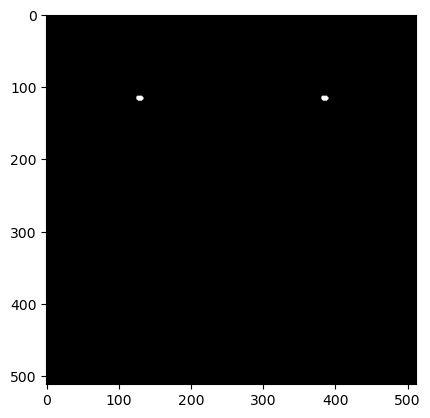

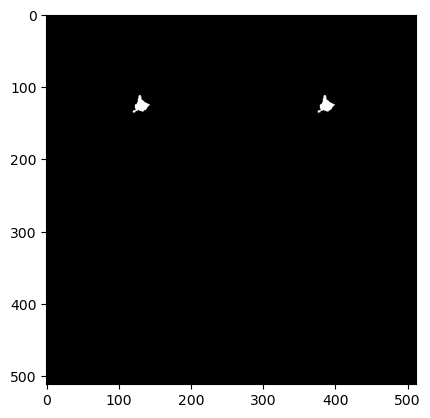

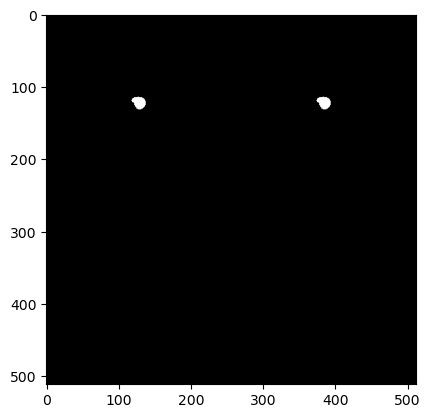

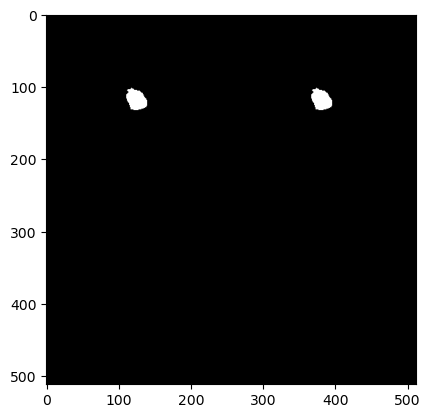

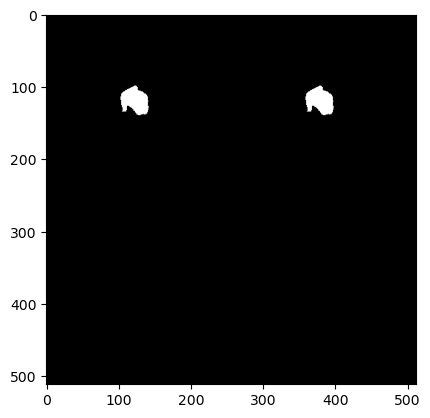

...

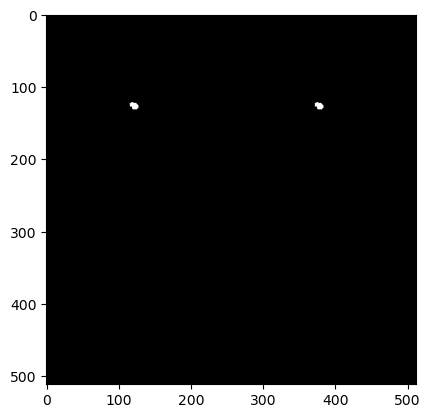

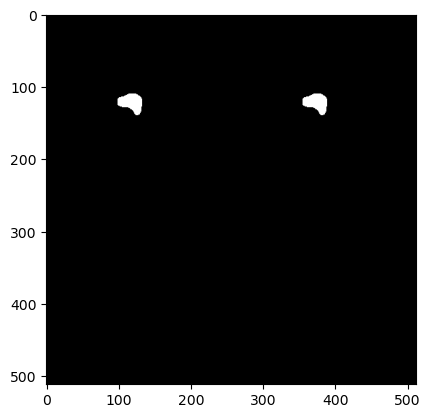

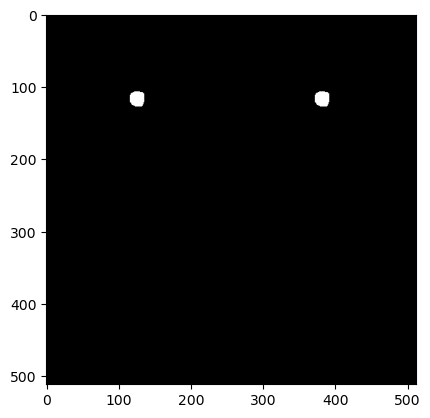

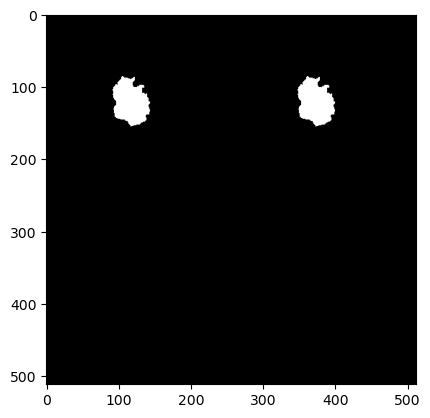

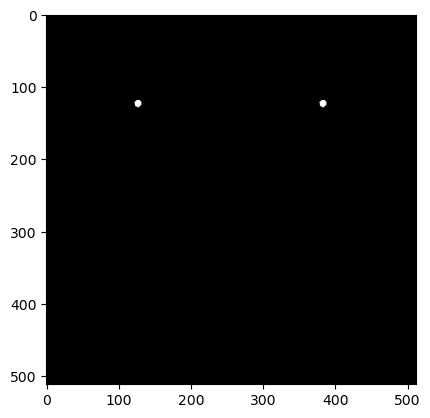

In [61]:
# Visualize them size by side
for i in range(len(original_labels)):
    label_1 = original_labels[i]
    label_2 = modified_labels[i]

    first_lesion_slice = np.argwhere(label_1==1)[0,-1] # first slice of lesion

    # Display both of the first slices of each volume below the first slices 
    # of each lesion, to check that the algorithm left the non-lesion-slices
    # unaffected

    sbs_lesion = np.concatenate((label_1,label_2), axis=1)[:,:,first_lesion_slice]
    sbs_first = np.concatenate((label_1, label_2), axis=1)[:,:,0]
    
    sbs_full = np.concatenate((sbs_lesion, sbs_first), axis=0)

    plt.figure()
    plt.imshow(sbs_full, cmap='gray')
    plt.show()